In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import flopy
import settings

pr = settings.props
gr = pr['gr']
sim_name = pr['sim_name']

# === 1. Settings and paths ===
dirs = settings.dirs

os.chdir(dirs.case)

# Workspaces voor GWF en MP7
sim_ws = dirs.SIM
mp7_ws = dirs.MP7

for path in [sim_ws, mp7_ws]:
    if not os.path.isdir(path):
        raise FileNotFoundError(f"Workspace does not exist: {path}")

mf6_exe = '/Users/Theo/GRWMODELS/USGS/mf6.4.2_mac/bin/mf6' # mf6 executable
if not os.path.isfile(mf6_exe):
    raise FileNotFoundError(f"Can't open file <{mf6_exe}>")

mp7_exe = '/Users/Theo/GRWMODELS/USGS/modpath_7_2_001/bin/mpath7gf.mac' # mp7 executable
if not os.path.isfile(mp7_exe):
    raise FileNotFoundError(f"Can't open file <{mp7_exe}>")

ModuleNotFoundError: No module named 'settings'

In [ ]:
!pwd

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/pty.py:95: DeprecationWarning: This process (pid=99201) is multi-threaded, use of forkpty() may lead to deadlocks in the child.
  pid, fd = os.forkpty()


/Users/Theo/GRWMODELS/python/mf6lab


In [ ]:
os.path.chdir('/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif')

AttributeError: module 'posixpath' has no attribute 'chdir'

In [ ]:
os.chdir('/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif')

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import flopy
import settings

pr = settings.props
gr = pr['gr']
sim_name = pr['sim_name']

# === 1. Settings and paths ===
dirs = settings.dirs

os.chdir(dirs.case)

# Workspaces voor GWF en MP7
sim_ws = dirs.SIM
mp7_ws = dirs.MP7

for path in [sim_ws, mp7_ws]:
    if not os.path.isdir(path):
        raise FileNotFoundError(f"Workspace does not exist: {path}")

mf6_exe = '/Users/Theo/GRWMODELS/USGS/mf6.4.2_mac/bin/mf6' # mf6 executable
if not os.path.isfile(mf6_exe):
    raise FileNotFoundError(f"Can't open file <{mf6_exe}>")

mp7_exe = '/Users/Theo/GRWMODELS/USGS/modpath_7_2_001/bin/mpath7gf.mac' # mp7 executable
if not os.path.isfile(mp7_exe):
    raise FileNotFoundError(f"Can't open file <{mp7_exe}>")

Project HOME directory: '/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion'
dirs.case = '/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif' already exists
dirs.wimsaquif = '/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif' already exists.
dirs.SIM = '/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif/SIM' already exists.
dirs.GWF = '/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif/GWF' already exists.
dirs.GWT = '/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif/GWT' already exists.
dirs.MP7 = '/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif/MP7' already exists.
dirs.photos = '/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif/photos' already exists.
dirs.images = '/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif/images' already exists.
dirs.data = '/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion

In [ ]:
sim = flopy.mf6.MFSimulation.load(sim_name=sim_name,
                                  version="mf6",
                                  exe_name=mf6_exe,
                                  sim_ws=sim_ws)

# Copy de tdis file van SIM directory naar de GWF directory
# while removing the line starting with START_DATE_TIME

infile = os.path.join(dirs.SIM, sim_name + '.tdis')
outfile = os.path.join(dirs.GWF, sim_name + '.tdis')
with open(infile, 'r') as f:
    lines = f.readlines()
with open(outfile, 'w') as f:
    for line in lines:
        if not line.strip().upper().startswith("START_DATE_TIME"):
            f.write(line)

# Get the flow model object
gwf_model_name = sim.model_names[0]
flowmodel = sim.get_model(gwf_model_name)

assert isinstance(flowmodel, flopy.mf6.ModflowGwf), "flowmodel is not a GWF model"
print(f"Flow model name: {flowmodel.name}, workspace: {flowmodel.model_ws}")

loading simulation...
  loading simulation name file...
  loading tdis package...
  loading model gwf6...
    loading package dis...
    loading package chd...
    loading package ic...
    loading package npf...
    loading package oc...
  loading solution package wimsaquifgwf...
Flow model name: wimsaquifgwf, workspace: /Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif/GWF


In [ ]:
mp7_model_name = sim_name + 'mp7'

mp7 = flopy.modpath.Modpath7(
    modelname=mp7_model_name,
    flowmodel=flowmodel,
    exe_name=mp7_exe,
    model_ws=mp7_ws,
)

In [ ]:
mpsim = flopy.modpath.Modpath7Sim(
    mp7,
    simulationtype="pathline", # valid ["endpoint", "pathline", "combined", "timeseries"]
    trackingdirection="forward", # "backward"
    weaksinkoption="pass_through",
    weaksourceoption="pass_through",
    budgetoutputoption="no",
    budgetcellnumbers=None,
    traceparticledata=None,
    referencetime=[0, 0, 0.0],
    stoptimeoption="extend",
    timepointdata=None,
    zonedataoption="off",
    zones=0,
    particlegroups=pg1
)

NameError: name 'pg1' is not defined

In [ ]:
psi = np.load(os.path.join(dirs.GWF, "psi.npy"))
psi_max = psi[0, 0]
num_particles = 1000

# Psi values marking the regions of dPsi
psi_ = np.linspace(0, psi_max, num_particles + 1)

# Psi values for the release of the particles
psim_ = 0.5 * (psi_[:-1] + psi_[1:])

Zp = np.interp(psim_, psi[::-1, 0], gr.Z[::-1, 0, 0])[::-1]
Ip = np.interp(Zp, gr.Z[::-1, 0, 0], np.arange(gr.nlay + 1)[::-1])
Iz = np.asarray(Ip, dtype=int)
localz = 1 - (Ip - Iz)

particlelocs = [ (int(iz), gr.nrow //  2, 0) for iz in Iz]
num_particles = len(particlelocs)
particleids = np.arange(num_particles, dtype=int)

def check_particle_location(lrc_tuple, grid):
    k, i, j = lrc_tuple
    assert 0 <= k < grid.nlay, f"Invalid layer index: {k}"
    assert 0 <= i < grid.nrow, f"Invalid row index: {i}"
    assert 0 <= j < grid.ncol, f"Invalid col index: {j}"

for loc in particlelocs:
    check_particle_location(loc, gr)

p = flopy.modpath.ParticleData(partlocs=particlelocs,
                               structured=True,
                               particleids=particleids,
                               localx=0.5,
                               localy=0.5,
                               localz=localz,
                               timeoffset=0.,
                               drape=0.
                               )
                            
pg1 = flopy.modpath.ParticleGroup(particlegroupname='PG1',
                                  filename='PG1.ptcls',
                                  releasedata=0.0,
                                  particledata=p)

In [ ]:
mpsim = flopy.modpath.Modpath7Sim(
    mp7,
    simulationtype="pathline", # valid ["endpoint", "pathline", "combined", "timeseries"]
    trackingdirection="forward", # "backward"
    weaksinkoption="pass_through",
    weaksourceoption="pass_through",
    budgetoutputoption="no",
    budgetcellnumbers=None,
    traceparticledata=None,
    referencetime=[0, 0, 0.0],
    stoptimeoption="extend",
    timepointdata=None,
    zonedataoption="off",
    zones=0,
    particlegroups=pg1
)

In [ ]:
mp7.write_input()  # Writes the MODPATH input file

# --- Corrigeer het .mpnam-bestand naar relatieve paden (nodig voor gfortran) ---
mpnam_path = os.path.join(mp7.model_ws, f"{mp7_model_name}.mpnam")
with open(mpnam_path, "r") as f:
    lines = f.readlines()

corrected_lines = []
for line in lines:
    parts = line.strip().split()
    if len(parts) == 2:
        label, filepath = parts
        rel_path = os.path.relpath(os.path.abspath(filepath), start=mp7.model_ws)
        corrected_lines.append(f"{label:<10s} {rel_path}\n")
    else:
        corrected_lines.append(line)
        
with open(mpnam_path, "w") as f:
    f.writelines(corrected_lines)
# --------------------------------------------------------------------------------

# === run modpath ===
mp7.run_model()    # Runs MODPATH7 simulation

FloPy is using the following executable to run the model: ../../../../../../../USGS/modpath_7_2_001/make/mpath7gf.mac

MODPATH Version 7.2.001   
Program compiled Apr 12 2025 00:35:39 with GFORTRAN compiler (ver. 11.2.0)      

 Cannot open file '../wimsaquifmp7.mpbas': No such file or directory                                                                 
 Press enter to terminate the program ...


Restarted .venv-3.12 (Python 3.12.2)

In [ ]:
import os
import numpy as np
import matplotlib.pyplto as plt
from settings import dirs

os.chdir(dirs.MP7)

ModuleNotFoundError: No module named 'matplotlib.pyplto'

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from settings import dirs

os.chdir(dirs.MP7)

ModuleNotFoundError: No module named 'settings'

In [ ]:
!pwd


/Users/Theo/GRWMODELS/python/mf6lab


In [ ]:
import os

os.chdir('/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif')

import numpy as np
import matplotlib.pyplot as plt
from settings import dirs

os.chdir(dirs.MP7)

Project HOME directory: '/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion'
dirs.case = '/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif' already exists
dirs.wimsaquif = '/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif' already exists.
dirs.SIM = '/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif/SIM' already exists.
dirs.GWF = '/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif/GWF' already exists.
dirs.GWT = '/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif/GWT' already exists.
dirs.MP7 = '/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif/MP7' already exists.
dirs.photos = '/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif/photos' already exists.
dirs.images = '/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif/images' already exists.
dirs.data = '/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion

In [ ]:
name = 'gaus1000'
pass_times = np.load('pass_times_' + name)

FileNotFoundError: [Errno 2] No such file or directory: 'pass_times_gaus1000'

In [ ]:
name = 'gaus1000'
pass_times = np.load('pass_times_' + name + '.npy')

In [ ]:
pass_times


array([(  0, [ 100.,  200.,  300.,  400.,  500.,  600.,  700.,  800.,  900., 1000.], [ 26763.08559382,  39869.32179322,  64611.29387966,  77547.190625  ,  94898.48828125, 118483.4171875 , 153313.253125  , 167835.98125   , 197204.1109375 , 251366.90625   ]),
       (  1, [ 100.,  200.,  300.,  400.,  500.,  600.,  700.,  800.,  900., 1000.], [ 11777.30434382,  17648.54338831,  29091.30169216,  37126.32890625,  49410.51499614,  60145.21743219,  79283.7171875 ,  90338.975     , 114752.35      , 135095.875     ]),
       (  2, [ 100.,  200.,  300.,  400.,  500.,  600.,  700.,  800.,  900., 1000.], [ 10568.26039851,  14802.70198205,  23185.88958279,  32021.06601563,  44120.99977859,  52800.5473401 ,  88738.66015625,  96535.8015625 , 118023.17890625, 136526.734375  ]),
       (  3, [ 100.,  200.,  300.,  400.,  500.,  600.,  700.,  800.,  900., 1000.], [  9668.32680476,  13122.42053674,  19667.31282499,  25389.17851563,  35115.81640625,  44845.9639971 ,  63743.23828125,  70046.7859375 ,  856

In [ ]:
pass_times.dtype


dtype([('id', '<i4'), ('xObs', '<f8', (10,)), ('time', '<f8', (10,))])

In [ ]:
pass_times['times'].shape[-1]

ValueError: no field of name times

In [ ]:
pass_times['time'].shape[-1]

10

ValueError: no field of name times

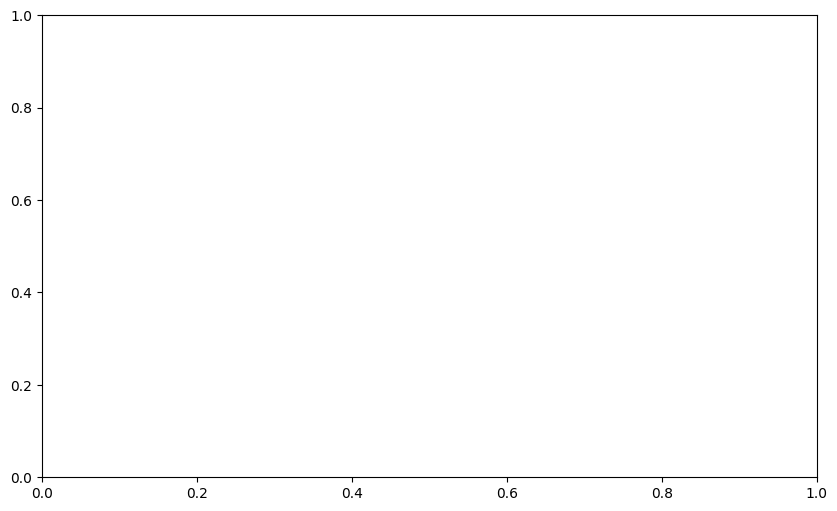

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
p = pass_times['id'] / 1000.
for it in range(pass_times['time'].shape[-1]):
    ax.plot(p, pass_times['times'][:, it], label=f'x = {pass_times['xObs'][0, it]} m')
    
ax.grid()
ax.legend()

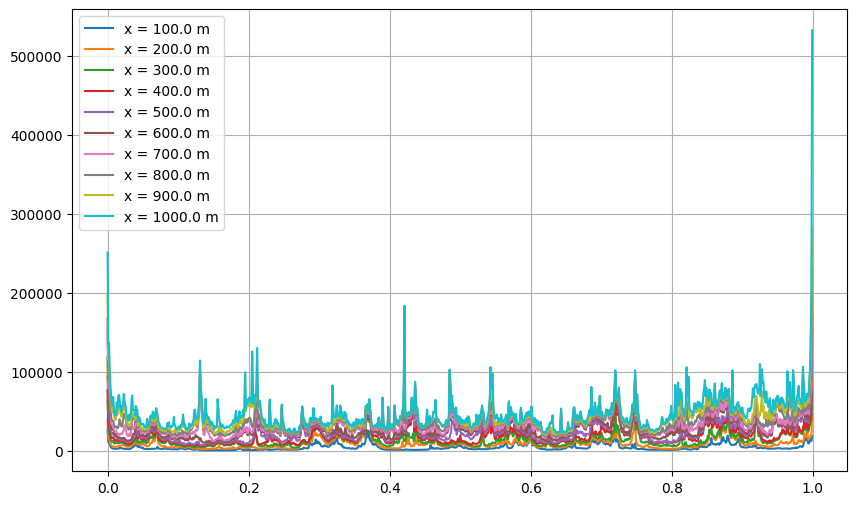

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
p = pass_times['id'] / 1000.
for it in range(pass_times['time'].shape[-1]):
    ax.plot(p, pass_times['time'][:, it], label=f'x = {pass_times['xObs'][0, it]} m')
    
ax.grid()
ax.legend()

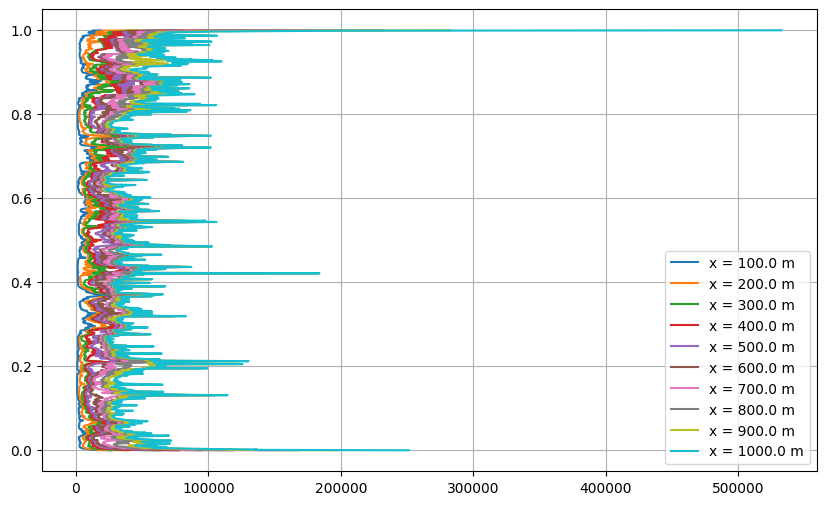

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
p = pass_times['id'] / 1000.
for it in range(pass_times['time'].shape[-1]):
    ax.plot(pass_times['time'][:, it], p, label=f'x = {pass_times['xObs'][0, it]} m')
    
ax.grid()
ax.legend()

In [ ]:
pass_times['xObs'][0]

array([ 100.,  200.,  300.,  400.,  500.,  600.,  700.,  800.,  900.,
       1000.])

In [ ]:
pass_times['time'].shape

(1000, 10)

In [ ]:
cumulatives = np.zeros(pass_times['time'].shape, dtype=float)


In [ ]:
cumulatives = dict()

for j, xo in enumerate(pass_times['xObs'][0]):
    idx = np.argsort(pass_times['time'][:, j])    
    t = pass_times['time'][:, j][idx]
    cumulatives[xo] = t


In [ ]:
cumulatives

{np.float64(100.0): array([  878.38480771,   879.1038854 ,   881.02204421,   885.12849401,
          892.10474857,   894.65619469,   905.86368994,   908.65652875,
          914.72243524,   924.70834553,   941.55138478,   941.85534595,
          952.89493296,   956.91511911,   967.1255065 ,   969.8017696 ,
          973.50022513,   991.06764517,   996.54082801,   998.05507554,
          999.84903899,  1011.85244831,  1019.30830908,  1020.29707372,
         1021.02526391,  1024.61733891,  1026.60032303,  1027.35943149,
         1030.34422356,  1032.33059466,  1032.41019599,  1033.6521625 ,
         1034.75177188,  1035.14229116,  1036.64931718,  1039.36587654,
         1039.76339297,  1041.62788272,  1045.0445087 ,  1047.89422793,
         1049.8585834 ,  1051.13263125,  1058.74738955,  1062.80007401,
         1065.71644364,  1066.54511905,  1093.5099628 ,  1096.91902041,
         1107.8020506 ,  1110.33327714,  1111.25323672,  1117.55262528,
         1121.88415807,  1134.5607543 ,  1135

In [ ]:
100.2 // 1

100.0

In [ ]:
cumulatives = dict()

for j, xo in enumerate(pass_times['xObs'][0]):
    idx = np.argsort(pass_times['time'][:, j])    
    t = pass_times['time'][:, j][idx]
    cumulatives[int(xo)] = t


In [ ]:
cumulatives

{100: array([  878.38480771,   879.1038854 ,   881.02204421,   885.12849401,
          892.10474857,   894.65619469,   905.86368994,   908.65652875,
          914.72243524,   924.70834553,   941.55138478,   941.85534595,
          952.89493296,   956.91511911,   967.1255065 ,   969.8017696 ,
          973.50022513,   991.06764517,   996.54082801,   998.05507554,
          999.84903899,  1011.85244831,  1019.30830908,  1020.29707372,
         1021.02526391,  1024.61733891,  1026.60032303,  1027.35943149,
         1030.34422356,  1032.33059466,  1032.41019599,  1033.6521625 ,
         1034.75177188,  1035.14229116,  1036.64931718,  1039.36587654,
         1039.76339297,  1041.62788272,  1045.0445087 ,  1047.89422793,
         1049.8585834 ,  1051.13263125,  1058.74738955,  1062.80007401,
         1065.71644364,  1066.54511905,  1093.5099628 ,  1096.91902041,
         1107.8020506 ,  1110.33327714,  1111.25323672,  1117.55262528,
         1121.88415807,  1134.5607543 ,  1135.32441592,  11

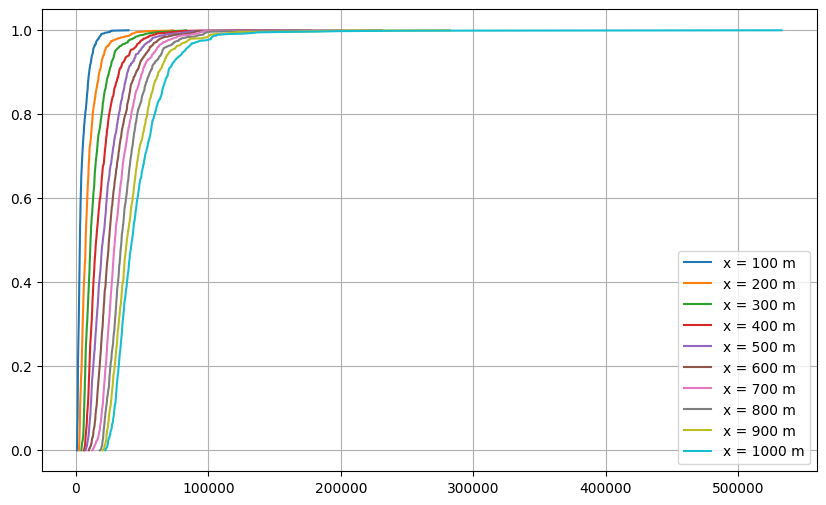

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
p = pass_times['id'] / 1000.
for k in cumulatives:
    ax.plot(cumulatives[k], p, label=f'x = {k} m')
    
ax.grid()
ax.legend()

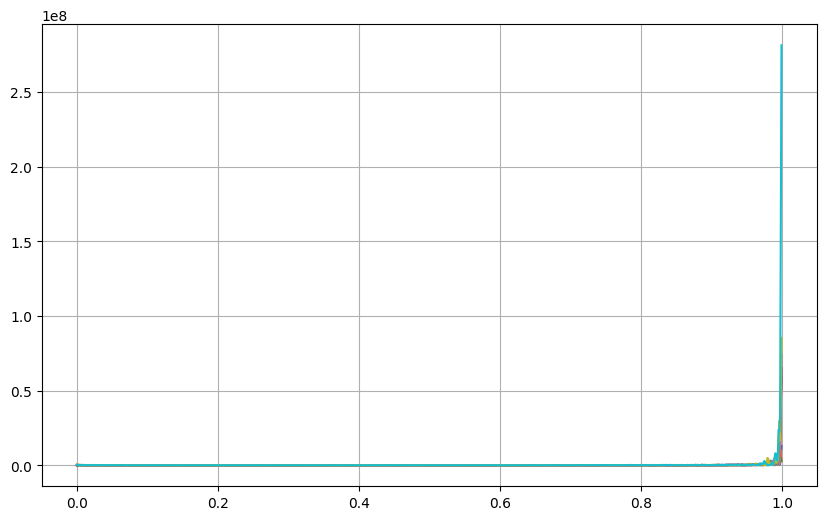

In [ ]:
# Assuming x and cdf are numpy arrays, with cdf strictly increasing from 0 to 1
fig, ax = plt.subplots(figsize=(10, 6))
for k in cumulatives:
    pdf = np.gradient(cumulatives[k], p)
    ax.plot(p, pdf, label=f"{k} m")
ax.grid()

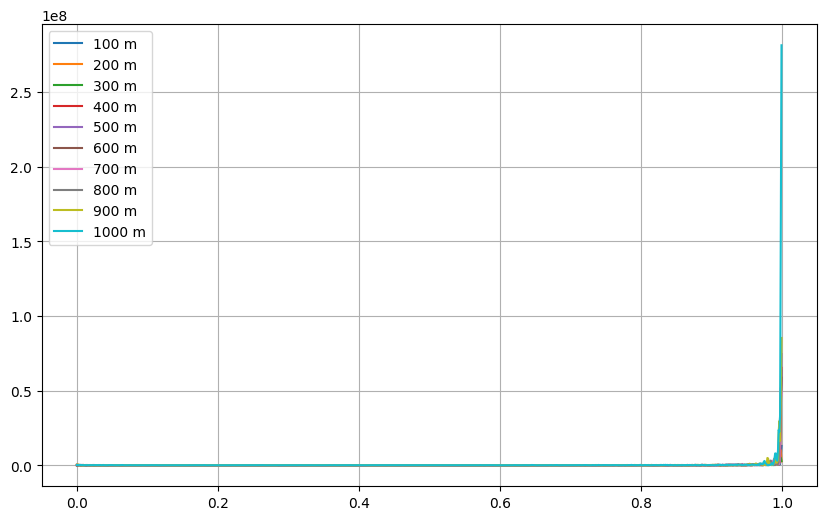

In [ ]:
# Assuming x and cdf are numpy arrays, with cdf strictly increasing from 0 to 1
fig, ax = plt.subplots(figsize=(10, 6))
for k in cumulatives:
    pdf = np.gradient(cumulatives[k], p)
    ax.plot(p, pdf, label=f"{k} m")
ax.grid()
ax.legend()

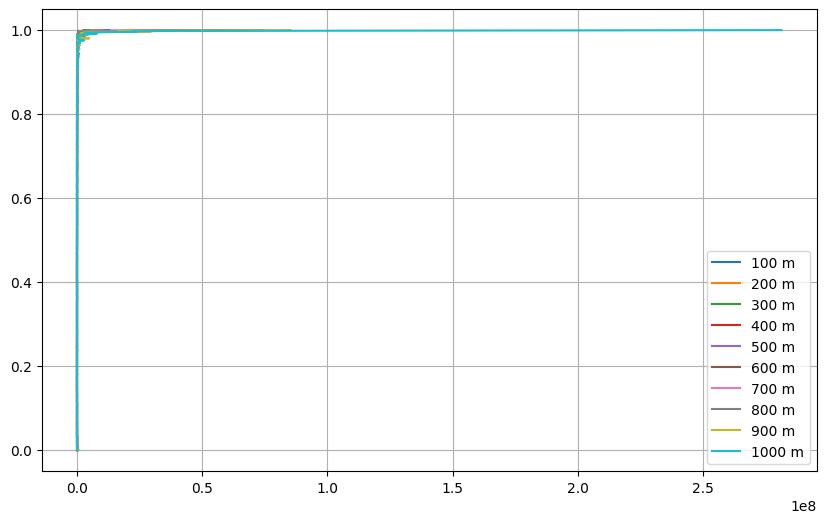

In [ ]:
# Assuming x and cdf are numpy arrays, with cdf strictly increasing from 0 to 1
fig, ax = plt.subplots(figsize=(10, 6))
for k in cumulatives:
    pdf = np.gradient(cumulatives[k], p)
    ax.plot(pdf, p, label=f"{k} m")
ax.grid()
ax.legend()

In [ ]:
pdf

array([1.90773438e+05, 1.63909180e+05, 7.13798828e+04, 8.93857422e+04,
       2.35565430e+05, 2.63061523e+05, 1.46329102e+05, 1.46262695e+05,
       1.60800781e+05, 6.78037109e+04, 9.50644531e+04, 7.53847656e+04,
       8.39208984e+04, 8.40957031e+04, 5.50136719e+04, 6.74775391e+04,
       2.34619141e+04, 4.39287109e+04, 6.78105469e+04, 6.86298828e+04,
       4.08623047e+04, 1.79951172e+04, 2.14882813e+04, 4.01083984e+04,
       9.80302734e+04, 1.38386719e+05, 8.95927734e+04, 7.45341797e+04,
       6.90029297e+04, 1.58283203e+05, 1.49770508e+05, 1.34970703e+04,
       1.03534180e+05, 1.75766602e+05, 8.17773438e+04, 1.34580078e+04,
       4.02177734e+04, 1.80542969e+05, 1.72846680e+05, 1.93837891e+04,
       4.23730469e+03, 2.35439453e+04, 2.09238281e+04, 5.67763672e+04,
       9.21757812e+04, 1.12596680e+05, 1.05679688e+05, 8.79414062e+04,
       1.08750977e+05, 1.27338867e+05, 1.32851563e+05, 7.03085938e+04,
       4.16230469e+04, 5.19365234e+04, 4.37685547e+04, 2.84697266e+04,
      

In [ ]:
p

array([0.   , 0.001, 0.002, 0.003, 0.004, 0.005, 0.006, 0.007, 0.008,
       0.009, 0.01 , 0.011, 0.012, 0.013, 0.014, 0.015, 0.016, 0.017,
       0.018, 0.019, 0.02 , 0.021, 0.022, 0.023, 0.024, 0.025, 0.026,
       0.027, 0.028, 0.029, 0.03 , 0.031, 0.032, 0.033, 0.034, 0.035,
       0.036, 0.037, 0.038, 0.039, 0.04 , 0.041, 0.042, 0.043, 0.044,
       0.045, 0.046, 0.047, 0.048, 0.049, 0.05 , 0.051, 0.052, 0.053,
       0.054, 0.055, 0.056, 0.057, 0.058, 0.059, 0.06 , 0.061, 0.062,
       0.063, 0.064, 0.065, 0.066, 0.067, 0.068, 0.069, 0.07 , 0.071,
       0.072, 0.073, 0.074, 0.075, 0.076, 0.077, 0.078, 0.079, 0.08 ,
       0.081, 0.082, 0.083, 0.084, 0.085, 0.086, 0.087, 0.088, 0.089,
       0.09 , 0.091, 0.092, 0.093, 0.094, 0.095, 0.096, 0.097, 0.098,
       0.099, 0.1  , 0.101, 0.102, 0.103, 0.104, 0.105, 0.106, 0.107,
       0.108, 0.109, 0.11 , 0.111, 0.112, 0.113, 0.114, 0.115, 0.116,
       0.117, 0.118, 0.119, 0.12 , 0.121, 0.122, 0.123, 0.124, 0.125,
       0.126, 0.127,

In [ ]:
cumulatives[k]

array([ 22272.86914062,  22463.64257812,  22600.6875    ,  22606.40234375,
        22779.45898438,  23077.53320312,  23305.58203125,  23370.19140625,
        23598.10742188,  23691.79296875,  23733.71484375,  23881.921875  ,
        23884.484375  ,  24049.76367188,  24052.67578125,  24159.79101562,
        24187.63085938,  24206.71484375,  24275.48828125,  24342.3359375 ,
        24412.74804688,  24424.06054688,  24448.73828125,  24467.03710938,
        24528.95507812,  24663.09765625,  24805.72851562,  24842.28320312,
        24954.796875  ,  24980.2890625 ,  25271.36328125,  25279.83007812,
        25298.35742188,  25486.8984375 ,  25649.890625  ,  25650.453125  ,
        25676.80664062,  25730.88867188,  26037.89257812,  26076.58203125,
        26076.66015625,  26085.05664062,  26123.74804688,  26126.90429688,
        26237.30078125,  26311.25585938,  26462.49414062,  26522.61523438,
        26638.37695312,  26740.1171875 ,  26893.0546875 ,  27005.8203125 ,
        27033.671875  ,  

In [ ]:
# Assuming x and cdf are numpy arrays, with cdf strictly increasing from 0 to 1
fig, ax = plt.subplots(figsize=(10, 6))
for k in cumulatives:
    pdf = np.gradient(p, cumulatives[k])
    ax.plot(p, pdf label=f"{k} m")
ax.grid()
ax.legend()

SyntaxError: invalid syntax. Perhaps you forgot a comma? (<ipython-input-29-e4e883727d35>, line 7)

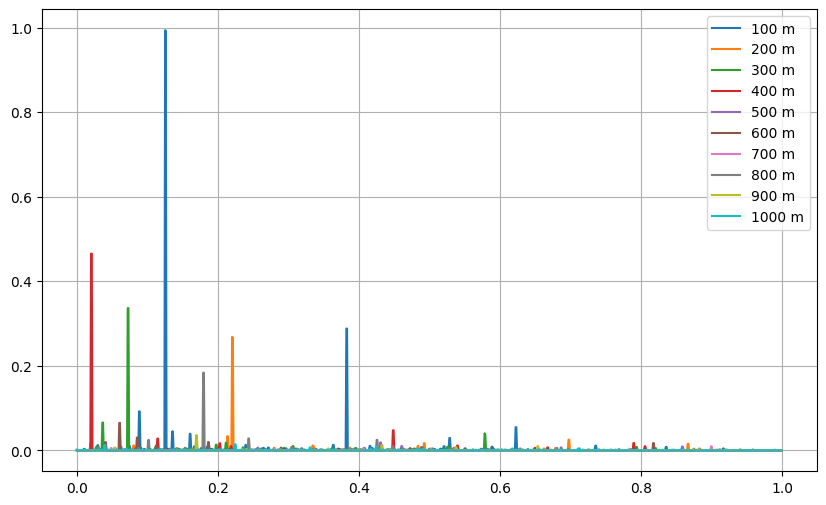

In [ ]:
# Assuming x and cdf are numpy arrays, with cdf strictly increasing from 0 to 1
fig, ax = plt.subplots(figsize=(10, 6))
for k in cumulatives:
    pdf = np.gradient(p, cumulatives[k])
    ax.plot(p, pdf, label=f"{k} m")
ax.grid()
ax.legend()

KeyError: slice(9, 10, None)

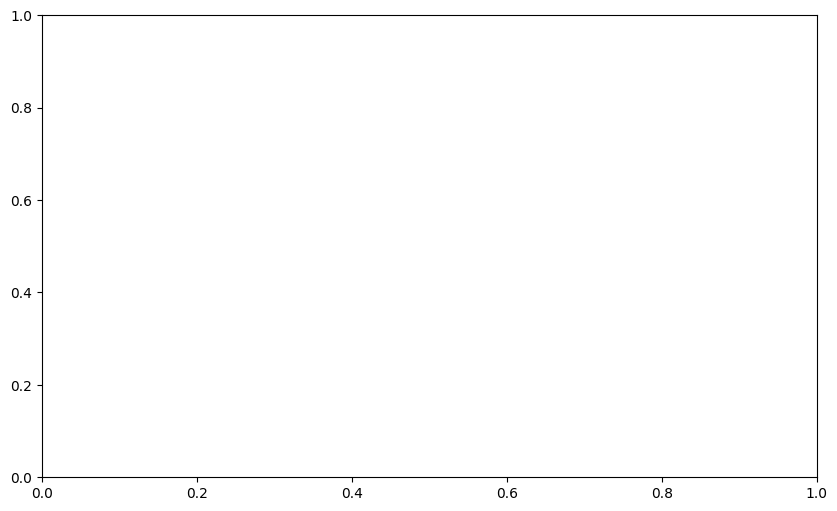

In [ ]:
# Assuming x and cdf are numpy arrays, with cdf strictly increasing from 0 to 1
fig, ax = plt.subplots(figsize=(10, 6))
for k in cumulatives[9:10]:
    pdf = np.gradient(p, cumulatives[k])
    ax.plot(p, pdf, label=f"{k} m")
ax.grid()
ax.legend()

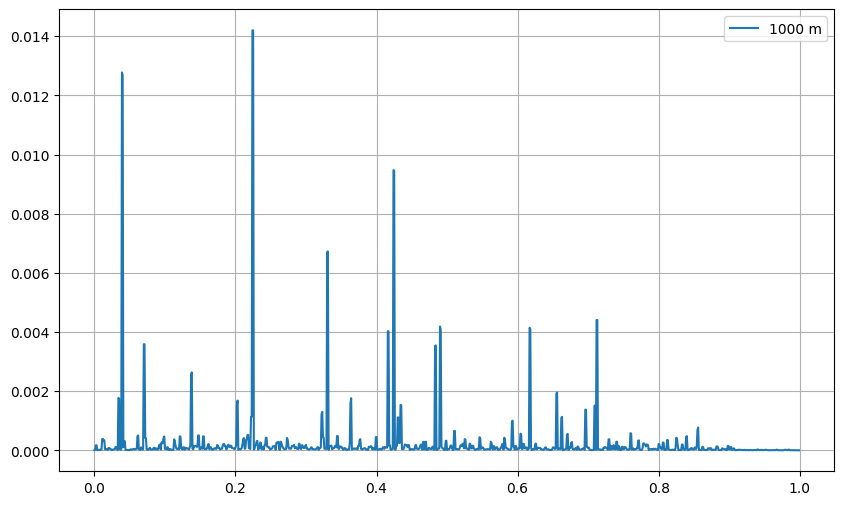

In [ ]:
# Assuming x and cdf are numpy arrays, with cdf strictly increasing from 0 to 1
fig, ax = plt.subplots(figsize=(10, 6))
for k in cumulatives:
    if k != 1000:
        continue
    pdf = np.gradient(p, cumulatives[k])
    ax.plot(p, pdf, label=f"{k} m")
ax.grid()
ax.legend()

In [ ]:
import os

os.chdir('/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif')

import numpy as np
import matplotlib.pyplot as plt
from settings import dirs
from scipy.interpolate import UnivariateSpline

os.chdir(dirs.MP7)

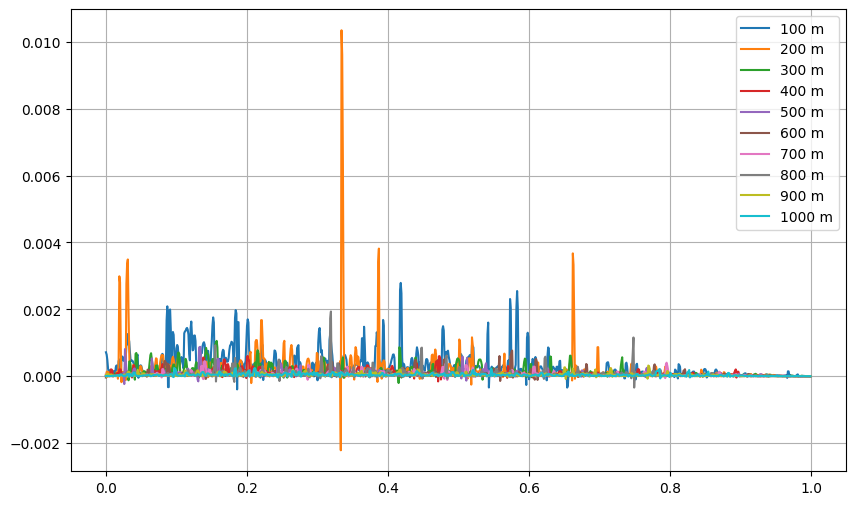

In [ ]:
# Smooth spline fit to cdf

# Assuming x and cdf are numpy arrays, with cdf strictly increasing from 0 to 1
fig, ax = plt.subplots(figsize=(10, 6))
for k in cumulatives:
    spline = UnivariateSpline(cumulatives[k], p, s=1e-4)  # adjust s for smoothness
    pdf = spline.derivative()(cumulatives[k])
    ax.plot(p, pdf, label=f"{k} m")
ax.grid()
ax.legend()

<ipython-input-35-1ce8d5dada67>:13: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()


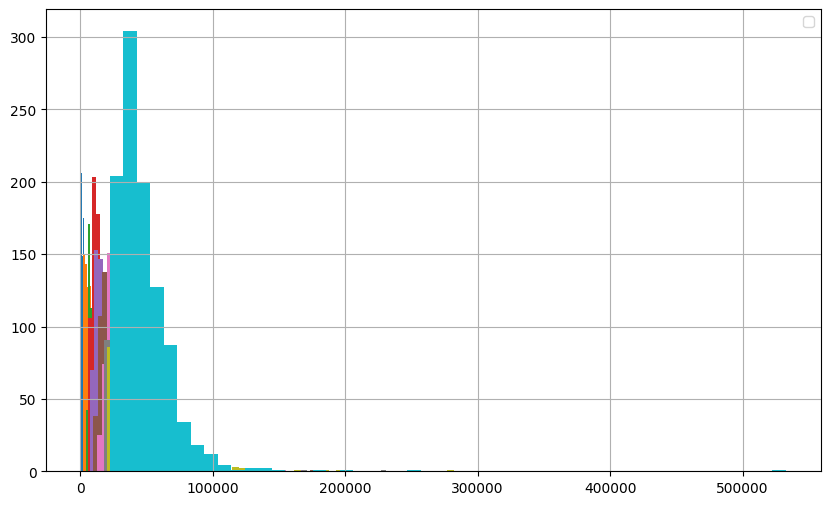

In [ ]:
# Smooth spline fit to cdf

# Assuming x and cdf are numpy arrays, with cdf strictly increasing from 0 to 1
fig, ax = plt.subplots(figsize=(10, 6))
for k in cumulatives:
    # spline = UnivariateSpline(cumulatives[k], p, s=1e-4)  # adjust s for smoothness
    # pdf = spline.derivative()(cumulatives[k])
    # ax.plot(p, pdf, label=f"{k} m")
    ax.hist(cumulatives[k], bins=50)
ax.grid()
ax.legend()

AttributeError: 'UnivariateSpline' object has no attribute 'derivativ'

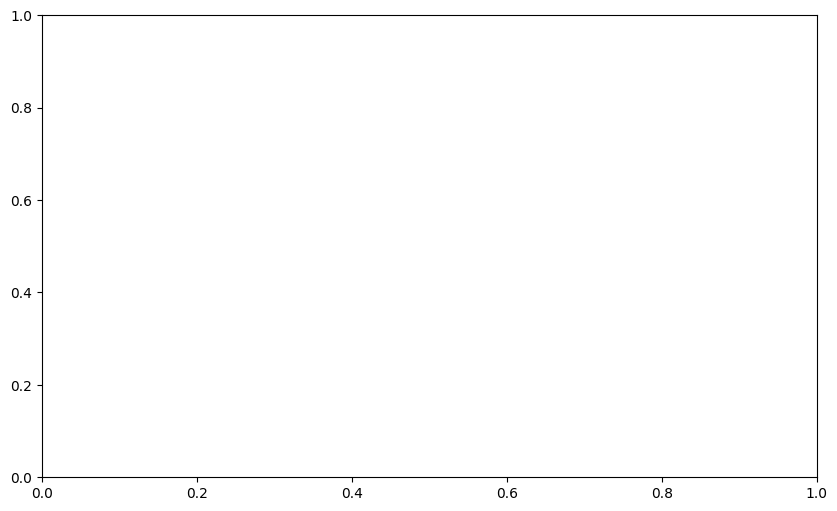

In [ ]:
# Smooth spline fit to cdf

# Assuming x and cdf are numpy arrays, with cdf strictly increasing from 0 to 1
fig, ax = plt.subplots(figsize=(10, 6))
for k in cumulatives:
    cdf_o = cumulatives[k]
    spline_cdf = UnivariateSpline(cdf_o, p, s=1e-4)  # adjust s for smoothness
    pdf = spline_cdf.derivative()(cdf_o)
    p_dense = np.linspace(p[0], p[-1], 1000)
    cdf_smooth = spline_cdf(p_dense)
    pdf_smooth = spline_cdf.derivativ()(p_dense)
    ax.plot(cdf_o,      p,       label=f"{k}, original cdf")
    ax.plot(cdf_smooth, p_dense, label=f"{k}, dense_cdf")    
ax.grid()
ax.legend()

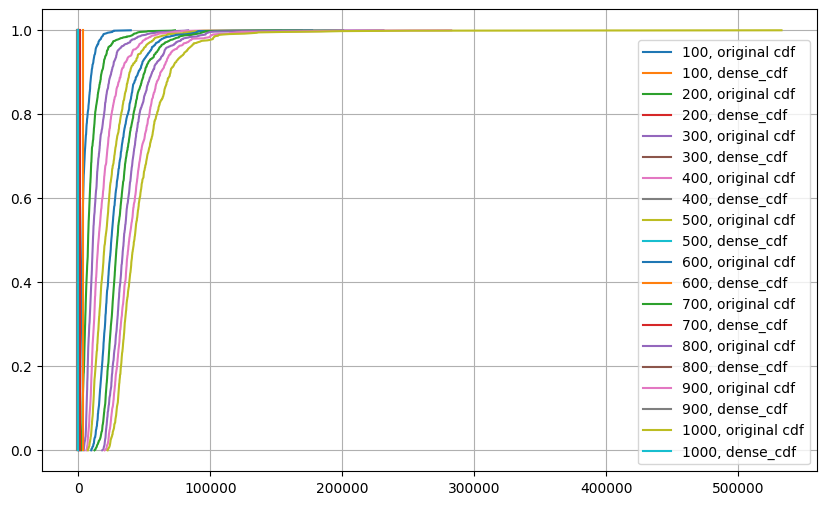

In [ ]:
# Smooth spline fit to cdf

# Assuming x and cdf are numpy arrays, with cdf strictly increasing from 0 to 1
fig, ax = plt.subplots(figsize=(10, 6))
for k in cumulatives:
    cdf_o = cumulatives[k]
    spline_cdf = UnivariateSpline(cdf_o, p, s=1e-4)  # adjust s for smoothness
    pdf = spline_cdf.derivative()(cdf_o)
    p_dense = np.linspace(p[0], p[-1], 1000)
    cdf_smooth = spline_cdf(p_dense)
    pdf_smooth = spline_cdf.derivative()(p_dense)
    ax.plot(cdf_o,      p,       label=f"{k}, original cdf")
    ax.plot(cdf_smooth, p_dense, label=f"{k}, dense_cdf")    
ax.grid()
ax.legend()

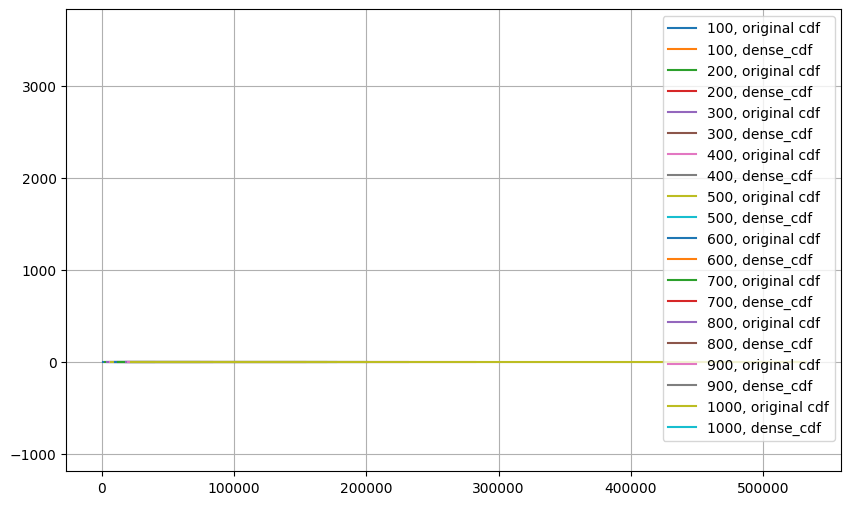

In [ ]:
# Smooth spline fit to cdf

# Assuming x and cdf are numpy arrays, with cdf strictly increasing from 0 to 1
fig, ax = plt.subplots(figsize=(10, 6))
for k in cumulatives:
    cdf_o = cumulatives[k]
    spline_cdf = UnivariateSpline(cdf_o, p, s=1e-4)  # adjust s for smoothness
    pdf = spline_cdf.derivative()(cdf_o)
    p_dense = np.linspace(p[0], p[-1], 1000)
    cdf_smooth = spline_cdf(p_dense)
    pdf_smooth = spline_cdf.derivative()(p_dense)
    ax.plot(cdf_o,      p,       label=f"{k}, original cdf")
    ax.plot(p_dense, cdf_smooth, label=f"{k}, dense_cdf")    
ax.grid()
ax.legend()

In [ ]:
cdf_smooth

array([189.638978  , 189.63895279, 189.63892758, 189.63890237,
       189.63887716, 189.63885194, 189.63882673, 189.63880152,
       189.63877631, 189.6387511 , 189.63872589, 189.63870067,
       189.63867546, 189.63865025, 189.63862504, 189.63859983,
       189.63857462, 189.6385494 , 189.63852419, 189.63849898,
       189.63847377, 189.63844856, 189.63842335, 189.63839813,
       189.63837292, 189.63834771, 189.6383225 , 189.63829729,
       189.63827208, 189.63824686, 189.63822165, 189.63819644,
       189.63817123, 189.63814602, 189.63812081, 189.63809559,
       189.63807038, 189.63804517, 189.63801996, 189.63799475,
       189.63796954, 189.63794432, 189.63791911, 189.6378939 ,
       189.63786869, 189.63784348, 189.63781827, 189.63779305,
       189.63776784, 189.63774263, 189.63771742, 189.63769221,
       189.637667  , 189.63764178, 189.63761657, 189.63759136,
       189.63756615, 189.63754094, 189.63751573, 189.63749051,
       189.6374653 , 189.63744009, 189.63741488, 189.63

In [ ]:
p_dense

array([0.   , 0.001, 0.002, 0.003, 0.004, 0.005, 0.006, 0.007, 0.008,
       0.009, 0.01 , 0.011, 0.012, 0.013, 0.014, 0.015, 0.016, 0.017,
       0.018, 0.019, 0.02 , 0.021, 0.022, 0.023, 0.024, 0.025, 0.026,
       0.027, 0.028, 0.029, 0.03 , 0.031, 0.032, 0.033, 0.034, 0.035,
       0.036, 0.037, 0.038, 0.039, 0.04 , 0.041, 0.042, 0.043, 0.044,
       0.045, 0.046, 0.047, 0.048, 0.049, 0.05 , 0.051, 0.052, 0.053,
       0.054, 0.055, 0.056, 0.057, 0.058, 0.059, 0.06 , 0.061, 0.062,
       0.063, 0.064, 0.065, 0.066, 0.067, 0.068, 0.069, 0.07 , 0.071,
       0.072, 0.073, 0.074, 0.075, 0.076, 0.077, 0.078, 0.079, 0.08 ,
       0.081, 0.082, 0.083, 0.084, 0.085, 0.086, 0.087, 0.088, 0.089,
       0.09 , 0.091, 0.092, 0.093, 0.094, 0.095, 0.096, 0.097, 0.098,
       0.099, 0.1  , 0.101, 0.102, 0.103, 0.104, 0.105, 0.106, 0.107,
       0.108, 0.109, 0.11 , 0.111, 0.112, 0.113, 0.114, 0.115, 0.116,
       0.117, 0.118, 0.119, 0.12 , 0.121, 0.122, 0.123, 0.124, 0.125,
       0.126, 0.127,

<ipython-input-41-851634cb8f4d>:9: UserWarning: 
The maximal number of iterations maxit (set to 20 by the program)
allowed for finding a smoothing spline with fp=s has been reached: s
too small.
There is an approximation returned but the corresponding weighted sum
of squared residuals does not satisfy the condition abs(fp-s)/s < tol.
  spline_cdf = UnivariateSpline(p, cdf_o, s=1e-4)  # adjust s for smoothness


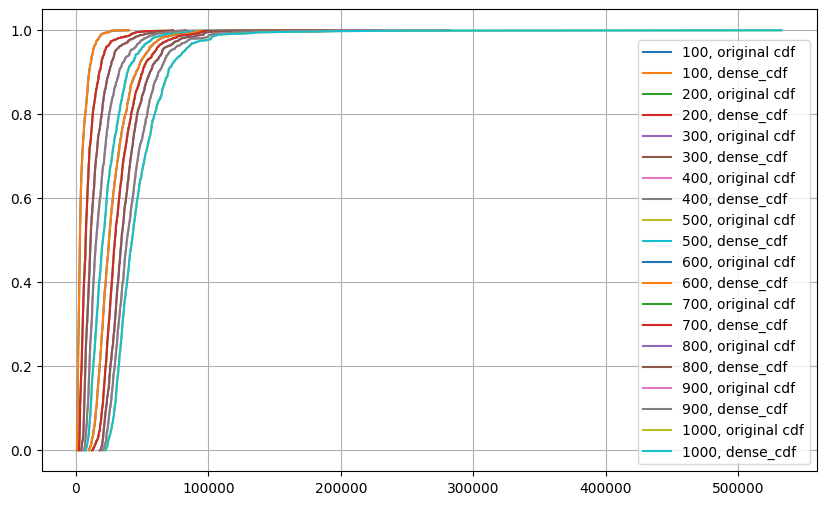

In [ ]:
# Smooth spline fit to cdf

# Assuming x and cdf are numpy arrays, with cdf strictly increasing from 0 to 1
fig, ax = plt.subplots(figsize=(10, 6))
for k in cumulatives:
    cdf_o = cumulatives[k]
    spline_cdf = UnivariateSpline(p, cdf_o, s=1e-4)  # adjust s for smoothness
    pdf = spline_cdf.derivative()(cdf_o)
    p_dense = np.linspace(p[0], p[-1], 1000)
    cdf_smooth = spline_cdf(p_dense)
    pdf_smooth = spline_cdf.derivative()(p_dense)
    ax.plot(cdf_o,      p,       label=f"{k}, original cdf")
    ax.plot(cdf_smooth, p_dense, label=f"{k}, dense_cdf")    
ax.grid()
ax.legend()

<ipython-input-42-622acdd1eee7>:9: UserWarning: 
The maximal number of iterations maxit (set to 20 by the program)
allowed for finding a smoothing spline with fp=s has been reached: s
too small.
There is an approximation returned but the corresponding weighted sum
of squared residuals does not satisfy the condition abs(fp-s)/s < tol.
  spline_cdf = UnivariateSpline(p, cdf_o, s=1e-4)  # adjust s for smoothness


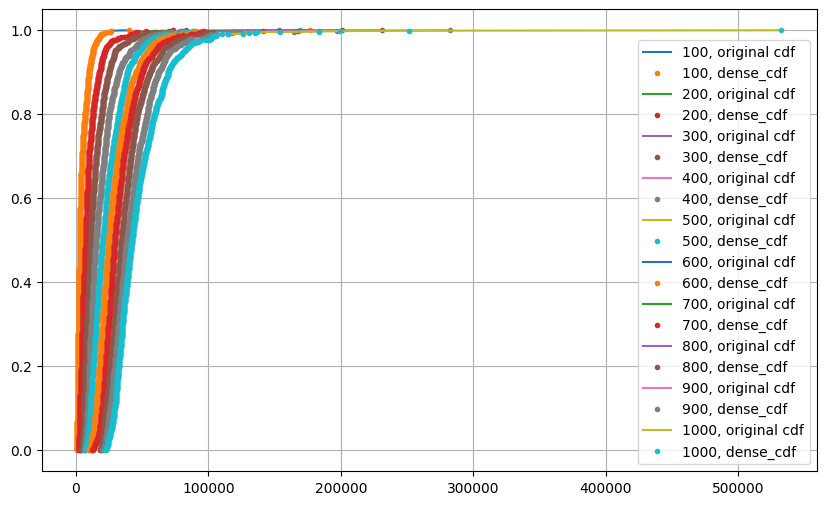

In [ ]:
# Smooth spline fit to cdf

# Assuming x and cdf are numpy arrays, with cdf strictly increasing from 0 to 1
fig, ax = plt.subplots(figsize=(10, 6))
for k in cumulatives:
    cdf_o = cumulatives[k]
    spline_cdf = UnivariateSpline(p, cdf_o, s=1e-4)  # adjust s for smoothness
    pdf = spline_cdf.derivative()(cdf_o)
    p_dense = np.linspace(p[0], p[-1], 1000)
    cdf_smooth = spline_cdf(p_dense)
    pdf_smooth = spline_cdf.derivative()(p_dense)
    ax.plot(cdf_o,      p,       label=f"{k}, original cdf")
    ax.plot(cdf_smooth, p_dense, '.', label=f"{k}, dense_cdf")    
ax.grid()
ax.legend()

<ipython-input-43-d963834f1bb3>:9: UserWarning: 
The maximal number of iterations maxit (set to 20 by the program)
allowed for finding a smoothing spline with fp=s has been reached: s
too small.
There is an approximation returned but the corresponding weighted sum
of squared residuals does not satisfy the condition abs(fp-s)/s < tol.
  spline_cdf = UnivariateSpline(p, cdf_o, s=1e-4)  # adjust s for smoothness


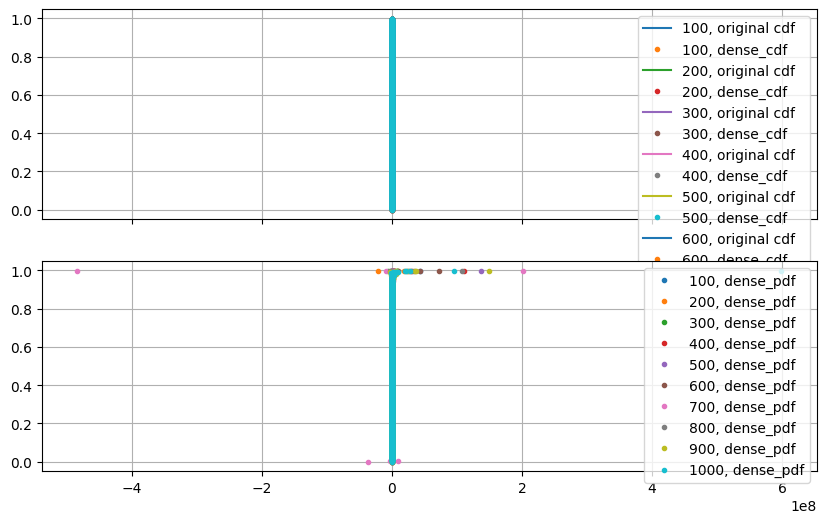

In [ ]:
# Smooth spline fit to cdf

# Assuming x and cdf are numpy arrays, with cdf strictly increasing from 0 to 1
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, figsize=(10, 6))
for k in cumulatives:
    cdf_o = cumulatives[k]
    spline_cdf = UnivariateSpline(p, cdf_o, s=1e-4)  # adjust s for smoothness
    pdf = spline_cdf.derivative()(cdf_o)
    p_dense = np.linspace(p[0], p[-1], 1000)
    cdf_smooth = spline_cdf(p_dense)
    pdf_smooth = spline_cdf.derivative()(p_dense)
    ax1.plot(cdf_o,      p,       label=f"{k}, original cdf")
    ax1.plot(cdf_smooth, p_dense, '.', label=f"{k}, dense_cdf")    
    ax2.plot(pdf_smooth, p_dense, '.', label=f"{k}, dense_pdf")

ax1.grid()
ax2.grid()
ax1.legend()
ax2.legend()

<ipython-input-44-be56556c79c2>:9: UserWarning: 
The maximal number of iterations maxit (set to 20 by the program)
allowed for finding a smoothing spline with fp=s has been reached: s
too small.
There is an approximation returned but the corresponding weighted sum
of squared residuals does not satisfy the condition abs(fp-s)/s < tol.
  spline_cdf = UnivariateSpline(p, cdf_o, s=1e-4)  # adjust s for smoothness


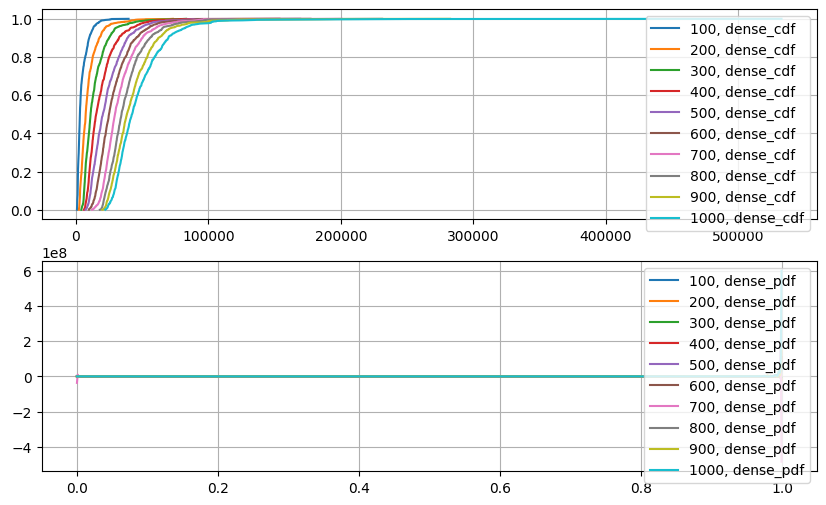

In [ ]:
# Smooth spline fit to cdf

# Assuming x and cdf are numpy arrays, with cdf strictly increasing from 0 to 1
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 6))
for k in cumulatives:
    cdf_o = cumulatives[k]
    spline_cdf = UnivariateSpline(p, cdf_o, s=1e-4)  # adjust s for smoothness
    pdf = spline_cdf.derivative()(cdf_o)
    p_dense = np.linspace(p[0], p[-1], 1000)
    cdf_smooth = spline_cdf(p_dense)
    pdf_smooth = spline_cdf.derivative()(p_dense)
    # ax1.plot(cdf_o,      p,       label=f"{k}, original cdf")
    ax1.plot(cdf_smooth, p_dense, label=f"{k}, dense_cdf")    
    ax2.plot(p_dense, pdf_smooth, label=f"{k}, dense_pdf")

ax1.grid()
ax2.grid()
ax1.legend()
ax2.legend()

In [ ]:
pdf

array([1.95601623e+23, 1.98966891e+23, 2.01402097e+23, 2.01503968e+23,
       2.04601022e+23, 2.09990791e+23, 2.14161675e+23, 2.15350800e+23,
       2.19571848e+23, 2.21318803e+23, 2.22102762e+23, 2.24885416e+23,
       2.24933680e+23, 2.28057640e+23, 2.28112875e+23, 2.30149221e+23,
       2.30679960e+23, 2.31044131e+23, 2.32358884e+23, 2.33640397e+23,
       2.34994053e+23, 2.35211898e+23, 2.35687468e+23, 2.36040418e+23,
       2.37236659e+23, 2.39838633e+23, 2.42620822e+23, 2.43336449e+23,
       2.45545729e+23, 2.46047672e+23, 2.51815282e+23, 2.51984051e+23,
       2.52353554e+23, 2.56129150e+23, 2.59415715e+23, 2.59427094e+23,
       2.59960464e+23, 2.61056749e+23, 2.67323669e+23, 2.68118717e+23,
       2.68120323e+23, 2.68293023e+23, 2.69089550e+23, 2.69154579e+23,
       2.71434041e+23, 2.72966438e+23, 2.76113623e+23, 2.77369721e+23,
       2.79796335e+23, 2.81937755e+23, 2.85172130e+23, 2.87568751e+23,
       2.88162228e+23, 2.89344424e+23, 2.90381009e+23, 2.91217522e+23,
      

In [ ]:
spline_cdf.derivative()(cdf_o)

array([1.95601623e+23, 1.98966891e+23, 2.01402097e+23, 2.01503968e+23,
       2.04601022e+23, 2.09990791e+23, 2.14161675e+23, 2.15350800e+23,
       2.19571848e+23, 2.21318803e+23, 2.22102762e+23, 2.24885416e+23,
       2.24933680e+23, 2.28057640e+23, 2.28112875e+23, 2.30149221e+23,
       2.30679960e+23, 2.31044131e+23, 2.32358884e+23, 2.33640397e+23,
       2.34994053e+23, 2.35211898e+23, 2.35687468e+23, 2.36040418e+23,
       2.37236659e+23, 2.39838633e+23, 2.42620822e+23, 2.43336449e+23,
       2.45545729e+23, 2.46047672e+23, 2.51815282e+23, 2.51984051e+23,
       2.52353554e+23, 2.56129150e+23, 2.59415715e+23, 2.59427094e+23,
       2.59960464e+23, 2.61056749e+23, 2.67323669e+23, 2.68118717e+23,
       2.68120323e+23, 2.68293023e+23, 2.69089550e+23, 2.69154579e+23,
       2.71434041e+23, 2.72966438e+23, 2.76113623e+23, 2.77369721e+23,
       2.79796335e+23, 2.81937755e+23, 2.85172130e+23, 2.87568751e+23,
       2.88162228e+23, 2.89344424e+23, 2.90381009e+23, 2.91217522e+23,
      

In [ ]:
spline_cdf.derivative()(p)

array([ 1.50875405e+05,  1.97290326e+05,  4.34183598e+04,  5.73155388e+04,
        2.63633937e+05,  3.01541294e+05,  1.08570015e+05,  1.42153265e+05,
        2.00393106e+05,  2.10789711e+04,  1.22113315e+05,  6.08544514e+04,
        8.67774946e+04,  9.55609561e+04,  3.55528894e+04,  9.23095389e+04,
        7.41640457e+01,  4.81653113e+04,  7.08368421e+04,  7.53506094e+04,
        3.95400137e+04,  1.16631641e+04,  2.17780352e+04,  3.01543799e+04,
        9.82548353e+04,  1.65007928e+05,  7.20337459e+04,  8.44137517e+04,
        3.75163018e+04,  1.79538635e+05,  1.94028383e+05, -5.70291446e+04,
        1.15070650e+05,  2.17951607e+05,  6.77225292e+04,  1.82235482e+03,
        5.73607951e+03,  2.16539984e+05,  2.11361790e+05, -2.49070775e+04,
        4.56927449e+03,  3.20537946e+04,  8.47921999e+03,  5.95722996e+04,
        9.38897794e+04,  1.17923273e+05,  1.09997207e+05,  7.61660181e+04,
        1.12987166e+05,  1.24391166e+05,  1.53481387e+05,  5.87926492e+04,
        3.31995872e+04,  

<ipython-input-48-b2a19a774d43>:10: UserWarning: 
The maximal number of iterations maxit (set to 20 by the program)
allowed for finding a smoothing spline with fp=s has been reached: s
too small.
There is an approximation returned but the corresponding weighted sum
of squared residuals does not satisfy the condition abs(fp-s)/s < tol.
  spline_cdf = UnivariateSpline(cdf_o, t, s=1e-4)  # adjust s for smoothness


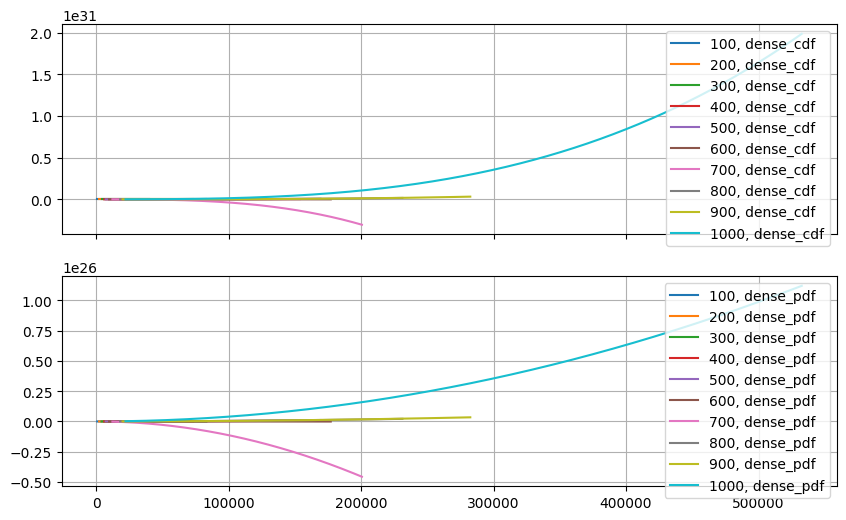

In [ ]:
# Smooth spline fit to cdf

# Assuming x and cdf are numpy arrays, with cdf strictly increasing from 0 to 1
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, figsize=(10, 6))
for k in cumulatives:
    cdf_o = p
    t = cumulatives[k]
    spline_cdf = UnivariateSpline(cdf_o, t, s=1e-4)  # adjust s for smoothness
    pdf = spline_cdf.derivative()(cdf_o)
    t_dense = np.linspace(t[0], t[-1], 1000)
    cdf_smooth = spline_cdf(t_dense)
    pdf_smooth = spline_cdf.derivative()(t_dense)    
    ax1.plot(t_dense, cdf_smooth, label=f"{k}, dense_cdf")    
    ax2.plot(t_dense, pdf_smooth, label=f"{k}, dense_pdf")

ax1.grid()
ax2.grid()
ax1.legend()
ax2.legend()

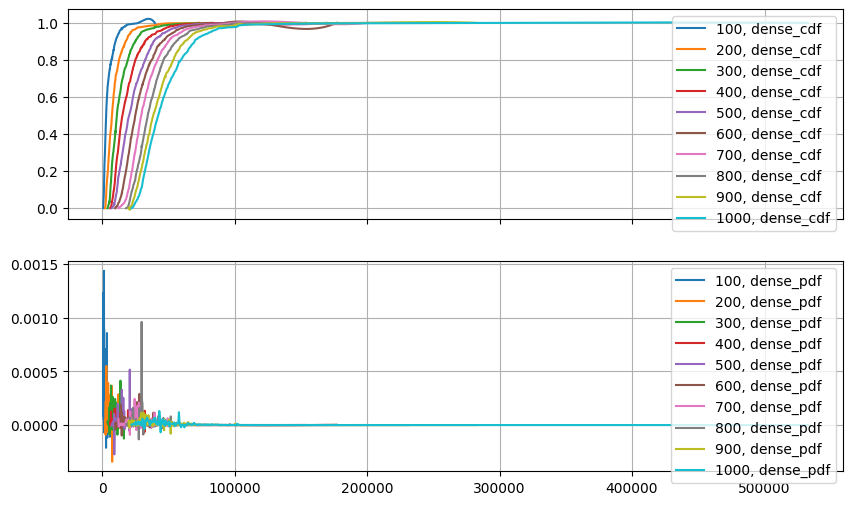

In [ ]:
# Smooth spline fit to cdf

# Assuming x and cdf are numpy arrays, with cdf strictly increasing from 0 to 1
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, figsize=(10, 6))
for k in cumulatives:
    cdf_o = p
    t = cumulatives[k]
    spline_cdf = UnivariateSpline(t, cdf_o, s=1e-4)  # adjust s for smoothness
    pdf = spline_cdf.derivative()(cdf_o)
    t_dense = np.linspace(t[0], t[-1], 1000)
    cdf_smooth = spline_cdf(t_dense)
    pdf_smooth = spline_cdf.derivative()(t_dense)    
    ax1.plot(t_dense, cdf_smooth, label=f"{k}, dense_cdf")    
    ax2.plot(t_dense, pdf_smooth, label=f"{k}, dense_pdf")

ax1.grid()
ax2.grid()
ax1.legend()
ax2.legend()

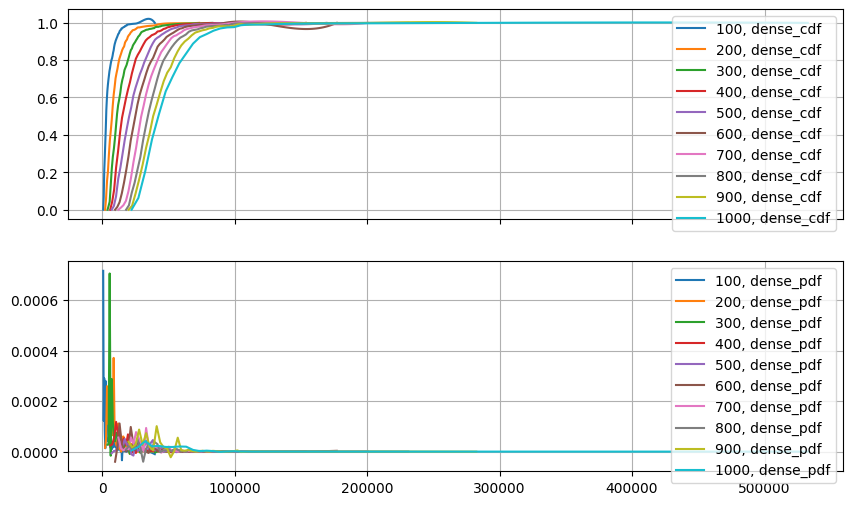

In [ ]:
# Smooth spline fit to cdf

# Assuming x and cdf are numpy arrays, with cdf strictly increasing from 0 to 1
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, figsize=(10, 6))
for k in cumulatives:
    cdf_o = p
    t = cumulatives[k]
    spline_cdf = UnivariateSpline(t, cdf_o, s=1e-4)  # adjust s for smoothness
    pdf = spline_cdf.derivative()(cdf_o)
    t_dense = np.linspace(t[0], t[-1], 100)
    cdf_smooth = spline_cdf(t_dense)
    pdf_smooth = spline_cdf.derivative()(t_dense)    
    ax1.plot(t_dense, cdf_smooth, label=f"{k}, dense_cdf")    
    ax2.plot(t_dense, pdf_smooth, label=f"{k}, dense_pdf")

ax1.grid()
ax2.grid()
ax1.legend()
ax2.legend()

In [ ]:
import os

os.chdir('/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif')

import numpy as np
import matplotlib.pyplot as plt
from settings import dirs
from scipy.interpolate import UnivariateSpline
from scipy import stats

os.chdir(dirs.MP7)

In [ ]:
x = cumulatives[600]

In [ ]:
t = cumulatives[600]
params = stats.norm.fit(t)


In [ ]:
params

(np.float64(28529.916627164737), np.float64(14110.68498275193))

In [ ]:
pdf = stats.norm.cdf(t, *params)

In [ ]:
pbkdf2_hmac(
            , password, salt, rounds, dklen=None)

SyntaxError: invalid syntax (<ipython-input-56-7b7b38543b53>, line 2)

In [ ]:
pdf

array([0.09273062, 0.09364003, 0.09394748, 0.0942094 , 0.10011997,
       0.10077649, 0.10093075, 0.10300582, 0.10397392, 0.1090219 ,
       0.11125546, 0.11213608, 0.11266725, 0.11277917, 0.11351251,
       0.1143608 , 0.1187324 , 0.11891149, 0.11984525, 0.12028256,
       0.12042093, 0.12076888, 0.12117197, 0.12118402, 0.12147037,
       0.12278747, 0.12347325, 0.12461688, 0.12520903, 0.12770098,
       0.1277537 , 0.13312202, 0.13322668, 0.13410381, 0.13448599,
       0.1350566 , 0.13679798, 0.13745999, 0.13856272, 0.13886843,
       0.13903251, 0.13903333, 0.13944633, 0.13967808, 0.14051087,
       0.14132807, 0.14206898, 0.14213935, 0.14236199, 0.14440745,
       0.14525332, 0.14721634, 0.14774592, 0.14916903, 0.14929917,
       0.14964016, 0.15216776, 0.15317348, 0.1542557 , 0.15484951,
       0.15491522, 0.15491548, 0.15538657, 0.15583947, 0.15703366,
       0.15714123, 0.15751774, 0.15811477, 0.15833774, 0.15882681,
       0.16096591, 0.16220933, 0.16287877, 0.16339923, 0.16380

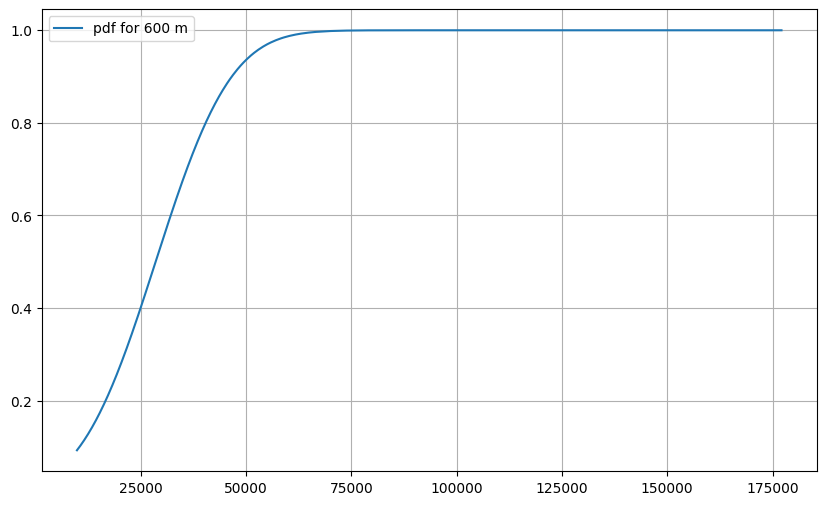

In [ ]:
x = 600
t = cumulatives[x]
params = stats.norm.fit(t)
pdf = stats.norm.cdf(t, *params)

fig, ax = plt.subplots(figsize=(10, 6))
ax.plot(t, pdf, label=f"pdf for {x} m")
ax.grid()
ax.legend()

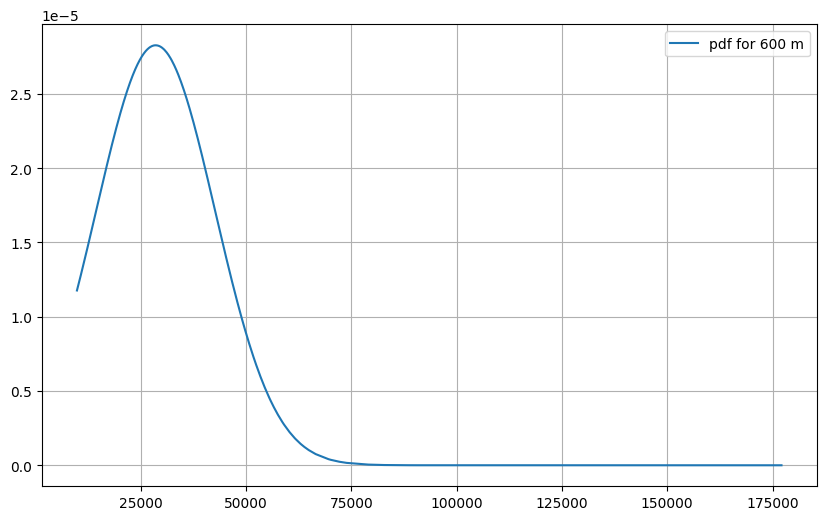

In [ ]:
x = 600
t = cumulatives[x]
params = stats.norm.fit(t)
pdf = stats.norm.pdf(t, *params)

fig, ax = plt.subplots(figsize=(10, 6))
ax.plot(t, pdf, label=f"pdf for {x} m")
ax.grid()
ax.legend()

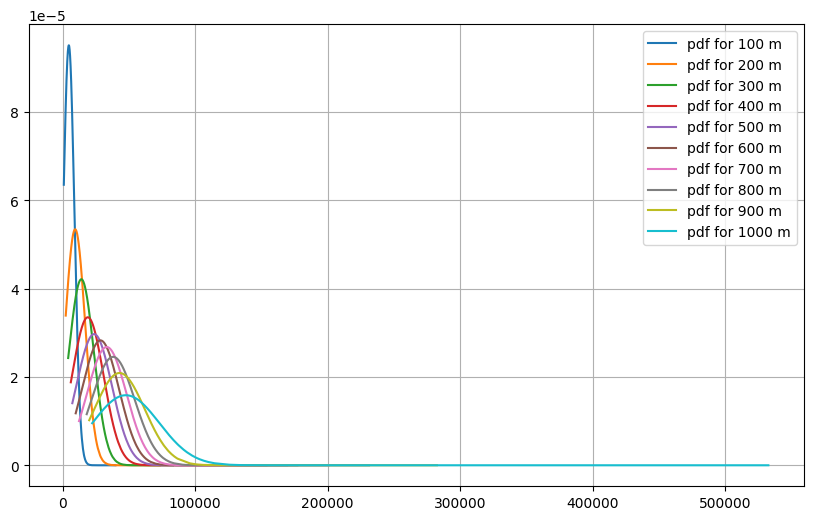

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))

x = 600
for x in cumulatives:
    t = cumulatives[x]
    params = stats.norm.fit(t)
    pdf = stats.norm.pdf(t, *params)
    ax.plot(t, pdf, label=f"pdf for {x} m")

ax.grid()
ax.legend()

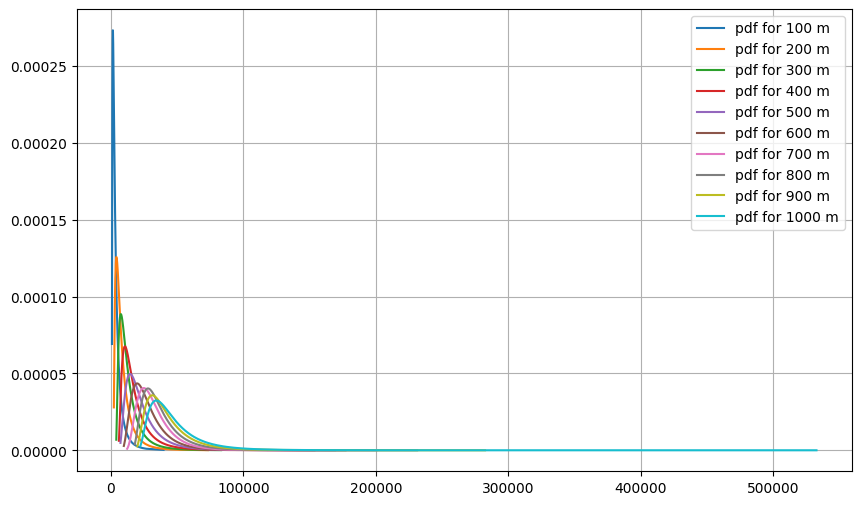

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))

x = 600
for x in cumulatives:
    t = cumulatives[x]
    # params = stats.norm.fit(t)
    # pdf = stats.norm.pdf(t, *params)
    params = stats.lognorm.fit(t)
    pdf = stats.lognorm.pdf(t, *params)

    ax.plot(t, pdf, label=f"pdf for {x} m")

ax.grid()
ax.legend()

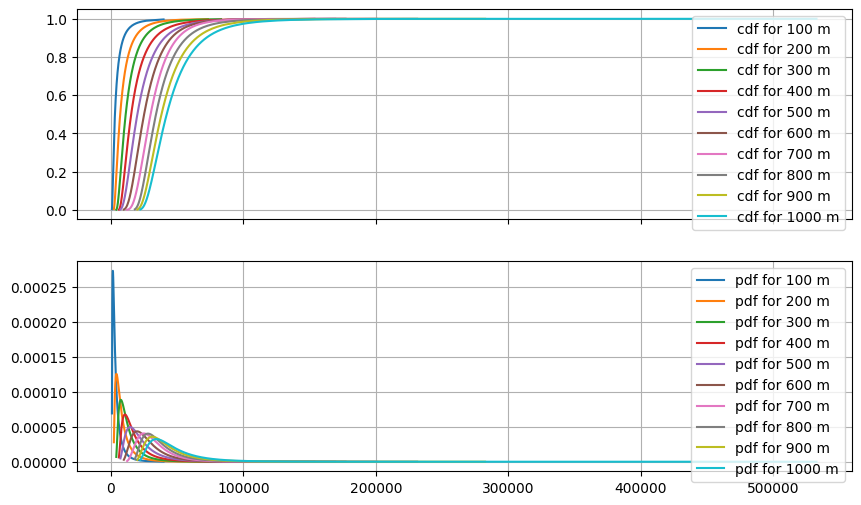

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, figsize=(10, 6))

x = 600
for x in cumulatives:
    t = cumulatives[x]
    # params = stats.norm.fit(t)
    # pdf = stats.norm.pdf(t, *params)
    params = stats.lognorm.fit(t)
    
    cdf = stats.lognorm.cdf(t, *params)
    pdf = stats.lognorm.pdf(t, *params)
    
    ax1.plot(t, cdf, label=f"cdf for {x} m")
    ax2.plot(t, pdf, label=f"pdf for {x} m")

ax1.grid()
ax2.grid()
ax1.legend()
ax2.legend()

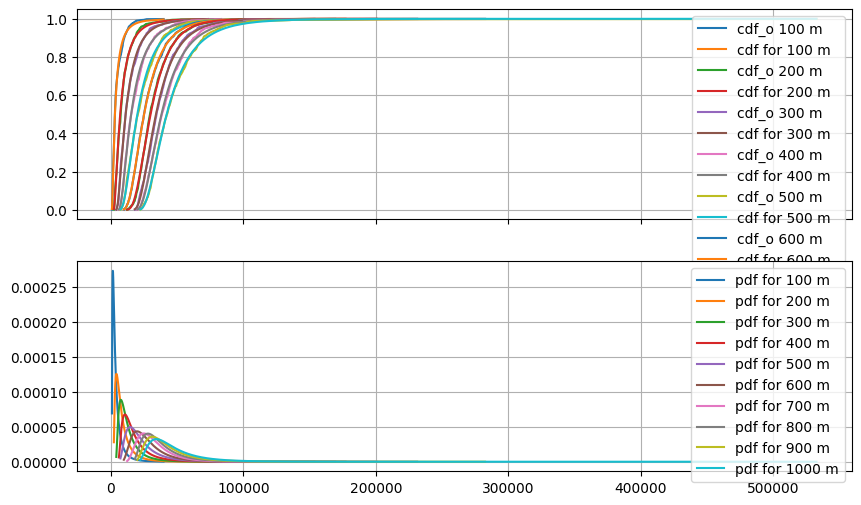

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, figsize=(10, 6))

x = 600
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    # params = stats.norm.fit(t)
    # pdf = stats.norm.pdf(t, *params)
    params = stats.lognorm.fit(t)
    
    cdf = stats.lognorm.cdf(t, *params)
    pdf = stats.lognorm.pdf(t, *params)
    
    ax1.plot(t, cdf_o, label=f"cdf_o {x} m")
    ax1.plot(t, cdf, label=f"cdf for {x} m")
    ax2.plot(t, pdf, label=f"pdf for {x} m")

ax1.grid()
ax2.grid()
ax1.legend()
ax2.legend()

In [ ]:
params

(np.float64(0.6337081355017692),
 18418.926676423922,
 np.float64(23770.271792400683))

In [ ]:
help(stats.lognorm.fit)

Help on method fit in module scipy.stats._continuous_distns:

fit(data, *args, **kwds) method of scipy.stats._continuous_distns.lognorm_gen instance
    Return estimates of shape (if applicable), location, and scale
    parameters from data. The default estimation method is Maximum
    Likelihood Estimation (MLE), but Method of Moments (MM)
    is also available.

    Starting estimates for the fit are given by input arguments;
    for any arguments not provided with starting estimates,
    ``self._fitstart(data)`` is called to generate such.

    One can hold some parameters fixed to specific values by passing in
    keyword arguments ``f0``, ``f1``, ..., ``fn`` (for shape parameters)
    and ``floc`` and ``fscale`` (for location and scale parameters,
    respectively).

    Parameters
    ----------
    data : array_like or `CensoredData` instance
        Data to use in estimating the distribution parameters.
    arg1, arg2, arg3,... : floats, optional
        Starting value(s) for a

In [ ]:
help(stats.lognorm.cdf)

Help on method cdf in module scipy.stats._distn_infrastructure:

cdf(x, *args, **kwds) method of scipy.stats._continuous_distns.lognorm_gen instance
    Cumulative distribution function of the given RV.

    Parameters
    ----------
    x : array_like
        quantiles
    arg1, arg2, arg3,... : array_like
        The shape parameter(s) for the distribution (see docstring of the
        instance object for more information)
    loc : array_like, optional
        location parameter (default=0)
    scale : array_like, optional
        scale parameter (default=1)

    Returns
    -------
    cdf : ndarray
        Cumulative distribution function evaluated at `x`



In [ ]:
stats.lognorm.cdf.__doc__

'\n        Cumulative distribution function of the given RV.\n\n        Parameters\n        ----------\n        x : array_like\n            quantiles\n        arg1, arg2, arg3,... : array_like\n            The shape parameter(s) for the distribution (see docstring of the\n            instance object for more information)\n        loc : array_like, optional\n            location parameter (default=0)\n        scale : array_like, optional\n            scale parameter (default=1)\n\n        Returns\n        -------\n        cdf : ndarray\n            Cumulative distribution function evaluated at `x`\n\n        '

In [ ]:
print(stats.lognorm.cdf.__doc__)


        Cumulative distribution function of the given RV.

        Parameters
        ----------
        x : array_like
            quantiles
        arg1, arg2, arg3,... : array_like
            The shape parameter(s) for the distribution (see docstring of the
            instance object for more information)
        loc : array_like, optional
            location parameter (default=0)
        scale : array_like, optional
            scale parameter (default=1)

        Returns
        -------
        cdf : ndarray
            Cumulative distribution function evaluated at `x`

        


In [ ]:
params

(np.float64(0.6337081355017692),
 18418.926676423922,
 np.float64(23770.271792400683))

In [ ]:
np.log(params[-1])

np.float64(10.076190994550572)

In [ ]:
help(stats.lognorm.cdf)

Help on method cdf in module scipy.stats._distn_infrastructure:

cdf(x, *args, **kwds) method of scipy.stats._continuous_distns.lognorm_gen instance
    Cumulative distribution function of the given RV.

    Parameters
    ----------
    x : array_like
        quantiles
    arg1, arg2, arg3,... : array_like
        The shape parameter(s) for the distribution (see docstring of the
        instance object for more information)
    loc : array_like, optional
        location parameter (default=0)
    scale : array_like, optional
        scale parameter (default=1)

    Returns
    -------
    cdf : ndarray
        Cumulative distribution function evaluated at `x`



In [ ]:
cdf.__doc__

'ndarray(shape, dtype=float, buffer=None, offset=0,\n            strides=None, order=None)\n\n    An array object represents a multidimensional, homogeneous array\n    of fixed-size items.  An associated data-type object describes the\n    format of each element in the array (its byte-order, how many bytes it\n    occupies in memory, whether it is an integer, a floating point number,\n    or something else, etc.)\n\n    Arrays should be constructed using `array`, `zeros` or `empty` (refer\n    to the See Also section below).  The parameters given here refer to\n    a low-level method (`ndarray(...)`) for instantiating an array.\n\n    For more information, refer to the `numpy` module and examine the\n    methods and attributes of an array.\n\n    Parameters\n    ----------\n    (for the __new__ method; see Notes below)\n\n    shape : tuple of ints\n        Shape of created array.\n    dtype : data-type, optional\n        Any object that can be interpreted as a numpy data type.\n    buf

In [ ]:
print(cdf.__doc__)

ndarray(shape, dtype=float, buffer=None, offset=0,
            strides=None, order=None)

    An array object represents a multidimensional, homogeneous array
    of fixed-size items.  An associated data-type object describes the
    format of each element in the array (its byte-order, how many bytes it
    occupies in memory, whether it is an integer, a floating point number,
    or something else, etc.)

    Arrays should be constructed using `array`, `zeros` or `empty` (refer
    to the See Also section below).  The parameters given here refer to
    a low-level method (`ndarray(...)`) for instantiating an array.

    For more information, refer to the `numpy` module and examine the
    methods and attributes of an array.

    Parameters
    ----------
    (for the __new__ method; see Notes below)

    shape : tuple of ints
        Shape of created array.
    dtype : data-type, optional
        Any object that can be interpreted as a numpy data type.
    buffer : object exposing buf

In [ ]:
cdf

array([0.00204626, 0.00259739, 0.00305221, 0.00307229, 0.00372466,
       0.00505975, 0.00627476, 0.00665107, 0.00809599, 0.00874433,
       0.00904493, 0.01016039, 0.0101804 , 0.01152455, 0.01154918,
       0.01247802, 0.01272679, 0.01289908, 0.01353189, 0.01416497,
       0.01485108, 0.01496316, 0.01520945, 0.01539365, 0.01602694,
       0.01745208, 0.01904762, 0.01946989, 0.02080394, 0.0211134 ,
       0.02483571, 0.02494918, 0.02519851, 0.02781564, 0.03019496,
       0.03020335, 0.03059825, 0.03141744, 0.03629054, 0.03693134,
       0.03693264, 0.03707249, 0.03772054, 0.03777367, 0.03965647,
       0.04094444, 0.0436443 , 0.04474197, 0.04689421, 0.04882741,
       0.05180577, 0.05405667, 0.05461969, 0.05574778, 0.05674401,
       0.05755273, 0.05792475, 0.05913411, 0.0596791 , 0.06059681,
       0.06096552, 0.06175714, 0.06179983, 0.06717718, 0.06778983,
       0.07239546, 0.0751334 , 0.07536296, 0.07630325, 0.07708359,
       0.07842026, 0.07842687, 0.07942222, 0.07947625, 0.08007

In [ ]:
    pararms_str = ', '.join([f"{p:.3g}" for p in params])

In [ ]:
pararms_str

'0.634, 1.84e+04, 2.38e+04'

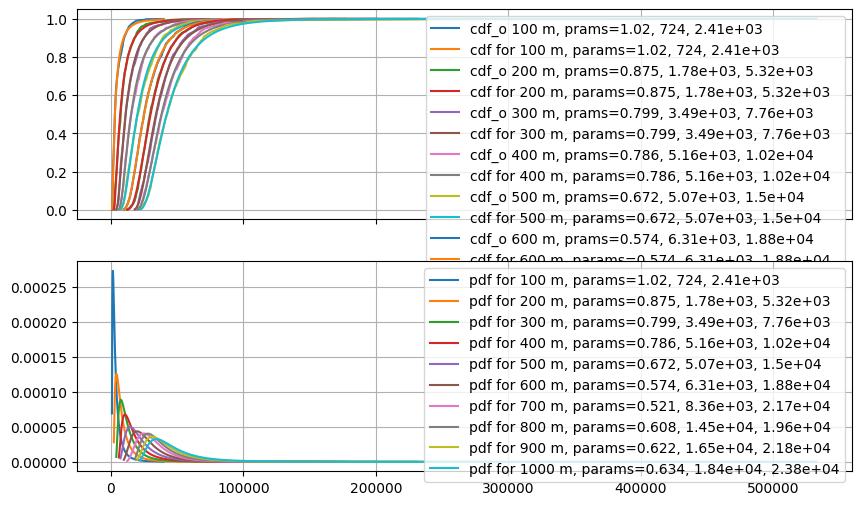

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, figsize=(10, 6))

x = 600
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    # params = stats.norm.fit(t)
    # pdf = stats.norm.pdf(t, *params)
    params = stats.lognorm.fit(t)
    
    cdf = stats.lognorm.cdf(t, *params)
    pdf = stats.lognorm.pdf(t, *params)
    
    params_str = ', '.join([f"{p:.3g}" for p in params])
    ax1.plot(t, cdf_o, label=f"cdf_o {x} m, prams={params_str}")
    ax1.plot(t, cdf, label=f"cdf for {x} m, params={params_str}")
    ax2.plot(t, pdf, label=f"pdf for {x} m, params={params_str}")

ax1.grid()
ax2.grid()
ax1.legend()
ax2.legend()

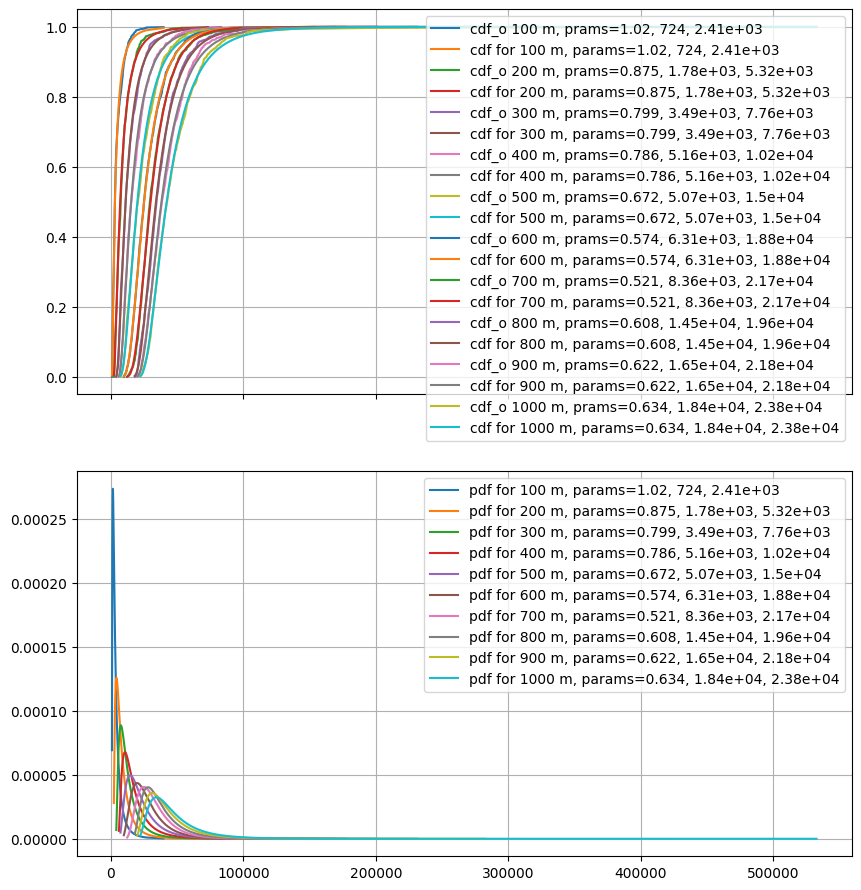

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, figsize=(10, 11))

x = 600
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    # params = stats.norm.fit(t)
    # pdf = stats.norm.pdf(t, *params)
    params = stats.lognorm.fit(t)
    
    cdf = stats.lognorm.cdf(t, *params)
    pdf = stats.lognorm.pdf(t, *params)
    
    params_str = ', '.join([f"{p:.3g}" for p in params])
    ax1.plot(t, cdf_o, label=f"cdf_o {x} m, prams={params_str}")
    ax1.plot(t, cdf, label=f"cdf for {x} m, params={params_str}")
    ax2.plot(t, pdf, label=f"pdf for {x} m, params={params_str}")

ax1.grid()
ax2.grid()
ax1.legend()
ax2.legend()

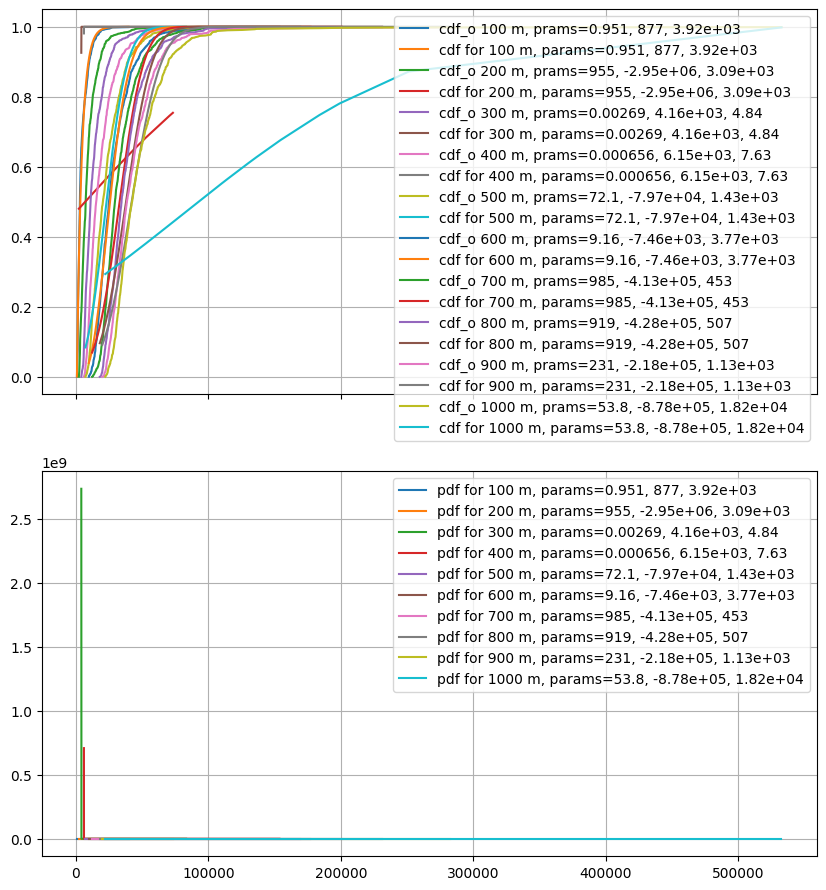

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, figsize=(10, 11))

x = 600
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    # params = stats.norm.fit(t)
    # pdf = stats.norm.pdf(t, *params)

    # params = stats.lognorm.fit(t)    
    # cdf = stats.lognorm.cdf(t, *params)
    # pdf = stats.lognorm.pdf(t, *params)
    
    params = stats.gamma.fit(t)    
    cdf = stats.gamma.cdf(t, *params)
    pdf = stats.gamma.pdf(t, *params)

    
    params_str = ', '.join([f"{p:.3g}" for p in params])
    ax1.plot(t, cdf_o, label=f"cdf_o {x} m, prams={params_str}")
    ax1.plot(t, cdf, label=f"cdf for {x} m, params={params_str}")
    ax2.plot(t, pdf, label=f"pdf for {x} m, params={params_str}")

ax1.grid()
ax2.grid()
ax1.legend()
ax2.legend()

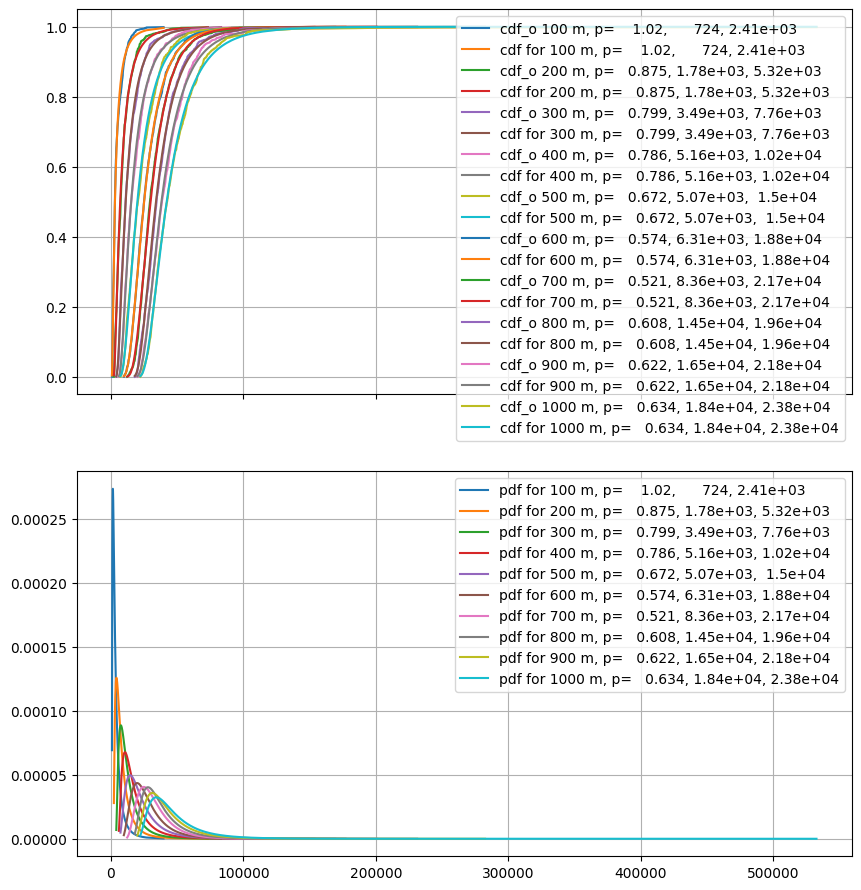

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, figsize=(10, 11))

x = 600
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    # params = stats.norm.fit(t)
    # pdf = stats.norm.pdf(t, *params)

    params = stats.lognorm.fit(t)    
    cdf = stats.lognorm.cdf(t, *params)
    pdf = stats.lognorm.pdf(t, *params)
    
    
    params_str = ', '.join([f"{p:8.3g}" for p in params])
    ax1.plot(t, cdf_o, label=f"cdf_o {x} m, p={params_str}")
    ax1.plot(t, cdf, label=f"cdf for {x} m, p={params_str}")
    ax2.plot(t, pdf, label=f"pdf for {x} m, p={params_str}")

ax1.grid()
ax2.grid()
ax1.legend()
ax2.legend()

100 7.786771347893199 1.0246553756801389 2408.5287138816707
200 8.578886843904515 0.8747158342875754 5318.182262159277
300 8.956537317885482 0.7987065986533104 7758.44586418401
400 9.232932258740727 0.7855524345609577 10228.490161332396
500 9.61465690914106 0.6720018336214248 14982.78132617783
600 9.84382103070741 0.573887938408825 18841.572877404753
700 9.983692039613281 0.5206536907904354 21670.172170629885
800 9.883753111157079 0.6084412969544101 19609.18016160476
900 9.9878946876812 0.621657418080985 21761.43591821358
1000 10.076190994550572 0.6337081355017692 23770.271792400683


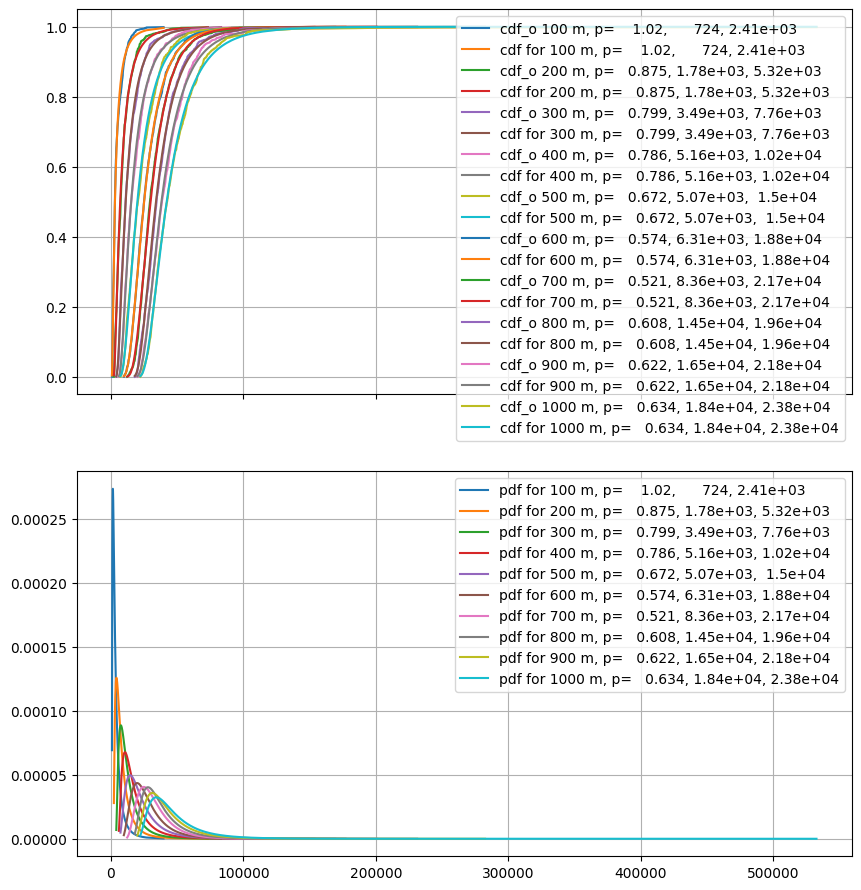

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, figsize=(10, 11))

x = 600
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    # params = stats.norm.fit(t)
    # pdf = stats.norm.pdf(t, *params)

    params = stats.lognorm.fit(t)    
    cdf = stats.lognorm.cdf(t, *params)
    pdf = stats.lognorm.pdf(t, *params)

    shape, loc, scale = params
    mu = np.log(scale)
    sigma = shape 
    print(x, mu, sigma, scale)  
    
    params_str = ', '.join([f"{p:8.3g}" for p in params])
    ax1.plot(t, cdf_o, label=f"cdf_o {x} m, p={params_str}")
    ax1.plot(t, cdf, label=f"cdf for {x} m, p={params_str}")
    ax2.plot(t, pdf, label=f"pdf for {x} m, p={params_str}")

ax1.grid()
ax2.grid()
ax1.legend()
ax2.legend()

100 8.14177515553921 0.7507288334726284 3435.01013629724
200 8.93806836387247 0.6297647758738237 7616.470587386094
300 9.393288438952208 0.5403202240178818 12007.520477766804
400 9.70757600586196 0.5111763416627944 16441.698952200415
500 9.948338143689906 0.4903336155280522 20917.43171535424
600 10.163141767302154 0.42399548933998044 25929.634098373343
700 10.336502163115455 0.3733998696102176 30837.974971400785
800 10.481040074383877 0.3491076809040532 35633.44971337441
900 10.597425003863622 0.35373567068536627 40031.623324550616
1000 10.697024519643763 0.36039269223952264 44224.07131198373


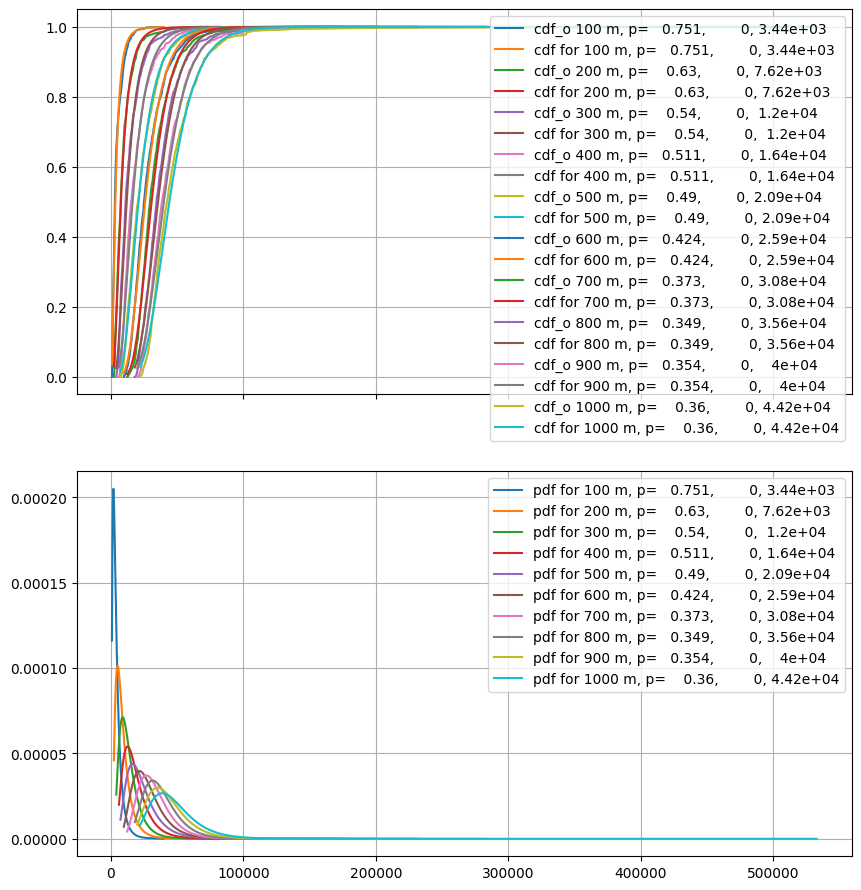

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, figsize=(10, 11))

x = 600
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    # params = stats.norm.fit(t)
    # pdf = stats.norm.pdf(t, *params)

    params = stats.lognorm.fit(t, floc=0)    
    cdf = stats.lognorm.cdf(t, *params)
    pdf = stats.lognorm.pdf(t, *params)

    shape, loc, scale = params
    mu = np.log(scale)
    sigma = shape 
    print(x, mu, sigma, scale)  
    
    params_str = ', '.join([f"{p:8.3g}" for p in params])
    ax1.plot(t, cdf_o, label=f"cdf_o {x} m, p={params_str}")
    ax1.plot(t, cdf, label=f"cdf for {x} m, p={params_str}")
    ax2.plot(t, pdf, label=f"pdf for {x} m, p={params_str}")

ax1.grid()
ax2.grid()
ax1.legend()
ax2.legend()

100 8.14177515553921 0.7507288334726284 3435.01013629724
200 8.93806836387247 0.6297647758738237 7616.470587386094
300 9.393288438952208 0.5403202240178818 12007.520477766804
400 9.70757600586196 0.5111763416627944 16441.698952200415
500 9.948338143689906 0.4903336155280522 20917.43171535424
600 10.163141767302154 0.42399548933998044 25929.634098373343
700 10.336502163115455 0.3733998696102176 30837.974971400785
800 10.481040074383877 0.3491076809040532 35633.44971337441
900 10.597425003863622 0.35373567068536627 40031.623324550616
1000 10.697024519643763 0.36039269223952264 44224.07131198373


<ipython-input-83-b1422e6000da>:41: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()


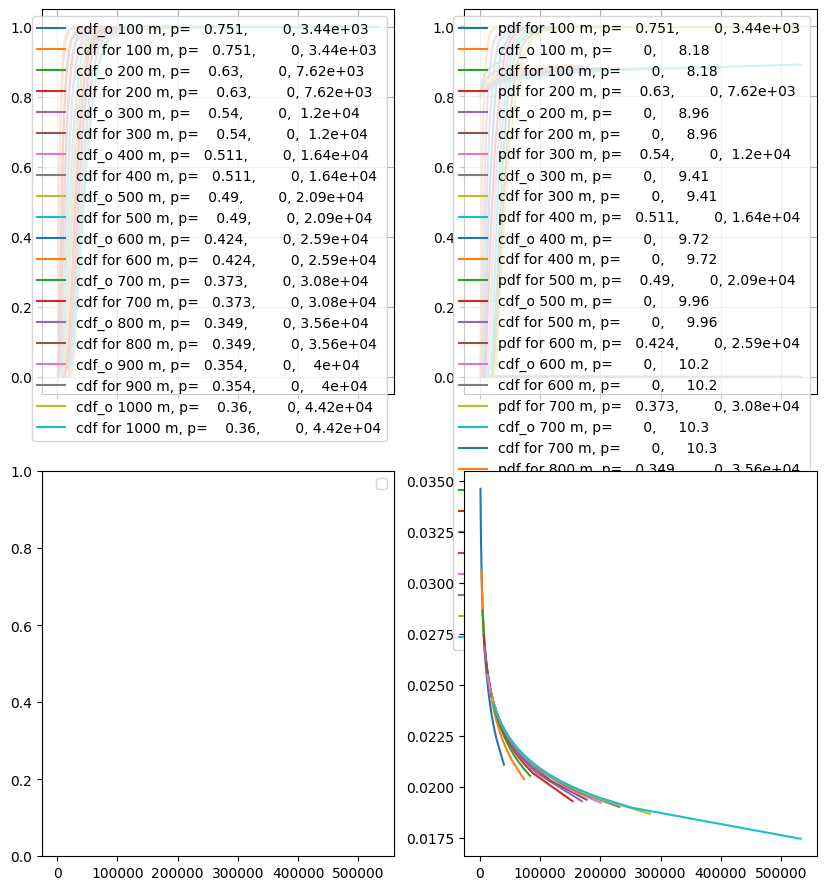

In [ ]:
fig, axs = plt.subplots(2, 2, sharex=True, figsize=(10, 11))

ax1, ax2, ax3, ax4 = axs.flatten()

x = 600
musigmascale = []
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    # params = stats.norm.fit(t)
    # pdf = stats.norm.pdf(t, *params)

    params_lognorm = stats.lognorm.fit(t, floc=0)    
    cdf_lognorm = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm = stats.lognorm.pdf(t, *params_lognorm)

    params_norm = stats.norm.fit(np.log(t), floc=0)    
    cdf_norm = stats.norm.cdf(np.log(t), *params_norm)
    pdf_norm = stats.norm.pdf(np.log(t), *params_norm)

    shape, loc, scale = params_lognorm
    mu = np.log(scale)
    sigma = shape 
    mu
    print(x, mu, sigma, scale)  
    
    params_str_lognorm = ', '.join([f"{p:8.3g}" for p in params_lognorm])
    ax1.plot(t, cdf_o, label=f"cdf_o {x} m, p={params_str_lognorm}")
    ax1.plot(t, cdf_lognorm, label=f"cdf for {x} m, p={params_str_lognorm}")
    ax2.plot(t, pdf_lognorm, label=f"pdf for {x} m, p={params_str_lognorm}")

    params_str_norm = ', '.join([f"{p:8.3g}" for p in params_norm])
    ax2.plot(t, cdf_o, label=f"cdf_o {x} m, p={params_str_norm}")
    ax2.plot(t, cdf_norm, label=f"cdf for {x} m, p={params_str_norm}")
    ax4.plot(t, pdf_norm, label=f"pdf for {x} m, p={params_str_norm}")

for ax in [ax1, ax2, ax3, ax3]:
    ax.grid()
    ax.legend()

100 7.786771347893199 1.0246553756801389 2408.5287138816707
200 8.578886843904515 0.8747158342875754 5318.182262159277
300 8.956537317885482 0.7987065986533104 7758.44586418401
400 9.232932258740727 0.7855524345609577 10228.490161332396
500 9.61465690914106 0.6720018336214248 14982.78132617783
600 9.84382103070741 0.573887938408825 18841.572877404753
700 9.983692039613281 0.5206536907904354 21670.172170629885
800 9.883753111157079 0.6084412969544101 19609.18016160476
900 9.9878946876812 0.621657418080985 21761.43591821358
1000 10.076190994550572 0.6337081355017692 23770.271792400683


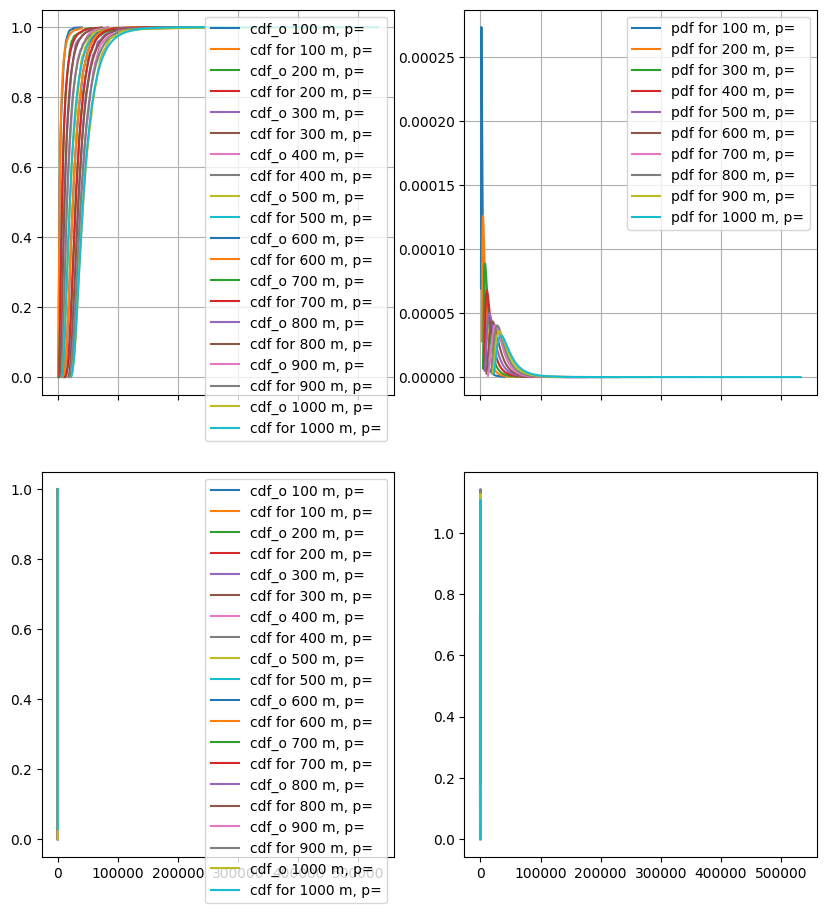

In [ ]:
fig, axs = plt.subplots(2, 2, sharex=True, figsize=(10, 11))

ax1, ax2, ax3, ax4 = axs.flatten()

x = 600
musigmascale = []
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    # params = stats.norm.fit(t)
    # pdf = stats.norm.pdf(t, *params)

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm = stats.lognorm.pdf(t, *params_lognorm)

    params_norm = stats.norm.fit(np.log(t))    
    cdf_norm = stats.norm.cdf(np.log(t), *params_norm)
    pdf_norm = stats.norm.pdf(np.log(t), *params_norm)

    shape, loc, scale = params_lognorm
    mu = np.log(scale)
    sigma = shape 
    mu
    print(x, mu, sigma, scale)  
    
    params_str_lognorm = '' # ', '.join([f"{p:8.3g}" for p in params_lognorm])
    ax1.plot(t, cdf_o, label=f"cdf_o {x} m, p={params_str_lognorm}")
    ax1.plot(t, cdf_lognorm, label=f"cdf for {x} m, p={params_str_lognorm}")
    ax2.plot(t, pdf_lognorm, label=f"pdf for {x} m, p={params_str_lognorm}")

    params_str_norm =  '' #', '.join([f"{p:8.3g}" for p in params_norm])
    ax3.plot(np.log(t), cdf_o, label=f"cdf_o {x} m, p={params_str_norm}")
    ax3.plot(np.log(t), cdf_norm, label=f"cdf for {x} m, p={params_str_norm}")
    ax4.plot(np.log(t), pdf_norm, label=f"pdf for {x} m, p={params_str_norm}")

for ax in [ax1, ax2, ax3, ax3]:
    ax.grid()
    ax.legend()

100 7.786771347893199 1.0246553756801389 2408.5287138816707
200 8.578886843904515 0.8747158342875754 5318.182262159277
300 8.956537317885482 0.7987065986533104 7758.44586418401
400 9.232932258740727 0.7855524345609577 10228.490161332396
500 9.61465690914106 0.6720018336214248 14982.78132617783
600 9.84382103070741 0.573887938408825 18841.572877404753
700 9.983692039613281 0.5206536907904354 21670.172170629885
800 9.883753111157079 0.6084412969544101 19609.18016160476
900 9.9878946876812 0.621657418080985 21761.43591821358
1000 10.076190994550572 0.6337081355017692 23770.271792400683


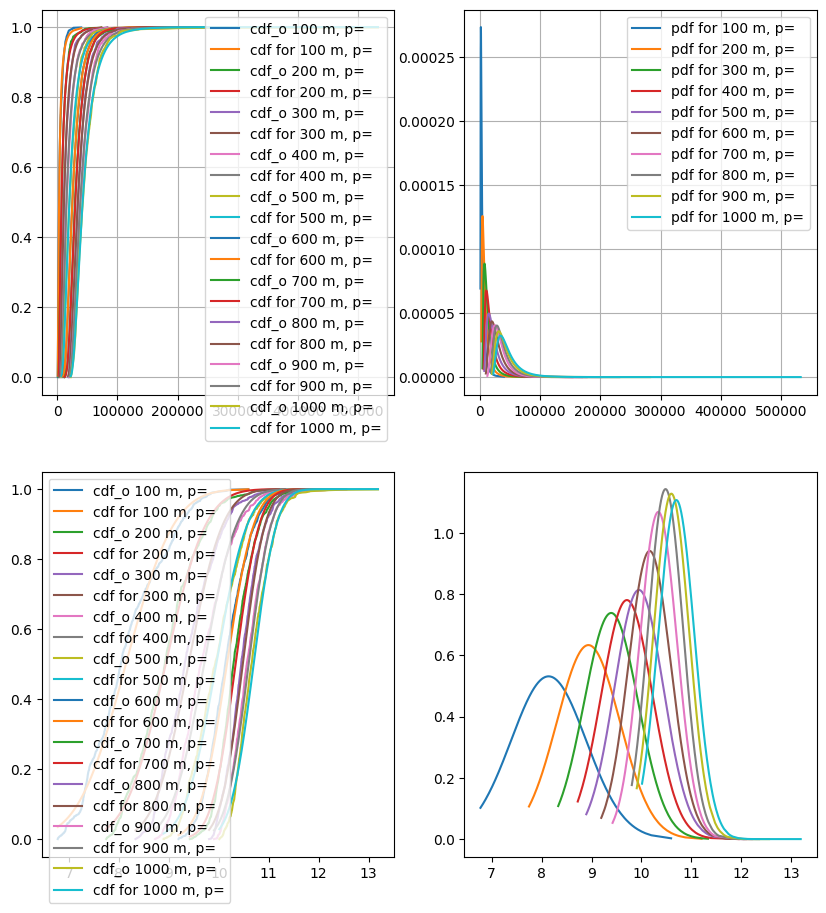

In [ ]:
fig, axs = plt.subplots(2, 2, sharex=False, figsize=(10, 11))

ax1, ax2, ax3, ax4 = axs.flatten()

x = 600
musigmascale = []
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    # params = stats.norm.fit(t)
    # pdf = stats.norm.pdf(t, *params)

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm = stats.lognorm.pdf(t, *params_lognorm)

    params_norm = stats.norm.fit(np.log(t))    
    cdf_norm = stats.norm.cdf(np.log(t), *params_norm)
    pdf_norm = stats.norm.pdf(np.log(t), *params_norm)

    shape, loc, scale = params_lognorm
    mu = np.log(scale)
    sigma = shape 
    mu
    print(x, mu, sigma, scale)  
    
    params_str_lognorm = '' # ', '.join([f"{p:8.3g}" for p in params_lognorm])
    ax1.plot(t, cdf_o, label=f"cdf_o {x} m, p={params_str_lognorm}")
    ax1.plot(t, cdf_lognorm, label=f"cdf for {x} m, p={params_str_lognorm}")
    ax2.plot(t, pdf_lognorm, label=f"pdf for {x} m, p={params_str_lognorm}")

    params_str_norm =  '' #', '.join([f"{p:8.3g}" for p in params_norm])
    ax3.plot(np.log(t), cdf_o, label=f"cdf_o {x} m, p={params_str_norm}")
    ax3.plot(np.log(t), cdf_norm, label=f"cdf for {x} m, p={params_str_norm}")
    ax4.plot(np.log(t), pdf_norm, label=f"pdf for {x} m, p={params_str_norm}")

for ax in [ax1, ax2, ax3, ax3]:
    ax.grid()
    ax.legend()

100 7.786771347893199 1.0246553756801389 2408.5287138816707
200 8.578886843904515 0.8747158342875754 5318.182262159277
300 8.956537317885482 0.7987065986533104 7758.44586418401
400 9.232932258740727 0.7855524345609577 10228.490161332396
500 9.61465690914106 0.6720018336214248 14982.78132617783
600 9.84382103070741 0.573887938408825 18841.572877404753
700 9.983692039613281 0.5206536907904354 21670.172170629885
800 9.883753111157079 0.6084412969544101 19609.18016160476
900 9.9878946876812 0.621657418080985 21761.43591821358
1000 10.076190994550572 0.6337081355017692 23770.271792400683


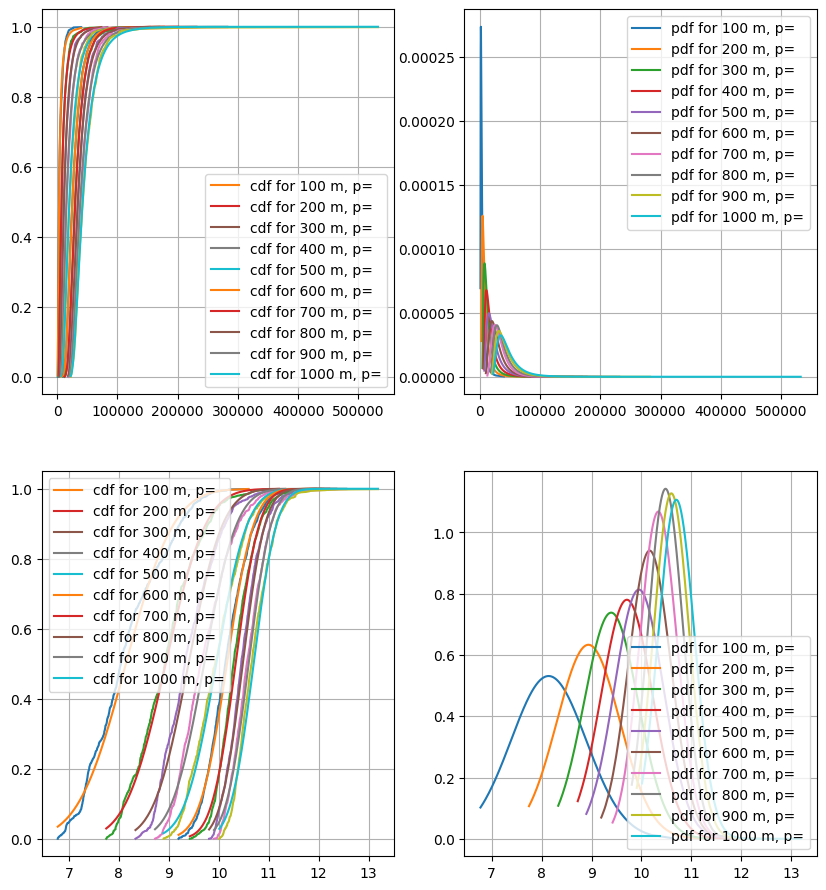

In [ ]:
fig, axs = plt.subplots(2, 2, sharex=False, figsize=(10, 11))

ax1, ax2, ax3, ax4 = axs.flatten()

x = 600
musigmascale = []
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    # params = stats.norm.fit(t)
    # pdf = stats.norm.pdf(t, *params)

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    params_norm = stats.norm.fit(np.log(t))    
    cdf_norm    = stats.norm.cdf(np.log(t), *params_norm)
    pdf_norm    = stats.norm.pdf(np.log(t), *params_norm)

    shape, loc, scale = params_lognorm
    mu = np.log(scale)
    sigma = shape 
    mu
    print(x, mu, sigma, scale)  
    
    params_str_lognorm = '' # ', '.join([f"{p:8.3g}" for p in params_lognorm])
    ax1.plot(t, cdf_o, label="") # cdf_o {x} m, p={params_str_lognorm}")
    ax1.plot(t, cdf_lognorm, label=f"cdf for {x} m, p={params_str_lognorm}")
    ax2.plot(t, pdf_lognorm, label=f"pdf for {x} m, p={params_str_lognorm}")

    params_str_norm =  '' #', '.join([f"{p:8.3g}" for p in params_norm])
    ax3.plot(np.log(t), cdf_o, label='') # f"cdf_o {x} m, p={params_str_norm}")
    ax3.plot(np.log(t), cdf_norm, label=f"cdf for {x} m, p={params_str_norm}")
    ax4.plot(np.log(t), pdf_norm, label=f"pdf for {x} m, p={params_str_norm}")

for ax in [ax1, ax2, ax3, ax4]:
    ax.grid(True)
    ax.legend()

100 7.786771347893199 1.0246553756801389 2408.5287138816707
200 8.578886843904515 0.8747158342875754 5318.182262159277
300 8.956537317885482 0.7987065986533104 7758.44586418401
400 9.232932258740727 0.7855524345609577 10228.490161332396
500 9.61465690914106 0.6720018336214248 14982.78132617783
600 9.84382103070741 0.573887938408825 18841.572877404753
700 9.983692039613281 0.5206536907904354 21670.172170629885
800 9.883753111157079 0.6084412969544101 19609.18016160476
900 9.9878946876812 0.621657418080985 21761.43591821358
1000 10.076190994550572 0.6337081355017692 23770.271792400683


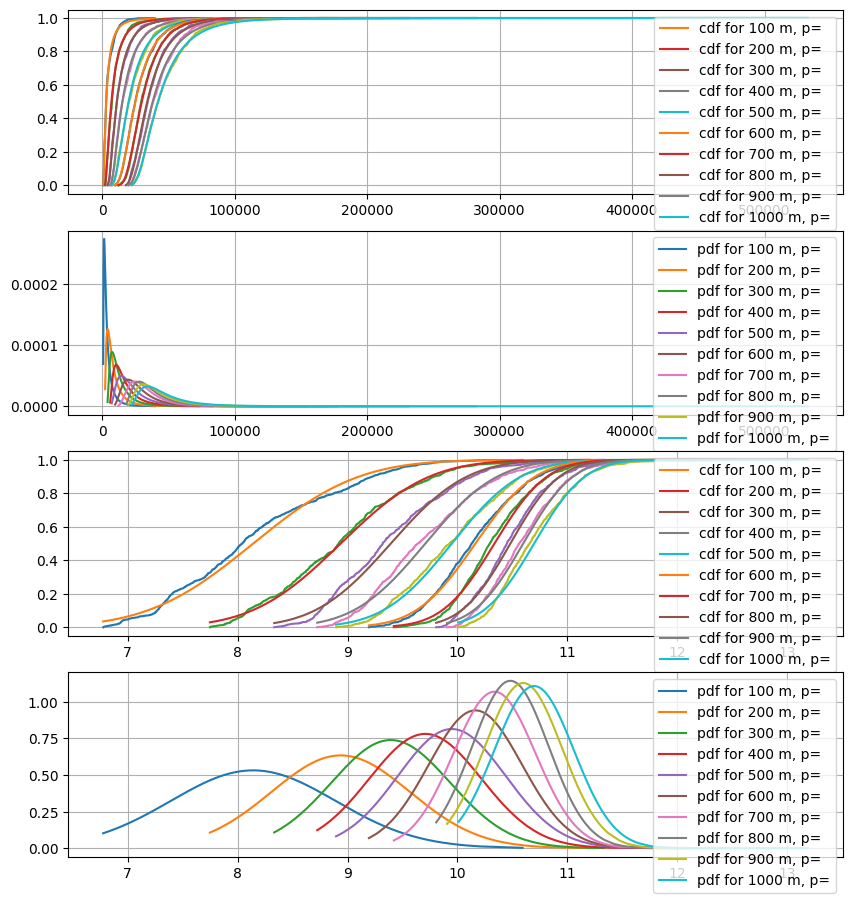

In [ ]:
fig, axs = plt.subplots(4, 1, sharex=False, figsize=(10, 11))

ax1, ax2, ax3, ax4 = axs.flatten()

x = 600
musigmascale = []
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    # params = stats.norm.fit(t)
    # pdf = stats.norm.pdf(t, *params)

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    params_norm = stats.norm.fit(np.log(t))    
    cdf_norm    = stats.norm.cdf(np.log(t), *params_norm)
    pdf_norm    = stats.norm.pdf(np.log(t), *params_norm)

    shape, loc, scale = params_lognorm
    mu = np.log(scale)
    sigma = shape 
    mu
    print(x, mu, sigma, scale)  
    
    params_str_lognorm = '' # ', '.join([f"{p:8.3g}" for p in params_lognorm])
    ax1.plot(t, cdf_o, label="") # cdf_o {x} m, p={params_str_lognorm}")
    ax1.plot(t, cdf_lognorm, label=f"cdf for {x} m, p={params_str_lognorm}")
    ax2.plot(t, pdf_lognorm, label=f"pdf for {x} m, p={params_str_lognorm}")

    params_str_norm =  '' #', '.join([f"{p:8.3g}" for p in params_norm])
    ax3.plot(np.log(t), cdf_o, label='') # f"cdf_o {x} m, p={params_str_norm}")
    ax3.plot(np.log(t), cdf_norm, label=f"cdf for {x} m, p={params_str_norm}")
    ax4.plot(np.log(t), pdf_norm, label=f"pdf for {x} m, p={params_str_norm}")

for ax in [ax1, ax2, ax3, ax4]:
    ax.grid(True)
    ax.legend()

100 7.786771347893199 1.0246553756801389 2408.5287138816707
200 8.578886843904515 0.8747158342875754 5318.182262159277
300 8.956537317885482 0.7987065986533104 7758.44586418401
400 9.232932258740727 0.7855524345609577 10228.490161332396
500 9.61465690914106 0.6720018336214248 14982.78132617783
600 9.84382103070741 0.573887938408825 18841.572877404753
700 9.983692039613281 0.5206536907904354 21670.172170629885
800 9.883753111157079 0.6084412969544101 19609.18016160476
900 9.9878946876812 0.621657418080985 21761.43591821358
1000 10.076190994550572 0.6337081355017692 23770.271792400683


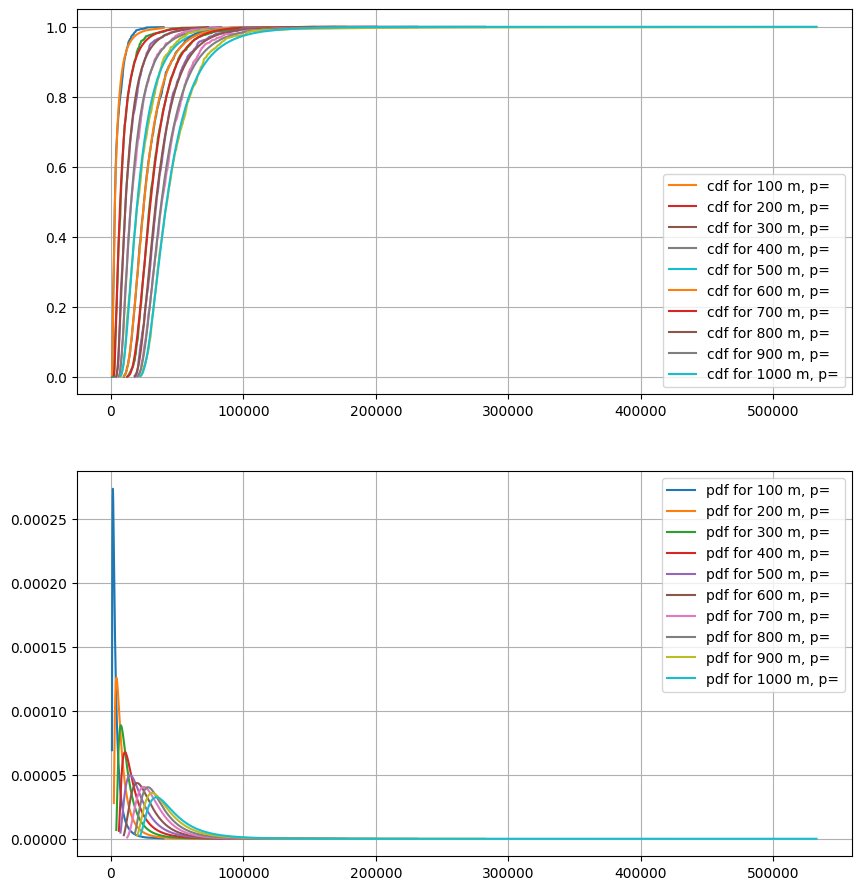

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))

x = 600
musigmascale = []
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm
    mu = np.log(scale)
    sigma = shape 
    mu
    print(x, mu, sigma, scale)  
    
    params_str_lognorm = '' # ', '.join([f"{p:8.3g}" for p in params_lognorm])
    ax1.plot(t, cdf_o, label="") # cdf_o {x} m, p={params_str_lognorm}")
    ax1.plot(t, cdf_lognorm, label=f"cdf for {x} m, p={params_str_lognorm}")
    ax2.plot(t, pdf_lognorm, label=f"pdf for {x} m, p={params_str_lognorm}")

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

100 7.786771347893199 1.0246553756801389 2408.5287138816707
200 8.578886843904515 0.8747158342875754 5318.182262159277
300 8.956537317885482 0.7987065986533104 7758.44586418401
400 9.232932258740727 0.7855524345609577 10228.490161332396
500 9.61465690914106 0.6720018336214248 14982.78132617783
600 9.84382103070741 0.573887938408825 18841.572877404753
700 9.983692039613281 0.5206536907904354 21670.172170629885
800 9.883753111157079 0.6084412969544101 19609.18016160476
900 9.9878946876812 0.621657418080985 21761.43591821358
1000 10.076190994550572 0.6337081355017692 23770.271792400683


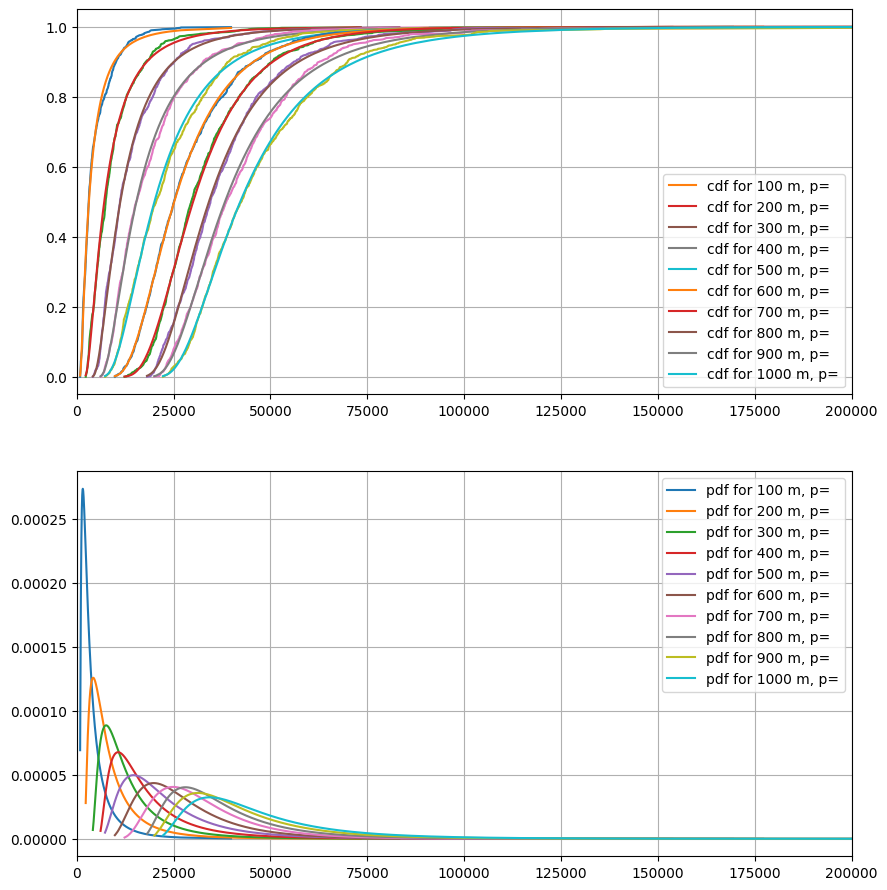

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set_xlim(0, 200000.)
ax2.set_xlim(0, 200000.)

musigmascale = []
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm
    mu = np.log(scale)
    sigma = shape 
    mu
    print(x, mu, sigma, scale)  
    
    params_str_lognorm = '' # ', '.join([f"{p:8.3g}" for p in params_lognorm])
    ax1.plot(t, cdf_o, label="") # cdf_o {x} m, p={params_str_lognorm}")
    ax1.plot(t, cdf_lognorm, label=f"cdf for {x} m, p={params_str_lognorm}")
    ax2.plot(t, pdf_lognorm, label=f"pdf for {x} m, p={params_str_lognorm}")

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

100 7.786771347893199 1.0246553756801389 2408.5287138816707
200 8.578886843904515 0.8747158342875754 5318.182262159277
300 8.956537317885482 0.7987065986533104 7758.44586418401
400 9.232932258740727 0.7855524345609577 10228.490161332396
500 9.61465690914106 0.6720018336214248 14982.78132617783
600 9.84382103070741 0.573887938408825 18841.572877404753
700 9.983692039613281 0.5206536907904354 21670.172170629885
800 9.883753111157079 0.6084412969544101 19609.18016160476
900 9.9878946876812 0.621657418080985 21761.43591821358
1000 10.076190994550572 0.6337081355017692 23770.271792400683


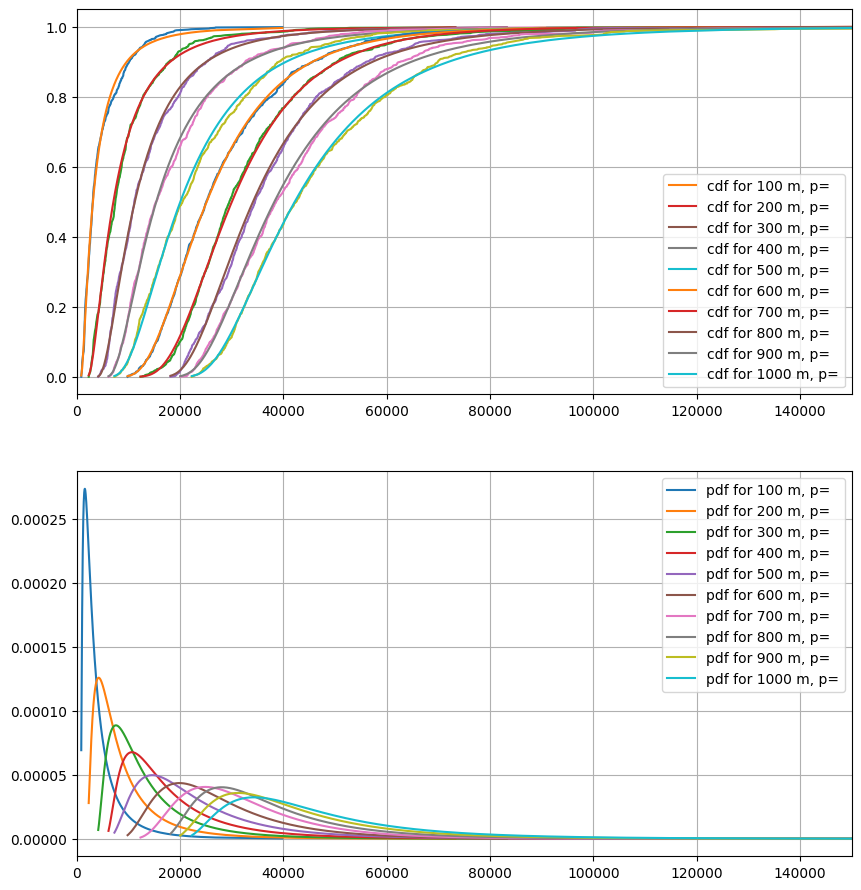

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

musigmascale = []
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm
    mu = np.log(scale)
    sigma = shape 
    mu
    print(x, mu, sigma, scale)  
    
    params_str_lognorm = '' # ', '.join([f"{p:8.3g}" for p in params_lognorm])
    ax1.plot(t, cdf_o, label="") # cdf_o {x} m, p={params_str_lognorm}")
    ax1.plot(t, cdf_lognorm, label=f"cdf for {x} m, p={params_str_lognorm}")
    ax2.plot(t, pdf_lognorm, label=f"pdf for {x} m, p={params_str_lognorm}")

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

100 10.076190994550572 0.6337081355017692 23770.271792400683
200 10.076190994550572 0.6337081355017692 23770.271792400683
300 10.076190994550572 0.6337081355017692 23770.271792400683
400 10.076190994550572 0.6337081355017692 23770.271792400683
500 10.076190994550572 0.6337081355017692 23770.271792400683
600 10.076190994550572 0.6337081355017692 23770.271792400683
700 10.076190994550572 0.6337081355017692 23770.271792400683
800 10.076190994550572 0.6337081355017692 23770.271792400683
900 10.076190994550572 0.6337081355017692 23770.271792400683
1000 10.076190994550572 0.6337081355017692 23770.271792400683


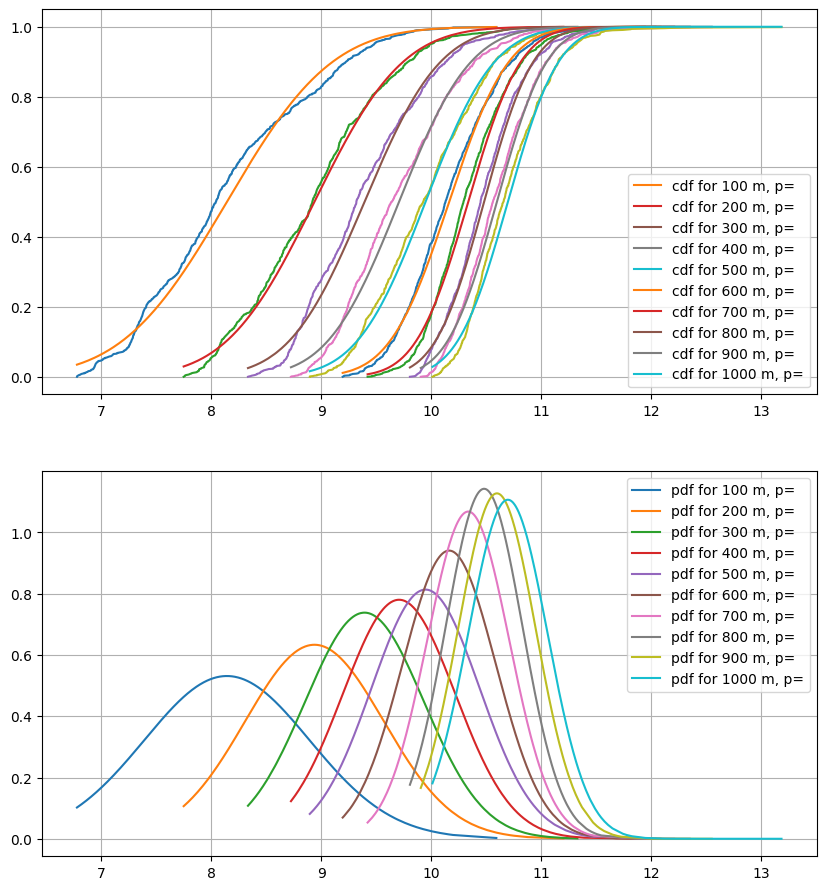

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))

x = 600
musigmascale = []
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    params_norm = stats.norm.fit(np.log(t))    
    cdf_norm    = stats.norm.cdf(np.log(t), *params_norm)
    pdf_norm    = stats.norm.pdf(np.log(t), *params_norm)

    shape, loc, scale = params_lognorm
    mu = np.log(scale)
    sigma = shape 
    mu
    print(x, mu, sigma, scale)  
    
    params_str_norm =  '' #', '.join([f"{p:8.3g}" for p in params_norm])
    ax1.plot(np.log(t), cdf_o, label='') # f"cdf_o {x} m, p={params_str_norm}")
    ax1.plot(np.log(t), cdf_norm, label=f"cdf for {x} m, p={params_str_norm}")
    ax2.plot(np.log(t), pdf_norm, label=f"pdf for {x} m, p={params_str_norm}")

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

In [ ]:
params_norm

(np.float64(10.697024519643763), np.float64(0.36039269223952264))

100 8.14177515553921 0.7507288334726284 23770.271792400683
x     mu         sigma     
  100       8.14      0.751
200 8.93806836387247 0.6297647758738237 23770.271792400683
x     mu         sigma     
  200       8.94       0.63
300 9.393288438952208 0.5403202240178818 23770.271792400683
x     mu         sigma     
  300       9.39       0.54
400 9.70757600586196 0.5111763416627944 23770.271792400683
x     mu         sigma     
  400       9.71      0.511
500 9.948338143689906 0.4903336155280522 23770.271792400683
x     mu         sigma     
  500       9.95       0.49
600 10.163141767302154 0.42399548933998044 23770.271792400683
x     mu         sigma     
  600       10.2      0.424
700 10.336502163115455 0.3733998696102176 23770.271792400683
x     mu         sigma     
  700       10.3      0.373
800 10.481040074383877 0.3491076809040532 23770.271792400683
x     mu         sigma     
  800       10.5      0.349
900 10.597425003863622 0.35373567068536627 23770.271792400683
x     mu 

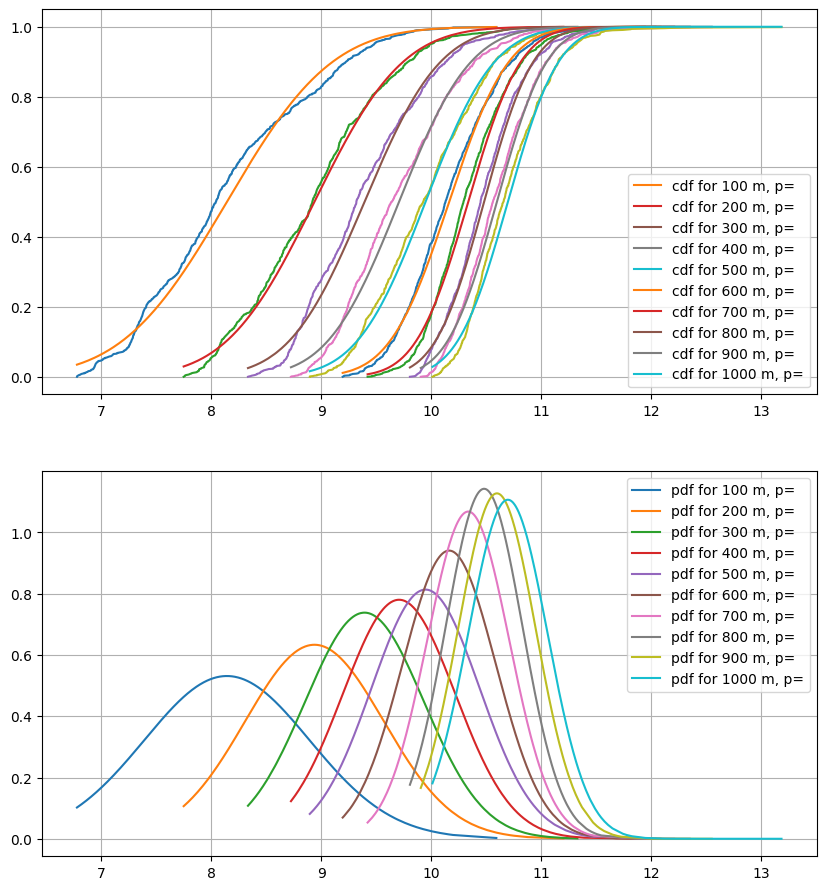

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))

x = 600
musigmascale = []
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    params_norm = stats.norm.fit(np.log(t))    
    cdf_norm    = stats.norm.cdf(np.log(t), *params_norm)
    pdf_norm    = stats.norm.pdf(np.log(t), *params_norm)

    mu, sigma = params_norm
    print(x, mu, sigma, scale)
    print("{:5s} {:10s} {:10s}".format('x', 'mu', 'sigma'))
    print("{:5d} {:10.3g} {:10.3g}".format(x, mu, sigma))
    
    params_str_norm =  '' #', '.join([f"{p:8.3g}" for p in params_norm])
    ax1.plot(np.log(t), cdf_o, label='') # f"cdf_o {x} m, p={params_str_norm}")
    ax1.plot(np.log(t), cdf_norm, label=f"cdf for {x} m, p={params_str_norm}")
    ax2.plot(np.log(t), pdf_norm, label=f"pdf for {x} m, p={params_str_norm}")

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  100       7.79       1.02   2.41e+03
  200       8.58      0.875   5.32e+03
  300       8.96      0.799   7.76e+03
  400       9.23      0.786   1.02e+04
  500       9.61      0.672    1.5e+04
  600       9.84      0.574   1.88e+04
  700       9.98      0.521   2.17e+04
  800       9.88      0.608   1.96e+04
  900       9.99      0.622   2.18e+04
 1000       10.1      0.634   2.38e+04


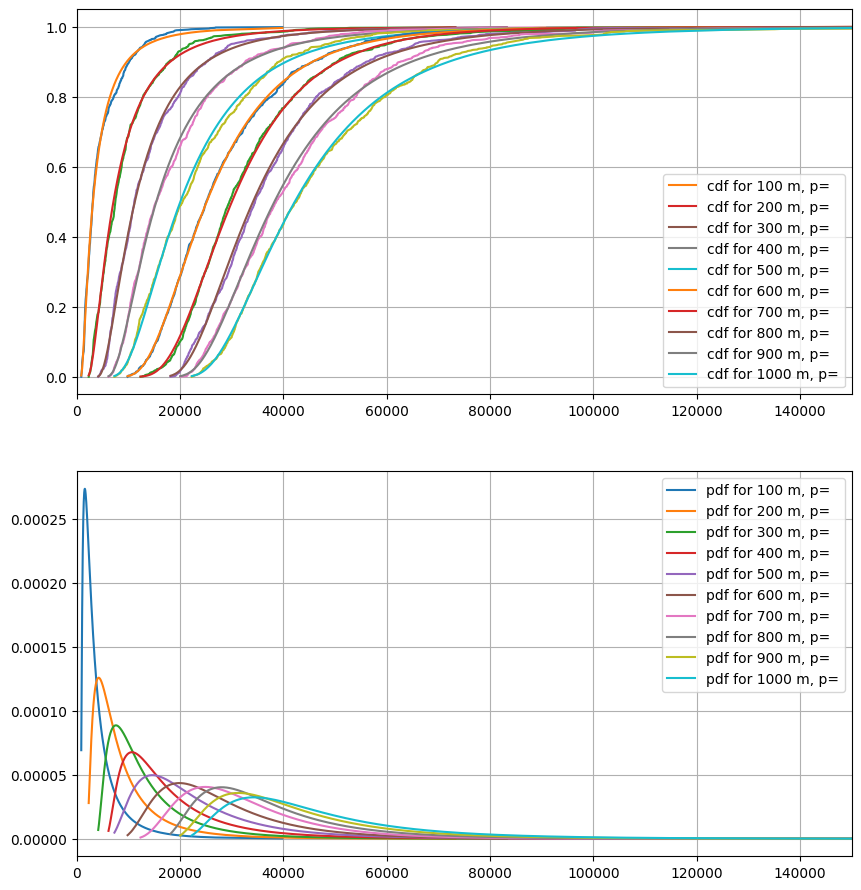

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

musigmascale = []
print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm
    mu = np.log(scale)
    sigma = shape 
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, scale))
    
    params_str_lognorm = '' # ', '.join([f"{p:8.3g}" for p in params_lognorm])
    ax1.plot(t, cdf_o, label="") # cdf_o {x} m, p={params_str_lognorm}")
    ax1.plot(t, cdf_lognorm, label=f"cdf for {x} m, p={params_str_lognorm}")
    ax2.plot(t, pdf_lognorm, label=f"pdf for {x} m, p={params_str_lognorm}")

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma     
  100       8.14      0.751
  200       8.94       0.63
  300       9.39       0.54
  400       9.71      0.511
  500       9.95       0.49
  600       10.2      0.424
  700       10.3      0.373
  800       10.5      0.349
  900       10.6      0.354
 1000       10.7       0.36


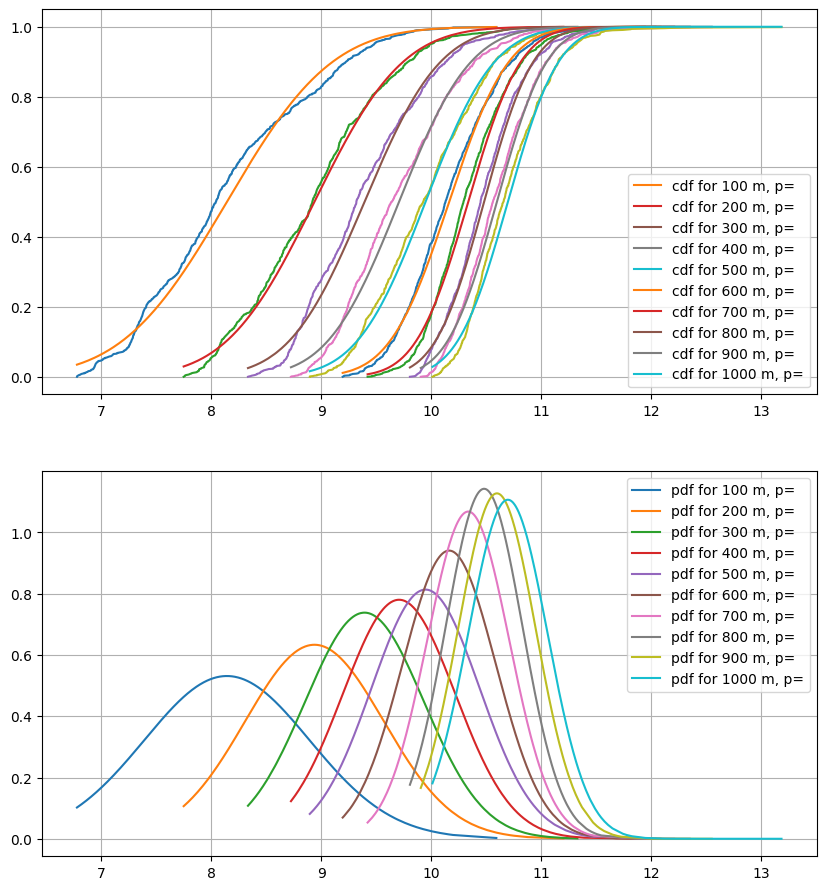

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))

x = 600
musigmascale = []

print("{:5s} {:10s} {:10s}".format('x', 'mu', 'sigma'))
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    params_norm = stats.norm.fit(np.log(t))    
    cdf_norm    = stats.norm.cdf(np.log(t), *params_norm)
    pdf_norm    = stats.norm.pdf(np.log(t), *params_norm)

    mu, sigma = params_norm
    print("{:5d} {:10.3g} {:10.3g}".format(x, mu, sigma))
    
    params_str_norm =  '' #', '.join([f"{p:8.3g}" for p in params_norm])
    ax1.plot(np.log(t), cdf_o, label='') # f"cdf_o {x} m, p={params_str_norm}")
    ax1.plot(np.log(t), cdf_norm, label=f"cdf for {x} m, p={params_str_norm}")
    ax2.plot(np.log(t), pdf_norm, label=f"pdf for {x} m, p={params_str_norm}")

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  100       7.79       1.02   2.41e+03


AttributeError: Line2D.set() got an unexpected keyword argument 'labelf'

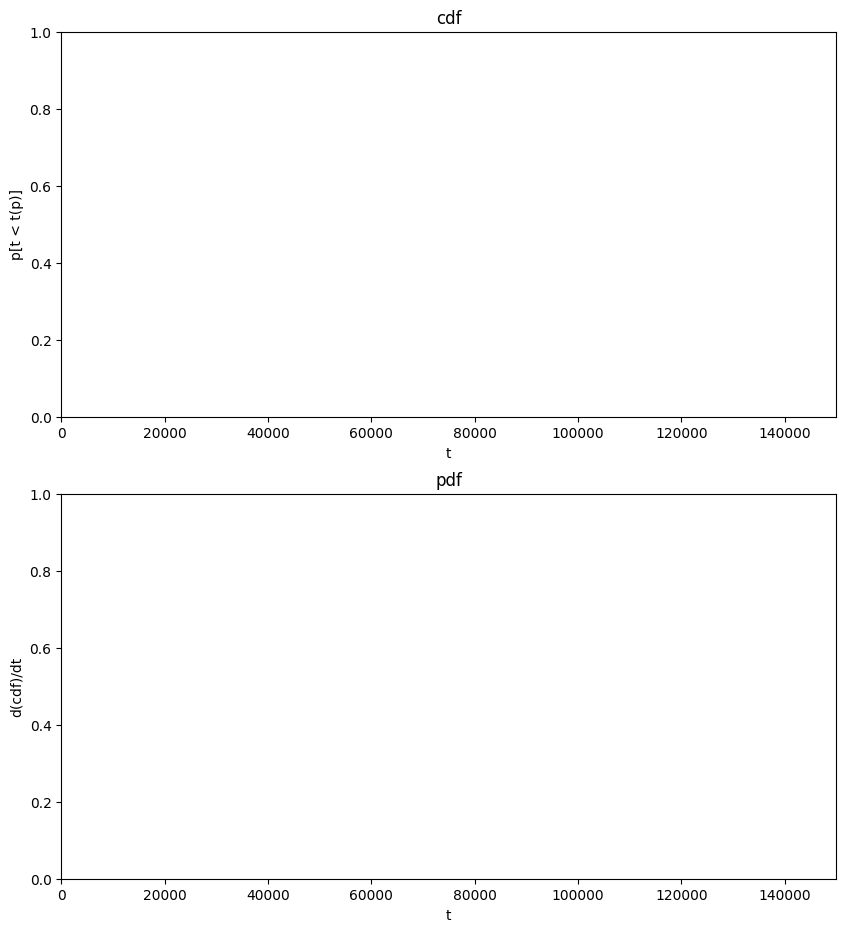

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

musigmascale = []
print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm
    mu = np.log(scale)
    sigma = shape 
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, scale))
    
    ax1.plot(t, cdf_o, labelf="cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, label=fr"cdf, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},loc{loc:.4g}")
    ax2.plot(t, pdf_lognorm, label=fr"pdf, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},loc{loc:.4g}")

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  100       7.79       1.02   2.41e+03
  200       8.58      0.875   5.32e+03
  300       8.96      0.799   7.76e+03
  400       9.23      0.786   1.02e+04
  500       9.61      0.672    1.5e+04
  600       9.84      0.574   1.88e+04
  700       9.98      0.521   2.17e+04
  800       9.88      0.608   1.96e+04
  900       9.99      0.622   2.18e+04
 1000       10.1      0.634   2.38e+04


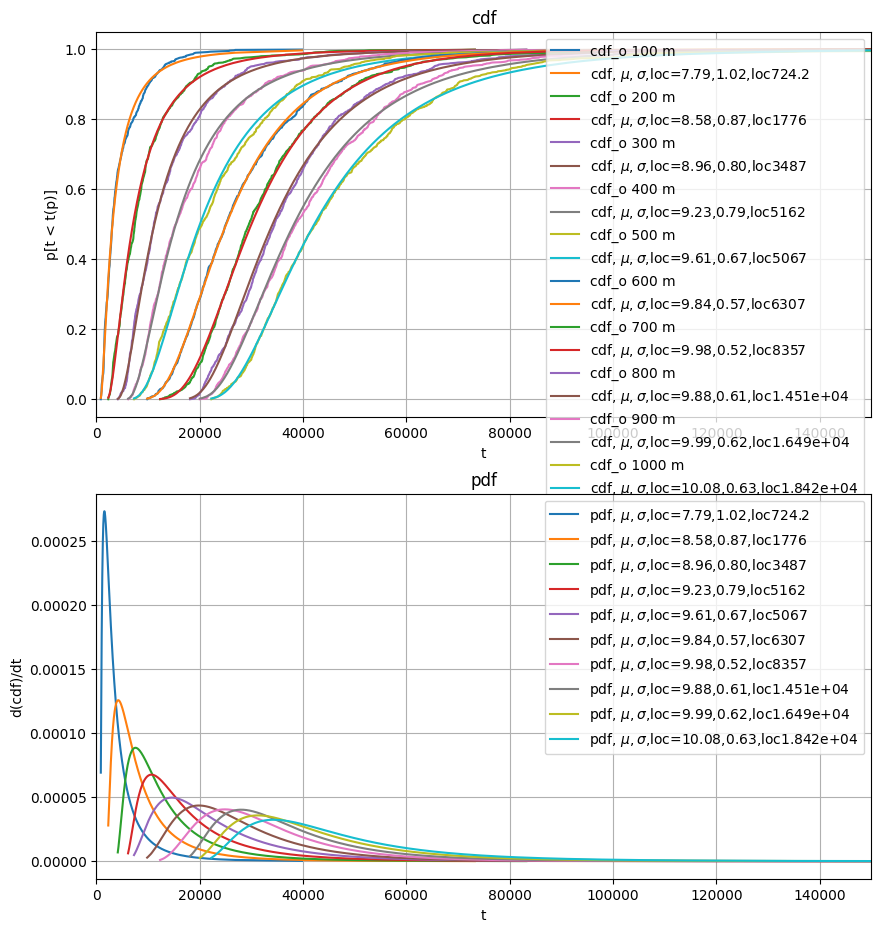

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

musigmascale = []
print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm
    mu = np.log(scale)
    sigma = shape 
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, scale))
    
    ax1.plot(t, cdf_o, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, label=fr"cdf, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},loc{loc:.4g}")
    ax2.plot(t, pdf_lognorm, label=fr"pdf, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},loc{loc:.4g}")

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma     
  100       8.14      0.751
  200       8.94       0.63
  300       9.39       0.54
  400       9.71      0.511
  500       9.95       0.49
  600       10.2      0.424
  700       10.3      0.373
  800       10.5      0.349
  900       10.6      0.354
 1000       10.7       0.36


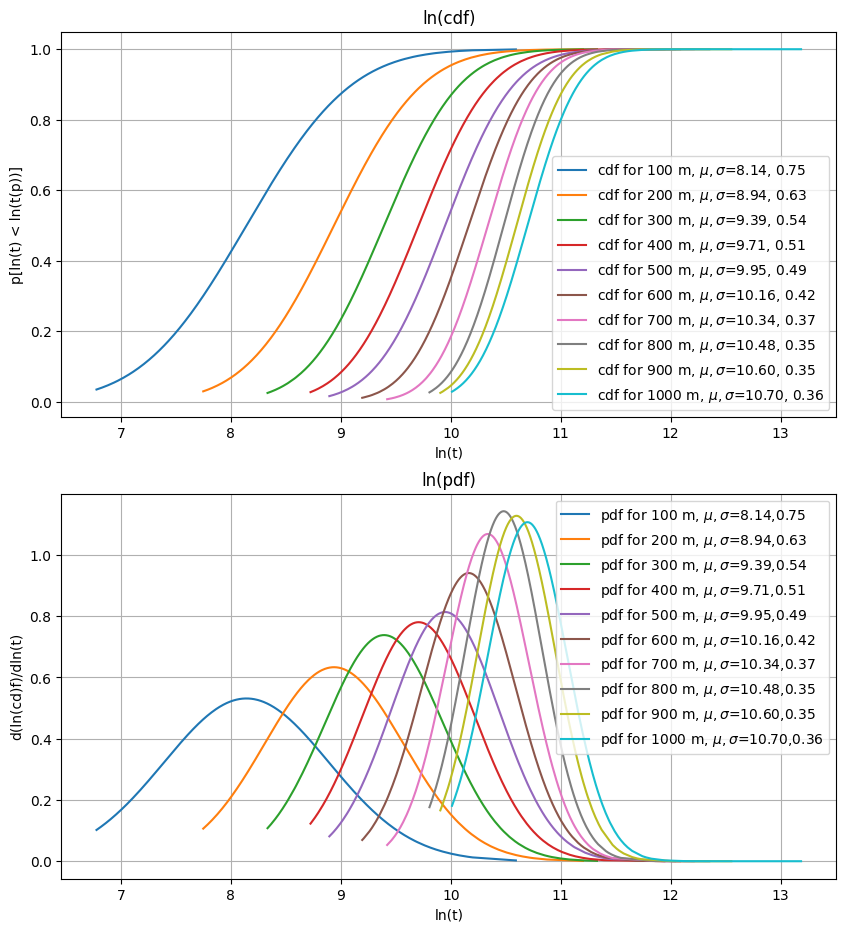

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='ln(cdf)', xlabel='ln(t)', ylabel='p[ln(t) < ln(t(p))]') 
ax2.set(title='ln(pdf)', xlabel='ln(t)', ylabel='d(ln(cd)f)/dln(t)') 

musigmascale = []
print("{:5s} {:10s} {:10s}".format('x', 'mu', 'sigma'))
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    params_norm = stats.norm.fit(np.log(t))    
    cdf_norm    = stats.norm.cdf(np.log(t), *params_norm)
    pdf_norm    = stats.norm.pdf(np.log(t), *params_norm)

    mu, sigma = params_norm
    print("{:5d} {:10.3g} {:10.3g}".format(x, mu, sigma))
        
    ax1.plot(np.log(t), cdf_norm, label=fr"cdf for {x} m, $\mu,\sigma$={mu:.2f}, {sigma:.2f}")
    ax2.plot(np.log(t), pdf_norm, label=fr"pdf for {x} m, $\mu,\sigma$={mu:.2f},{sigma:.2f}")

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  100       7.79       1.02   2.41e+03
  200       8.58      0.875   5.32e+03
  300       8.96      0.799   7.76e+03
  400       9.23      0.786   1.02e+04
  500       9.61      0.672    1.5e+04
  600       9.84      0.574   1.88e+04
  700       9.98      0.521   2.17e+04
  800       9.88      0.608   1.96e+04
  900       9.99      0.622   2.18e+04
 1000       10.1      0.634   2.38e+04


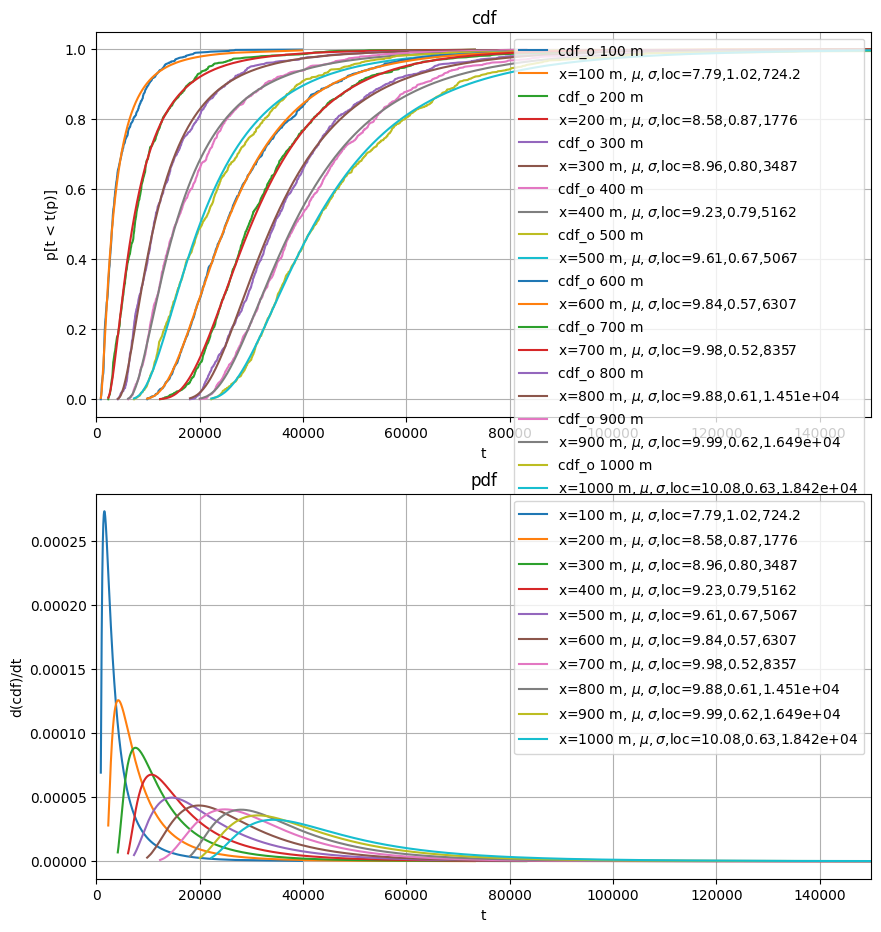

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

musigmascale = []
print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm
    mu = np.log(scale)
    sigma = shape 
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, scale))
    
    ax1.plot(t, cdf_o, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.4g}")
    ax2.plot(t, pdf_lognorm, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.4g}")

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma     
  100       8.14      0.751
  200       8.94       0.63
  300       9.39       0.54
  400       9.71      0.511
  500       9.95       0.49
  600       10.2      0.424
  700       10.3      0.373
  800       10.5      0.349
  900       10.6      0.354
 1000       10.7       0.36


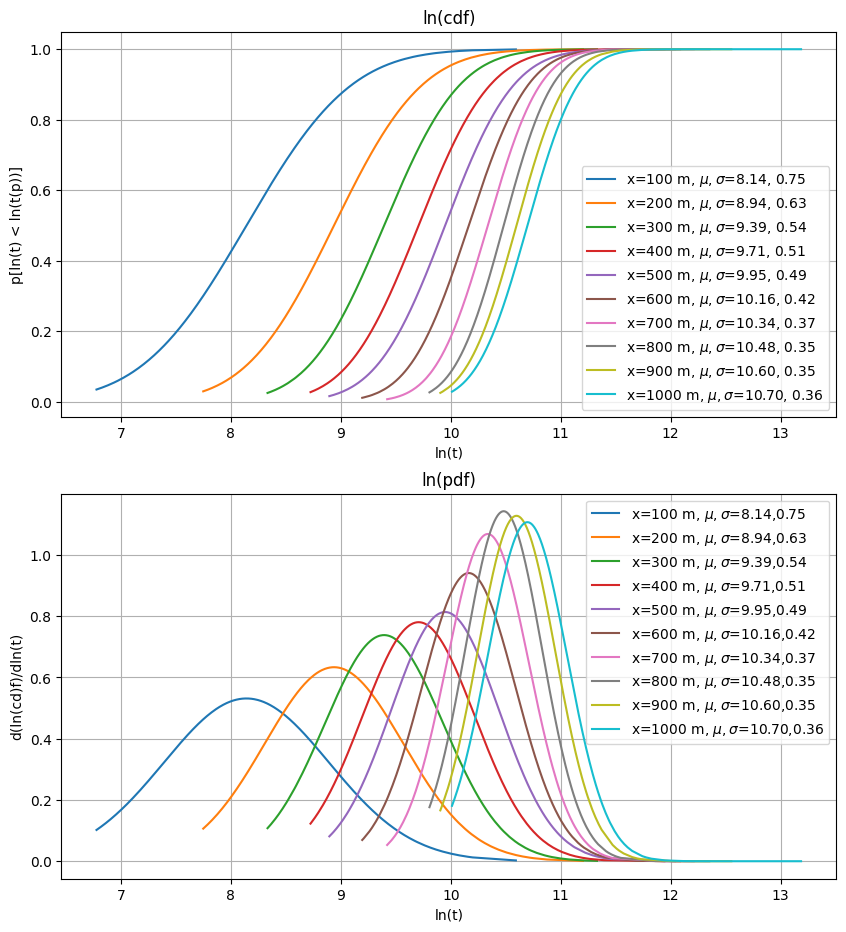

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='ln(cdf)', xlabel='ln(t)', ylabel='p[ln(t) < ln(t(p))]') 
ax2.set(title='ln(pdf)', xlabel='ln(t)', ylabel='d(ln(cd)f)/dln(t)') 

musigmascale = []
print("{:5s} {:10s} {:10s}".format('x', 'mu', 'sigma'))
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    params_norm = stats.norm.fit(np.log(t))    
    cdf_norm    = stats.norm.cdf(np.log(t), *params_norm)
    pdf_norm    = stats.norm.pdf(np.log(t), *params_norm)

    mu, sigma = params_norm
    print("{:5d} {:10.3g} {:10.3g}".format(x, mu, sigma))
        
    ax1.plot(np.log(t), cdf_norm, label=fr"x={x} m, $\mu,\sigma$={mu:.2f}, {sigma:.2f}")
    ax2.plot(np.log(t), pdf_norm, label=fr"x={x} m, $\mu,\sigma$={mu:.2f},{sigma:.2f}")

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  100       7.79       1.02   2.41e+03
  200       8.58      0.875   5.32e+03
  300       8.96      0.799   7.76e+03
  400       9.23      0.786   1.02e+04
  500       9.61      0.672    1.5e+04
  600       9.84      0.574   1.88e+04
  700       9.98      0.521   2.17e+04
  800       9.88      0.608   1.96e+04
  900       9.99      0.622   2.18e+04
 1000       10.1      0.634   2.38e+04


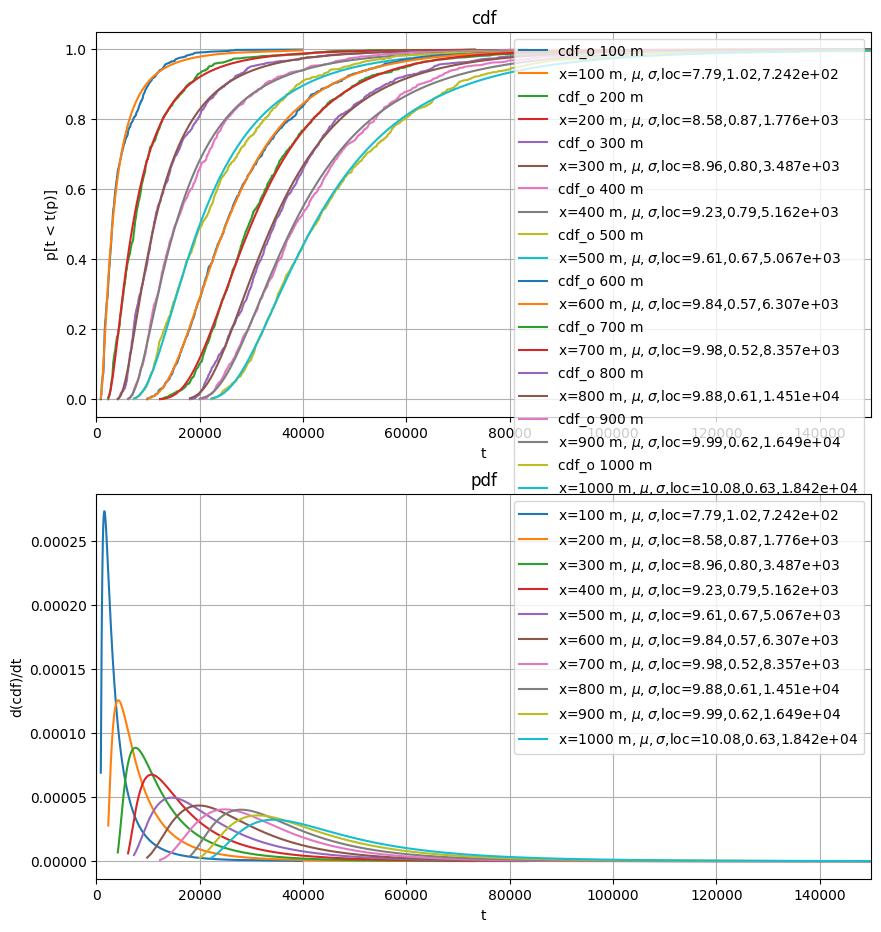

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

musigmascale = []
print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))
for x in cumulatives:
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm
    mu = np.log(scale)
    sigma = shape 
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, scale))
    
    ax1.plot(t, cdf_o, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     


TypeError: int() argument must be a string, a bytes-like object or a real number, not 'list'

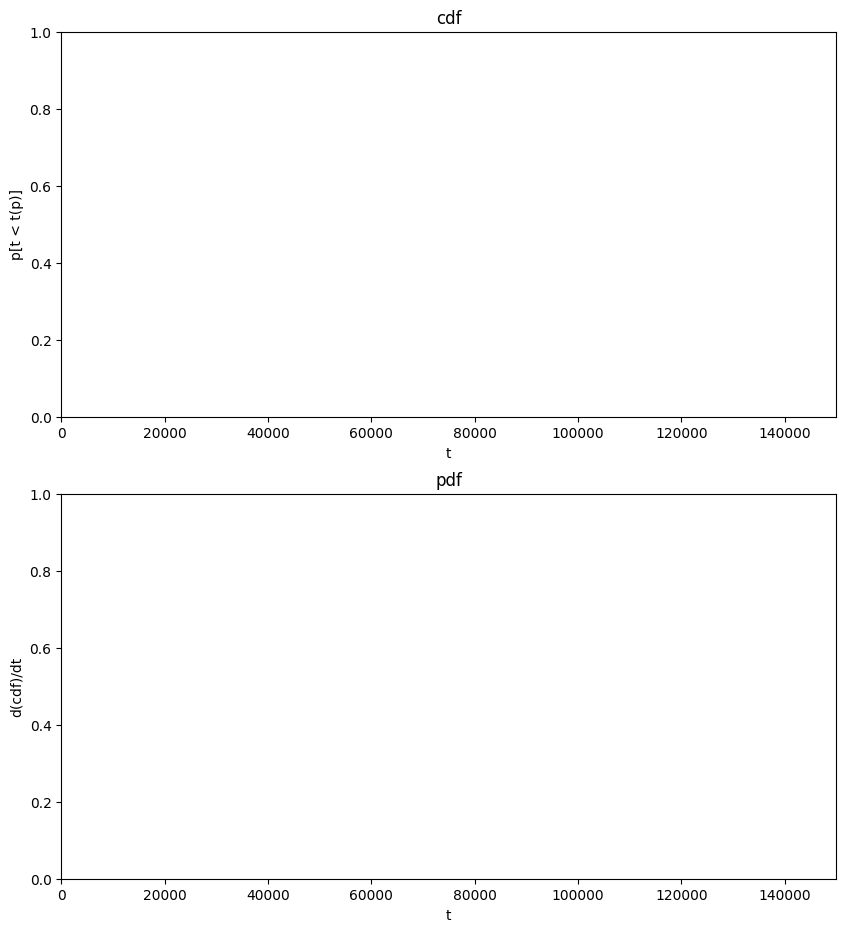

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8')])
musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))
for ix, x in enumerate(cumulatives):
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm
    mu = np.log(scale)
    sigma = shape 
    musigmaloc[ix] = [x, mu, sigma, loc]
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    ax1.plot(t, cdf_o, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

In [ ]:
musigmaloc

array([(0, 0., 0., 0.), (0, 0., 0., 0.), (0, 0., 0., 0.), (0, 0., 0., 0.),
       (0, 0., 0., 0.), (0, 0., 0., 0.), (0, 0., 0., 0.), (0, 0., 0., 0.),
       (0, 0., 0., 0.), (0, 0., 0., 0.)],
      dtype=[('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8')])

In [ ]:
musigmaloc[0][:] = [x, mu, sigma, loc]


IndexError: invalid index

In [ ]:
musigmaloc[0]


np.void((0, 0.0, 0.0, 0.0), dtype=[('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8')])

In [ ]:
musigmaloc[0] = np.asarray([x, mu, sigma, loc], dtype=dtype)


ValueError: setting an array element with a sequence.

In [ ]:
np.array([x, mu, sigma, loc], dtype=dtype)


array([(100, 100.        , 100.        , 100.        ),
       (  7,   7.78677135,   7.78677135,   7.78677135),
       (  1,   1.02465538,   1.02465538,   1.02465538),
       (724, 724.18004096, 724.18004096, 724.18004096)],
      dtype=[('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8')])

In [ ]:
x, mu, sigma, loc

(100,
 np.float64(7.786771347893199),
 np.float64(1.0246553756801389),
 724.1800409637432)

In [ ]:
x, mu, sigma, loc = 100, 7.8, 1.02, 724.2
dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8')])
np.array([(x, mu, sigma, loc)], dtype=dtype)


array([(100, 7.8, 1.02, 724.2)],
      dtype=[('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8')])

x     mu         sigma      scale     
  100       7.79       1.02        724
  200       8.58      0.875   1.78e+03
  300       8.96      0.799   3.49e+03
  400       9.23      0.786   5.16e+03
  500       9.61      0.672   5.07e+03
  600       9.84      0.574   6.31e+03
  700       9.98      0.521   8.36e+03
  800       9.88      0.608   1.45e+04
  900       9.99      0.622   1.65e+04
 1000       10.1      0.634   1.84e+04


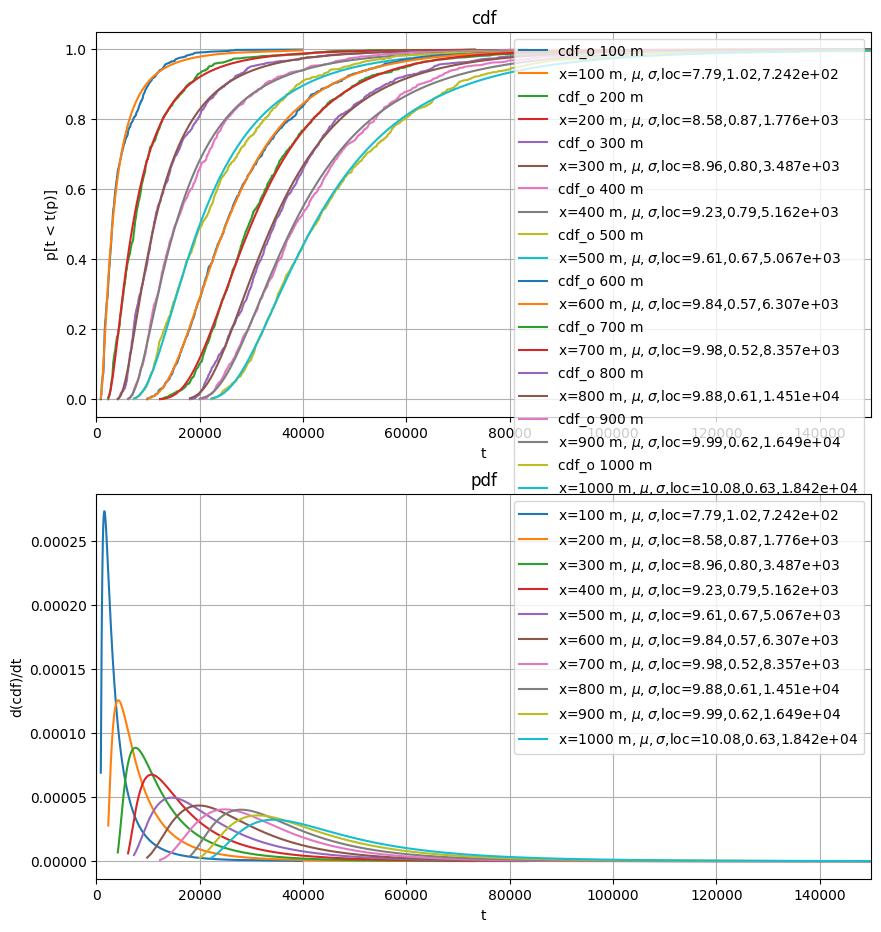

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8')])
musigmaloc = np.zeros(len(cumulatives), dtype=dtype)

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))
for ix, x in enumerate(cumulatives):
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm
    mu = np.log(scale)
    sigma = shape 
    musigmaloc[ix] = np.array([(x, mu, sigma, loc)], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    ax1.plot(t, cdf_o, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

In [ ]:
musigmaloc

array([( 100,  7.78677135, 1.02465538,   724.18004096),
       ( 200,  8.57888684, 0.87471583,  1776.22214684),
       ( 300,  8.95653732, 0.7987066 ,  3487.0759265 ),
       ( 400,  9.23293226, 0.78555243,  5161.99728746),
       ( 500,  9.61465691, 0.67200183,  5067.2166364 ),
       ( 600,  9.84382103, 0.57388794,  6307.04216298),
       ( 700,  9.98369204, 0.52065369,  8356.74731875),
       ( 800,  9.88375311, 0.6084413 , 14505.70981425),
       ( 900,  9.98789469, 0.62165742, 16489.51291588),
       (1000, 10.07619099, 0.63370814, 18418.92667642)],
      dtype=[('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8')])

In [ ]:
musigmaloc['loc'] + np.exp(musigmaloc['mu'] + 0.5 * musigmaloc['sigma'] ** 2)


array([ 4795.53308869,  9572.88232957, 14160.40643533, 19087.51959153,
       23845.38358329, 28521.41344879, 33172.45665223, 38102.20608945,
       42889.62831777, 47475.03458044])

x     mu         sigma      scale     
  100       7.79       1.02        724
  200       8.58      0.875   1.78e+03
  300       8.96      0.799   3.49e+03
  400       9.23      0.786   5.16e+03
  500       9.61      0.672   5.07e+03
  600       9.84      0.574   6.31e+03
  700       9.98      0.521   8.36e+03
  800       9.88      0.608   1.45e+04
  900       9.99      0.622   1.65e+04
 1000       10.1      0.634   1.84e+04


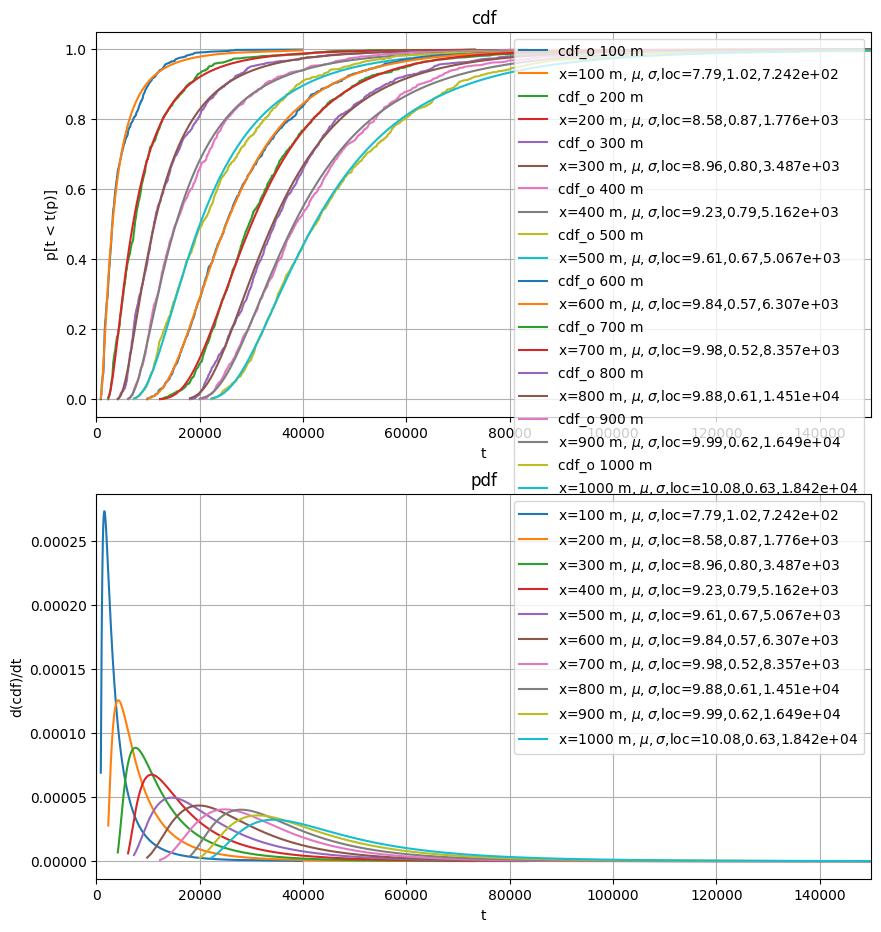

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mean_t', '<f8'),('mode_t', '<f8')])
musigmaloc = np.zeros(len(cumulatives), dtype=dtype)

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))
for ix, x in enumerate(cumulatives):
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm
    mu = np.log(scale)
    sigma = shape 
    mean_t = loc + np.exp(mu + 0.5 * sigma ** 2)
    mode_t = loc + np.exp(mu - sigma ** 2)
    musigmaloc[ix] = np.array([(x, mu, sigma, loc, mean_t, mode_t)], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    ax1.plot(t, cdf_o, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

In [ ]:
musigmaloc


array([( 100,  7.78677135, 1.02465538,   724.18004096,  4795.53308869,  1567.08373454),
       ( 200,  8.57888684, 0.87471583,  1776.22214684,  9572.88232957,  4250.63657703),
       ( 300,  8.95653732, 0.7987066 ,  3487.0759265 , 14160.40643533,  7586.51358635),
       ( 400,  9.23293226, 0.78555243,  5161.99728746, 19087.51959153, 10680.37736118),
       ( 500,  9.61465691, 0.67200183,  5067.2166364 , 23845.38358329, 14605.51561821),
       ( 600,  9.84382103, 0.57388794,  6307.04216298, 28521.41344879, 19861.53932143),
       ( 700,  9.98369204, 0.52065369,  8356.74731875, 33172.45665223, 24881.45167526),
       ( 800,  9.88375311, 0.6084413 , 14505.70981425, 38102.20608945, 28047.72407766),
       ( 900,  9.98789469, 0.62165742, 16489.51291588, 42889.62831777, 31275.52291283),
       (1000, 10.07619099, 0.63370814, 18418.92667642, 47475.03458044, 34327.36554   )],
      dtype=[('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'), ('mean_t', '<f8'), ('mode_t', '<f8')])

In [ ]:
musigmaloc['mean_t'] / musigmaloc['x']

array([47.95533089, 47.86441165, 47.20135478, 47.71879898, 47.69076717,
       47.53568908, 47.38922379, 47.62775761, 47.65514258, 47.47503458])

In [ ]:
musigmaloc['mode_t'] / musigmaloc['x']

array([15.67083735, 21.25318289, 25.28837862, 26.7009434 , 29.21103124,
       33.10256554, 35.54493096, 35.0596551 , 34.75058101, 34.32736554])

x     mu         sigma      scale     
  100       7.79       1.02        724
  200       8.58      0.875   1.78e+03
  300       8.96      0.799   3.49e+03
  400       9.23      0.786   5.16e+03
  500       9.61      0.672   5.07e+03
  600       9.84      0.574   6.31e+03
  700       9.98      0.521   8.36e+03
  800       9.88      0.608   1.45e+04
  900       9.99      0.622   1.65e+04
 1000       10.1      0.634   1.84e+04


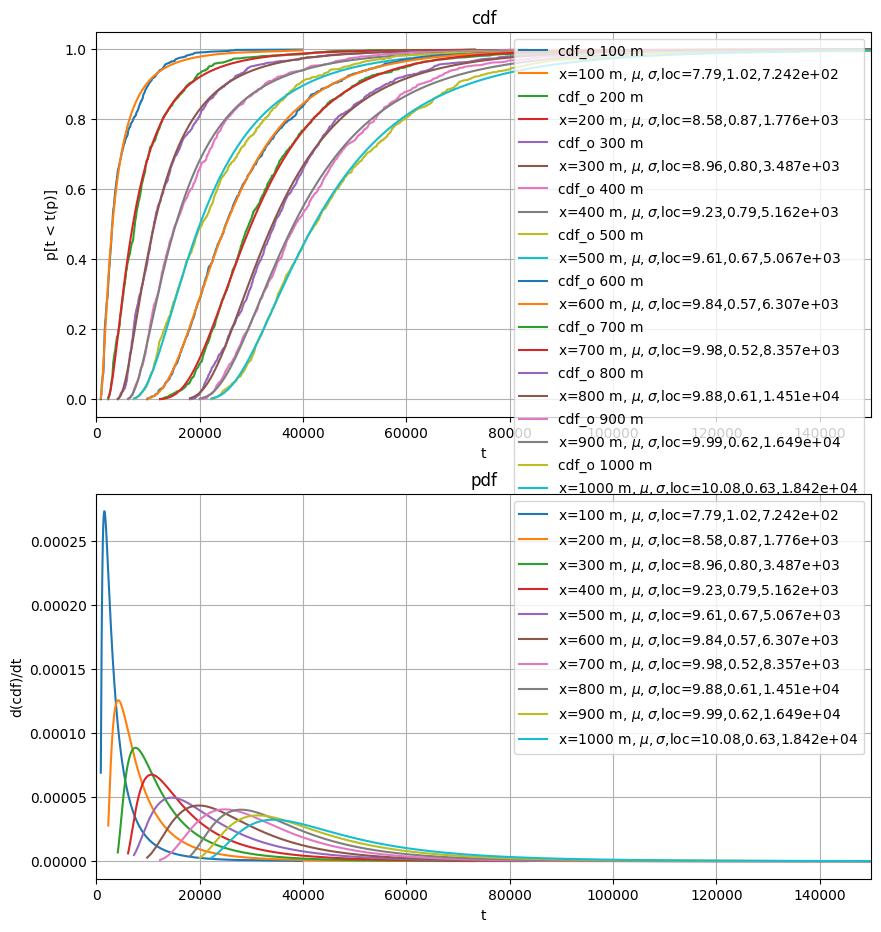

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8')])
musigmaloc = np.zeros(len(cumulatives), dtype=dtype)

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))
for ix, x in enumerate(cumulatives):
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm
    mu = np.log(scale)
    sigma = shape 
    mode_t = loc + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = loc + np.exp(mu + 0.5 * sigma ** 2)
    musigmaloc[ix] = np.array([(x, mu, sigma, loc, mode_t, median_t, mean_t)], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    ax1.plot(t, cdf_o, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

In [ ]:
musigmaloc


array([( 100,  7.78677135, 1.02465538,   724.18004096,  1567.08373454,  3132.70875485,  4795.53308869),
       ( 200,  8.57888684, 0.87471583,  1776.22214684,  4250.63657703,  7094.40440899,  9572.88232957),
       ( 300,  8.95653732, 0.7987066 ,  3487.0759265 ,  7586.51358635, 11245.52179068, 14160.40643533),
       ( 400,  9.23293226, 0.78555243,  5161.99728746, 10680.37736118, 15390.48744879, 19087.51959153),
       ( 500,  9.61465691, 0.67200183,  5067.2166364 , 14605.51561821, 20049.99796258, 23845.38358329),
       ( 600,  9.84382103, 0.57388794,  6307.04216298, 19861.53932143, 25148.61504038, 28521.41344879),
       ( 700,  9.98369204, 0.52065369,  8356.74731875, 24881.45167526, 30026.91948938, 33172.45665223),
       ( 800,  9.88375311, 0.6084413 , 14505.70981425, 28047.72407766, 34114.88997585, 38102.20608945),
       ( 900,  9.98789469, 0.62165742, 16489.51291588, 31275.52291283, 38250.94883409, 42889.62831777),
       (1000, 10.07619099, 0.63370814, 18418.92667642, 34327.365

x     mu         sigma      scale     
  100       7.79       1.02        724
  200       8.58      0.875   1.78e+03
  300       8.96      0.799   3.49e+03
  400       9.23      0.786   5.16e+03
  500       9.61      0.672   5.07e+03
  600       9.84      0.574   6.31e+03
  700       9.98      0.521   8.36e+03
  800       9.88      0.608   1.45e+04
  900       9.99      0.622   1.65e+04
 1000       10.1      0.634   1.84e+04


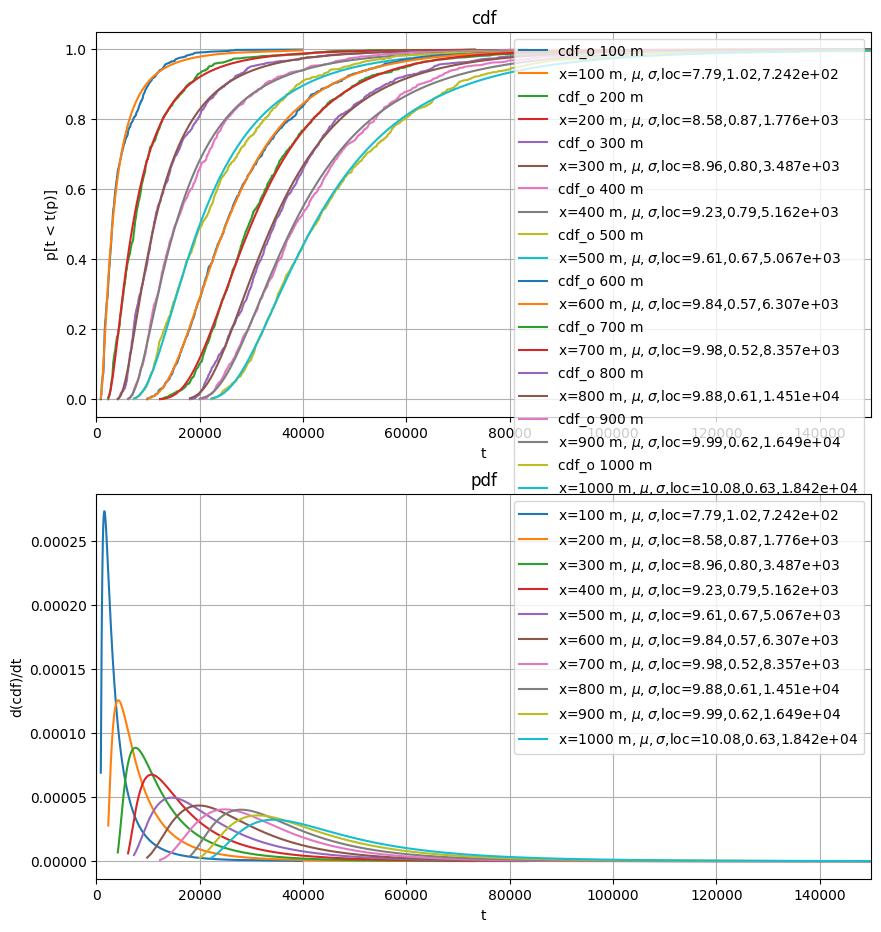

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8')])
musigmaloc = np.zeros(len(cumulatives), dtype=dtype)

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))
for ix, x in enumerate(cumulatives):
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm
    mu = np.log(scale)
    sigma = shape 
    mode_t = loc + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = loc + np.exp(mu + 0.5 * sigma ** 2)
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(loc),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t))], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    ax1.plot(t, cdf_o, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

In [ ]:
musigmaloc


array([( 100,  7.78677135, 1.02465538,   724.,  1567.,  3133.,  4796.),
       ( 200,  8.57888684, 0.87471583,  1776.,  4251.,  7094.,  9573.),
       ( 300,  8.95653732, 0.7987066 ,  3487.,  7587., 11246., 14160.),
       ( 400,  9.23293226, 0.78555243,  5162., 10680., 15390., 19088.),
       ( 500,  9.61465691, 0.67200183,  5067., 14606., 20050., 23845.),
       ( 600,  9.84382103, 0.57388794,  6307., 19862., 25149., 28521.),
       ( 700,  9.98369204, 0.52065369,  8357., 24881., 30027., 33172.),
       ( 800,  9.88375311, 0.6084413 , 14506., 28048., 34115., 38102.),
       ( 900,  9.98789469, 0.62165742, 16490., 31276., 38251., 42890.),
       (1000, 10.07619099, 0.63370814, 18419., 34327., 42189., 47475.)],
      dtype=[('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'), ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8')])

In [ ]:
1000/40000

0.025

x     mu         sigma      scale     


ValueError: could not assign tuple of length 7 to structure with 9 fields.

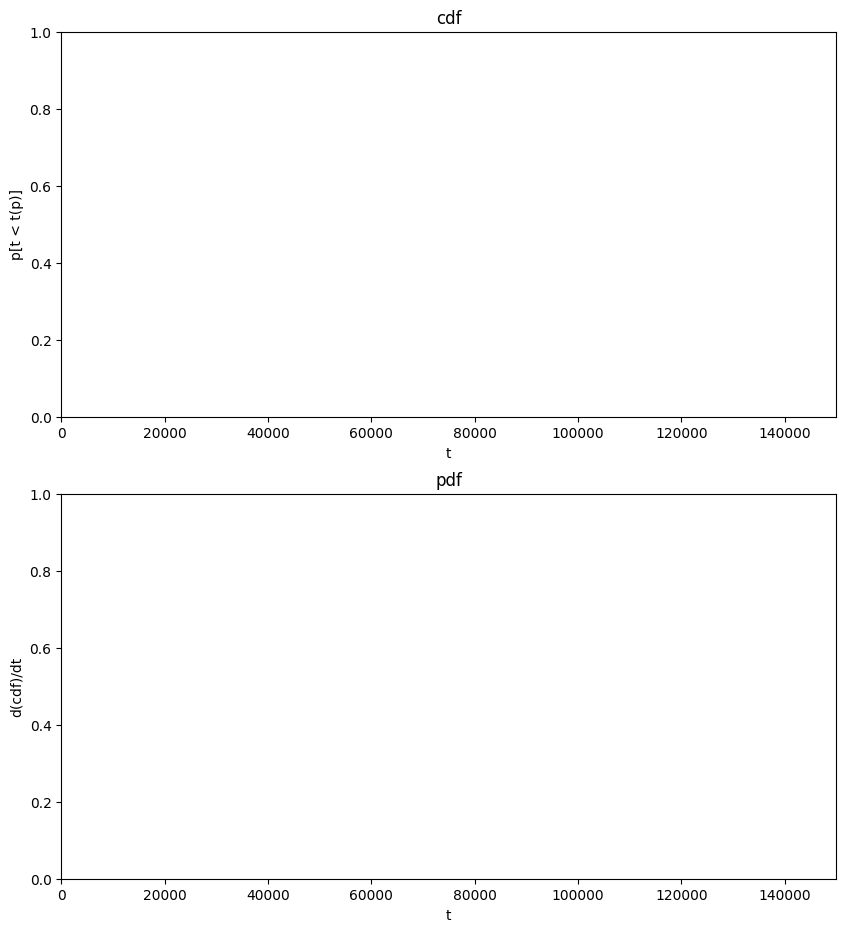

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<i8')])
musigmaloc = np.zeros(len(cumulatives), dtype=dtype)

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))
for ix, x in enumerate(cumulatives):
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm
    mu = np.log(scale)
    sigma = shape 
    mode_t = loc + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = loc + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(loc),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t)),
                                np.round(vmode, 4),
                                np.round(vmean, 4)], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    ax1.plot(t, cdf_o, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  100       7.79       1.02        724
  200       8.58      0.875   1.78e+03
  300       8.96      0.799   3.49e+03
  400       9.23      0.786   5.16e+03
  500       9.61      0.672   5.07e+03
  600       9.84      0.574   6.31e+03
  700       9.98      0.521   8.36e+03
  800       9.88      0.608   1.45e+04
  900       9.99      0.622   1.65e+04
 1000       10.1      0.634   1.84e+04


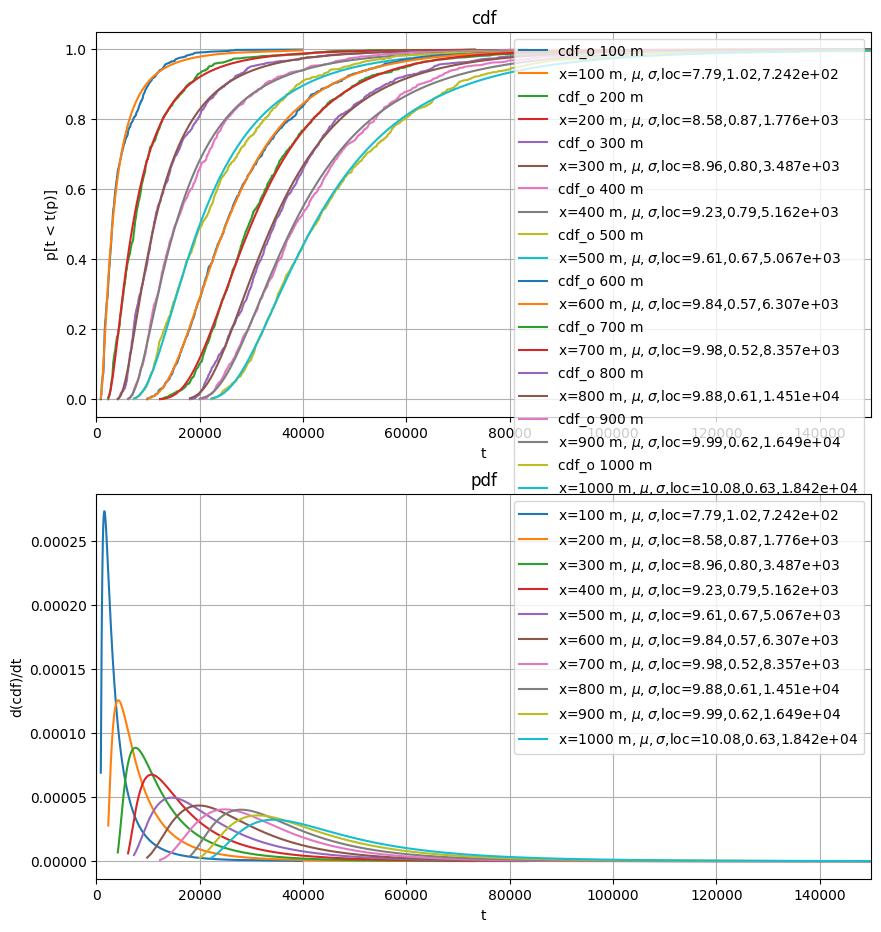

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<i8')])
musigmaloc = np.zeros(len(cumulatives), dtype=dtype)

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))
for ix, x in enumerate(cumulatives):
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm
    mu = np.log(scale)
    sigma = shape 
    mode_t = loc + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = loc + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(loc),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    ax1.plot(t, cdf_o, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

In [ ]:
musigmaloc


array([( 100,  7.78677135, 1.02465538,   724.,  1567.,  3133.,  4796., 0.0638, 0),
       ( 200,  8.57888684, 0.87471583,  1776.,  4251.,  7094.,  9573., 0.0471, 0),
       ( 300,  8.95653732, 0.7987066 ,  3487.,  7587., 11246., 14160., 0.0395, 0),
       ( 400,  9.23293226, 0.78555243,  5162., 10680., 15390., 19088., 0.0375, 0),
       ( 500,  9.61465691, 0.67200183,  5067., 14606., 20050., 23845., 0.0342, 0),
       ( 600,  9.84382103, 0.57388794,  6307., 19862., 25149., 28521., 0.0302, 0),
       ( 700,  9.98369204, 0.52065369,  8357., 24881., 30027., 33172., 0.0281, 0),
       ( 800,  9.88375311, 0.6084413 , 14506., 28048., 34115., 38102., 0.0285, 0),
       ( 900,  9.98789469, 0.62165742, 16490., 31276., 38251., 42890., 0.0288, 0),
       (1000, 10.07619099, 0.63370814, 18419., 34327., 42189., 47475., 0.0291, 0)],
      dtype=[('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'), ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'), ('vmode', '<f8'), ('vmean', '<i8')])

In [ ]:
vmean

np.float64(0.021063702403535743)

x     mu         sigma      scale     
  100       7.79       1.02        724
  200       8.58      0.875   1.78e+03
  300       8.96      0.799   3.49e+03
  400       9.23      0.786   5.16e+03
  500       9.61      0.672   5.07e+03
  600       9.84      0.574   6.31e+03
  700       9.98      0.521   8.36e+03
  800       9.88      0.608   1.45e+04
  900       9.99      0.622   1.65e+04
 1000       10.1      0.634   1.84e+04


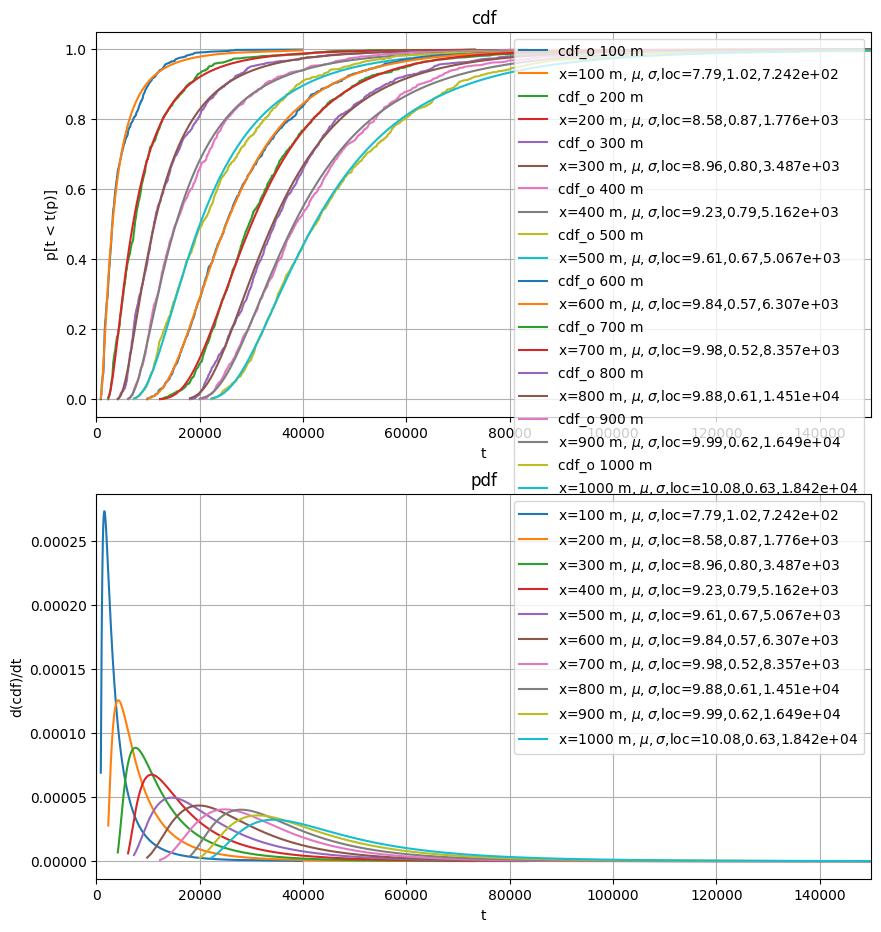

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
musigmaloc = np.zeros(len(cumulatives), dtype=dtype)

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))
for ix, x in enumerate(cumulatives):
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm
    mu = np.log(scale)
    sigma = shape 
    mode_t = loc + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = loc + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(loc),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    ax1.plot(t, cdf_o, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

In [ ]:
musigmaloc


array([( 100,  7.78677135, 1.02465538,   724.,  1567.,  3133.,  4796., 0.0638, 0.0209),
       ( 200,  8.57888684, 0.87471583,  1776.,  4251.,  7094.,  9573., 0.0471, 0.0209),
       ( 300,  8.95653732, 0.7987066 ,  3487.,  7587., 11246., 14160., 0.0395, 0.0212),
       ( 400,  9.23293226, 0.78555243,  5162., 10680., 15390., 19088., 0.0375, 0.021 ),
       ( 500,  9.61465691, 0.67200183,  5067., 14606., 20050., 23845., 0.0342, 0.021 ),
       ( 600,  9.84382103, 0.57388794,  6307., 19862., 25149., 28521., 0.0302, 0.021 ),
       ( 700,  9.98369204, 0.52065369,  8357., 24881., 30027., 33172., 0.0281, 0.0211),
       ( 800,  9.88375311, 0.6084413 , 14506., 28048., 34115., 38102., 0.0285, 0.021 ),
       ( 900,  9.98789469, 0.62165742, 16490., 31276., 38251., 42890., 0.0288, 0.021 ),
       (1000, 10.07619099, 0.63370814, 18419., 34327., 42189., 47475., 0.0291, 0.0211)],
      dtype=[('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'), ('mode_t', '<f8'), ('median', '<f8'), ('mea

In [ ]:
attr(cdf_norm)

NameError: name 'attr' is not defined

In [ ]:
from etc import attr

In [ ]:
attr(cdf_norm)

['T',
 'all',
 'any',
 'argmax',
 'argmin',
 'argpartition',
 'argsort',
 'astype',
 'base',
 'byteswap',
 'choose',
 'clip',
 'compress',
 'conj',
 'conjugate',
 'copy',
 'ctypes',
 'cumprod',
 'cumsum',
 'data',
 'device',
 'diagonal',
 'dot',
 'dtype',
 'dump',
 'dumps',
 'fill',
 'flags',
 'flat',
 'flatten',
 'getfield',
 'imag',
 'item',
 'itemset',
 'itemsize',
 'mT',
 'max',
 'mean',
 'min',
 'nbytes',
 'ndim',
 'newbyteorder',
 'nonzero',
 'partition',
 'prod',
 'ptp',
 'put',
 'ravel',
 'real',
 'repeat',
 'reshape',
 'resize',
 'round',
 'searchsorted',
 'setfield',
 'setflags',
 'shape',
 'size',
 'sort',
 'squeeze',
 'std',
 'strides',
 'sum',
 'swapaxes',
 'take',
 'to_device',
 'tobytes',
 'tofile',
 'tolist',
 'tostring',
 'trace',
 'transpose',
 'var',
 'view']

In [ ]:
cdf.ppf(0.05)

AttributeError: 'numpy.ndarray' object has no attribute 'ppf'

In [ ]:
pdf.ppf(0.05)

AttributeError: 'numpy.ndarray' object has no attribute 'ppf'

x     mu         sigma      scale     
  100       7.79       1.02        724
  200       8.58      0.875   1.78e+03
  300       8.96      0.799   3.49e+03
  400       9.23      0.786   5.16e+03
  500       9.61      0.672   5.07e+03
  600       9.84      0.574   6.31e+03
  700       9.98      0.521   8.36e+03
  800       9.88      0.608   1.45e+04
  900       9.99      0.622   1.65e+04
 1000       10.1      0.634   1.84e+04


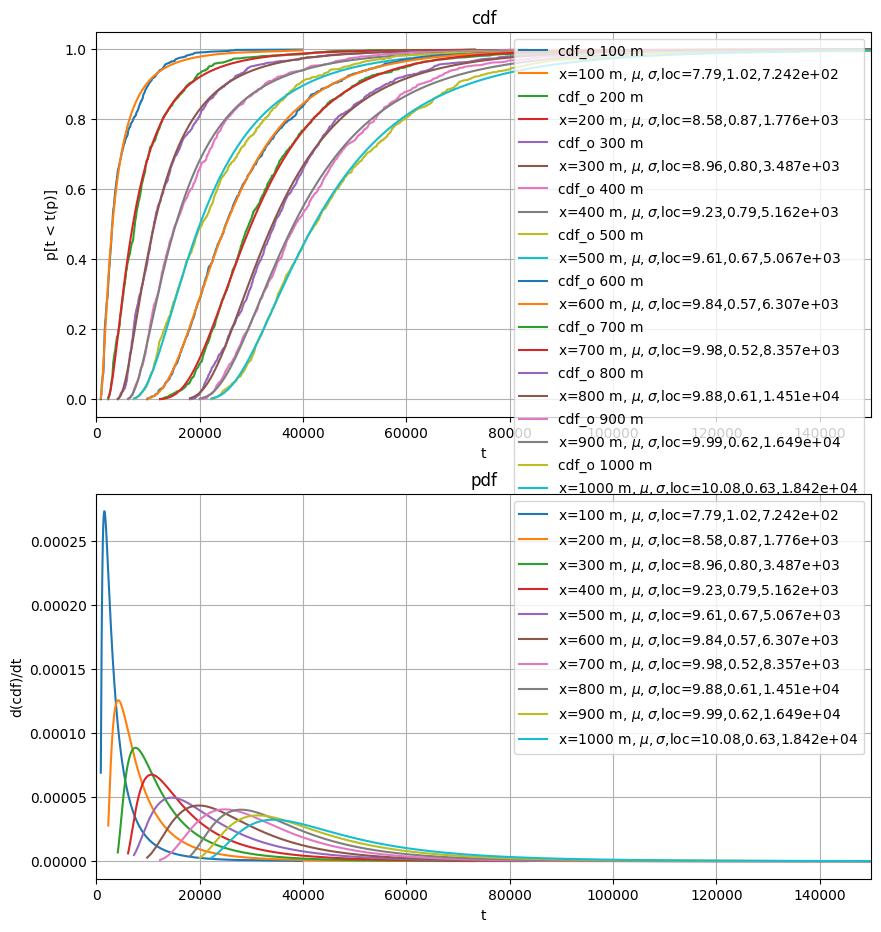

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))
for ix, x in enumerate(cumulatives):
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    mode_t = loc + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = loc + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(loc),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    ax1.plot(t, cdf_o, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

In [ ]:
bt_times

array([( 100,  1171.,  1589.,  3133.,  7433., 13717.),
       ( 200,  3038.,  3994.,  7094., 14528., 24195.),
       ( 300,  5573.,  6978., 11246., 20729., 32349.),
       ( 400,  7972.,  9826., 15390., 27596., 42399.),
       ( 500, 10028., 12720., 20050., 34402., 50319.),
       ( 600, 13638., 16922., 25149., 39750., 54733.),
       ( 700, 17560., 21233., 30027., 44827., 59383.),
       ( 800, 21714., 25178., 34115., 50535., 67851.),
       ( 900, 24317., 28178., 38251., 57005., 76991.),
       (1000, 26801., 31033., 42189., 63211., 85829.)],
      dtype=[('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'), ('t84', '<f8'), ('t95', '<f8')])

In [ ]:
from itertool import cycle

ModuleNotFoundError: No module named 'itertool'

In [ ]:
from itertools import cycle

x     mu         sigma      scale     
  100       7.79       1.02        724


ValueError: x and y must have same first dimension, but have shapes (1,) and (5,)

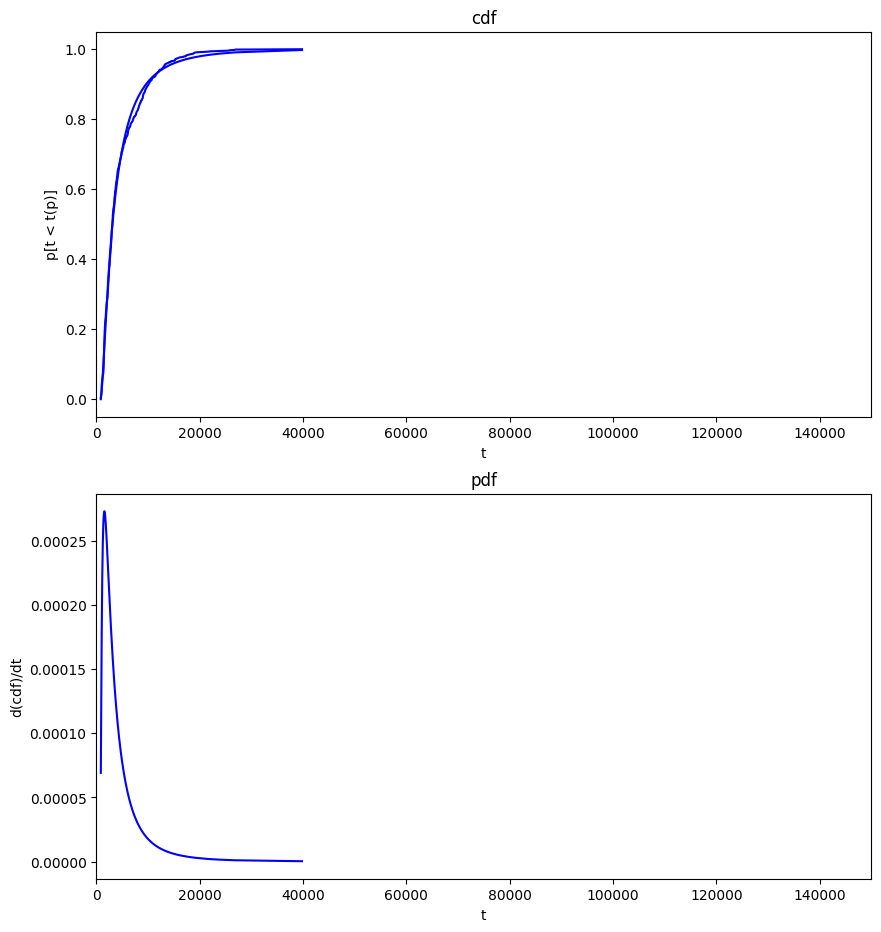

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "read", "geen", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    mode_t = loc + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = loc + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(loc),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    ax1.plot(bt_times[ix], [0.05, 0.16, 0.5, 0.84, 0.95], '.', color=clr, label='percentiles')    
    ax2.plot(bt_times[ix], [0., 0., 0., 0., 0.], '.', color=clr, label='percentiles')

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

In [ ]:
bt_times

array([(100, 1171., 1589., 3133., 7433., 13717.),
       (  0,    0.,    0.,    0.,    0.,     0.),
       (  0,    0.,    0.,    0.,    0.,     0.),
       (  0,    0.,    0.,    0.,    0.,     0.),
       (  0,    0.,    0.,    0.,    0.,     0.),
       (  0,    0.,    0.,    0.,    0.,     0.),
       (  0,    0.,    0.,    0.,    0.,     0.),
       (  0,    0.,    0.,    0.,    0.,     0.),
       (  0,    0.,    0.,    0.,    0.,     0.),
       (  0,    0.,    0.,    0.,    0.,     0.)],
      dtype=[('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'), ('t84', '<f8'), ('t95', '<f8')])

In [ ]:
bt_times[ix]

np.void((100, 1171.0, 1589.0, 3133.0, 7433.0, 13717.0), dtype=[('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'), ('t84', '<f8'), ('t95', '<f8')])

In [ ]:
bt_times[ix][1:]

IndexError: too many indices for array: array is 0-dimensional, but 1 were indexed

In [ ]:
np.asarray(bt_times[ix], dtype=float)

TypeError: Cannot cast array data from dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'), ('t84', '<f8'), ('t95', '<f8')]) to dtype('float64').

In [ ]:
np.asarray(bt_times[ix][1:], dtype=float)

IndexError: too many indices for array: array is 0-dimensional, but 1 were indexed

x     mu         sigma      scale     
  100       7.79       1.02        724
  200       8.58      0.875   1.78e+03


ValueError: 'read' is not a valid value for color: supported inputs are (r, g, b) and (r, g, b, a) 0-1 float tuples; '#rrggbb', '#rrggbbaa', '#rgb', '#rgba' strings; named color strings; string reprs of 0-1 floats for grayscale values; 'C0', 'C1', ... strings for colors of the color cycle; and pairs combining one of the above with an alpha value

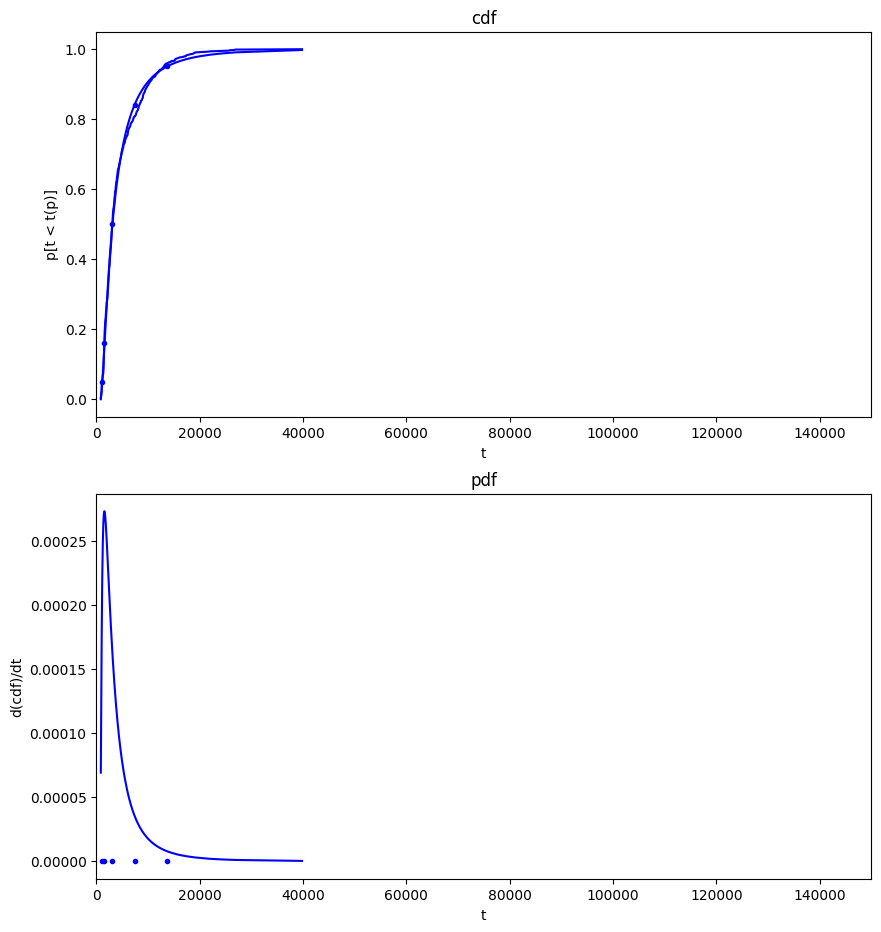

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "read", "geen", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    mode_t = loc + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = loc + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(loc),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    ax1.plot([t05, t16, t50, t84, t95], [0.05, 0.16, 0.5, 0.84, 0.95], '.', color=clr, label='percentiles')    
    ax2.plot([t05, t16, t50, t84, t95], [0., 0., 0., 0., 0.], '.', color=clr, label='percentiles')

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  100       7.79       1.02        724
  200       8.58      0.875   1.78e+03
  300       8.96      0.799   3.49e+03
  400       9.23      0.786   5.16e+03
  500       9.61      0.672   5.07e+03
  600       9.84      0.574   6.31e+03
  700       9.98      0.521   8.36e+03
  800       9.88      0.608   1.45e+04
  900       9.99      0.622   1.65e+04
 1000       10.1      0.634   1.84e+04


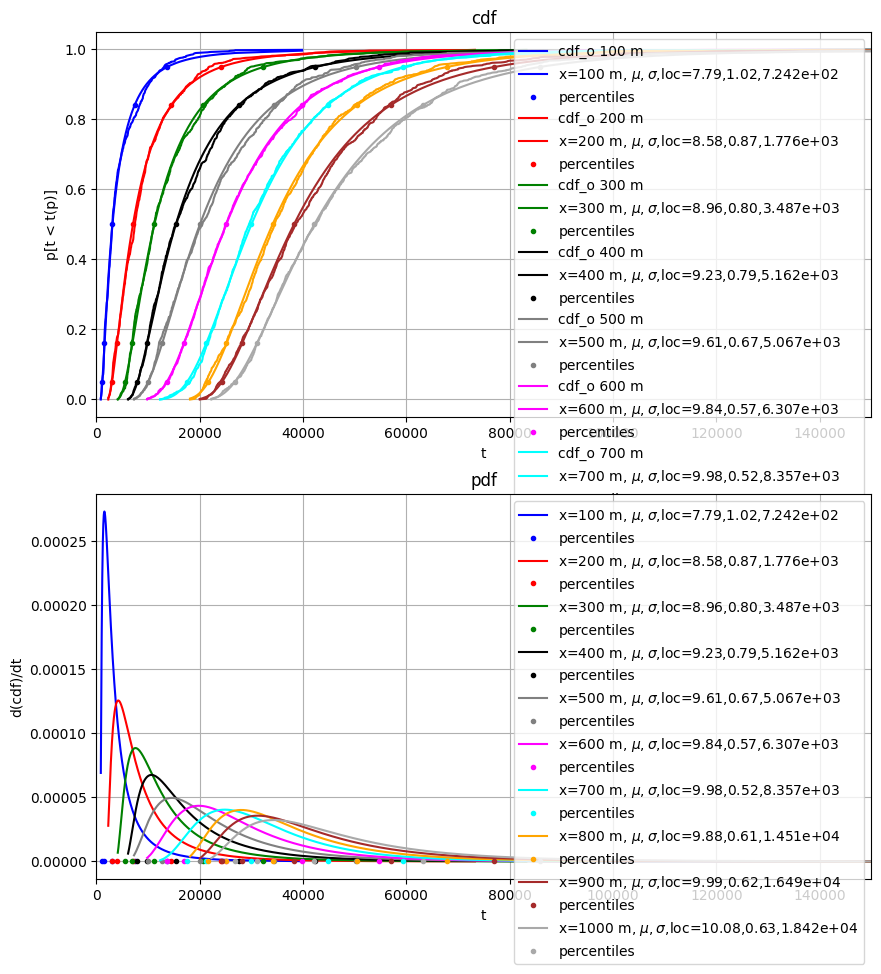

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    mode_t = loc + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = loc + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(loc),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    ax1.plot([t05, t16, t50, t84, t95], [0.05, 0.16, 0.5, 0.84, 0.95], '.', color=clr, label='percentiles')    
    ax2.plot([t05, t16, t50, t84, t95], [0., 0., 0., 0., 0.], '.', color=clr, label='percentiles')

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  100       7.79       1.02        724


TypeError: 'numpy.ndarray' object is not callable

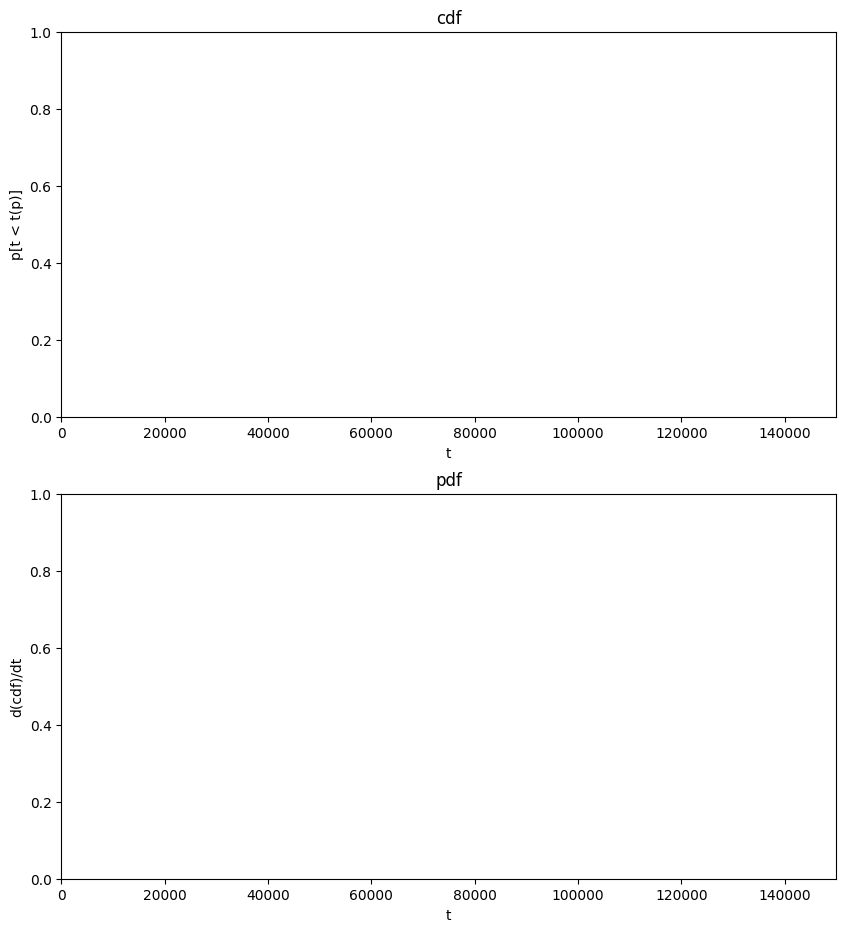

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    mode_t = loc + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = loc + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(loc),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = cdf_lognorm(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    ax1.vlines([t05, t16, t50, t84, t95], 0, 0.95, colors=clr)
    ax2.vlines([t05, t16, t50, t84, t95], 0, pdf_vmode=clr)    

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  100       7.79       1.02        724


TypeError: _parse_args() takes from 2 to 4 positional arguments but 5 were given

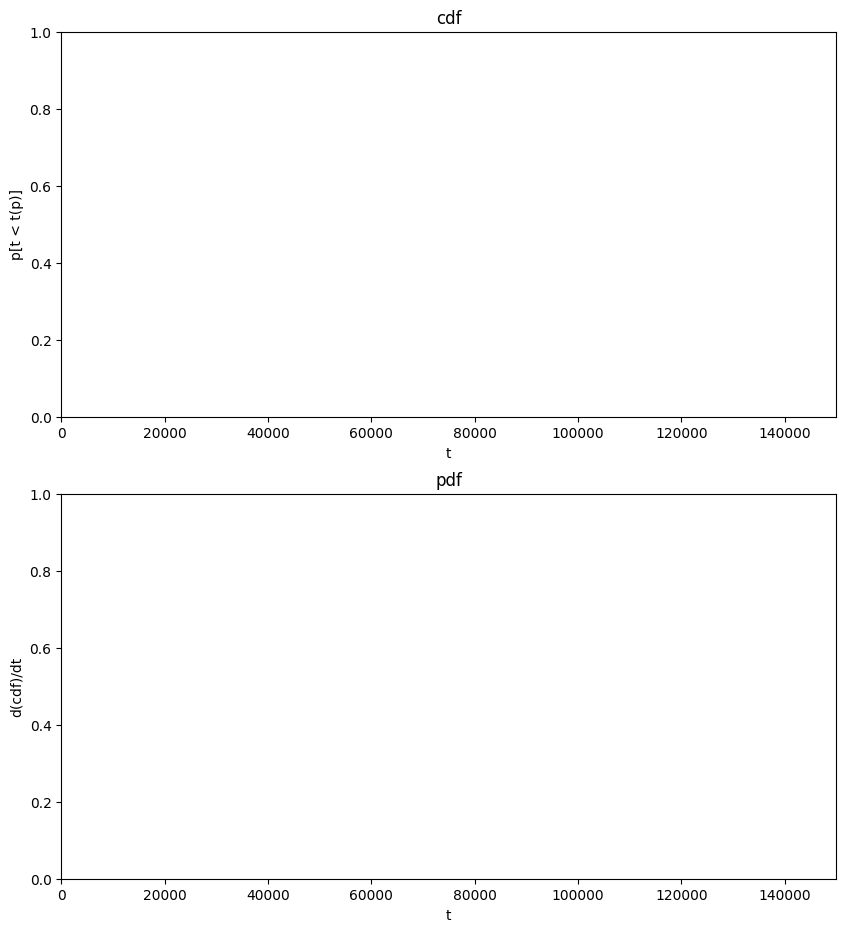

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    mode_t = loc + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = loc + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(loc),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    ax1.vlines([t05, t16, t50, t84, t95], 0, 0.95, colors=clr)
    ax2.vlines([t05, t16, t50, t84, t95], 0, pdf_vmode=clr)    

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  100       7.79       1.02        724


TypeError: Axes.vlines() missing 1 required positional argument: 'ymax'

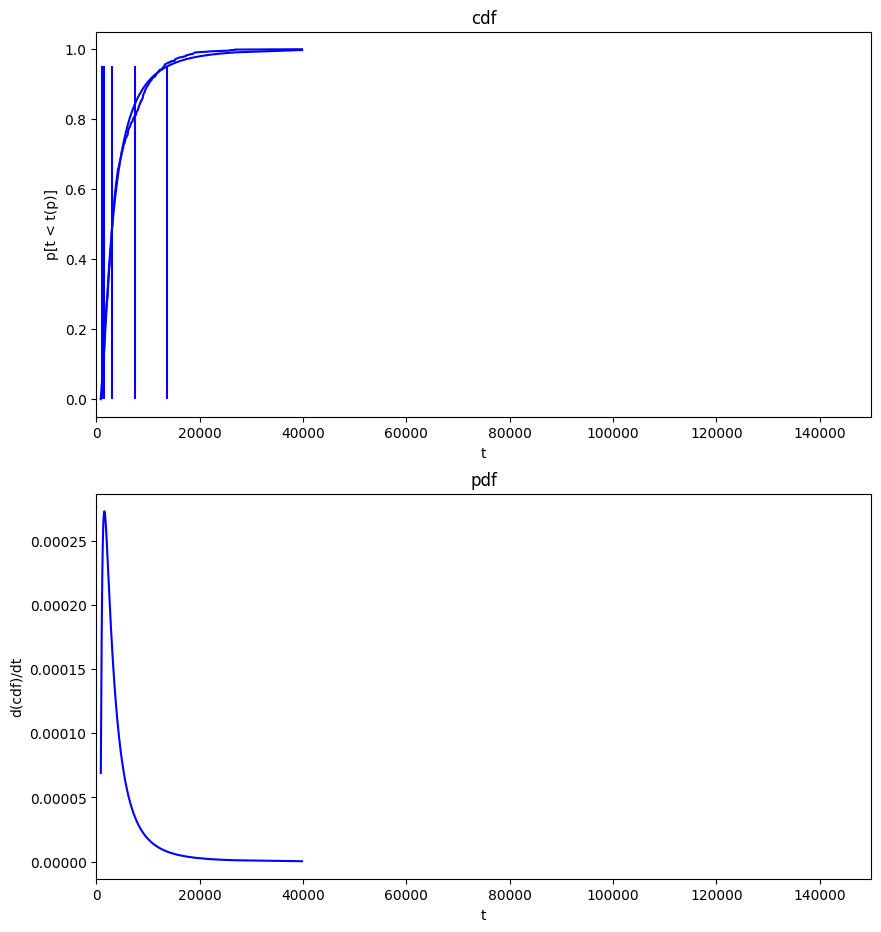

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    mode_t = loc + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = loc + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(loc),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    ax1.vlines([t05, t16, t50, t84, t95], 0, 0.95, colors=clr)
    ax2.vlines([t05, t16, t50, t84, t95], 0, pdf_vmode=clr)    

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  100       7.79       1.02        724
  200       8.58      0.875   1.78e+03
  300       8.96      0.799   3.49e+03
  400       9.23      0.786   5.16e+03
  500       9.61      0.672   5.07e+03
  600       9.84      0.574   6.31e+03
  700       9.98      0.521   8.36e+03
  800       9.88      0.608   1.45e+04
  900       9.99      0.622   1.65e+04
 1000       10.1      0.634   1.84e+04


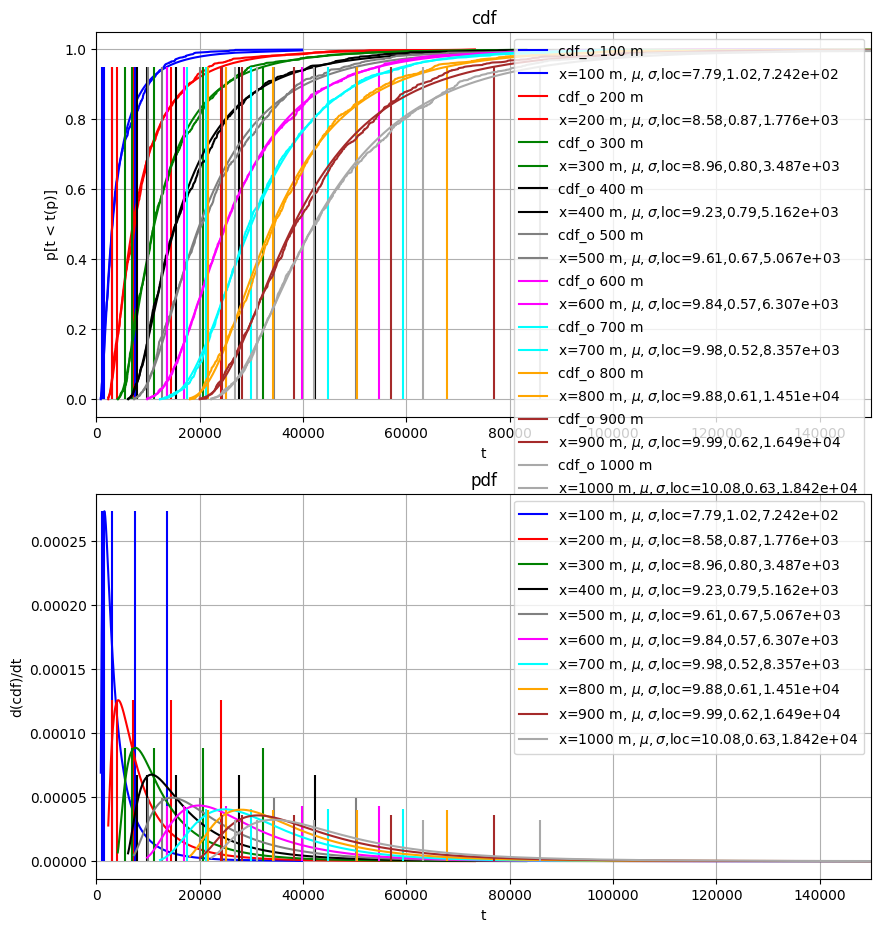

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    mode_t = loc + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = loc + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(loc),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  100       7.79       1.02        724
  200       8.58      0.875   1.78e+03
  300       8.96      0.799   3.49e+03
  400       9.23      0.786   5.16e+03
  500       9.61      0.672   5.07e+03
  600       9.84      0.574   6.31e+03
  700       9.98      0.521   8.36e+03
  800       9.88      0.608   1.45e+04
  900       9.99      0.622   1.65e+04
 1000       10.1      0.634   1.84e+04


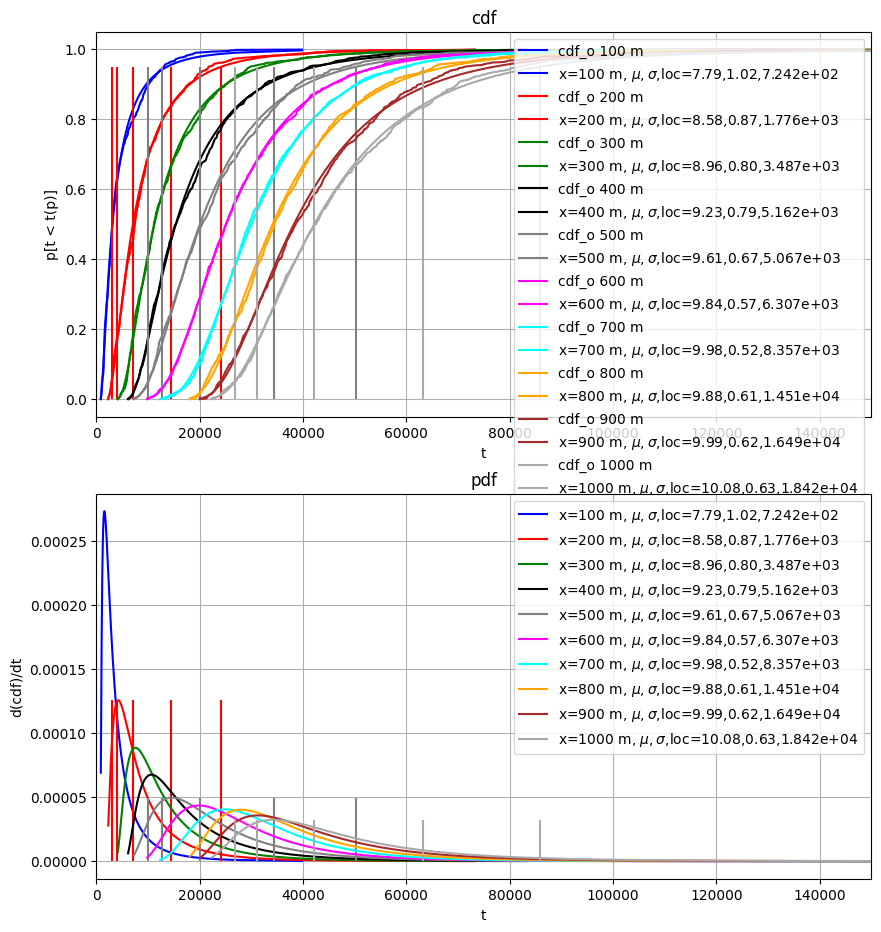

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    mode_t = loc + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = loc + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(loc),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    if x in [200, 500, 1000]:
        ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
        ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  100       7.79       1.02        724
  300       8.96      0.799   3.49e+03
  400       9.23      0.786   5.16e+03
  600       9.84      0.574   6.31e+03
  700       9.98      0.521   8.36e+03
  800       9.88      0.608   1.45e+04
  900       9.99      0.622   1.65e+04


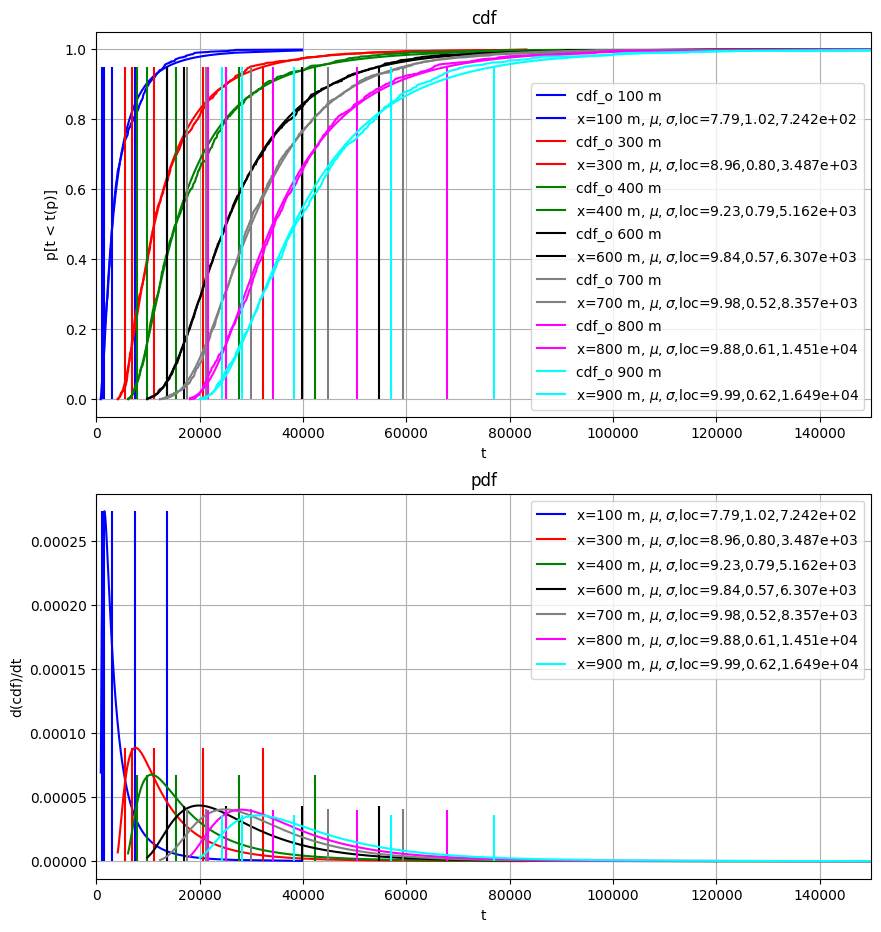

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    mode_t = loc + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = loc + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(loc),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  100       7.79       1.02        724
  300       8.96      0.799   3.49e+03
  400       9.23      0.786   5.16e+03
  600       9.84      0.574   6.31e+03
  700       9.98      0.521   8.36e+03
  800       9.88      0.608   1.45e+04
  900       9.99      0.622   1.65e+04


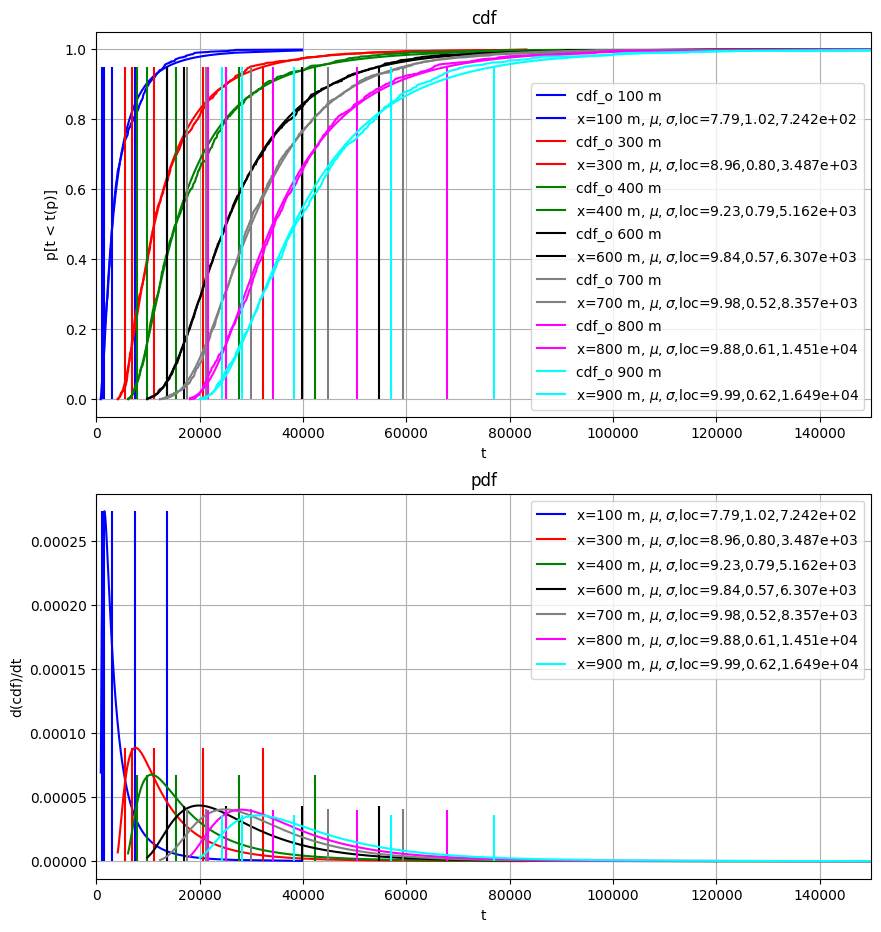

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    mode_t = loc + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = loc + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(loc),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


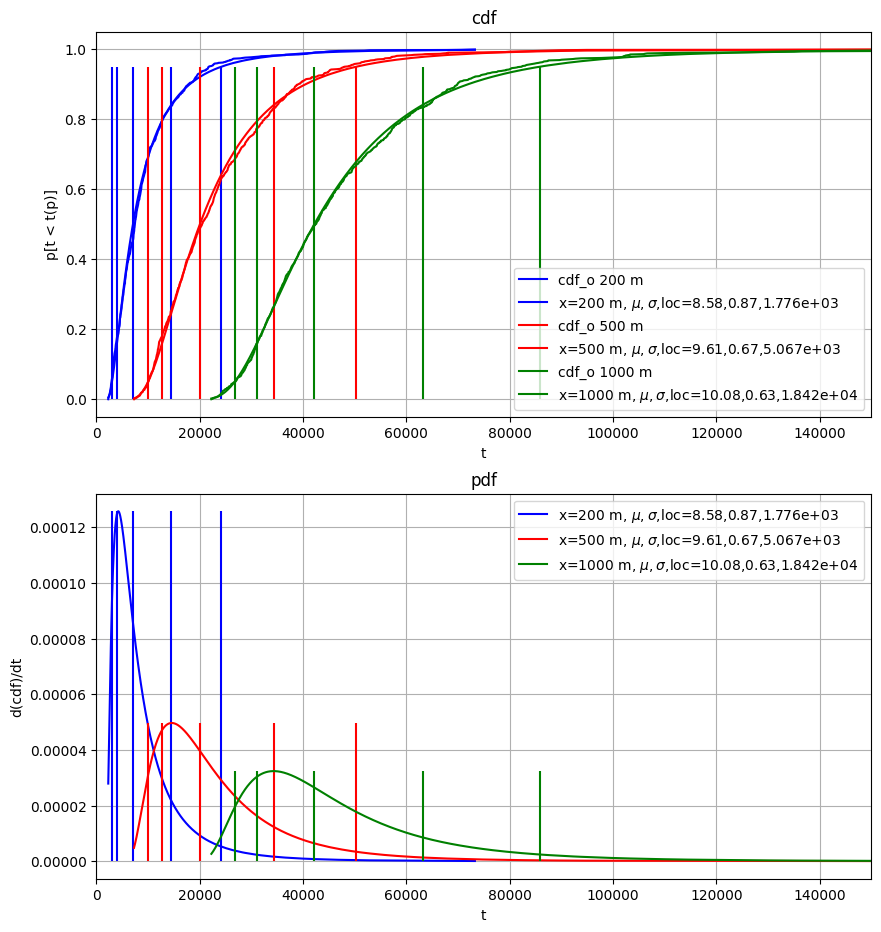

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    mode_t = loc + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = loc + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(loc),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


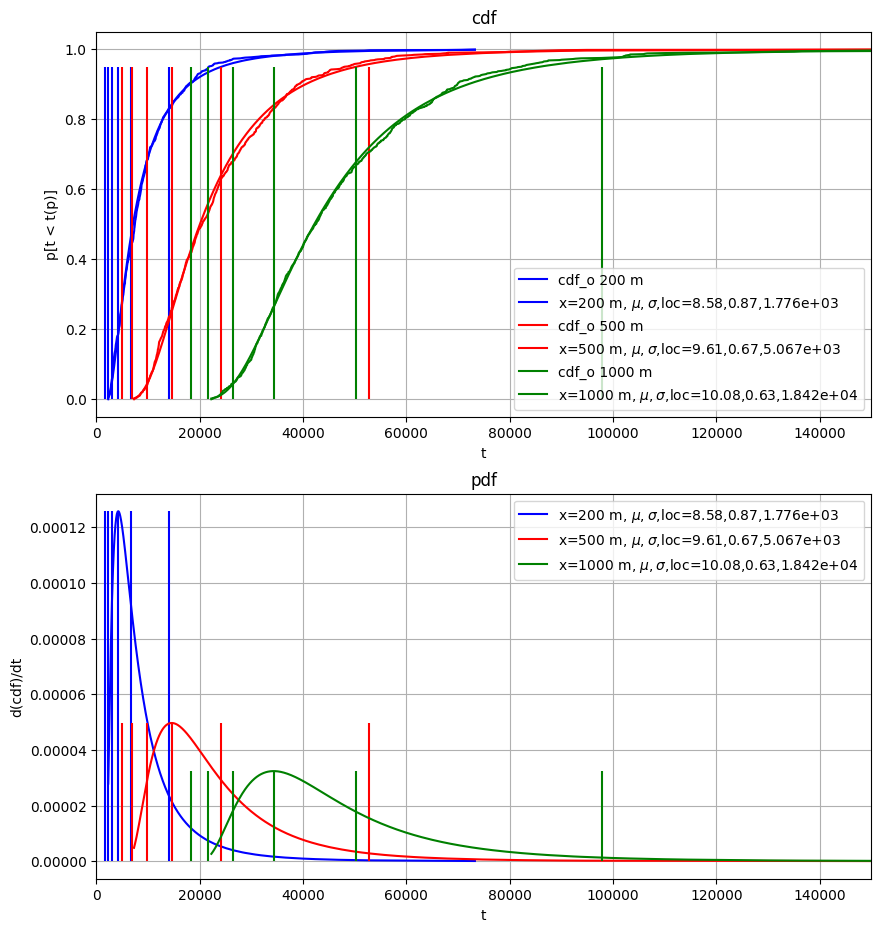

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    alpha = np.array([0, 0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha

    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)    


for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03


ValueError: '.o' is not a valid format string (two marker symbols)

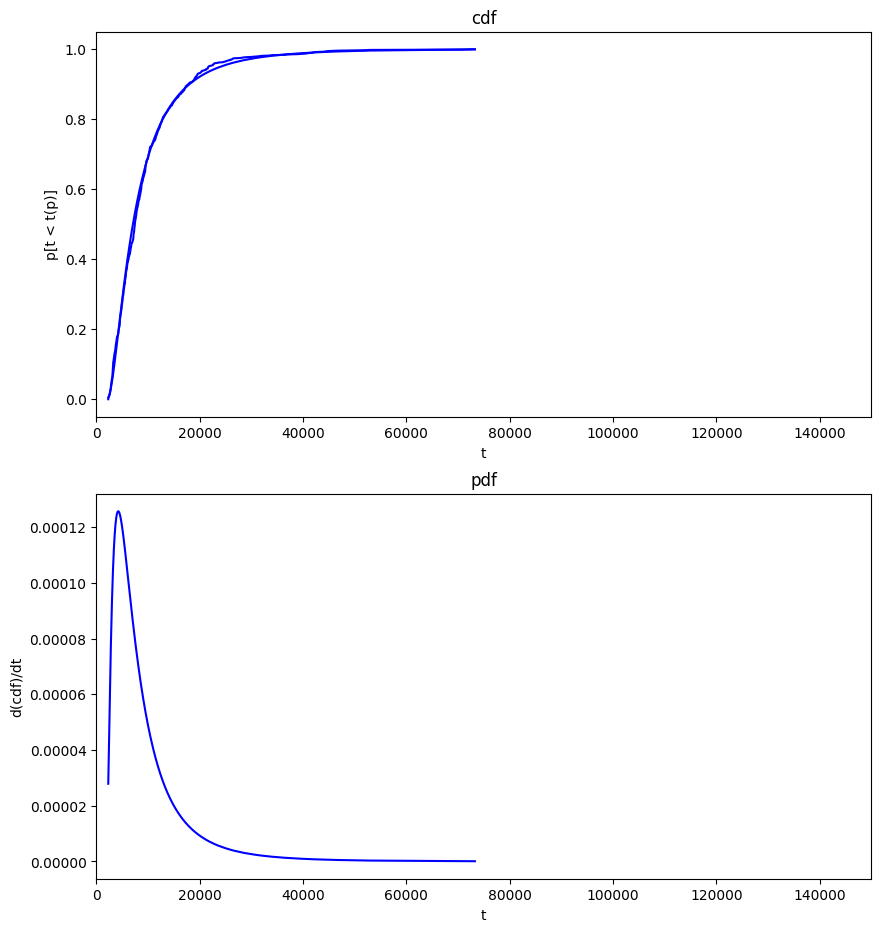

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    alpha = np.array([0, 0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), '.o', mc=clr, ec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), '.o', mc=clr, ec='k')

    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)    


for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03


AttributeError: Line2D.set() got an unexpected keyword argument 'mc'

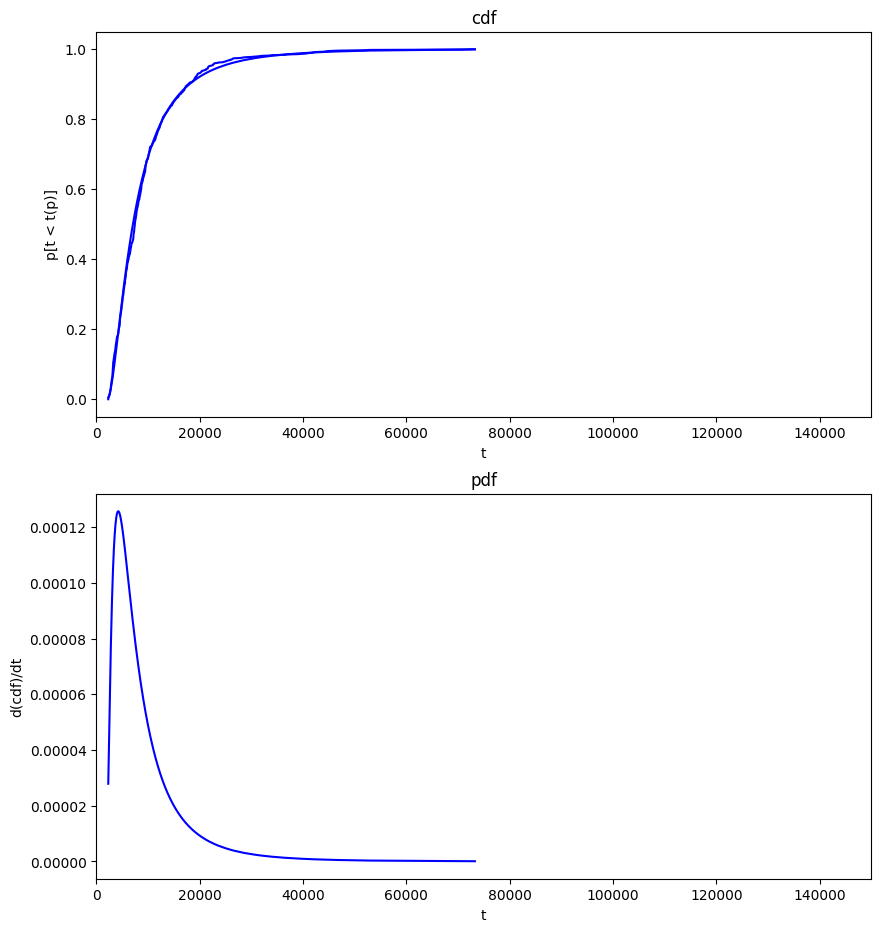

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    alpha = np.array([0, 0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mc=clr, ec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mc=clr, ec='k')

    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)    


for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


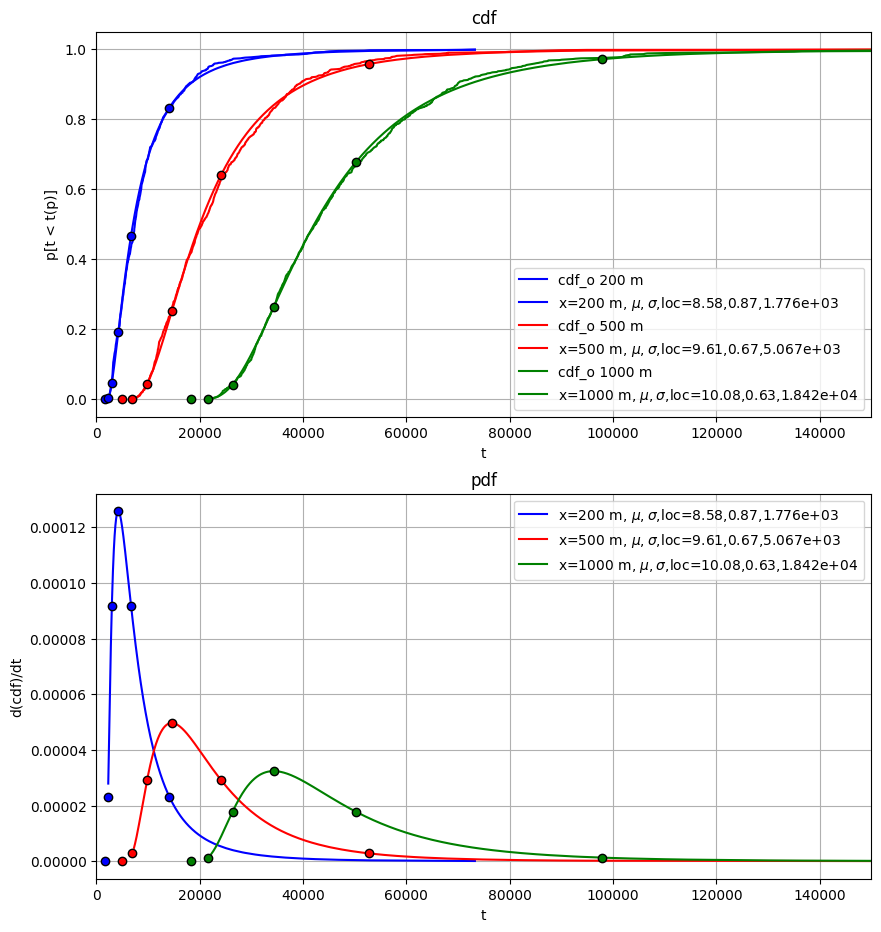

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    alpha = np.array([0, 0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)    


for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


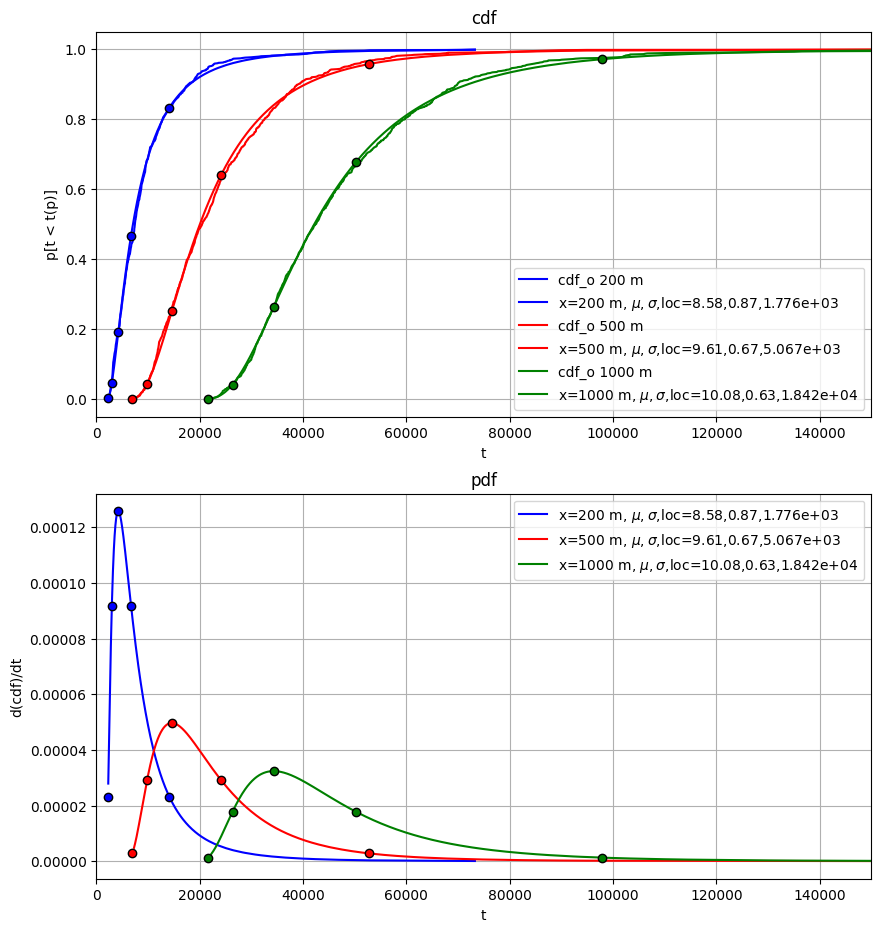

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)    


for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


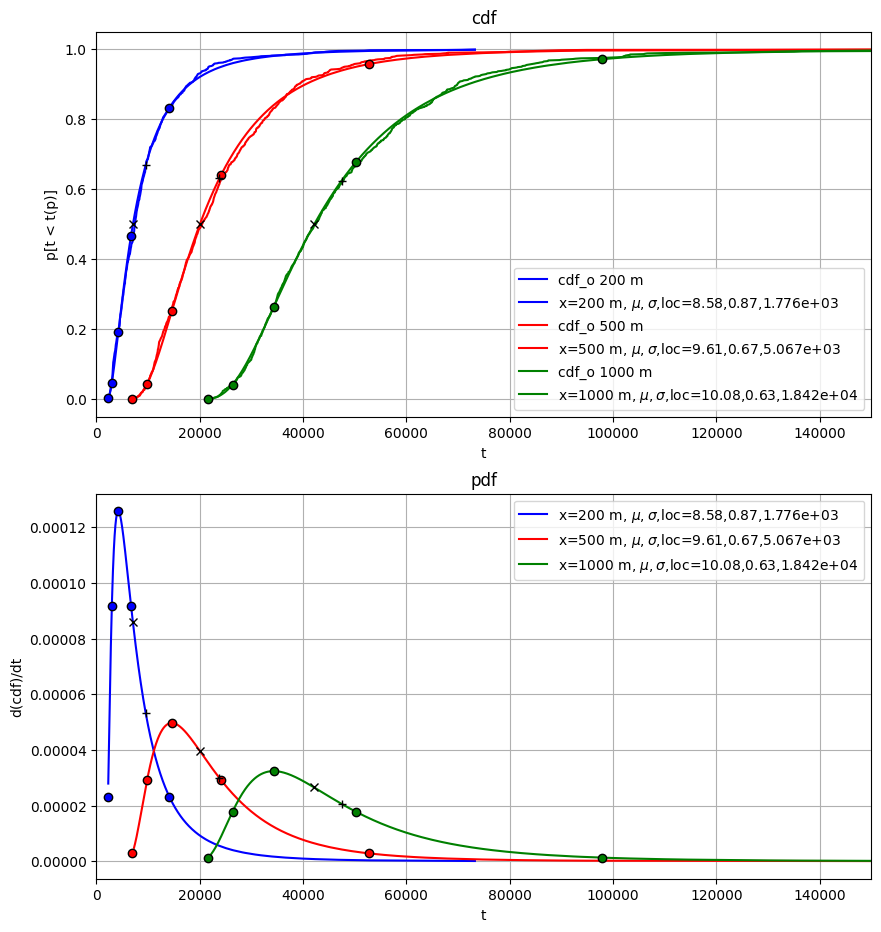

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 'x', mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 'x', mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '+', mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '+', mfc=clr, mec='k')



    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)    


for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


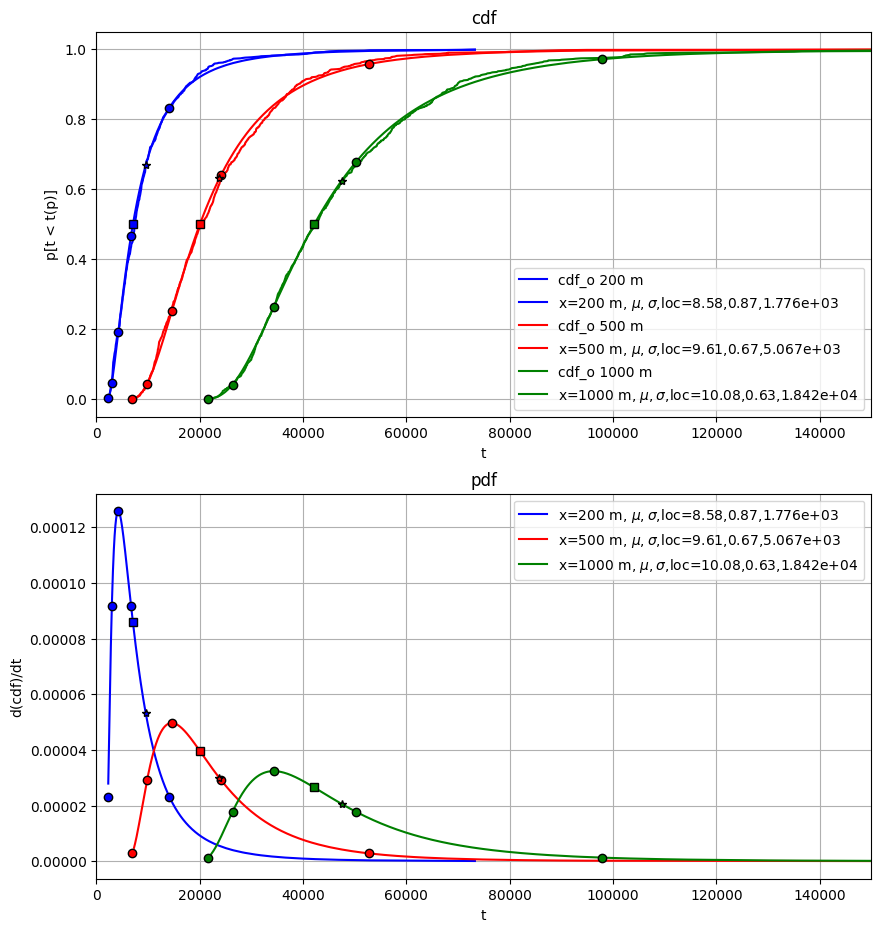

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', mfc=clr, mec='k')



    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)    


for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


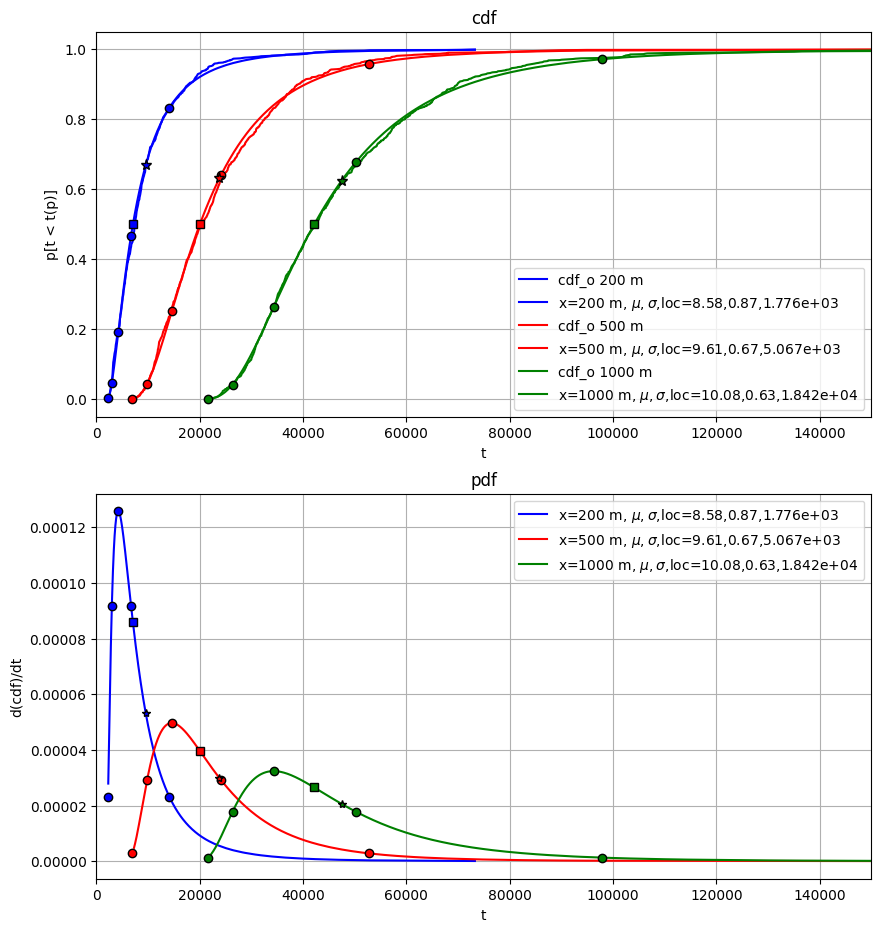

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=8, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=6, mfc=clr, mec='k')



    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)    


for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


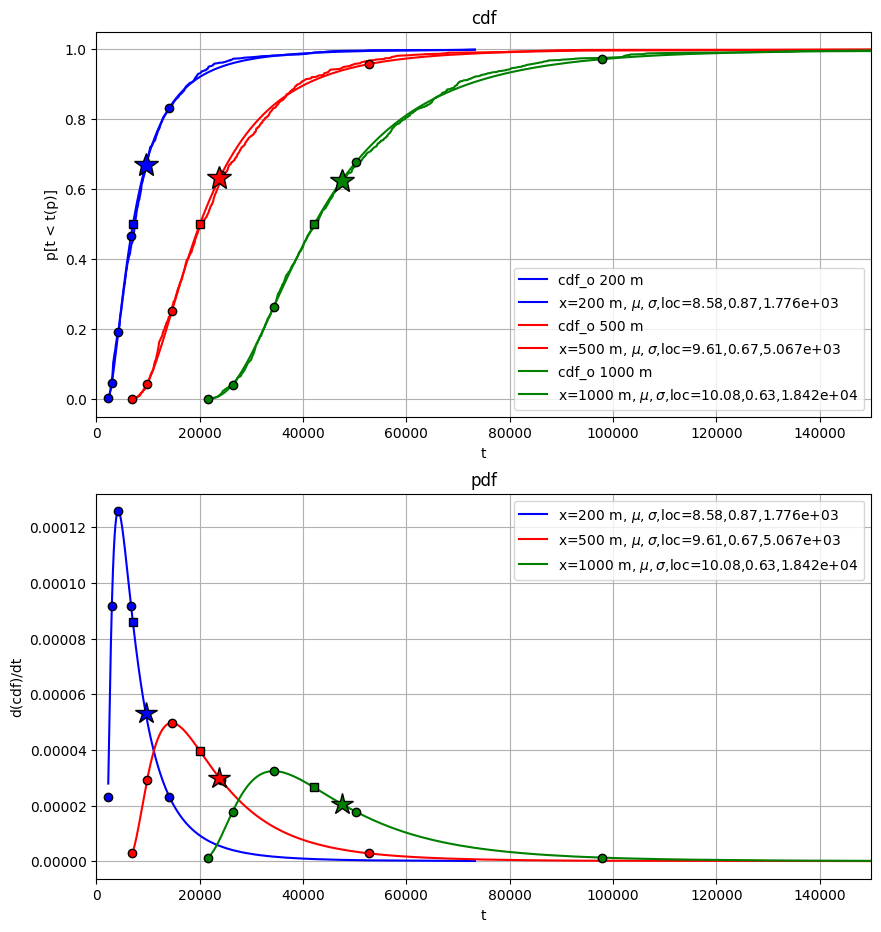

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=18, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=16, mfc=clr, mec='k')



    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)    


for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


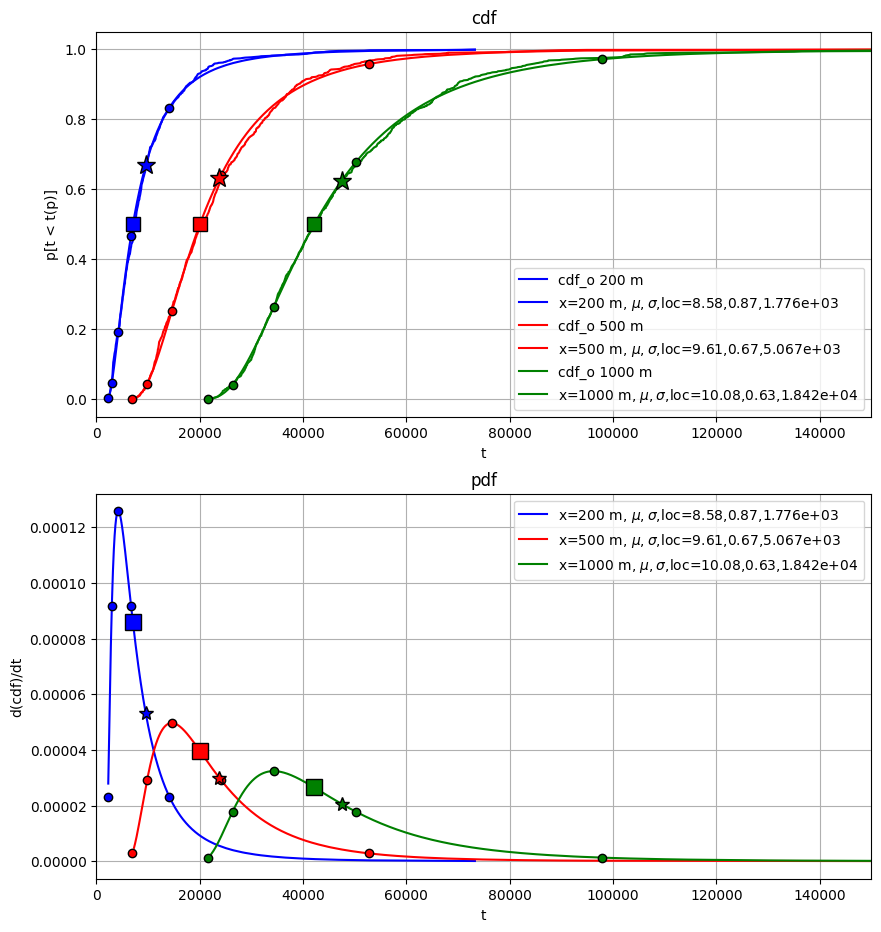

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', ms=10, mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', ms=12, mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=14, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')



    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)    


for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


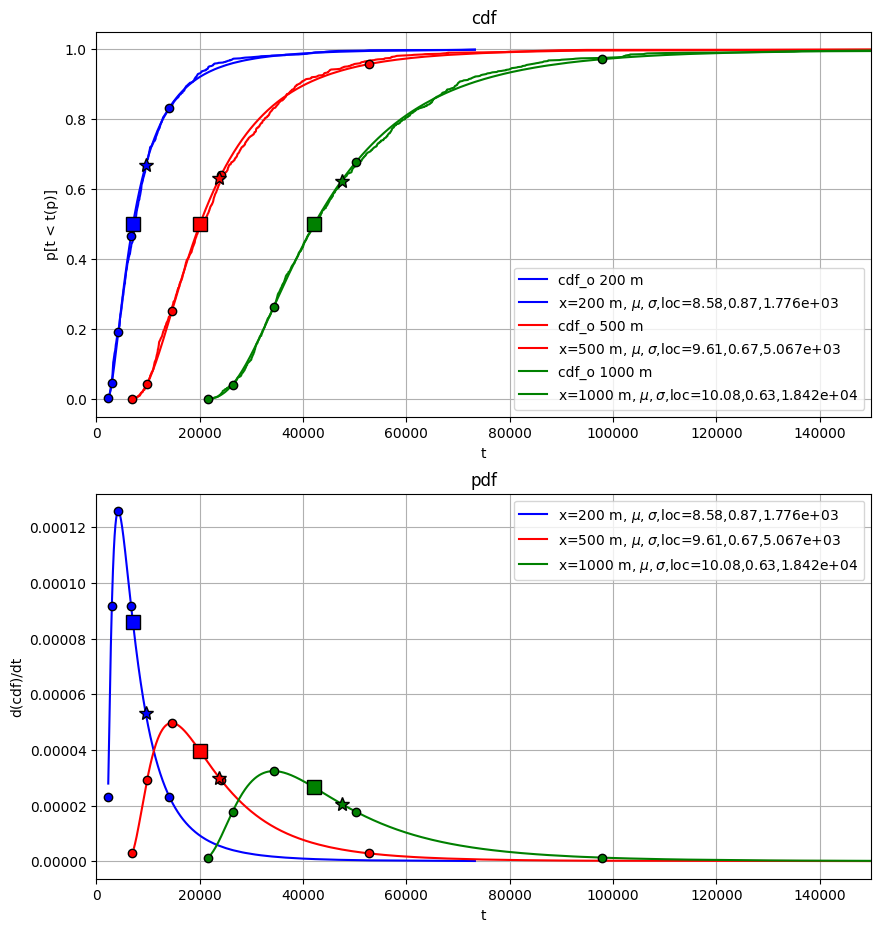

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', ms=10, mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', ms=10, mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')



    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)    


for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


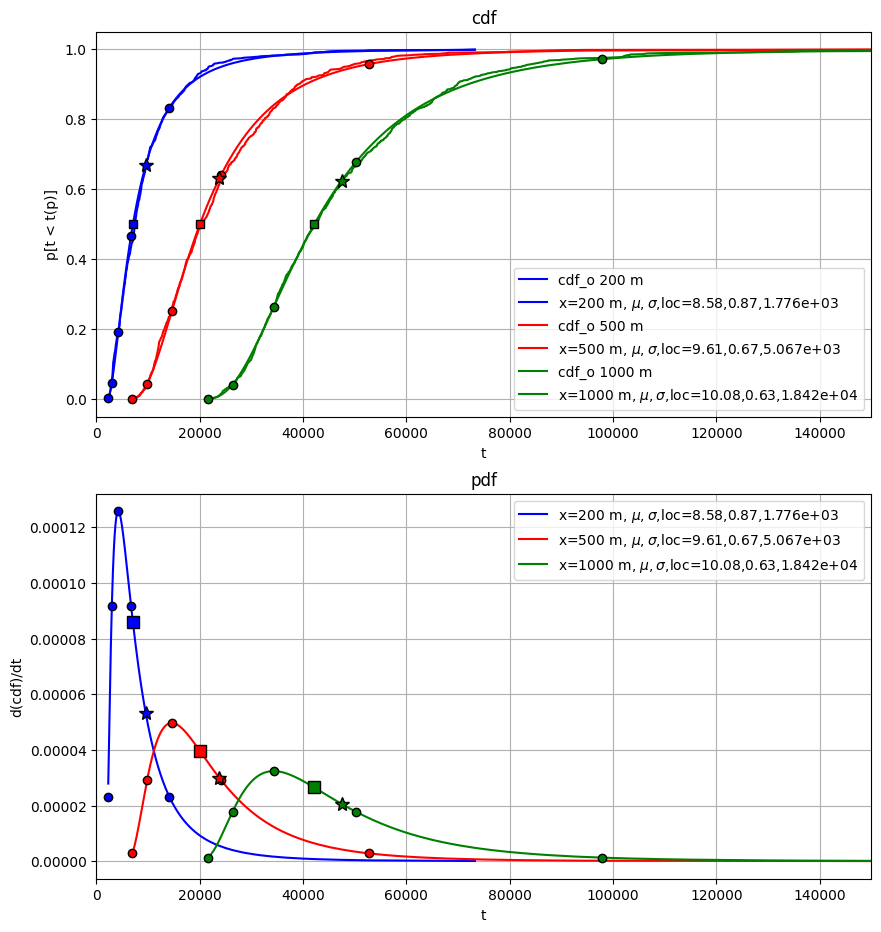

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', ms=6, mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', ms=8, mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')



    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)    


for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


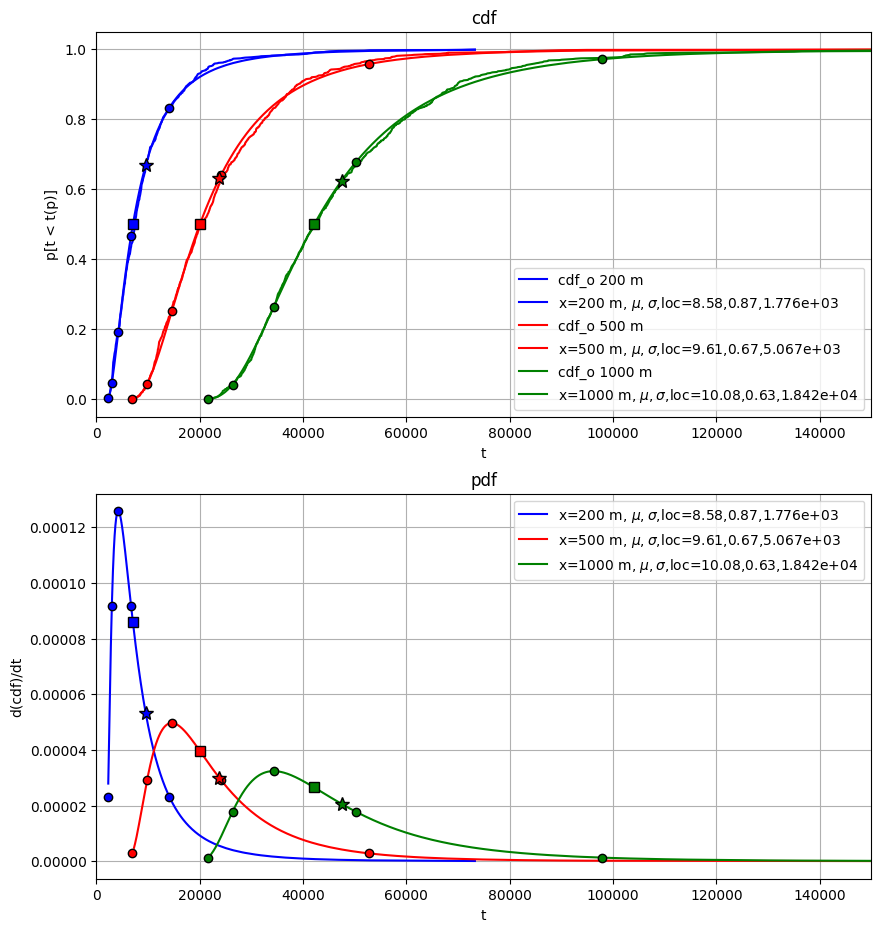

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma$,loc={mu:.2f},{sigma:.2f},{loc:.3e}")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')



    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)    


for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


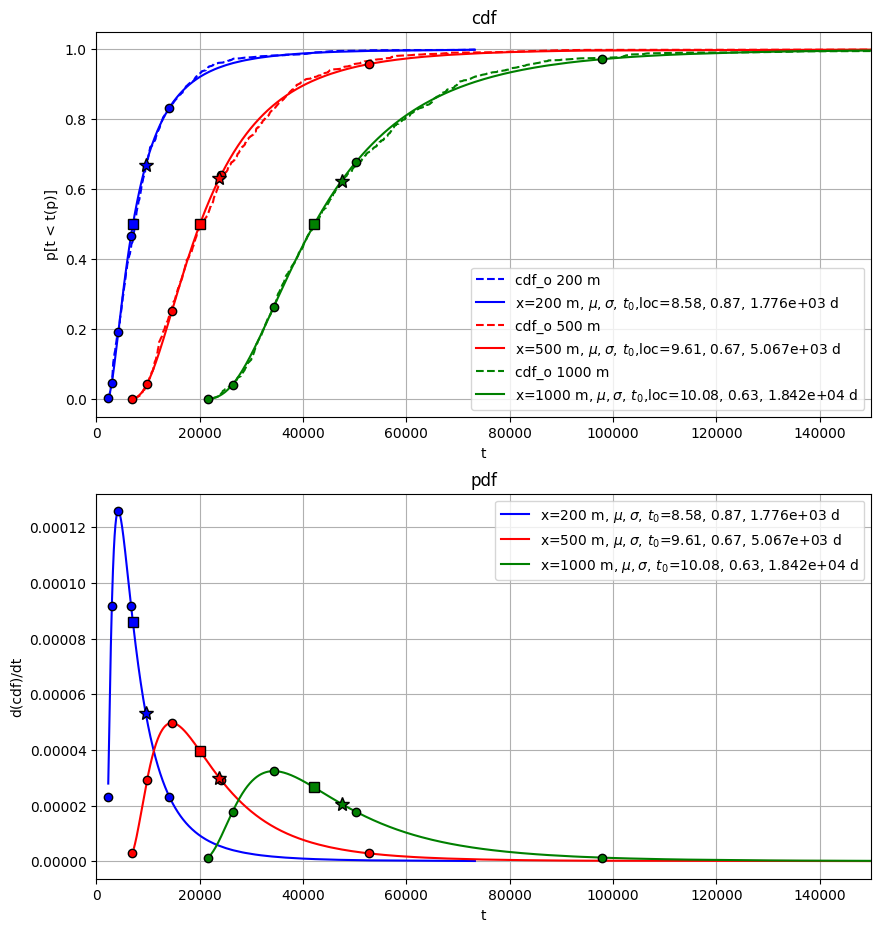

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, '--', color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma,\,t_0$,loc={mu:.2f}, {sigma:.2f}, {loc:.3e} d")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x} m, $\mu,\sigma,\,t_0$={mu:.2f}, {sigma:.2f}, {loc:.3e} d")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')

    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)    


for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


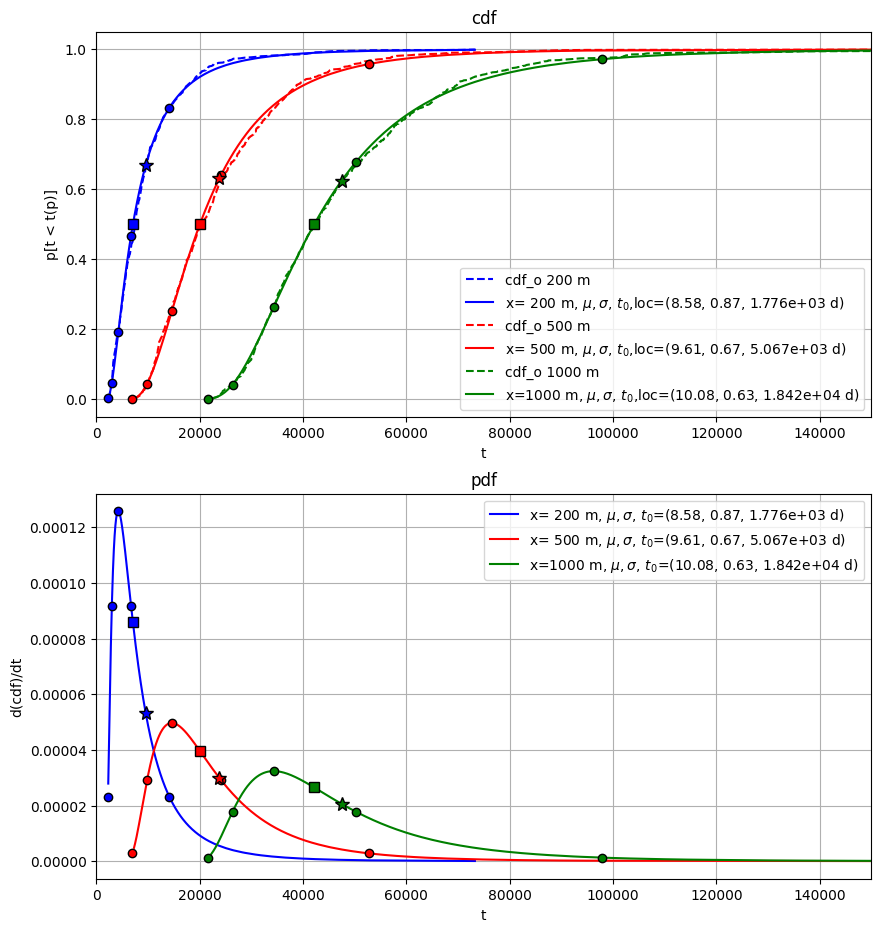

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, '--', color=clr, label=f"cdf_o {x} m")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$,loc=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')

    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)    


for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


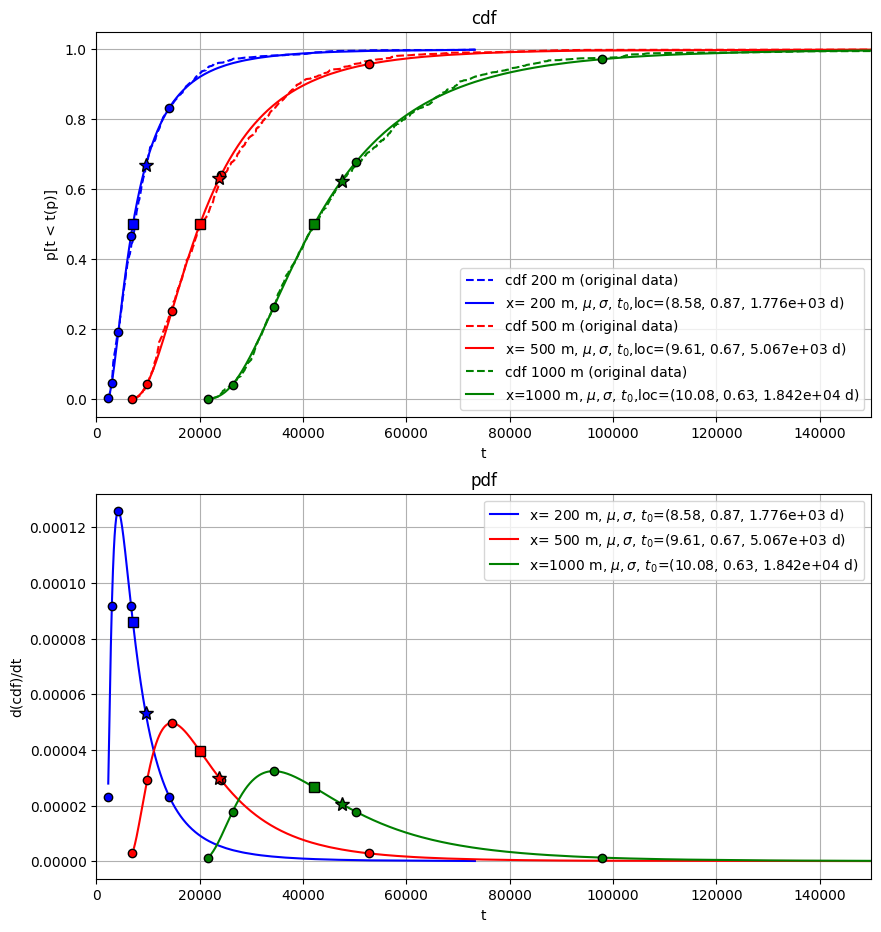

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt') 

ax1.set_xlim(0, 150000.)
ax2.set_xlim(0, 150000.)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, '--', color=clr, label=f"cdf {x} m (original data)")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$,loc=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')

    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)    


for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

In [ ]:
settings['props']

NameError: name 'settings' is not defined

In [ ]:
from settings import dirs, props

In [ ]:
props

{'sim_name': 'wimsaquif',
 'section_name': 'wimsaquif',
 'oc_frequency': 1,
 'icelltype': 0,
 'start_date_time': '2025-04-18',
 'Qdim': 'm2/d',
 'sy': 0.2,
 'ss': 1e-05,
 'por': 0.31,
 'hStrt': 0.0,
 'hL': np.float64(3.5963963963963996),
 'hR': 0.0,
 'cFresh': 0.0,
 'gr': <fdm.mfgrid.Grid at 0x114262600>,
 'k_field': array([[1.73238560e+00, 5.73098290e-01, 6.59343684e-01, ...,
         6.18241164e-03, 3.81698635e-02, 4.69081640e-02],
        [6.87280186e+00, 1.08858398e+01, 6.57402976e+00, ...,
         7.93917817e-03, 6.23039164e-03, 5.98103164e-03],
        [3.73801437e+01, 1.85866566e+01, 2.88851777e+01, ...,
         5.37651230e+00, 5.50724118e+00, 4.68023532e+00],
        ...,
        [6.41698087e+00, 1.28183076e+01, 1.47395774e+02, ...,
         9.46759419e-03, 6.70439204e-03, 1.71660940e-02],
        [1.58006474e+01, 1.16244604e+01, 2.42605879e+01, ...,
         8.06456102e-02, 4.03337507e-02, 4.29674365e-02],
        [1.27954591e+02, 1.15852076e+02, 8.82883945e+01, ...,
       

In [ ]:
props['k_field_str']

KeyError: 'k_field_str'

In [ ]:
props['k_field_props']['k_field_str']

KeyError: 'k_field_props'

In [ ]:
props.kesy()

AttributeError: 'dict' object has no attribute 'kesy'

In [ ]:
props.keys()

dict_keys(['sim_name', 'section_name', 'oc_frequency', 'icelltype', 'start_date_time', 'Qdim', 'sy', 'ss', 'por', 'hStrt', 'hL', 'hR', 'cFresh', 'gr', 'k_field', 'k_field_pars', 'extent'])

In [ ]:
props['k_field_pars']['k_field_str']

'$k_G=0.89\\,m/d,\\,var(\\ln(k)=6.6,\\,I_h=10.2\\,m,\\,I_v=1.5\\,m,\\,\\theta=0.31,\\,J=0.0036$'

NameError: name 'k_field_str' is not defined

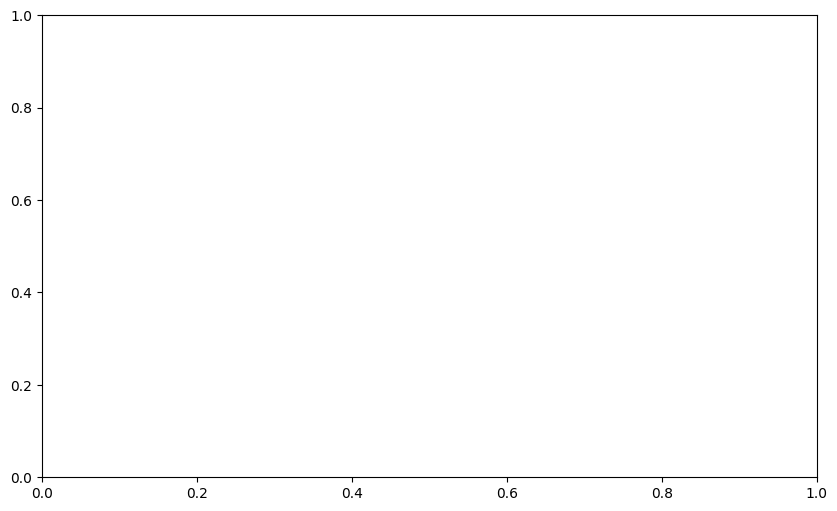

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.set(ttl='Breakthrough curves\n' + k_field_str, xlabel='time [d]', ylabel='p[t < t[p]]')
p = pass_times['id'] / 1000.
for k in cumulatives:
    ax.plot(cumulatives[k], p, label=f'x = {k} m')
    
ax.grid()
ax.legend()

In [ ]:
k_field_str = props['k_field_pars']['k_field_str']

name = 'gaus1000'
pass_times = np.load('pass_times_' + name + '.npy')

cumulatives = dict()

for j, xo in enumerate(pass_times['xObs'][0]):
    idx = np.argsort(pass_times['time'][:, j])    
    t = pass_times['time'][:, j][idx]
    cumulatives[int(xo)] = t

# dtype([('id', '<i4'), ('xObs', '<f8', (10,)), ('time', '<f8', (10,))])

AttributeError: Axes.set() got an unexpected keyword argument 'ttl'

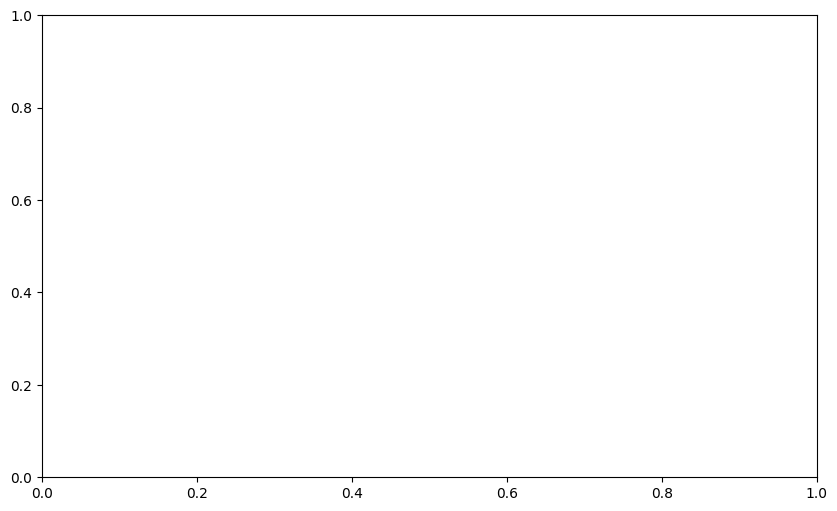

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.set(ttl='Breakthrough curves\n' + k_field_str, xlabel='time [d]', ylabel='p[t < t[p]]')
p = pass_times['id'] / 1000.
for k in cumulatives:
    ax.plot(cumulatives[k], p, label=f'x = {k} m')
    
ax.grid()
ax.legend()

AttributeError: Axes.set() got an unexpected keyword argument 'titel'

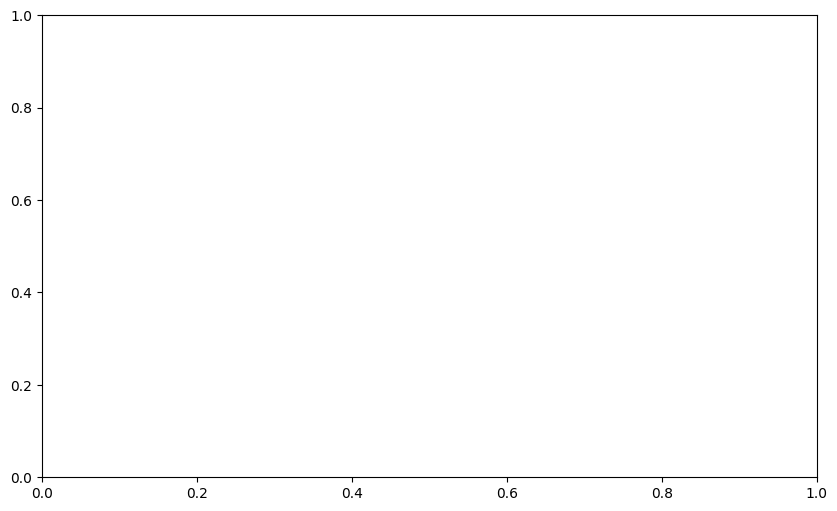

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.set(titel='Breakthrough curves\n' + k_field_str, xlabel='time [d]', ylabel='p[t < t[p]]')
p = pass_times['id'] / 1000.
for k in cumulatives:
    ax.plot(cumulatives[k], p, label=f'x = {k} m')
    
ax.grid()
ax.legend()

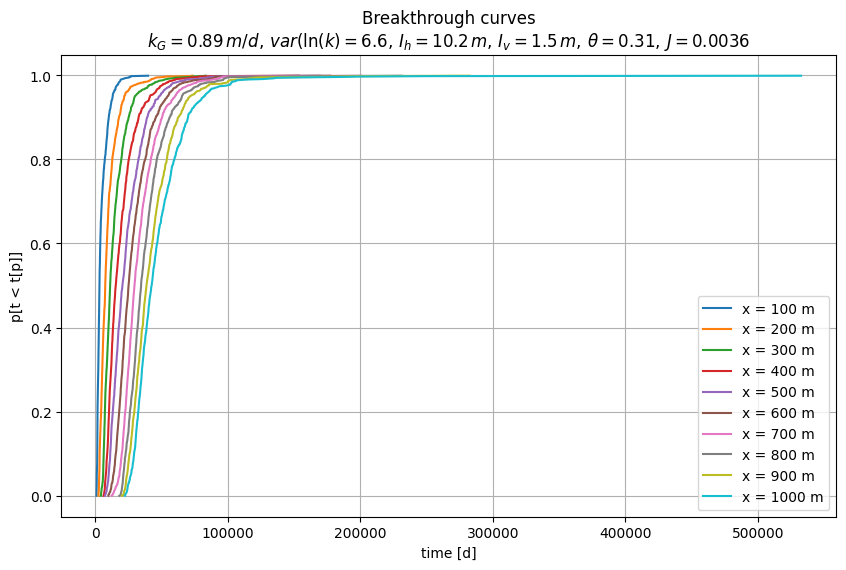

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.set(title='Breakthrough curves\n' + k_field_str, xlabel='time [d]', ylabel='p[t < t[p]]')
p = pass_times['id'] / 1000.
for k in cumulatives:
    ax.plot(cumulatives[k], p, label=f'x = {k} m')
    
ax.grid()
ax.legend()

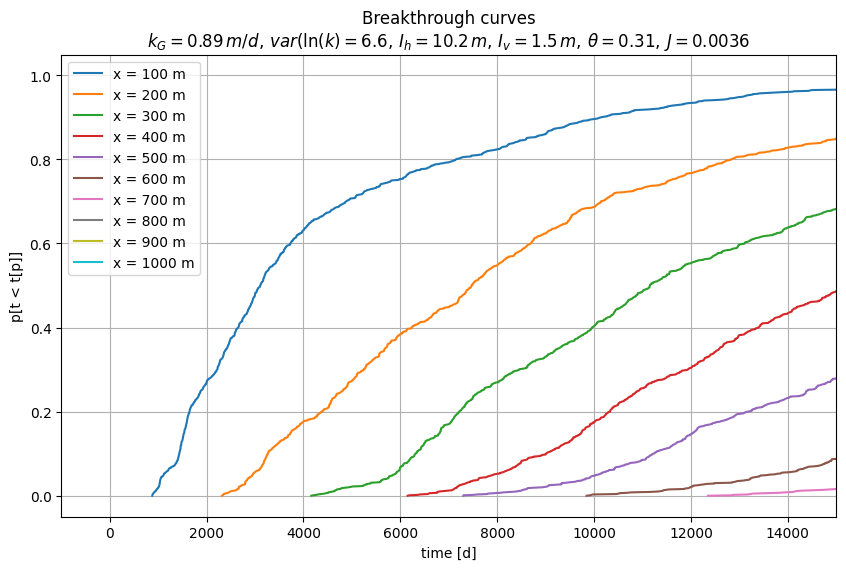

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.set(title='Breakthrough curves\n' + k_field_str, xlabel='time [d]', ylabel='p[t < t[p]]')
p = pass_times['id'] / 1000.
for k in cumulatives:
    ax.plot(cumulatives[k], p, label=f'x = {k} m')
    
ax.set_xlim(-1000, 15000)
ax.grid()
ax.legend()

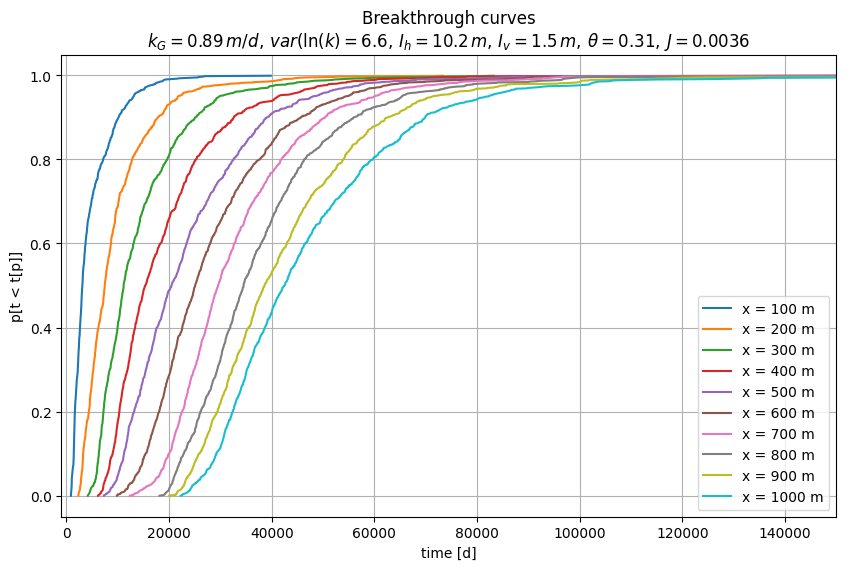

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.set(title='Breakthrough curves\n' + k_field_str, xlabel='time [d]', ylabel='p[t < t[p]]')
p = pass_times['id'] / 1000.
for k in cumulatives:
    ax.plot(cumulatives[k], p, label=f'x = {k} m')
    
ax.set_xlim(-1000, 150000)
ax.grid()
ax.legend()

In [ ]:
cumulatives.keys()

dict_keys([100, 200, 300, 400, 500, 600, 700, 800, 900, 1000])

In [ ]:
cumulatives.keys()[-1]

TypeError: 'dict_keys' object is not subscriptable

In [ ]:
list(cumulatives.keys())[-1]

1000

In [ ]:
cumulatives[list(cumulatives.keys())[-1]]

array([ 22272.86914062,  22463.64257812,  22600.6875    ,  22606.40234375,
        22779.45898438,  23077.53320312,  23305.58203125,  23370.19140625,
        23598.10742188,  23691.79296875,  23733.71484375,  23881.921875  ,
        23884.484375  ,  24049.76367188,  24052.67578125,  24159.79101562,
        24187.63085938,  24206.71484375,  24275.48828125,  24342.3359375 ,
        24412.74804688,  24424.06054688,  24448.73828125,  24467.03710938,
        24528.95507812,  24663.09765625,  24805.72851562,  24842.28320312,
        24954.796875  ,  24980.2890625 ,  25271.36328125,  25279.83007812,
        25298.35742188,  25486.8984375 ,  25649.890625  ,  25650.453125  ,
        25676.80664062,  25730.88867188,  26037.89257812,  26076.58203125,
        26076.66015625,  26085.05664062,  26123.74804688,  26126.90429688,
        26237.30078125,  26311.25585938,  26462.49414062,  26522.61523438,
        26638.37695312,  26740.1171875 ,  26893.0546875 ,  27005.8203125 ,
        27033.671875  ,  

In [ ]:
cumulatives[list(cumulatives.keys())[-1]][-1]

np.float64(532595.1875)

In [ ]:
cumulatives[list(cumulatives.keys())[-1]][-5]

np.float64(154489.8125)

In [ ]:
np.log10(cumulatives[list(cumulatives.keys())[-1]][-5])

np.float64(5.188899846085066)

In [ ]:
np.round(np.log10(cumulatives[list(cumulatives.keys())[-1]][-5]))

np.float64(5.0)

In [ ]:
10 ** np.round(np.log10(cumulatives[list(cumulatives.keys())[-1]][-5]))

np.float64(100000.0)

In [ ]:
10 ** np.ceil(np.log10(cumulatives[list(cumulatives.keys())[-1]][-5]))

np.float64(1000000.0)

In [ ]:
def round_up_nice(x, base=10):
    exponent = np.floor(np.log10(x))       # find order of magnitude
    nice  = np.ceil(x / 10 ** exponent)              # normalize to [1, 10)
    return nice * 10 ** exponent


In [ ]:
last_times = cumulatives[list(cumulatives.keys())][-1]

TypeError: unhashable type: 'list'

In [ ]:
cumulatives.keys()

dict_keys([100, 200, 300, 400, 500, 600, 700, 800, 900, 1000])

In [ ]:
list(cumulatives.keys())

[100, 200, 300, 400, 500, 600, 700, 800, 900, 1000]

In [ ]:
last_times = cumulatives[list(cumulatives.keys())[-1]]

In [ ]:
t_last = last_times[int(0.95 * len(last_times))]

In [ ]:
t_last

np.float64(82342.6875)

In [ ]:
t_last = last_times[int(0.98 * len(last_times))]

In [ ]:
t_last

np.float64(102041.03125)

In [ ]:
t_last = last_times[int(0.99 * len(last_times))]

In [ ]:
t_last

np.float64(114581.9765625)

In [ ]:
last_times

array([ 22272.86914062,  22463.64257812,  22600.6875    ,  22606.40234375,
        22779.45898438,  23077.53320312,  23305.58203125,  23370.19140625,
        23598.10742188,  23691.79296875,  23733.71484375,  23881.921875  ,
        23884.484375  ,  24049.76367188,  24052.67578125,  24159.79101562,
        24187.63085938,  24206.71484375,  24275.48828125,  24342.3359375 ,
        24412.74804688,  24424.06054688,  24448.73828125,  24467.03710938,
        24528.95507812,  24663.09765625,  24805.72851562,  24842.28320312,
        24954.796875  ,  24980.2890625 ,  25271.36328125,  25279.83007812,
        25298.35742188,  25486.8984375 ,  25649.890625  ,  25650.453125  ,
        25676.80664062,  25730.88867188,  26037.89257812,  26076.58203125,
        26076.66015625,  26085.05664062,  26123.74804688,  26126.90429688,
        26237.30078125,  26311.25585938,  26462.49414062,  26522.61523438,
        26638.37695312,  26740.1171875 ,  26893.0546875 ,  27005.8203125 ,
        27033.671875  ,  

In [ ]:
t_last = last_times[int(0.995 * len(last_times))]

In [ ]:
t_last

np.float64(154489.8125)

In [ ]:
round_up_nice(t_last)

np.float64(200000.0)

In [ ]:
round_up_nice(11250)

np.float64(20000.0)

In [ ]:
def round_up_nice(x, m=2):    
    return 10 ** np.ceil(x / 10 ** m)


In [ ]:
round_up_nice(756)

np.float64(100000000.0)

In [ ]:
x = 756

In [ ]:
x / 10 ** 2

7.56

In [ ]:
10 ** 2 * np.ceil(x / 10 ** 2)

np.float64(800.0)

In [ ]:
def round_up_nice(x, m=2):    
    return np.ceil(x / 10 ** m) * 10 ** m


In [ ]:
round_up_nice(np.array([7560, 765., 76.5, 7.65, 0.765, 0.0765]))

array([7600.,  800.,  100.,  100.,  100.,  100.])

In [ ]:
round_up_nice(np.array([7560, 765., 76.5, 7.65, 0.765, 0.0765]), m=3)

array([8000., 1000., 1000., 1000., 1000., 1000.])

In [ ]:
def round_up_nice(x, m=2):
    lx_ = np.log10(x) - m
    return 10 ** (np.ceil(lx_) + m)


In [ ]:
round_up_nice(np.array([7560, 765., 76.5, 7.65, 0.765, 0.0765]), m=3)

array([1.e+04, 1.e+03, 1.e+02, 1.e+01, 1.e+00, 1.e-01])

In [ ]:
round_up_nice(np.array([7560, 765., 76.5, 7.65, 0.765, 0.0765]), m=1)

array([1.e+04, 1.e+03, 1.e+02, 1.e+01, 1.e+00, 1.e-01])

In [ ]:
x = np.array([7560, 765., 76.5, 7.65, 0.765, 0.0765])

In [ ]:
x

array([7.56e+03, 7.65e+02, 7.65e+01, 7.65e+00, 7.65e-01, 7.65e-02])

In [ ]:
lx  = np.log10(x)

In [ ]:
lx

array([ 3.8785218 ,  2.88366144,  1.88366144,  0.88366144, -0.11633856,
       -1.11633856])

In [ ]:
np.ceil(lx_)

NameError: name 'lx_' is not defined

In [ ]:
np.ceil(lx)

array([ 4.,  3.,  2.,  1., -0., -1.])

In [ ]:
m

NameError: name 'm' is not defined

In [ ]:
m = 2

In [ ]:
lx_ = np.log10(x) - m

In [ ]:
lx_

array([ 1.8785218 ,  0.88366144, -0.11633856, -1.11633856, -2.11633856,
       -3.11633856])

In [ ]:
np.ceil(lx_) + m

array([ 4.,  3.,  2.,  1.,  0., -1.])

In [ ]:
10 ** (np.ceil(lx_) + m)

array([1.e+04, 1.e+03, 1.e+02, 1.e+01, 1.e+00, 1.e-01])

In [ ]:
f"{7.834:.2g}"

'7.8'

In [ ]:
f"{7834:.2g}"

'7.8e+03'

In [ ]:
f"{7834:.3g}"

'7.83e+03'

In [ ]:
np.log10(15436.)

np.float64(4.188534769899359)

In [ ]:
x = 15365.
np.log10(x) - np.floor(np.log10(x)) 

np.float64(0.18653256459239742)

In [ ]:
x = 15365.
10 ** (np.log10(x) - np.floor(np.log10(x)))

np.float64(1.5365000000000015)

In [ ]:
x = 15365.
(np.log10(x) - np.floor(np.log10(x)))

np.float64(0.18653256459239742)

In [ ]:
x = 15365.
10 ** (np.log10(x) - np.floor(np.log10(x)))

np.float64(1.5365000000000015)

In [ ]:
x = 15365.
np.round(10 ** (np.log10(x) - np.floor(np.log10(x))), 2)

np.float64(1.54)

In [ ]:
x = 15365.
np.round(10 ** (np.log10(x) + 1 - np.floor(np.log10(x))), 2)

np.float64(15.37)

In [ ]:
x = 15365.
np.ceil(np.round(10 ** (np.log10(x) + 1 - np.floor(np.log10(x))), 2))

np.float64(16.0)

In [ ]:
x = 15365.
10 ** np.floor(log10(x)) * np.ceil(np.round(10 ** (np.log10(x) + 1 - np.floor(np.log10(x))), 2))

NameError: name 'log10' is not defined

In [ ]:
x = 15365.
10 ** np.floor(np.log10(x)) * np.ceil(np.round(10 ** (np.log10(x) + 1 - np.floor(np.log10(x))), 2))

np.float64(160000.0)

In [ ]:
def round_up_nice(x, m=1):
    return 10 ** np.floor(np.log10(x)) * np.ceil(np.round(10 ** (np.log10(x) + m - np.floor(np.log10(x))), 2))


In [ ]:
x = np.array([7560, 765., 76.5, 7.65, 0.765, 0.0765])


In [ ]:
round_up_nice(x)

array([7.6e+04, 7.7e+03, 7.7e+02, 7.7e+01, 7.7e+00, 7.7e-01])

In [ ]:
x = np.array([15324, 1534, 1765., 176.5, 17.65, 1.765, 0.1765])


In [ ]:
round_up_nice(x)

array([1.6e+05, 1.6e+04, 1.8e+04, 1.8e+03, 1.8e+02, 1.8e+01, 1.8e+00])

In [ ]:
def round_up_nice(x, m=2):
    exponent = np.floor(np.log10(x))  # Order of magnitude of x
    sig_digits = 10 ** (np.log10(x) + m - exponent)  # Rescale x to have m significant digits
    nice = np.ceil(np.round(sig_digits, 2))          # Round and ceil to keep it 'nice'
    return 10 ** exponent * nice                     # Rescale back up    


In [ ]:
round_up_nice(x)

array([1.54e+06, 1.54e+05, 1.77e+05, 1.77e+04, 1.77e+03, 1.77e+02,
       1.77e+01])

In [ ]:
def round_up_nice(x, m=2):
    exponent = np.floor(np.log10(x))  # Order of magnitude of x
    sig_digits = 10 ** (np.log10(x) + m - exponent)  # Rescale x to have m significant digits
    nice = np.ceil(np.round(sig_digits))          # Round and ceil to keep it 'nice'
    return 10 ** exponent * nice                     # Rescale back up    


In [ ]:
round_up_nice(x)

array([1.53e+06, 1.53e+05, 1.77e+05, 1.77e+04, 1.76e+03, 1.77e+02,
       1.76e+01])

In [ ]:
round_up_nice(x, m=1)

array([1.5e+05, 1.5e+04, 1.8e+04, 1.8e+03, 1.8e+02, 1.8e+01, 1.8e+00])

In [ ]:
def round_up_nice(x, m=1):
    return 10 ** np.floor(np.log10(x)) * np.ceil(np.round(10 ** (np.log10(x) + m - np.floor(np.log10(x))), 2))


In [ ]:
round_up_nice(x, m=1)

array([1.6e+05, 1.6e+04, 1.8e+04, 1.8e+03, 1.8e+02, 1.8e+01, 1.8e+00])

In [ ]:
round_up_nice(x, m=2)

array([1.54e+06, 1.54e+05, 1.77e+05, 1.77e+04, 1.77e+03, 1.77e+02,
       1.77e+01])

In [ ]:
round_up_nice(x, m=4)

array([1.5324e+08, 1.5340e+07, 1.7650e+07, 1.7650e+06, 1.7650e+05,
       1.7650e+04, 1.7650e+03])

In [ ]:
round_up_nice(x, m=0)

array([2.e+04, 2.e+03, 2.e+03, 2.e+02, 2.e+01, 2.e+00, 2.e-01])

In [ ]:
xlim = (0, round_up_nice(t_last, m=2))

In [ ]:
xlim

(0, np.float64(15500000.0))

In [ ]:
xlim = (0, round_up_nice(t_last, m=1))

In [ ]:
xlim

(0, np.float64(1600000.0))

In [ ]:
k_field_str = props['k_field_pars']['k_field_str']

name = props['k_field_pars']['name']
pass_times = np.load('pass_times_' + name + '.npy')

cumulatives = dict()

for j, xo in enumerate(pass_times['xObs'][0]):
    idx = np.argsort(pass_times['time'][:, j])    
    t = pass_times['time'][:, j][idx]
    cumulatives[int(xo)] = t

last_times = cumulatives[list(cumulatives.keys())[-1]]
t_last = last_times[int(0.995 * len(last_times))]

xlim = (0, round_up_nice(t_last, m=2))

# dtype([('id', '<i4'), ('xObs', '<f8', (10,)), ('time', '<f8', (10,))])

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


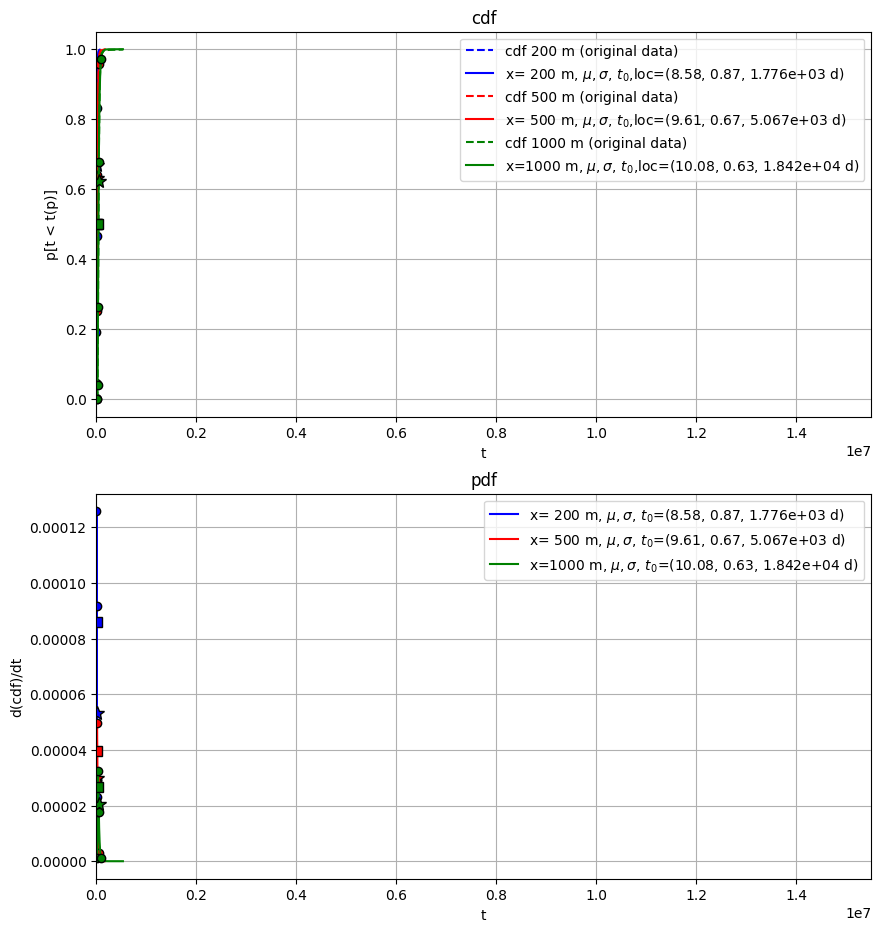

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdf', xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdf', xlabel='t', ylabel='d(cdf)/dt')

ax1.set_xlim(xlim)
ax2.set_xlim(xlim)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, '--', color=clr, label=f"cdf {x} m (original data)")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$,loc=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')

    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)    


for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

In [ ]:
xlim

(0, np.float64(15500000.0))

In [ ]:
x = np.array([15324, 1534, 1765., 176.5, 17.65, 1.765, 0.1765])


In [ ]:
round_up_nice(x, m=0)

array([2.e+04, 2.e+03, 2.e+03, 2.e+02, 2.e+01, 2.e+00, 2.e-01])

In [ ]:
round_up_nice(x, m=1)

array([1.6e+05, 1.6e+04, 1.8e+04, 1.8e+03, 1.8e+02, 1.8e+01, 1.8e+00])

In [ ]:
def round_up_nice(x, m=1):
    return 10 ** (np.floor(np.log10(x)) - m) * np.ceil(
        np.round(10 ** (np.log10(x) + m - np.floor(np.log10(x))), 2))


In [ ]:
round_up_nice(x, m=1)

array([1.6e+04, 1.6e+03, 1.8e+03, 1.8e+02, 1.8e+01, 1.8e+00, 1.8e-01])

In [ ]:
round_up_nice(x, m=2)

array([1.54e+04, 1.54e+03, 1.77e+03, 1.77e+02, 1.77e+01, 1.77e+00,
       1.77e-01])

In [ ]:
xlim = (0, round_up_nice(t_last, m=2))


In [ ]:
xlim

(0, np.float64(155000.0))

In [ ]:
t_last

np.float64(154489.8125)

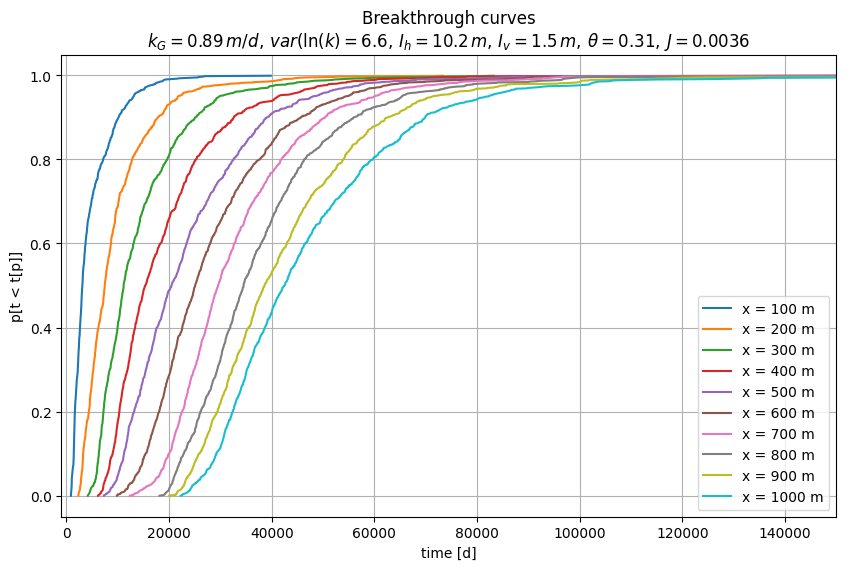

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.set(title='Breakthrough curves\n' + k_field_str, xlabel='time [d]', ylabel='p[t < t[p]]')
p = pass_times['id'] / 1000.
for k in cumulatives:
    ax.plot(cumulatives[k], p, label=f'x = {k} m')
    
ax.set_xlim(-1000, 150000)
ax.grid()
ax.legend()

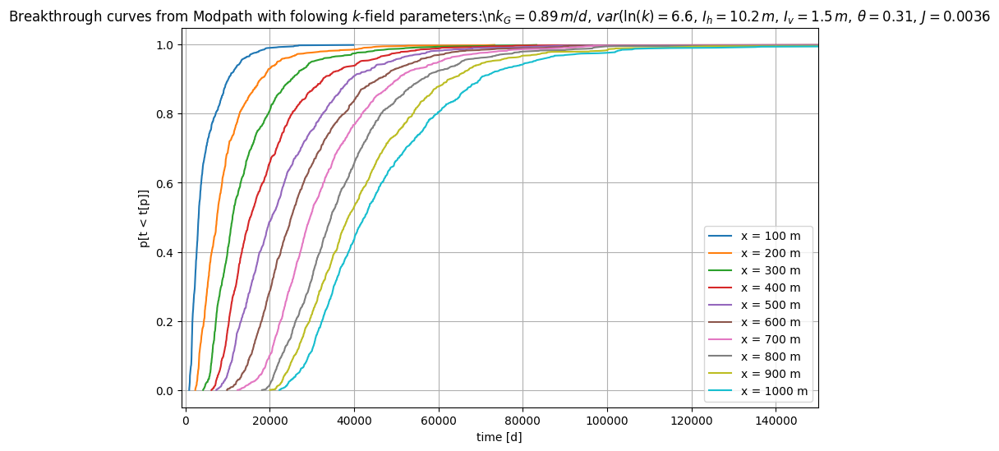

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.set(title=r'Breakthrough curves from Modpath with folowing $k$-field parameters:\n' + k_field_str, xlabel='time [d]', ylabel='p[t < t[p]]')
p = pass_times['id'] / 1000.
for k in cumulatives:
    ax.plot(cumulatives[k], p, label=f'x = {k} m')
    
ax.set_xlim(-1000, 150000)
ax.grid()
ax.legend()

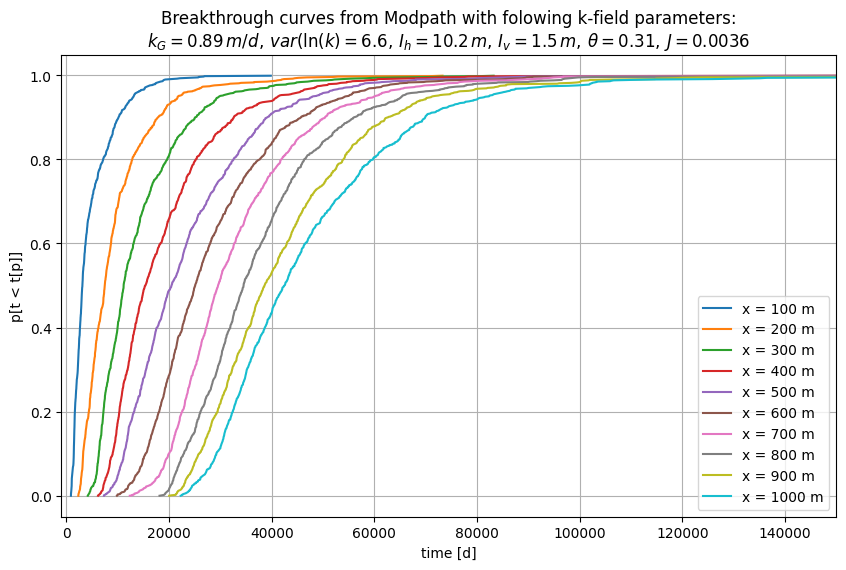

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.set(title='Breakthrough curves from Modpath with folowing k-field parameters:\n' + k_field_str, xlabel='time [d]', ylabel='p[t < t[p]]')
p = pass_times['id'] / 1000.
for k in cumulatives:
    ax.plot(cumulatives[k], p, label=f'x = {k} m')
    
ax.set_xlim(-1000, 150000)
ax.grid()
ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


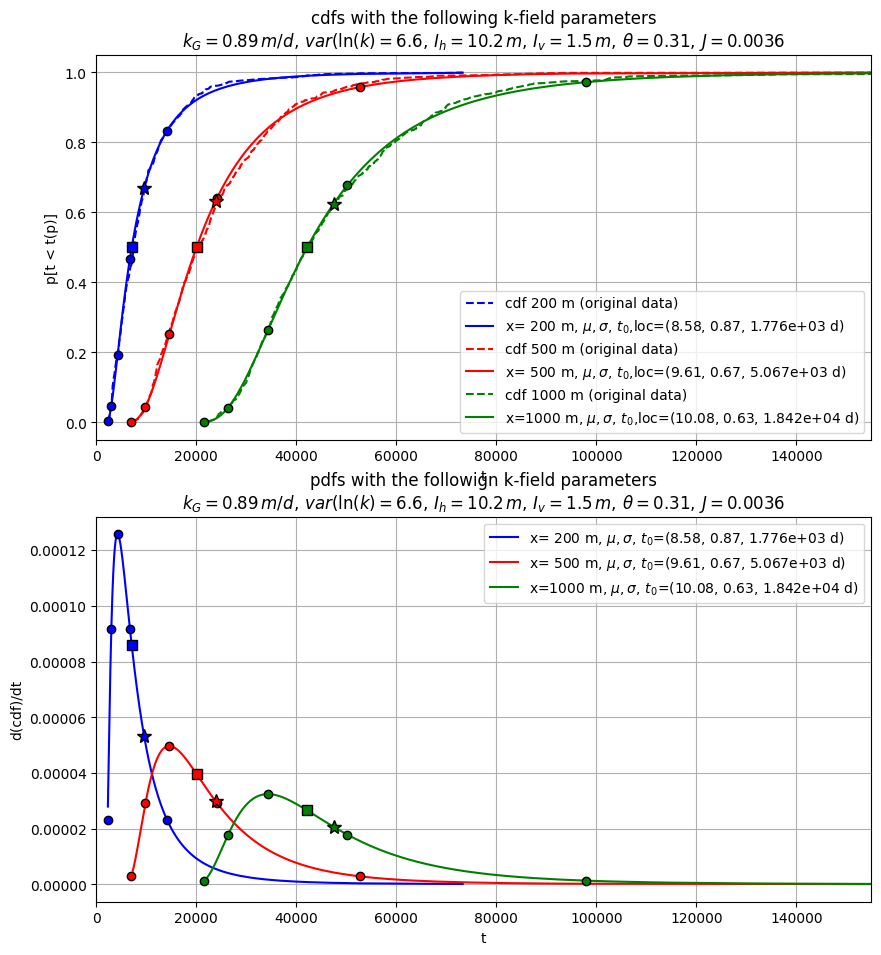

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdfs with the following k-field parameters\n'
        + k_field_str, xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdfs with the followign k-field parameters\n'
        + k_field_str, xlabel='t', ylabel='d(cdf)/dt')

ax1.set_xlim(xlim)
ax2.set_xlim(xlim)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, '--', color=clr, label=f"cdf {x} m (original data)")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$,loc=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')

    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)    


for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


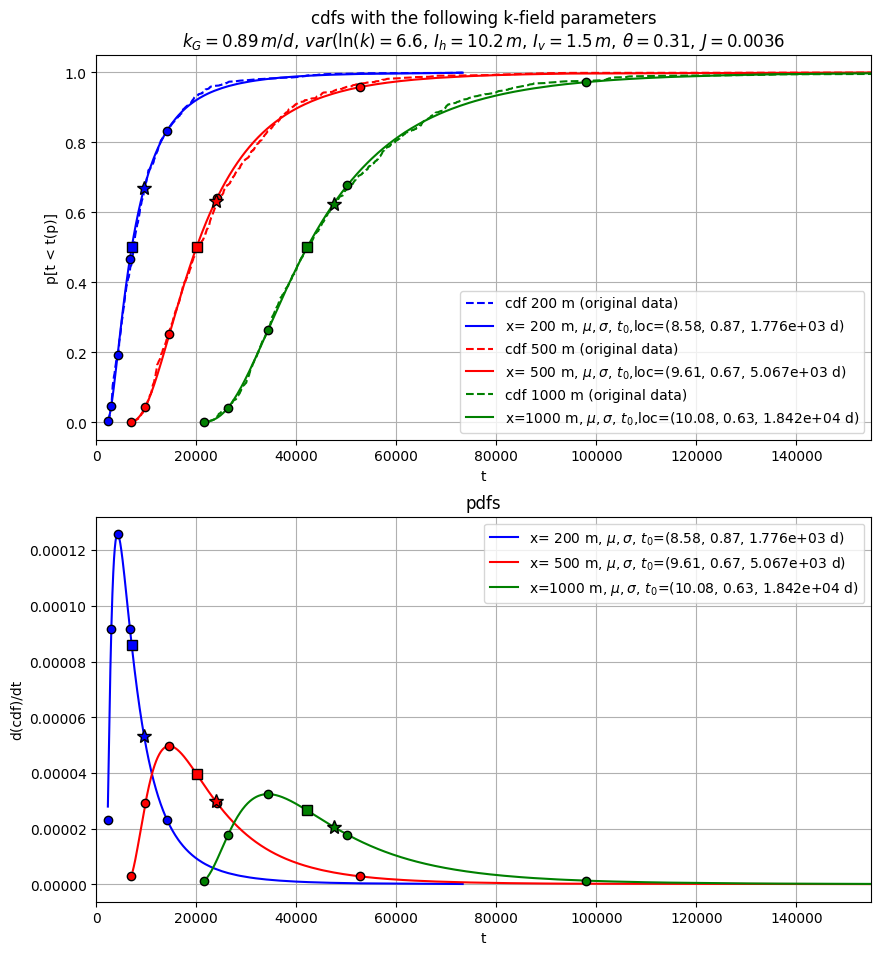

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdfs with the following k-field parameters\n'
        + k_field_str, xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdfs', xlabel='t', ylabel='d(cdf)/dt')

ax1.text(0.6, 0.6, "square is t-median time, star is t-mean",
         transform=ax.transAxes, ha='right', va='top', fontsize=12)

ax1.set_xlim(xlim)
ax2.set_xlim(xlim)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, '--', color=clr, label=f"cdf {x} m (original data)")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$,loc=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')

    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)    


for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


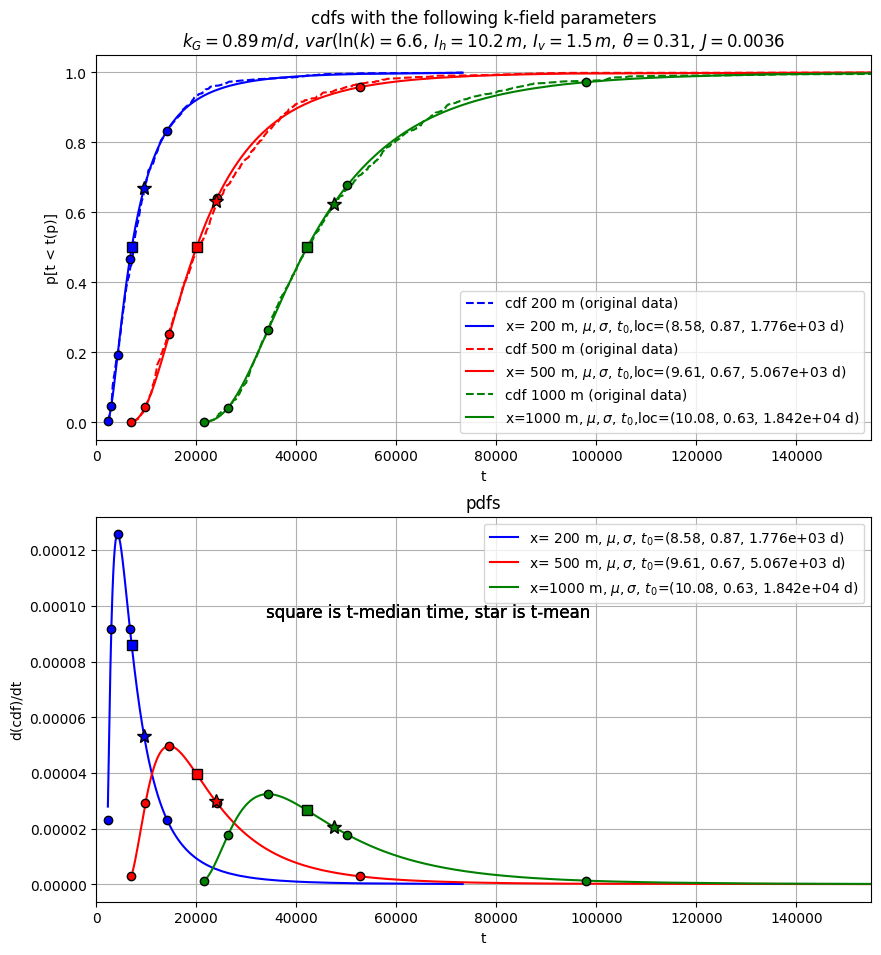

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdfs with the following k-field parameters\n'
        + k_field_str, xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdfs', xlabel='t', ylabel='d(cdf)/dt')

ax1.set_xlim(xlim)
ax2.set_xlim(xlim)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, '--', color=clr, label=f"cdf {x} m (original data)")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$,loc=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')

    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)
    
    ax1.text(0.6, 0.6, "square is t-median time, star is t-mean",
         transform=ax.transAxes, ha='right', va='top', fontsize=12)
    ax2.text(0.6, 0.6, "square is t-median time, star is t-mean",
         transform=ax.transAxes, ha='right', va='top', fontsize=12)
   


for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


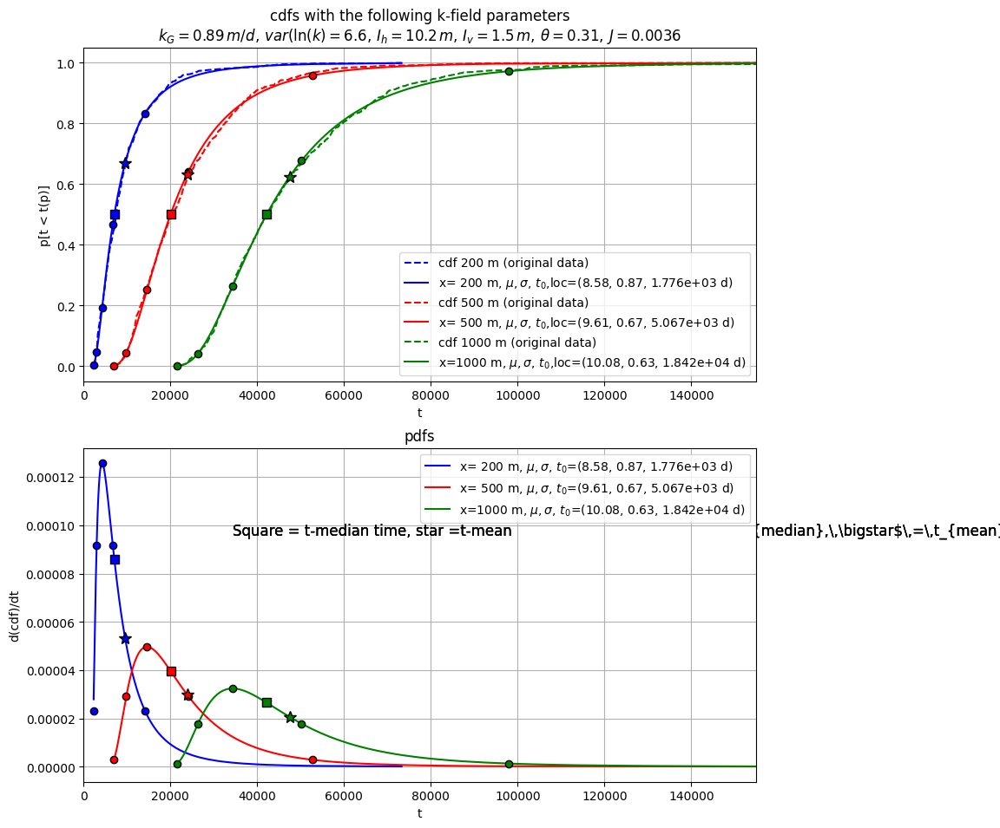

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdfs with the following k-field parameters\n'
        + k_field_str, xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdfs', xlabel='t', ylabel='d(cdf)/dt')

ax1.set_xlim(xlim)
ax2.set_xlim(xlim)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, '--', color=clr, label=f"cdf {x} m (original data)")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$,loc=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')

    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)
    
    ax1.text(0.6, 0.6, r"$\color{geen}\blacksquare\,=\,t_{median},\,\bigstar$\,=\,t_{mean}$",
         transform=ax.transAxes, ha='left', va='top', fontsize=12)
    ax2.text(0.6, 0.6, "Square = t-median time, star =t-mean",
         transform=ax.transAxes, ha='right', va='top', fontsize=12)
   


for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


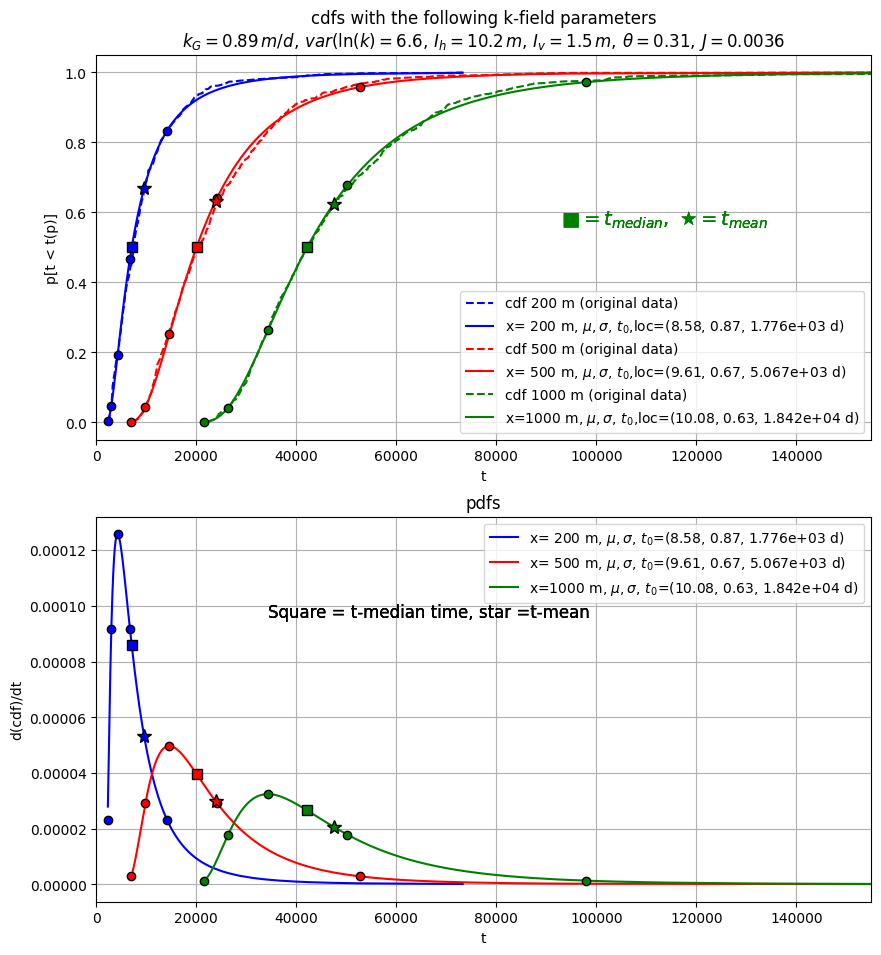

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdfs with the following k-field parameters\n'
        + k_field_str, xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdfs', xlabel='t', ylabel='d(cdf)/dt')

ax1.set_xlim(xlim)
ax2.set_xlim(xlim)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, '--', color=clr, label=f"cdf {x} m (original data)")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$,loc=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')

    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)
    
    ax1.text(0.6, 0.6, 
         r"$\blacksquare = t_{median},\ \bigstar = t_{mean}$", 
         transform=ax1.transAxes, 
         fontsize=14, 
         color='green',
         ha='left', va='top')
    ax2.text(0.6, 0.6, "Square = t-median time, star =t-mean",
         transform=ax.transAxes, ha='right', va='top', fontsize=12)
   


for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


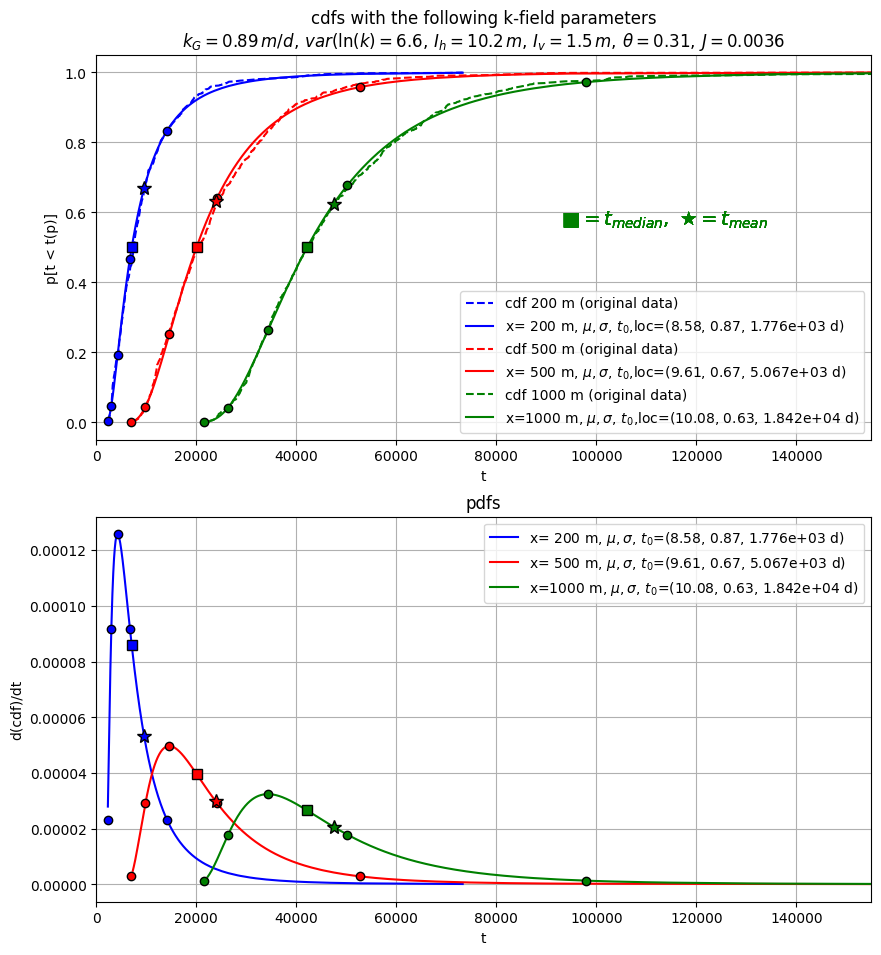

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdfs with the following k-field parameters\n'
        + k_field_str, xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdfs', xlabel='t', ylabel='d(cdf)/dt')

ax1.set_xlim(xlim)
ax2.set_xlim(xlim)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, '--', color=clr, label=f"cdf {x} m (original data)")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$,loc=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')

    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)
    
    ax1.text(0.6, 0.6, 
         r"$\blacksquare = t_{median},\ \bigstar = t_{mean}$", 
         transform=ax1.transAxes, 
         fontsize=14, 
         color='green',
         ha='left', va='top')
    ax2.text(0.6, 0.6,
         r"$\blacksquare = t_{median},\ \bigstar = t_{mean}$", 
         transform=ax1.transAxes, 
         fontsize=14, 
         color='green',
         ha='left', va='top')

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


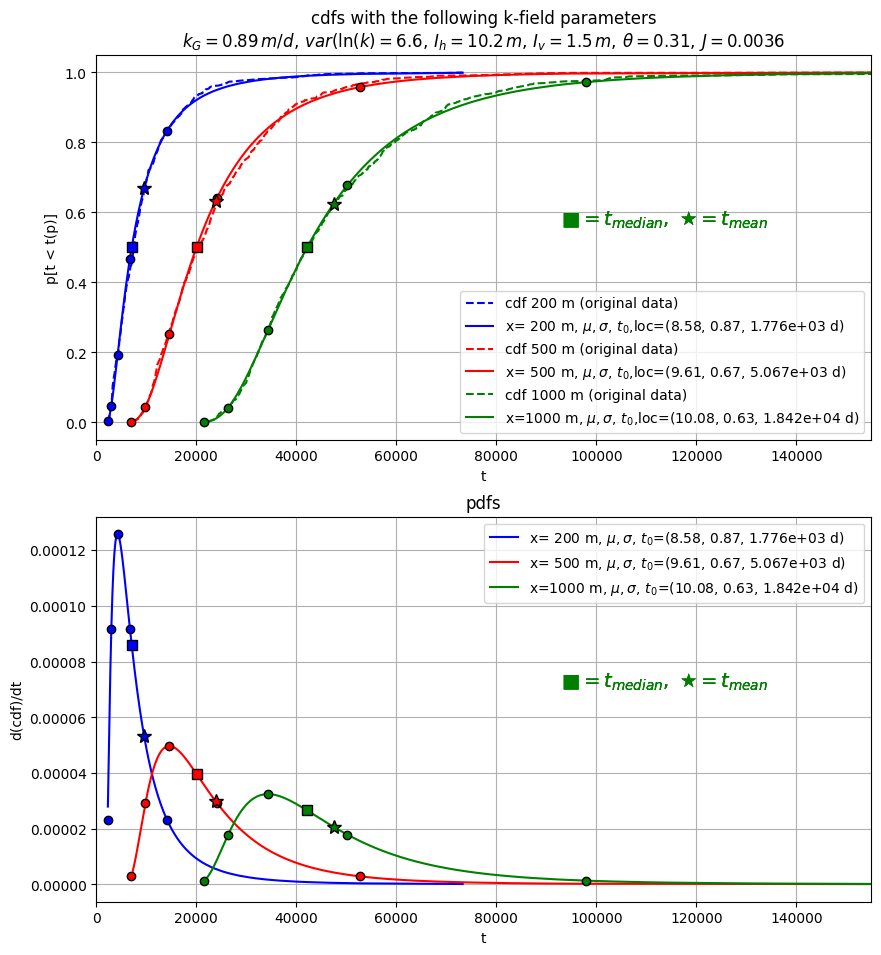

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdfs with the following k-field parameters\n'
        + k_field_str, xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdfs', xlabel='t', ylabel='d(cdf)/dt')

ax1.set_xlim(xlim)
ax2.set_xlim(xlim)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, '--', color=clr, label=f"cdf {x} m (original data)")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$,loc=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')

    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)
    
    ax1.text(0.6, 0.6, 
         r"$\blacksquare = t_{median},\ \bigstar = t_{mean}$", 
         transform=ax1.transAxes, 
         fontsize=14, 
         color='green',
         ha='left', va='top')
    ax2.text(0.6, 0.6,
         r"$\blacksquare = t_{median},\ \bigstar = t_{mean}$", 
         transform=ax2.transAxes, 
         fontsize=14, 
         color='green',
         ha='left', va='top')

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

In [ ]:
props

{'sim_name': 'wimsaquif',
 'section_name': 'wimsaquif',
 'oc_frequency': 1,
 'icelltype': 0,
 'start_date_time': '2025-04-18',
 'Qdim': 'm2/d',
 'sy': 0.2,
 'ss': 1e-05,
 'por': 0.31,
 'hStrt': 0.0,
 'hL': np.float64(3.5963963963963996),
 'hR': 0.0,
 'cFresh': 0.0,
 'gr': <fdm.mfgrid.Grid at 0x114262600>,
 'k_field': array([[1.73238560e+00, 5.73098290e-01, 6.59343684e-01, ...,
         6.18241164e-03, 3.81698635e-02, 4.69081640e-02],
        [6.87280186e+00, 1.08858398e+01, 6.57402976e+00, ...,
         7.93917817e-03, 6.23039164e-03, 5.98103164e-03],
        [3.73801437e+01, 1.85866566e+01, 2.88851777e+01, ...,
         5.37651230e+00, 5.50724118e+00, 4.68023532e+00],
        ...,
        [6.41698087e+00, 1.28183076e+01, 1.47395774e+02, ...,
         9.46759419e-03, 6.70439204e-03, 1.71660940e-02],
        [1.58006474e+01, 1.16244604e+01, 2.42605879e+01, ...,
         8.06456102e-02, 4.03337507e-02, 4.29674365e-02],
        [1.27954591e+02, 1.15852076e+02, 8.82883945e+01, ...,
       

In [ ]:
dirs.MP7

'/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif/MP7'

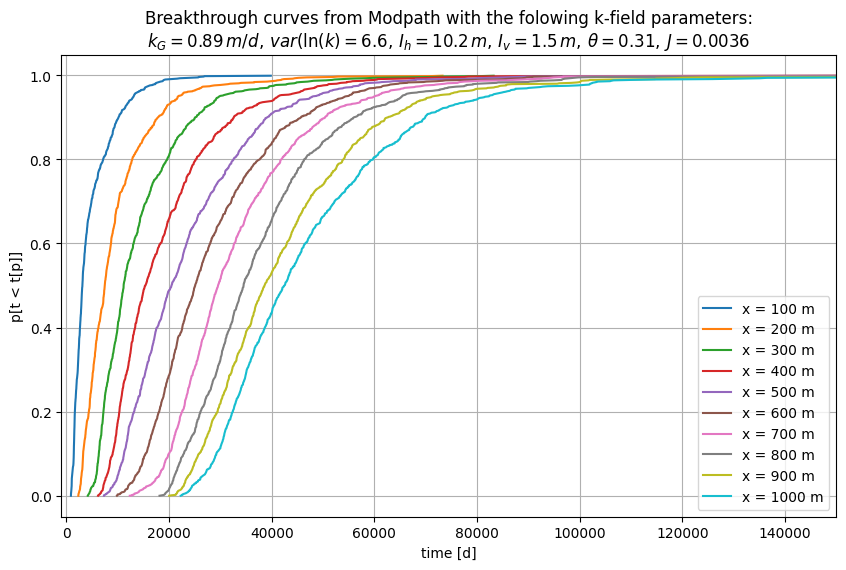

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.set(title='Breakthrough curves from Modpath with the folowing k-field parameters:\n' + k_field_str, xlabel='time [d]', ylabel='p[t < t[p]]')
p = pass_times['id'] / 1000.
for k in cumulatives:
    ax.plot(cumulatives[k], p, label=f'x = {k} m')
    
ax.set_xlim(-1000, 150000)
ax.grid()
ax.legend()

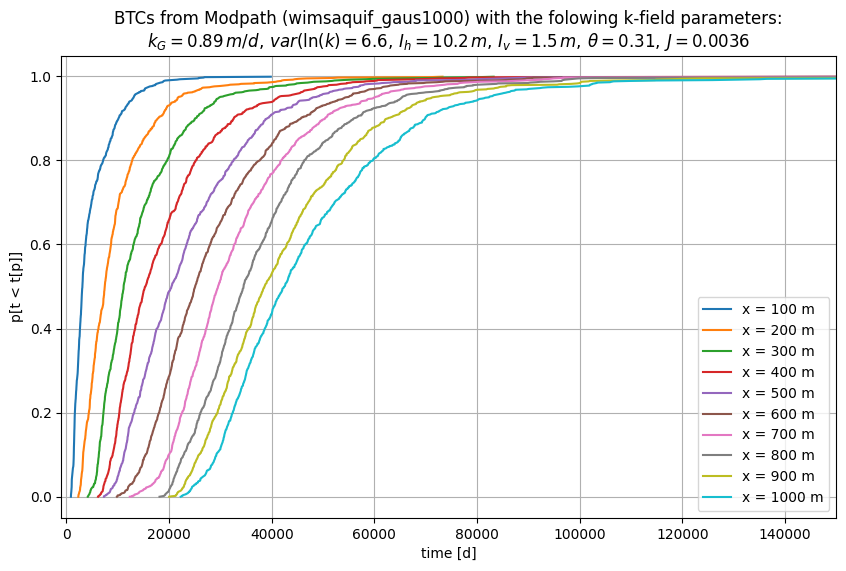

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.set(title='BTCs from Modpath (' + props['sim_name'] + '_' + name + ') with the folowing k-field parameters:\n' + k_field_str, xlabel='time [d]', ylabel='p[t < t[p]]')
p = pass_times['id'] / 1000.
for k in cumulatives:
    ax.plot(cumulatives[k], p, label=f'x = {k} m')
    
ax.set_xlim(-1000, 150000)
ax.grid()
ax.legend()

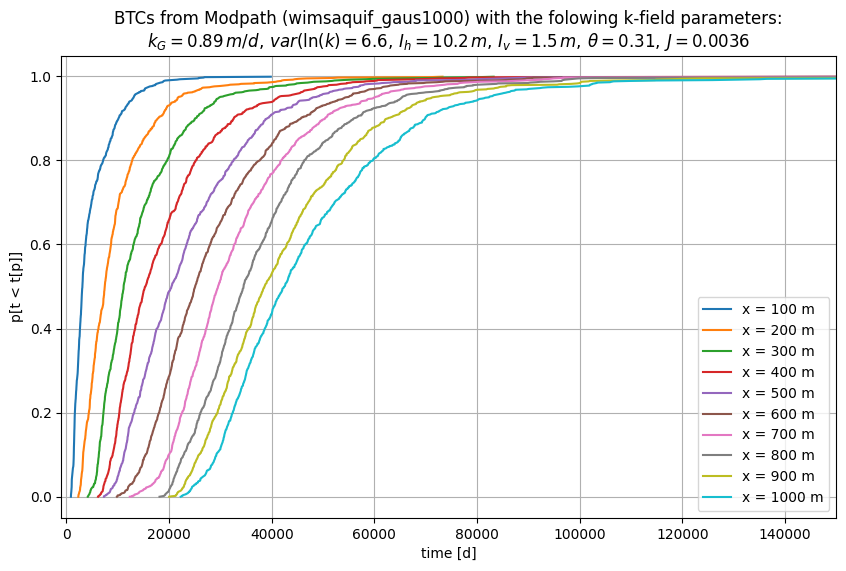

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.set(title='BTCs from Modpath (' + props['sim_name'] + '_' + name + ') with the folowing k-field parameters:\n' + k_field_str, xlabel='time [d]', ylabel='p[t < t[p]]')
p = pass_times['id'] / 1000.
for k in cumulatives:
    ax.plot(cumulatives[k], p, label=f'x = {k} m')
    
ax.set_xlim(-1000, 150000)
ax.grid()
ax.legend()

fig. savefig(os.path.join(dirs.MP7, 
            props['sim_name'] + '_' + name + '_BTCs.png'))

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  500       9.61      0.672   5.07e+03
 1000       10.1      0.634   1.84e+04


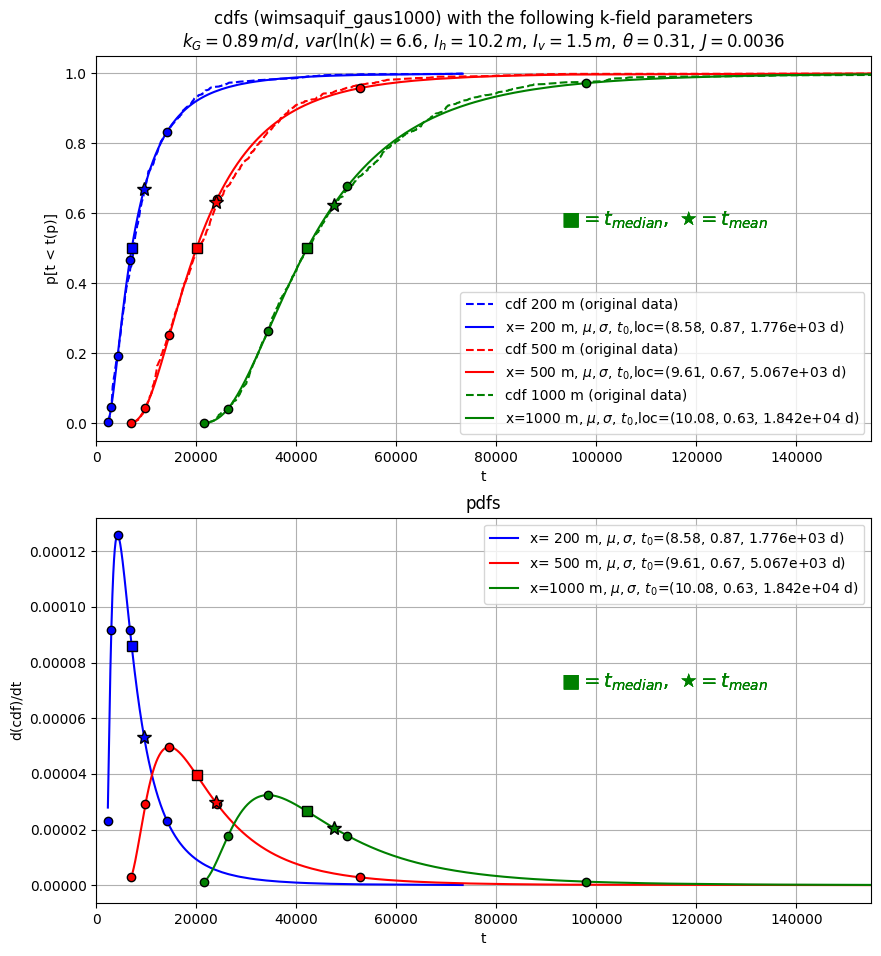

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdfs (' + props['sim_name'] + '_' + name + ') with the following k-field parameters\n'
        + k_field_str, xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdfs', xlabel='t', ylabel='d(cdf)/dt')

ax1.set_xlim(xlim)
ax2.set_xlim(xlim)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 500, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, '--', color=clr, label=f"cdf {x} m (original data)")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$,loc=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')

    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)
    
    ax1.text(0.6, 0.6, 
         r"$\blacksquare = t_{median},\ \bigstar = t_{mean}$", 
         transform=ax1.transAxes, 
         fontsize=14, 
         color='green',
         ha='left', va='top')
    ax2.text(0.6, 0.6,
         r"$\blacksquare = t_{median},\ \bigstar = t_{mean}$", 
         transform=ax2.transAxes, 
         fontsize=14, 
         color='green',
         ha='left', va='top')

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

fig. savefig(os.path.join(dirs.MP7, 
            props['sim_name'] + '_' + name + '_analysis_.png'))

x     mu         sigma      scale     
  100       7.79       1.02        724
  200       8.58      0.875   1.78e+03
  300       8.96      0.799   3.49e+03
  400       9.23      0.786   5.16e+03
  500       9.61      0.672   5.07e+03
  600       9.84      0.574   6.31e+03
  700       9.98      0.521   8.36e+03
  800       9.88      0.608   1.45e+04
  900       9.99      0.622   1.65e+04
 1000       10.1      0.634   1.84e+04


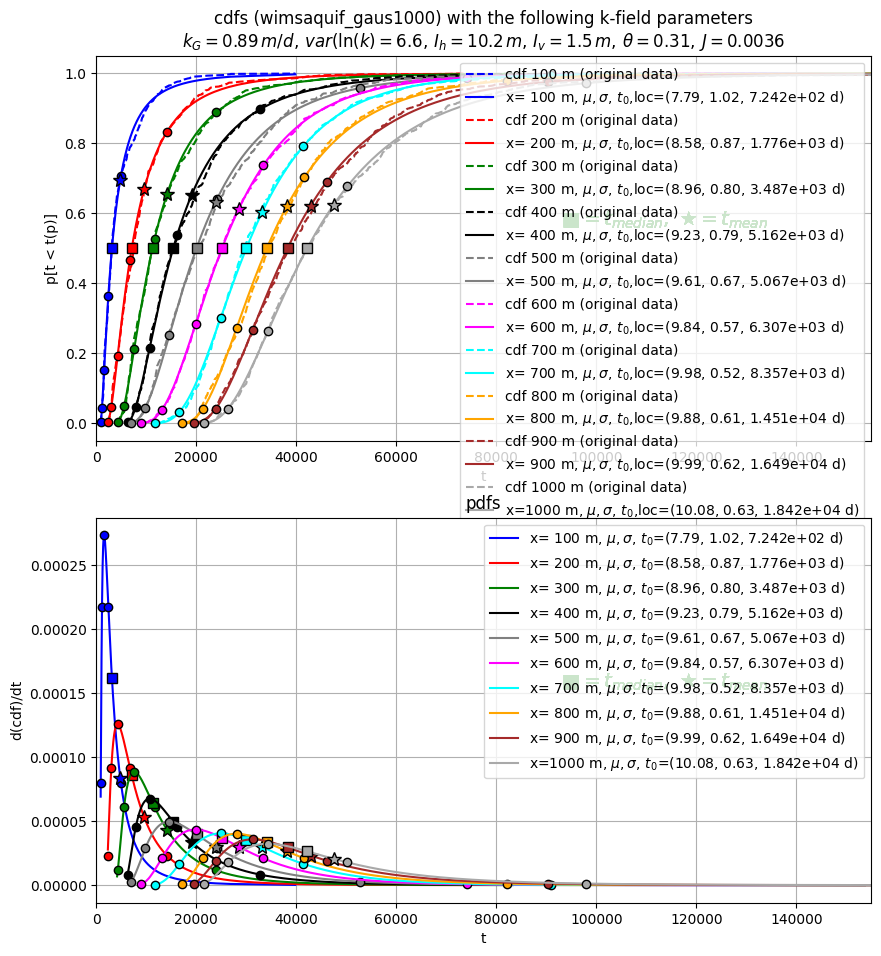

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdfs (' + props['sim_name'] + '_' + name + ') with the following k-field parameters\n'
        + k_field_str, xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdfs', xlabel='t', ylabel='d(cdf)/dt')

ax1.set_xlim(xlim)
ax2.set_xlim(xlim)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    # if x not in [200, 500, 1000]:
    #    continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, '--', color=clr, label=f"cdf {x} m (original data)")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$,loc=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')

    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)
    
    ax1.text(0.6, 0.6, 
         r"$\blacksquare = t_{median},\ \bigstar = t_{mean}$", 
         transform=ax1.transAxes, 
         fontsize=14, 
         color='green',
         ha='left', va='top')
    ax2.text(0.6, 0.6,
         r"$\blacksquare = t_{median},\ \bigstar = t_{mean}$", 
         transform=ax2.transAxes, 
         fontsize=14, 
         color='green',
         ha='left', va='top')

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

fig. savefig(os.path.join(dirs.MP7, 
            props['sim_name'] + '_' + name + '_analysis_.png'))

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  400       9.23      0.786   5.16e+03
  600       9.84      0.574   6.31e+03
  800       9.88      0.608   1.45e+04
 1000       10.1      0.634   1.84e+04


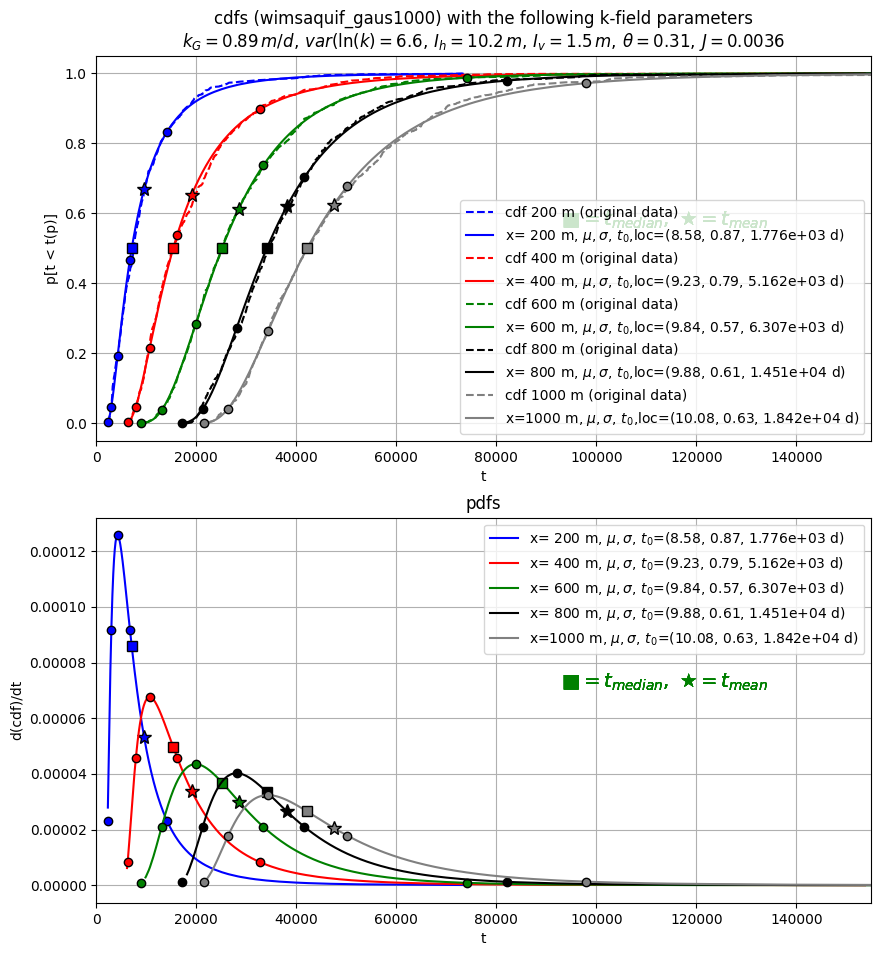

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdfs (' + props['sim_name'] + '_' + name + ') with the following k-field parameters\n'
        + k_field_str, xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdfs', xlabel='t', ylabel='d(cdf)/dt')

ax1.set_xlim(xlim)
ax2.set_xlim(xlim)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 400, 600, 800, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, '--', color=clr, label=f"cdf {x} m (original data)")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$,loc=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')

    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)
    
    ax1.text(0.6, 0.6, 
         r"$\blacksquare = t_{median},\ \bigstar = t_{mean}$", 
         transform=ax1.transAxes, 
         fontsize=14, 
         color='green',
         ha='left', va='top')
    ax2.text(0.6, 0.6,
         r"$\blacksquare = t_{median},\ \bigstar = t_{mean}$", 
         transform=ax2.transAxes, 
         fontsize=14, 
         color='green',
         ha='left', va='top')

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

fig. savefig(os.path.join(dirs.MP7, 
            props['sim_name'] + '_' + name + '_analysis_.png'))

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  400       9.23      0.786   5.16e+03
  600       9.84      0.574   6.31e+03
  800       9.88      0.608   1.45e+04
 1000       10.1      0.634   1.84e+04


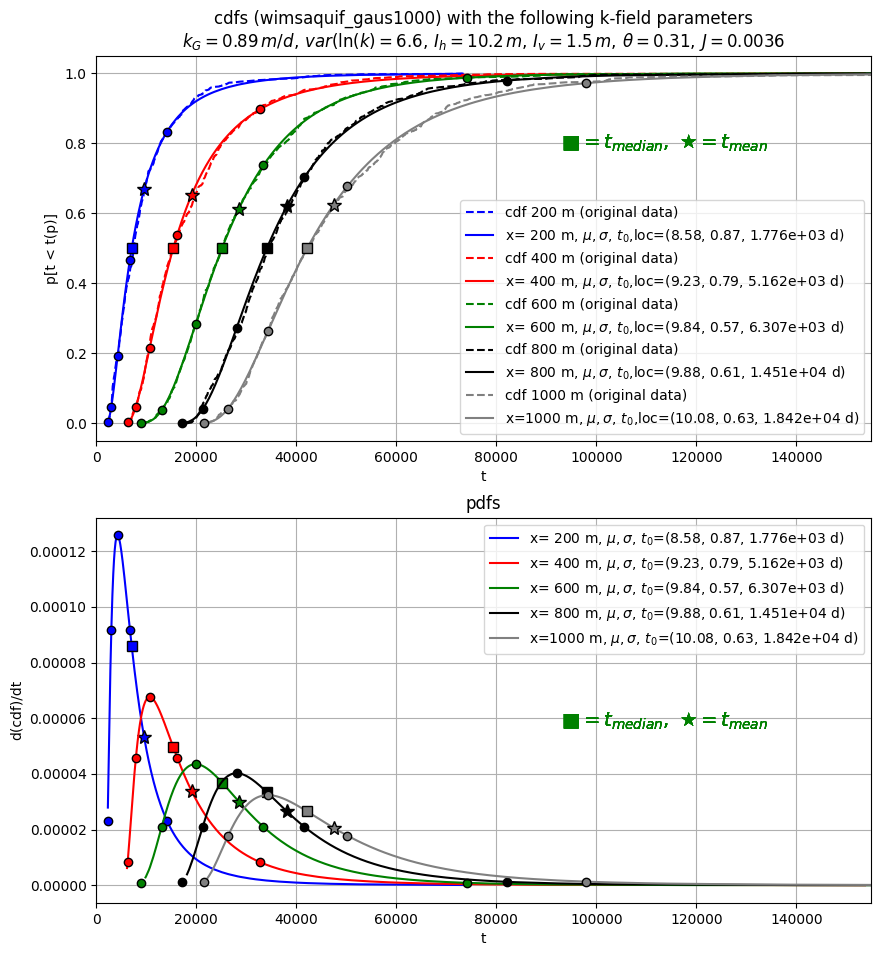

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdfs (' + props['sim_name'] + '_' + name + ') with the following k-field parameters\n'
        + k_field_str, xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdfs', xlabel='t', ylabel='d(cdf)/dt')

ax1.set_xlim(xlim)
ax2.set_xlim(xlim)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 400, 600, 800, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, '--', color=clr, label=f"cdf {x} m (original data)")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$,loc=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')

    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)
    
    ax1.text(0.6, 0.8, 
         r"$\blacksquare = t_{median},\ \bigstar = t_{mean}$", 
         transform=ax1.transAxes, 
         fontsize=14, 
         color='green',
         ha='left', va='top')
    ax2.text(0.6, 0.5,
         r"$\blacksquare = t_{median},\ \bigstar = t_{mean}$", 
         transform=ax2.transAxes, 
         fontsize=14, 
         color='green',
         ha='left', va='top')

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

fig. savefig(os.path.join(dirs.MP7, 
            props['sim_name'] + '_' + name + '_analysis_.png'))

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  400       9.23      0.786   5.16e+03
  600       9.84      0.574   6.31e+03
  800       9.88      0.608   1.45e+04
 1000       10.1      0.634   1.84e+04


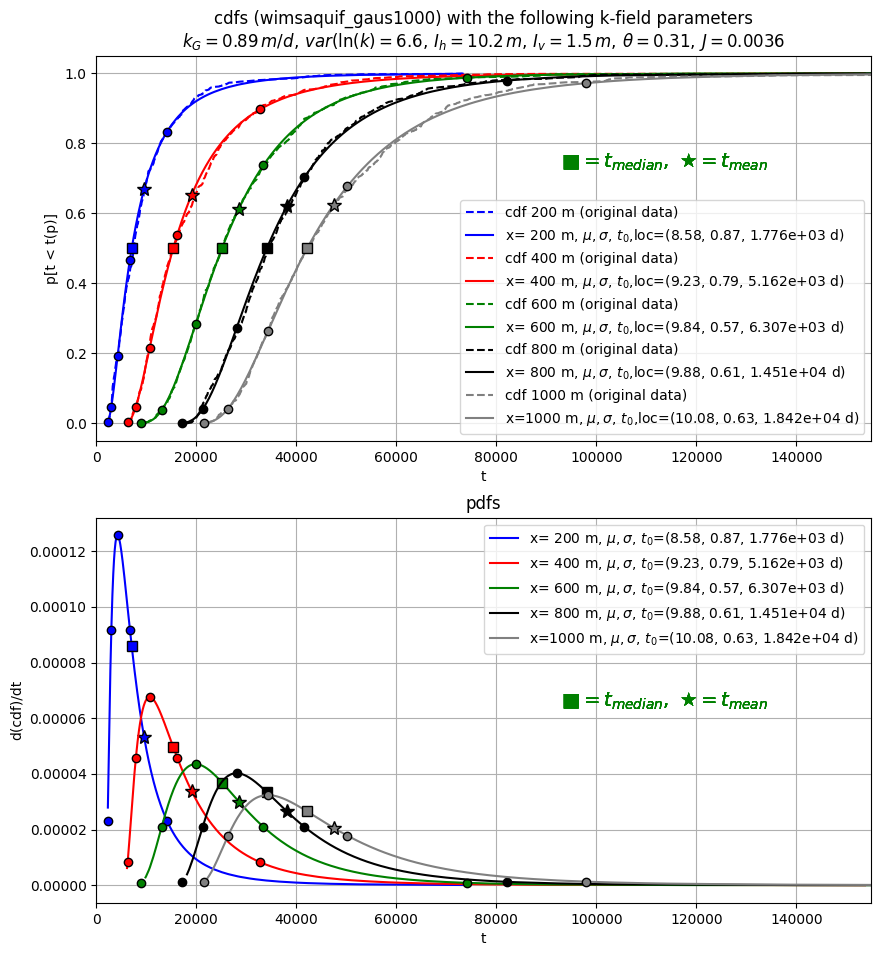

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdfs (' + props['sim_name'] + '_' + name + ') with the following k-field parameters\n'
        + k_field_str, xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdfs', xlabel='t', ylabel='d(cdf)/dt')

ax1.set_xlim(xlim)
ax2.set_xlim(xlim)

dtype=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('mode_t', '<f8'), ('median', '<f8'), ('mean_t', '<f8'),
                ('vmode', '<f8'), ('vmean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])

musigmaloc = np.zeros(len(cumulatives), dtype=dtype)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 400, 600, 800, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    musigmaloc[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, '--', color=clr, label=f"cdf {x} m (original data)")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$,loc=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')

    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)
    
    ax1.text(0.6, 0.75, 
         r"$\blacksquare = t_{median},\ \bigstar = t_{mean}$", 
         transform=ax1.transAxes, 
         fontsize=14, 
         color='green',
         ha='left', va='top')
    ax2.text(0.6, 0.55,
         r"$\blacksquare = t_{median},\ \bigstar = t_{mean}$", 
         transform=ax2.transAxes, 
         fontsize=14, 
         color='green',
         ha='left', va='top')

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

fig. savefig(os.path.join(dirs.MP7, 
            props['sim_name'] + '_' + name + '_analysis_.png'))

In [ ]:
# Analyting pass times

# %%
import os

os.chdir('/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif')

import numpy as np
import matplotlib.pyplot as plt
from settings import dirs, props
from scipy.interpolate import UnivariateSpline
from scipy import stats
from itertools import cycle

os.chdir(dirs.MP7)

def round_up_nice(x, m=1):
    return 10 ** (np.floor(np.log10(x)) - m) * np.ceil(
        np.round(10 ** (np.log10(x) + m - np.floor(np.log10(x))), 2))

In [ ]:
k_field_str = props['k_field_pars']['k_field_str']

name = props['k_field_pars']['name']
pass_times = np.load('pass_times_' + name + '.npy')

cumulatives = dict()

for j, xo in enumerate(pass_times['xObs'][0]):
    idx = np.argsort(pass_times['time'][:, j])    
    t = pass_times['time'][:, j][idx]
    cumulatives[int(xo)] = t

last_times = cumulatives[list(cumulatives.keys())[-1]]
t_last = last_times[int(0.995 * len(last_times))]

xlim = (0, round_up_nice(t_last, m=2))

# dtype([('id', '<i4'), ('xObs', '<f8', (10,)), ('time', '<f8', (10,))])

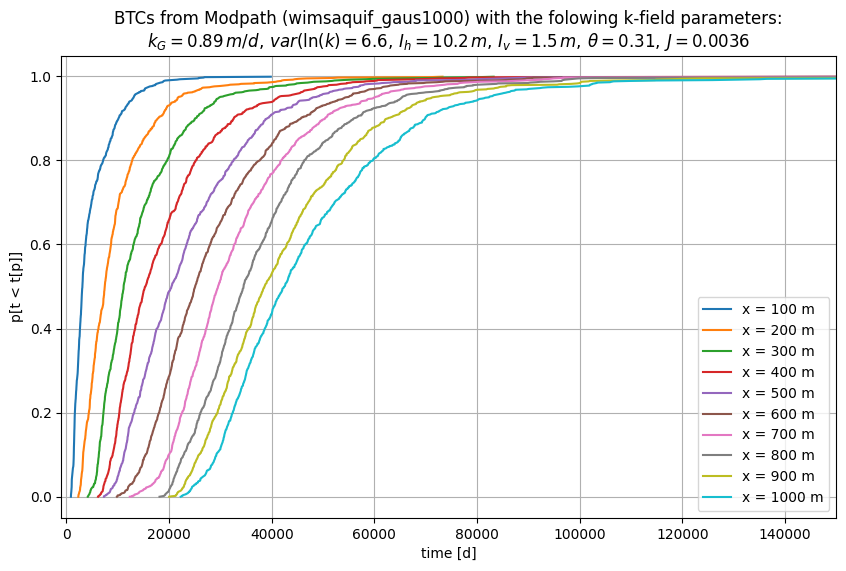

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.set(title='BTCs from Modpath (' + props['sim_name'] + '_' + name + ') with the folowing k-field parameters:\n' + k_field_str, xlabel='time [d]', ylabel='p[t < t[p]]')
p = pass_times['id'] / 1000.
for k in cumulatives:
    ax.plot(cumulatives[k], p, label=f'x = {k} m')
    
ax.set_xlim(-1000, 150000)
ax.grid()
ax.legend()

fig. savefig(os.path.join(dirs.MP7, 
            props['sim_name'] + '_' + name + '_BTCs.png'))

x     mu         sigma      scale     
  200       8.58      0.875   1.78e+03
  400       9.23      0.786   5.16e+03
  600       9.84      0.574   6.31e+03
  800       9.88      0.608   1.45e+04
 1000       10.1      0.634   1.84e+04


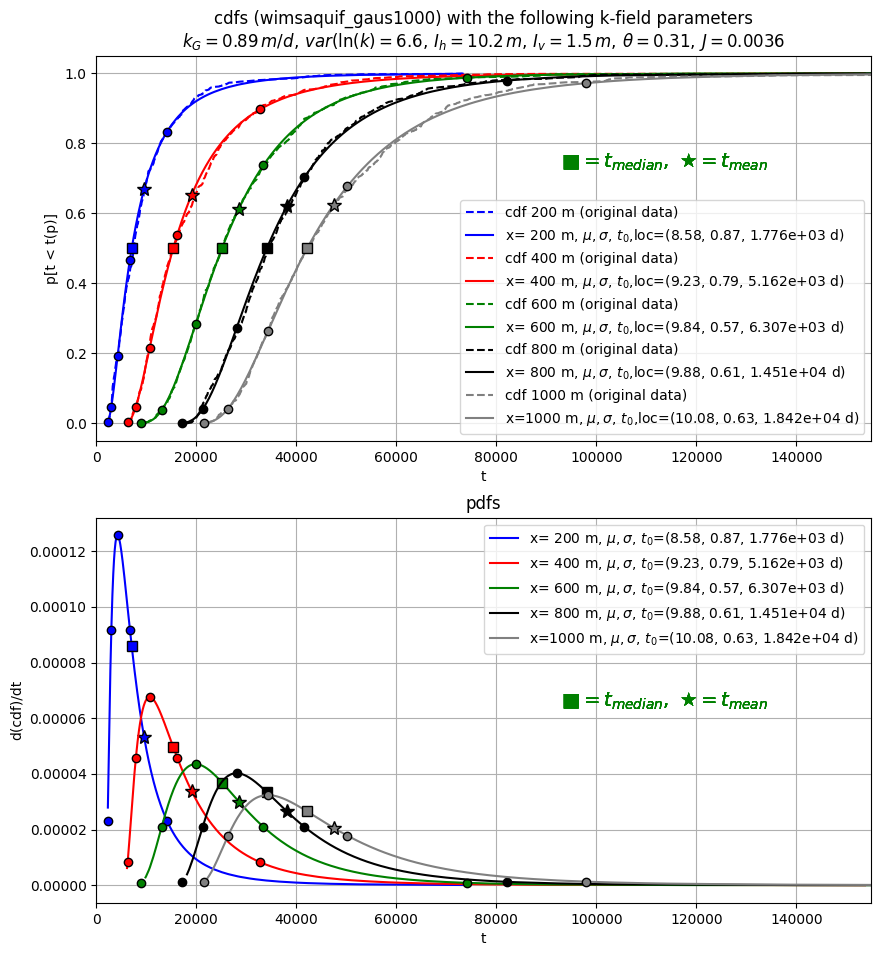

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdfs (' + props['sim_name'] + '_' + name + ') with the following k-field parameters\n'
        + k_field_str, xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdfs', xlabel='t', ylabel='d(cdf)/dt')

ax1.set_xlim(xlim)
ax2.set_xlim(xlim)

dtype1=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('t_mode', '<f8'), ('t_med', '<f8'), ('t_mean', '<f8'),
                ('v_mode', '<f8'), ('v_mean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])
dtype3=np.dtype([('x', '<i4'),
        ('tm02', '<f8'), ('tm05', '<f8'), ('tm10', '<f8'), ('tm20', '<f8'), ('tm50', '<f8'),
        ('cm02', '<f8'), ('cm05', '<f8'), ('cm10', '<f8'), ('cm20', '<f8'), ('cm50', '<f8'),
        ('pm02', '<f8'), ('pm05', '<f8'), ('pm10', '<f8'), ('pm20', '<f8'), ('pm50', '<f8')])


bt_cdf_props = np.zeros(len(cumulatives), dtype=dtype1)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
bt_mode  = np.zeros(len(cumulatives), dtype=dtype3) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    if x not in [200, 400, 600, 800, 1000]:
        continue
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    t05, t16, t50, t84, t95 = dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),    dist.ppf(0.8413), dist.ppf(0.95)
    
    bt_times[ix] = np.array([(x,
                              np.round(t05),
                              np.round(t16),
                              np.round(t50),
                              np.round(t84),
                              np.round(t95))], dtype=dtype2)

    mu = np.log(scale)
    sigma = shape 
    t0=loc
    mode_t = t0 + np.exp(mu - sigma ** 2)
    median_t = loc + np.exp(mu)
    mean_t = t0 + np.exp(mu + 0.5 * sigma ** 2)
    vmean = x / mean_t
    vmode = x / mode_t
    bt_cdf_props[ix] = np.array([(x, mu, sigma,
                                np.round(t0),
                                np.round(mode_t),
                                np.round(median_t),
                                np.round(mean_t),
                                np.round(vmode, 4),
                                np.round(vmean, 4)
                                )], dtype=dtype1)
    
    print("{:5d} {:10.3g} {:10.3g} {:10.3g}".format(x, mu, sigma, loc))
    
    pdf_mode = stats.lognorm.pdf(mode_t, *params_lognorm)

    
    ax1.plot(t, cdf_o, '--', color=clr, label=f"cdf {x} m (original data)")
    ax1.plot(t,
        cdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$,loc=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")
    ax2.plot(t, pdf_lognorm, color=clr, label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")

    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0])
    ta = t0 + (mode_t - t0) * alpha
    ca = stats.lognorm.cdf(ta, *params_lognorm)
    pa = stats.lognorm.pdf(ta, *params_lognorm)
    L = [x] + list(ta) + list(ca) + list(pa)
    nms = [nm[0] for nm in dtype3.descr]
    for nm, v in zip(nms, L):
        bt_mode[ix][nm] = v
        
    ax1.plot(ta, stats.lognorm.cdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')
    ax2.plot(ta, stats.lognorm.pdf(ta, *params_lognorm), 'o', mfc=clr, mec='k')

    ax1.plot(median_t, stats.lognorm.cdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    ax2.plot(median_t, stats.lognorm.pdf(median_t, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
    
    ax1.plot(mean_t, stats.lognorm.cdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
    ax2.plot(mean_t, stats.lognorm.pdf(mean_t, *params_lognorm), '*', ms=10, mfc=clr, mec='k')

    # ax1.vlines([t05, t16, t50, t84, t95], 0, ymax=0.95, colors=clr)
    # ax2.vlines([t05, t16, t50, t84, t95], 0, ymax=pdf_mode, colors=clr)    
    
    # ax1.vlines(ta, 0, ymax=0.95, colors=clr)
    # ax2.vlines(ta, 0, ymax=pdf_mode, colors=clr)
    
    ax1.text(0.6, 0.75, 
         r"$\blacksquare = t_{median},\ \bigstar = t_{mean}$", 
         transform=ax1.transAxes, 
         fontsize=14, 
         color='green',
         ha='left', va='top')
    ax2.text(0.6, 0.55,
         r"$\blacksquare = t_{median},\ \bigstar = t_{mean}$", 
         transform=ax2.transAxes, 
         fontsize=14, 
         color='green',
         ha='left', va='top')

for ax in [ax1, ax2]:
    ax.grid(True)
    ax.legend()

fig. savefig(os.path.join(dirs.MP7, 
            props['sim_name'] + '_' + name + '_analysis_.png'))

In [ ]:
bt_cdf_props


array([(   0,  0.        , 0.        ,     0.,     0.,     0.,     0., 0.    , 0.    ),
       ( 200,  8.57888684, 0.87471583,  1776.,  4251.,  7094.,  9573., 0.0471, 0.0209),
       (   0,  0.        , 0.        ,     0.,     0.,     0.,     0., 0.    , 0.    ),
       ( 400,  9.23293226, 0.78555243,  5162., 10680., 15390., 19088., 0.0375, 0.021 ),
       (   0,  0.        , 0.        ,     0.,     0.,     0.,     0., 0.    , 0.    ),
       ( 600,  9.84382103, 0.57388794,  6307., 19862., 25149., 28521., 0.0302, 0.021 ),
       (   0,  0.        , 0.        ,     0.,     0.,     0.,     0., 0.    , 0.    ),
       ( 800,  9.88375311, 0.6084413 , 14506., 28048., 34115., 38102., 0.0285, 0.021 ),
       (   0,  0.        , 0.        ,     0.,     0.,     0.,     0., 0.    , 0.    ),
       (1000, 10.07619099, 0.63370814, 18419., 34327., 42189., 47475., 0.0291, 0.0211)],
      dtype=[('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'), ('t_mode', '<f8'), ('t_med', '<f8'), ('t_me

In [ ]:
bt_mode


array([(   0,     0.        ,     0.        ,     0.        ,     0.        ,     0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00),
       ( 200,  2271.10503287,  3013.42936193,  4250.63657703,  6725.05100723, 14148.29429783, 0.00331708, 0.04774315, 0.19086427, 0.46720794, 0.83278752, 2.31359524e-05, 9.18481024e-05, 1.25726044e-04, 9.18481024e-05, 2.31359524e-05),
       (   0,     0.        ,     0.        ,     0.        ,     0.        ,     0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00),
       ( 400,  6265.6733022 ,  7921.18732432, 10680.37736118, 16198.7574349 , 32753.89765606, 0.00229595, 0.04766565, 0.21606487, 0.538564  , 0.89674945, 8.28766634e-06, 4.57991967e-05, 6.75963610e-05, 4.57991967e-05, 8.28766634e-06),
       (   0,     0.        ,     0.        ,     0.        

In [ ]:
bt_times

array([(   0,     0.,     0.,     0.,     0.,     0.),
       ( 200,  3038.,  3994.,  7094., 14528., 24195.),
       (   0,     0.,     0.,     0.,     0.,     0.),
       ( 400,  7972.,  9826., 15390., 27596., 42399.),
       (   0,     0.,     0.,     0.,     0.,     0.),
       ( 600, 13638., 16922., 25149., 39750., 54733.),
       (   0,     0.,     0.,     0.,     0.,     0.),
       ( 800, 21714., 25178., 34115., 50535., 67851.),
       (   0,     0.,     0.,     0.,     0.,     0.),
       (1000, 26801., 31033., 42189., 63211., 85829.)],
      dtype=[('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'), ('t84', '<f8'), ('t95', '<f8')])

In [ ]:
bt_times[1]

np.void((200, 3038.0, 3994.0, 7094.0, 14528.0, 24195.0), dtype=[('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'), ('t84', '<f8'), ('t95', '<f8')])

In [ ]:
[nm[0] for nm in dtype2.descr]

['x', 't05', 't16', 't50', 't84', 't95']

In [ ]:
for nm in [nm[0] for nm in dtype2.descr][1:]:    
    bt_times[nm] = np.round(bt_times[nm])


In [ ]:
bt_mode

array([(   0,     0.        ,     0.        ,     0.        ,     0.        ,     0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00),
       ( 200,  2271.10503287,  3013.42936193,  4250.63657703,  6725.05100723, 14148.29429783, 0.00331708, 0.04774315, 0.19086427, 0.46720794, 0.83278752, 2.31359524e-05, 9.18481024e-05, 1.25726044e-04, 9.18481024e-05, 2.31359524e-05),
       (   0,     0.        ,     0.        ,     0.        ,     0.        ,     0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00),
       ( 400,  6265.6733022 ,  7921.18732432, 10680.37736118, 16198.7574349 , 32753.89765606, 0.00229595, 0.04766565, 0.21606487, 0.538564  , 0.89674945, 8.28766634e-06, 4.57991967e-05, 6.75963610e-05, 4.57991967e-05, 8.28766634e-06),
       (   0,     0.        ,     0.        ,     0.        

In [ ]:
[nm[0] for nm in dtype3.descr if nm.startswith('m')]

AttributeError: 'tuple' object has no attribute 'startswith'

In [ ]:
[nm[0] for nm in dtype3.descr if nm.startswith('tm')]

AttributeError: 'tuple' object has no attribute 'startswith'

In [ ]:
dtype3.descr

[('x', '<i4'),
 ('tm02', '<f8'),
 ('tm05', '<f8'),
 ('tm10', '<f8'),
 ('tm20', '<f8'),
 ('tm50', '<f8'),
 ('cm02', '<f8'),
 ('cm05', '<f8'),
 ('cm10', '<f8'),
 ('cm20', '<f8'),
 ('cm50', '<f8'),
 ('pm02', '<f8'),
 ('pm05', '<f8'),
 ('pm10', '<f8'),
 ('pm20', '<f8'),
 ('pm50', '<f8')]

In [ ]:
[nm for nm in dtype3.descr]

[('x', '<i4'),
 ('tm02', '<f8'),
 ('tm05', '<f8'),
 ('tm10', '<f8'),
 ('tm20', '<f8'),
 ('tm50', '<f8'),
 ('cm02', '<f8'),
 ('cm05', '<f8'),
 ('cm10', '<f8'),
 ('cm20', '<f8'),
 ('cm50', '<f8'),
 ('pm02', '<f8'),
 ('pm05', '<f8'),
 ('pm10', '<f8'),
 ('pm20', '<f8'),
 ('pm50', '<f8')]

In [ ]:
[nm[0] for nm in dtype3.descr]

['x',
 'tm02',
 'tm05',
 'tm10',
 'tm20',
 'tm50',
 'cm02',
 'cm05',
 'cm10',
 'cm20',
 'cm50',
 'pm02',
 'pm05',
 'pm10',
 'pm20',
 'pm50']

In [ ]:
[nm[0] for nm in dtype3.descr if nm[0].startswith('tm')]

['tm02', 'tm05', 'tm10', 'tm20', 'tm50']

In [ ]:
tnms = [nm[0] for nm in dtype3.descr if nm[0].startswith('tm')]
cnms = [nm[0] for nm in dtype3.descr if nm[0].startswith('tm')]
pnms = [nm[0] for nm in dtype3.descr if nm[0].startswith('tm')]
for tnm, cnm, pnm in zip(tnms, cnms, pnms):
    bt_times[tnm] = np.round(bt_times[tnm], 0)
    bt_times[cnm] = np.round(bt_times[cnm], 5)
    bt_times[pnm] = np.round(bt_times[pnm], 5)


ValueError: no field of name tm02

In [ ]:
tnms = [nm[0] for nm in dtype3.descr if nm[0].startswith('tm')]
cnms = [nm[0] for nm in dtype3.descr if nm[0].startswith('cm')]
pnms = [nm[0] for nm in dtype3.descr if nm[0].startswith('pm')]
for tnm, cnm, pnm in zip(tnms, cnms, pnms):
    bt_times[tnm] = np.round(bt_times[tnm], 0)
    bt_times[cnm] = np.round(bt_times[cnm], 5)
    bt_times[pnm] = np.round(bt_times[pnm], 5)


ValueError: no field of name tm02

In [ ]:
tnms

['tm02', 'tm05', 'tm10', 'tm20', 'tm50']

In [ ]:
dtype3.descr

[('x', '<i4'),
 ('tm02', '<f8'),
 ('tm05', '<f8'),
 ('tm10', '<f8'),
 ('tm20', '<f8'),
 ('tm50', '<f8'),
 ('cm02', '<f8'),
 ('cm05', '<f8'),
 ('cm10', '<f8'),
 ('cm20', '<f8'),
 ('cm50', '<f8'),
 ('pm02', '<f8'),
 ('pm05', '<f8'),
 ('pm10', '<f8'),
 ('pm20', '<f8'),
 ('pm50', '<f8')]

In [ ]:
bt_times[0]

np.void((0, 0.0, 0.0, 0.0, 0.0, 0.0), dtype=[('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'), ('t84', '<f8'), ('t95', '<f8')])

In [ ]:
L

[1000,
 np.float64(21600.6144491397),
 np.float64(26373.14610821336),
 np.float64(34327.3655400028),
 np.float64(50235.80440358168),
 np.float64(97961.1209943183),
 np.float64(0.0007532645260997112),
 np.float64(0.04203861599085754),
 np.float64(0.2631356573045904),
 np.float64(0.6772732850899381),
 np.float64(0.9716753276409683),
 np.float64(1.2869373592773216e-06),
 np.float64(1.7799073232322323e-05),
 np.float64(3.237352034507202e-05),
 np.float64(1.7799073232322293e-05),
 np.float64(1.2869373592773135e-06)]

In [ ]:
len(L)

16

In [ ]:
nms = [nm[0] for nm in dtype3.descr]

In [ ]:
nms

['x',
 'tm02',
 'tm05',
 'tm10',
 'tm20',
 'tm50',
 'cm02',
 'cm05',
 'cm10',
 'cm20',
 'cm50',
 'pm02',
 'pm05',
 'pm10',
 'pm20',
 'pm50']

In [ ]:
[nm[0] for nm in dtype2.descr]

['x', 't05', 't16', 't50', 't84', 't95']

In [ ]:
nms = [nm[0] for nm in dtype2.descr][1:]
for nm in nms:
    bt_times[nm] = np.round(bt_times)


TypeError: ufunc 'rint' not supported for the input types, and the inputs could not be safely coerced to any supported types according to the casting rule ''safe''

In [ ]:
bt.times

NameError: name 'bt' is not defined

In [ ]:
bt_times

array([(   0,     0.,     0.,     0.,     0.,     0.),
       ( 200,  3038.,  3994.,  7094., 14528., 24195.),
       (   0,     0.,     0.,     0.,     0.,     0.),
       ( 400,  7972.,  9826., 15390., 27596., 42399.),
       (   0,     0.,     0.,     0.,     0.,     0.),
       ( 600, 13638., 16922., 25149., 39750., 54733.),
       (   0,     0.,     0.,     0.,     0.,     0.),
       ( 800, 21714., 25178., 34115., 50535., 67851.),
       (   0,     0.,     0.,     0.,     0.,     0.),
       (1000, 26801., 31033., 42189., 63211., 85829.)],
      dtype=[('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'), ('t84', '<f8'), ('t95', '<f8')])

In [ ]:
nms = [nm[0] for nm in dtype2.descr][1:]
for nm in nms:
    bt_times[nm] = np.round(bt_times[nm])


In [ ]:
nms = [nm[0] for nm in dtype1.descr]

In [ ]:
nms

['x', 'mu', 'sigma', 'loc', 't_mode', 't_med', 't_mean', 'v_mode', 'v_mean']

In [ ]:
nms = [nm[0] for nm in dtype1.descr if nm[0].startswith('t_') or nm[0].startswitth('v_')]

AttributeError: 'str' object has no attribute 'startswitth'

In [ ]:
nms = [nm[0] for nm in dtype1.descr if nm[0].startswith('t_') or nm[0].startswith('v_')]

In [ ]:
nms

['t_mode', 't_med', 't_mean', 'v_mode', 'v_mean']

In [ ]:
with np.printoptions(precision=3, suppress=True):
    print(bt_cdf_props)
    print(bt_times)
    print(bt_mode)


[(   0,  0.   , 0.   ,     0.,     0.,     0.,     0., 0.   , 0.   )
 ( 200,  8.579, 0.875,  1776.,  4251.,  7094.,  9573., 0.047, 0.021)
 (   0,  0.   , 0.   ,     0.,     0.,     0.,     0., 0.   , 0.   )
 ( 400,  9.233, 0.786,  5162., 10680., 15390., 19088., 0.037, 0.021)
 (   0,  0.   , 0.   ,     0.,     0.,     0.,     0., 0.   , 0.   )
 ( 600,  9.844, 0.574,  6307., 19862., 25149., 28521., 0.03 , 0.021)
 (   0,  0.   , 0.   ,     0.,     0.,     0.,     0., 0.   , 0.   )
 ( 800,  9.884, 0.608, 14506., 28048., 34115., 38102., 0.029, 0.021)
 (   0,  0.   , 0.   ,     0.,     0.,     0.,     0., 0.   , 0.   )
 (1000, 10.076, 0.634, 18419., 34327., 42189., 47475., 0.029, 0.021)]
[(   0,     0.,     0.,     0.,     0.,     0.)
 ( 200,  3038.,  3994.,  7094., 14528., 24195.)
 (   0,     0.,     0.,     0.,     0.,     0.)
 ( 400,  7972.,  9826., 15390., 27596., 42399.)
 (   0,     0.,     0.,     0.,     0.,     0.)
 ( 600, 13638., 16922., 25149., 39750., 54733.)
 (   0,     0.,     0

x     mu         sigma      scale     
x =   100, mu =       10.1, sigma =      0.634 loc = t0 =        724
x =   200, mu =       7.79, sigma =       1.02 loc = t0 =   1.78e+03
x =   300, mu =       8.58, sigma =      0.875 loc = t0 =   3.49e+03
x =   400, mu =       8.96, sigma =      0.799 loc = t0 =   5.16e+03
x =   500, mu =       9.23, sigma =      0.786 loc = t0 =   5.07e+03
x =   600, mu =       9.61, sigma =      0.672 loc = t0 =   6.31e+03
x =   700, mu =       9.84, sigma =      0.574 loc = t0 =   8.36e+03
x =   800, mu =       9.98, sigma =      0.521 loc = t0 =   1.45e+04
x =   900, mu =       9.88, sigma =      0.608 loc = t0 =   1.65e+04
x =  1000, mu =       9.99, sigma =      0.622 loc = t0 =   1.84e+04


<ipython-input-334-af0b48e3268d>:112: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()


[( 100,  7.787, 1.025,   724.18 ,  1567.084,  3132.709,  4795.533, 0.064, 0.021)
 ( 200,  8.579, 0.875,  1776.222,  4250.637,  7094.404,  9572.882, 0.047, 0.021)
 ( 300,  8.957, 0.799,  3487.076,  7586.514, 11245.522, 14160.406, 0.04 , 0.021)
 ( 400,  9.233, 0.786,  5161.997, 10680.377, 15390.487, 19087.52 , 0.037, 0.021)
 ( 500,  9.615, 0.672,  5067.217, 14605.516, 20049.998, 23845.384, 0.034, 0.021)
 ( 600,  9.844, 0.574,  6307.042, 19861.539, 25148.615, 28521.413, 0.03 , 0.021)
 ( 700,  9.984, 0.521,  8356.747, 24881.452, 30026.919, 33172.457, 0.028, 0.021)
 ( 800,  9.884, 0.608, 14505.71 , 28047.724, 34114.89 , 38102.206, 0.029, 0.021)
 ( 900,  9.988, 0.622, 16489.513, 31275.523, 38250.949, 42889.628, 0.029, 0.021)
 (1000, 10.076, 0.634, 18418.927, 34327.366, 42189.198, 47475.035, 0.029, 0.021)]
[( 100,  1170.646,  1588.813,  3132.709,  7433.395, 13717.355)
 ( 200,  3037.786,  3994.159,  7094.404, 14528.191, 24195.273)
 ( 300,  5572.613,  6978.198, 11245.522, 20728.95 , 32349.412)


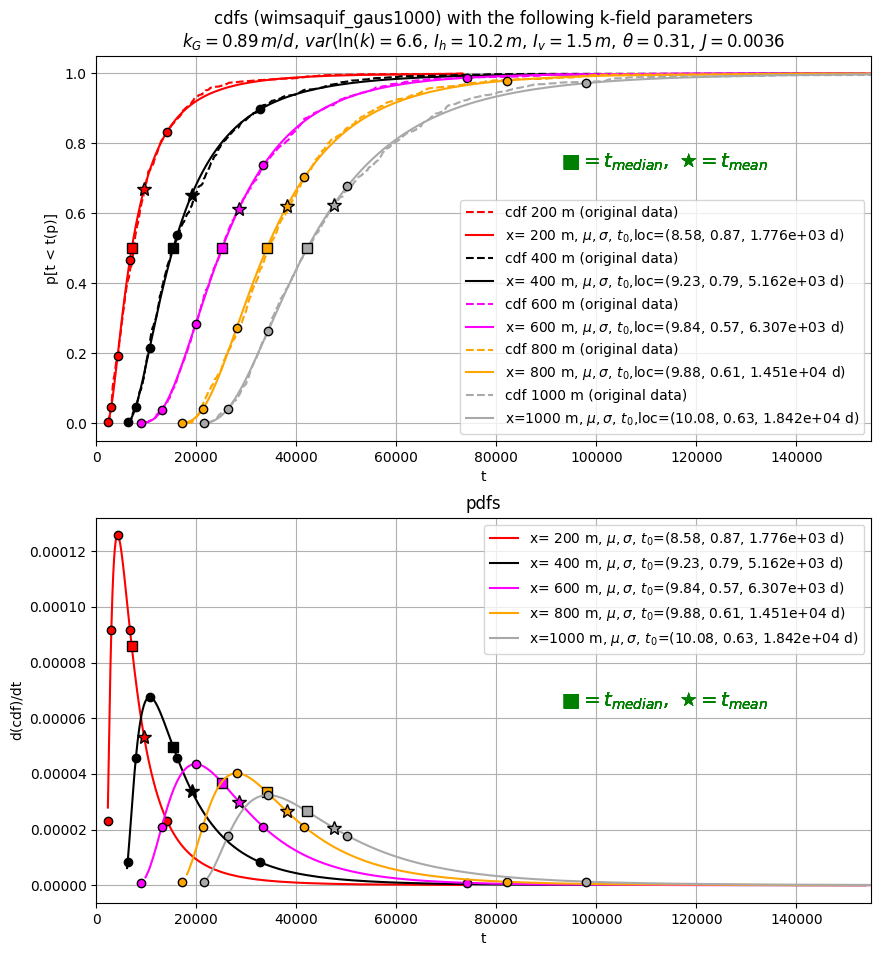

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdfs (' + props['sim_name'] + '_' + name + ') with the following k-field parameters\n'
        + k_field_str, xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdfs', xlabel='t', ylabel='d(cdf)/dt')

ax1.set_xlim(xlim)
ax2.set_xlim(xlim)

dtype1=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('t_mode', '<f8'), ('t_med', '<f8'), ('t_mean', '<f8'),
                ('v_mode', '<f8'), ('v_mean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])
dtype3=np.dtype([('x', '<i4'),
        ('tm02', '<f8'), ('tm05', '<f8'), ('tm10', '<f8'), ('tm20', '<f8'), ('tm50', '<f8'),
        ('cm02', '<f8'), ('cm05', '<f8'), ('cm10', '<f8'), ('cm20', '<f8'), ('cm50', '<f8'),
        ('pm02', '<f8'), ('pm05', '<f8'), ('pm10', '<f8'), ('pm20', '<f8'), ('pm50', '<f8')])

bt_cdf_props = np.zeros(len(cumulatives), dtype=dtype1)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
bt_mode  = np.zeros(len(cumulatives), dtype=dtype3) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))

for ix, x in enumerate(cumulatives):
    clr = next(clrs)
    t = cumulatives[x]
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm

    print("x = {:5d}, mu = {:10.3g}, sigma = {:10.3g} loc = t0 = {:10.3g}".format(x, mu, sigma, loc))

    # Get lognormal distribution properties.
    mu, sigma, t0 = np.log(scale), shape, loc
    t_mode = t0 + np.exp(mu - sigma ** 2)
    t_med = loc + np.exp(mu)
    t_mean = t0 + np.exp(mu + 0.5 * sigma ** 2)
    v_mean = x / t_mean
    v_mode = x / t_mode
    
    # Store them in bt_cdf_props recarray.
    bt_cdf_props[ix] = np.array([(x, mu, sigma, t0, t_mode, t_med, t_mean, v_mode, v_mean)], dtype=dtype1)

    # Inversely get the times at which the cdf has given p values
    
    # First get the lognormal distribution with the fitted parameters
    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    
    # Use this distibution to get the times at which the cdf has these values
    # (useful for normal distribution less so for lognormal distribution)
    t05, t16, t50, t84, t95 = (dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),
                               dist.ppf(0.8413), dist.ppf(0.95))
    
    # Store them, and for convenience round them in a recarray with dtype2
    bt_times[ix] = np.array([(x, t05, t16, t50, t84, t95)], dtype=dtype2)

        
    # Get the times at fraction alpha between t0 and t_mode    
    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0]) # fraction of t_mode - t0
    tma = t0 + (t_mode - t0) * alpha # tma = that are at alpha between t0 and t_mode
    
    # Then compute the cdf and pdf at these points
    ca = stats.lognorm.cdf(tma, *params_lognorm)
    pa = stats.lognorm.pdf(tma, *params_lognorm)
    
    # Finally store the values in bt_mode with dtype3
    L = [x] + list(tma) + list(ca) + list(pa)
    nms = [nm[0] for nm in dtype3.descr]
    for nm, v in zip(nms, L):
        bt_mode[ix][nm] = v
    
    # Plot the results (not all to prevent clutter)
    if x in [200, 400, 600, 800, 1000]:
        ax1.plot(t, cdf_o, '--', color=clr, label=f"cdf {x} m (original data)")
        ax1.plot(t, cdf_lognorm, color=clr,
                 label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$,loc=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")
        ax2.plot(t, pdf_lognorm, color=clr, 
                 label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")
  
        ax1.plot(tma, stats.lognorm.cdf(tma, *params_lognorm), 'o', mfc=clr, mec='k')
        ax2.plot(tma, stats.lognorm.pdf(tma, *params_lognorm), 'o', mfc=clr, mec='k')

        ax1.plot(t_med, stats.lognorm.cdf(t_med, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
        ax2.plot(t_med, stats.lognorm.pdf(t_med, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
        
        ax1.plot(t_mean, stats.lognorm.cdf(t_mean, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
        ax2.plot(t_mean, stats.lognorm.pdf(t_mean, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
        
        ax1.text(0.6, 0.75, 
            r"$\blacksquare = t_{median},\ \bigstar = t_{mean}$", 
            transform=ax1.transAxes, 
            fontsize=14, 
            color='green',
            ha='left', va='top')
        ax2.text(0.6, 0.55,
            r"$\blacksquare = t_{median},\ \bigstar = t_{mean}$", 
            transform=ax2.transAxes, 
            fontsize=14, 
            color='green',
            ha='left', va='top')

    for ax in [ax1, ax2]:
        ax.grid(True)
        ax.legend()

fig. savefig(os.path.join(dirs.MP7, 
            props['sim_name'] + '_' + name + '_analysis_.png'))

# # Finally round off the values for easier reading the arrays
# # round off bt_cdf_props where appropriate
# tnms = [nm[0] for nm in dtype1.descr if nm[0].startswith('t_')]
# vnms = [nm[0] for nm in dtype1.descr if nm[0].startswith('v_')]
# for nm in tnms:
#     bt_cdf_props[nm] = np.round(bt_cdf_props[nm], 0)
# for nm in vnms:
#     bt_cdf_props[nm] = np.round(bt_cdf_props[nm], 6)

# # Round off times
# nms = [nm[0] for nm in dtype2.descr][1:]
# for nm in nms:
#     bt_times[nm] = np.round(bt_times[nm])

# # Round of mode times and values
# tnms = [nm[0] for nm in dtype3.descr if nm[0].startswith('tm')]
# cnms = [nm[0] for nm in dtype3.descr if nm[0].startswith('cm')]
# pnms = [nm[0] for nm in dtype3.descr if nm[0].startswith('pm')]
# for tnm, cnm, pnm in zip(tnms, cnms, pnms):
#     bt_mode[tnm] = np.round(bt_mode[tnm], 0)
#     bt_mode[cnm] = np.round(bt_mode[cnm], 5)
#     bt_mode[pnm] = np.round(bt_mode[pnm], 5)
    
with np.printoptions(precision=3, suppress=True):
    print(bt_cdf_props)
    print(bt_times)
    print(bt_mode)

In [ ]:
with np.printoptions(precision=3, suppress=True):
    print("bt_cdf_props:")
    print(bt_cdf_props)
    print("bt_times:")
    print(bt_times)
    print("bet_mode")
    print(bt_mode)


bt_cdf_props:
[( 100,  7.787, 1.025,   724.18 ,  1567.084,  3132.709,  4795.533, 0.064, 0.021)
 ( 200,  8.579, 0.875,  1776.222,  4250.637,  7094.404,  9572.882, 0.047, 0.021)
 ( 300,  8.957, 0.799,  3487.076,  7586.514, 11245.522, 14160.406, 0.04 , 0.021)
 ( 400,  9.233, 0.786,  5161.997, 10680.377, 15390.487, 19087.52 , 0.037, 0.021)
 ( 500,  9.615, 0.672,  5067.217, 14605.516, 20049.998, 23845.384, 0.034, 0.021)
 ( 600,  9.844, 0.574,  6307.042, 19861.539, 25148.615, 28521.413, 0.03 , 0.021)
 ( 700,  9.984, 0.521,  8356.747, 24881.452, 30026.919, 33172.457, 0.028, 0.021)
 ( 800,  9.884, 0.608, 14505.71 , 28047.724, 34114.89 , 38102.206, 0.029, 0.021)
 ( 900,  9.988, 0.622, 16489.513, 31275.523, 38250.949, 42889.628, 0.029, 0.021)
 (1000, 10.076, 0.634, 18418.927, 34327.366, 42189.198, 47475.035, 0.029, 0.021)]
bt_times:
[( 100,  1170.646,  1588.813,  3132.709,  7433.395, 13717.355)
 ( 200,  3037.786,  3994.159,  7094.404, 14528.191, 24195.273)
 ( 300,  5572.613,  6978.198, 11245.522

In [ ]:
with np.printoptions(precision=5, suppress=True):
    print("bt_cdf_props:")
    print(bt_cdf_props)
    print("bt_times:")
    print(bt_times)
    print("bt_mode")
    print(bt_mode)


bt_cdf_props:
[( 100,  7.78677, 1.02466,   724.18004,  1567.08373,  3132.70875,  4795.53309, 0.06381, 0.02085)
 ( 200,  8.57889, 0.87472,  1776.22215,  4250.63658,  7094.40441,  9572.88233, 0.04705, 0.02089)
 ( 300,  8.95654, 0.79871,  3487.07593,  7586.51359, 11245.52179, 14160.40644, 0.03954, 0.02119)
 ( 400,  9.23293, 0.78555,  5161.99729, 10680.37736, 15390.48745, 19087.51959, 0.03745, 0.02096)
 ( 500,  9.61466, 0.672  ,  5067.21664, 14605.51562, 20049.99796, 23845.38358, 0.03423, 0.02097)
 ( 600,  9.84382, 0.57389,  6307.04216, 19861.53932, 25148.61504, 28521.41345, 0.03021, 0.02104)
 ( 700,  9.98369, 0.52065,  8356.74732, 24881.45168, 30026.91949, 33172.45665, 0.02813, 0.0211 )
 ( 800,  9.88375, 0.60844, 14505.70981, 28047.72408, 34114.88998, 38102.20609, 0.02852, 0.021  )
 ( 900,  9.98789, 0.62166, 16489.51292, 31275.52291, 38250.94883, 42889.62832, 0.02878, 0.02098)
 (1000, 10.07619, 0.63371, 18418.92668, 34327.36554, 42189.19847, 47475.03458, 0.02913, 0.02106)]
bt_times:
[( 10

In [ ]:
fname = os.path.join(dirs.MP7, "BT_arrays_" + props['k_field_pars']['name'] + '.npz')
np.savez(fname, bt_cdf_props=bt_cdf_props, bt_times=bt_times, bt_mode=bt_mode)    


In [ ]:
cumulatives

{100: array([  878.38480771,   879.1038854 ,   881.02204421,   885.12849401,
          892.10474857,   894.65619469,   905.86368994,   908.65652875,
          914.72243524,   924.70834553,   941.55138478,   941.85534595,
          952.89493296,   956.91511911,   967.1255065 ,   969.8017696 ,
          973.50022513,   991.06764517,   996.54082801,   998.05507554,
          999.84903899,  1011.85244831,  1019.30830908,  1020.29707372,
         1021.02526391,  1024.61733891,  1026.60032303,  1027.35943149,
         1030.34422356,  1032.33059466,  1032.41019599,  1033.6521625 ,
         1034.75177188,  1035.14229116,  1036.64931718,  1039.36587654,
         1039.76339297,  1041.62788272,  1045.0445087 ,  1047.89422793,
         1049.8585834 ,  1051.13263125,  1058.74738955,  1062.80007401,
         1065.71644364,  1066.54511905,  1093.5099628 ,  1096.91902041,
         1107.8020506 ,  1110.33327714,  1111.25323672,  1117.55262528,
         1121.88415807,  1134.5607543 ,  1135.32441592,  11

In [ ]:
pass_times

array([(  0, [ 100.,  200.,  300.,  400.,  500.,  600.,  700.,  800.,  900., 1000.], [ 26763.08559382,  39869.32179322,  64611.29387966,  77547.190625  ,  94898.48828125, 118483.4171875 , 153313.253125  , 167835.98125   , 197204.1109375 , 251366.90625   ]),
       (  1, [ 100.,  200.,  300.,  400.,  500.,  600.,  700.,  800.,  900., 1000.], [ 11777.30434382,  17648.54338831,  29091.30169216,  37126.32890625,  49410.51499614,  60145.21743219,  79283.7171875 ,  90338.975     , 114752.35      , 135095.875     ]),
       (  2, [ 100.,  200.,  300.,  400.,  500.,  600.,  700.,  800.,  900., 1000.], [ 10568.26039851,  14802.70198205,  23185.88958279,  32021.06601563,  44120.99977859,  52800.5473401 ,  88738.66015625,  96535.8015625 , 118023.17890625, 136526.734375  ]),
       (  3, [ 100.,  200.,  300.,  400.,  500.,  600.,  700.,  800.,  900., 1000.], [  9668.32680476,  13122.42053674,  19667.31282499,  25389.17851563,  35115.81640625,  44845.9639971 ,  63743.23828125,  70046.7859375 ,  856

In [ ]:
pass_times.dtype

dtype([('id', '<i4'), ('xObs', '<f8', (10,)), ('time', '<f8', (10,))])

In [ ]:
dtype0 = np.dtype([('xObs', '<i4', (10,)), ('time', '<f8', (10,))])
cumulatives = np.zeros_like(len(pass_times), dtype=dtype0)  # dict()
cumulatives['xObs'] = pass_times['xObs']


ValueError: could not broadcast input array from shape (1000,10) into shape (10,)

In [ ]:
cumulatives

array(([0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
      dtype=[('xObs', '<i4', (10,)), ('time', '<f8', (10,))])

In [ ]:
len(pass_times)

1000

In [ ]:
cumulatives = np.zeros_like(len(pass_times), dtype=dtype0)  # dict()

In [ ]:
cumulatives = np.zeros(len(pass_times), dtype=dtype0)  # dict()

In [ ]:
cumulatives

array([([0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
    

In [ ]:
cumulatives['xObs'] = pass_times['xObs']

In [ ]:
cumulatives

array([([ 100,  200,  300,  400,  500,  600,  700,  800,  900, 1000], [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([ 100,  200,  300,  400,  500,  600,  700,  800,  900, 1000], [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([ 100,  200,  300,  400,  500,  600,  700,  800,  900, 1000], [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([ 100,  200,  300,  400,  500,  600,  700,  800,  900, 1000], [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([ 100,  200,  300,  400,  500,  600,  700,  800,  900, 1000], [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([ 100,  200,  300,  400,  500,  600,  700,  800,  900, 1000], [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([ 100,  200,  300,  400,  500,  600,  700,  800,  900, 1000], [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([ 100,  200,  300,  400,  500,  600,  700,  800,  900, 1000], [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([ 100,  200,  300,  400,  500,  600,  700,  800,  900, 1000], [0., 0., 0., 0., 0., 0., 0

In [ ]:
enumerate(pass_times['xObs'][0])

In [ ]:
pass_times['xObs'][0]

array([ 100.,  200.,  300.,  400.,  500.,  600.,  700.,  800.,  900.,
       1000.])

In [ ]:
for j in enumerate(pass_times['xObs'][0]):
    idx = np.argsort(pass_times['time'][:, j])    
    t = pass_times['time'][:, j][idx]    
    cumulatives['time'][:, j] = t


IndexError: only integers, slices (`:`), ellipsis (`...`), numpy.newaxis (`None`) and integer or boolean arrays are valid indices

In [ ]:
pass_times['time'][:, j]

IndexError: only integers, slices (`:`), ellipsis (`...`), numpy.newaxis (`None`) and integer or boolean arrays are valid indices

In [ ]:
pass_times['time']

array([[ 26763.08559382,  39869.32179322,  64611.29387966, ...,
        167835.98125   , 197204.1109375 , 251366.90625   ],
       [ 11777.30434382,  17648.54338831,  29091.30169216, ...,
         90338.975     , 114752.35      , 135095.875     ],
       [ 10568.26039851,  14802.70198205,  23185.88958279, ...,
         96535.8015625 , 118023.17890625, 136526.734375  ],
       ...,
       [ 15519.87227262,  20385.26598763,  36938.23935557, ...,
         91606.93125   , 114812.1359375 , 154489.8125    ],
       [ 12791.58028044,  18956.19372201,  39453.06564801, ...,
         94953.315625  , 164575.30625   , 199129.703125  ],
       [ 18824.97373747,  46832.32960091,  80439.46174183, ...,
        231188.878125  , 282444.9       , 532595.1875    ]])

In [ ]:
pass_times['time'].shape

(1000, 10)

In [ ]:
pass_times['time'][:, 0]

array([26763.08559382, 11777.30434382, 10568.26039851,  9668.32680476,
        5585.95229304,  4631.75644343,  3619.96005671,  3232.34679988,
        2998.80798152,  2914.43881648,  2849.13046687,  2839.02109187,
        2751.74230769,  2773.73788874,  2857.45077937,  2993.30893367,
        3262.71347468,  3786.60290339,  3877.41830867,  3756.51745417,
        2942.24667781,  3103.11886004,  3106.1914659 ,  3032.36825517,
        2475.23298207,  2372.17964155,  2687.75537545,  2894.16651908,
        2580.35887748,  2350.44847709,  2260.96849662,  2288.81683577,
        2567.77636492,  3100.4434501 ,  3631.65116753,  4748.55038806,
        5077.72221797,  6325.13725703,  5741.99316523,  8071.44340937,
       25771.96440547, 10998.21040156,  6150.85945465,  4857.11610045,
        6413.37148305,  6172.52426625,  4958.48813344,  4103.84311391,
        3984.21374379,  4088.75396594,  4562.50915896,  2783.44793243,
        2675.8442994 ,  2580.15798025,  2493.02146226,  2359.53171595,
      

In [ ]:
pass_times['time'][:, 0].shape

(1000,)

In [ ]:
j

(0, np.float64(100.0))

In [ ]:
pass_times['xObs'].shape[-1]

10

In [ ]:
for j in range(pass_times['xObs'].shape[-1]):
    idx = np.argsort(pass_times['time'][:, j])    
    t = pass_times['time'][:, j][idx]    
    cumulatives['time'][:, j] = t


In [ ]:
cumulatives

array([([ 100,  200,  300,  400,  500,  600,  700,  800,  900, 1000], [   878.38480771,   2318.50324904,   4160.78549016,   6150.99677734,   7299.98388672,   9845.59355469,  12348.94852898,  18145.35859375,  20029.85898438,  22272.86914062]),
       ([ 100,  200,  300,  400,  500,  600,  700,  800,  900, 1000], [   879.1038854 ,   2333.78767287,   4201.31088079,   6183.91992188,   7302.15527344,   9922.60488281,  12847.12308199,  18559.74236322,  20440.54277344,  22463.64257812]),
       ([ 100,  200,  300,  400,  500,  600,  700,  800,  900, 1000], [   881.02204421,   2338.56330764,   4266.96405462,   6360.16748047,   7497.92041016,   9948.51542969,  12862.70488281,  19041.49140625,  21294.96660156,  22600.6875    ]),
       ([ 100,  200,  300,  400,  500,  600,  700,  800,  900, 1000], [   885.12849401,   2349.43728225,   4297.09506047,   6399.096875  ,   7593.07788086,   9970.54042969,  13164.09453125,  19099.7109375 ,  21310.60703125,  22606.40234375]),
       ([ 100,  200,  300,  

In [ ]:
last_times = cumulatives['time'][:, -1]

In [ ]:
last_times

array([ 22272.86914062,  22463.64257812,  22600.6875    ,  22606.40234375,
        22779.45898438,  23077.53320312,  23305.58203125,  23370.19140625,
        23598.10742188,  23691.79296875,  23733.71484375,  23881.921875  ,
        23884.484375  ,  24049.76367188,  24052.67578125,  24159.79101562,
        24187.63085938,  24206.71484375,  24275.48828125,  24342.3359375 ,
        24412.74804688,  24424.06054688,  24448.73828125,  24467.03710938,
        24528.95507812,  24663.09765625,  24805.72851562,  24842.28320312,
        24954.796875  ,  24980.2890625 ,  25271.36328125,  25279.83007812,
        25298.35742188,  25486.8984375 ,  25649.890625  ,  25650.453125  ,
        25676.80664062,  25730.88867188,  26037.89257812,  26076.58203125,
        26076.66015625,  26085.05664062,  26123.74804688,  26126.90429688,
        26237.30078125,  26311.25585938,  26462.49414062,  26522.61523438,
        26638.37695312,  26740.1171875 ,  26893.0546875 ,  27005.8203125 ,
        27033.671875  ,  

In [ ]:
t_last = last_times[int(0.995 * len(last_times))]

In [ ]:
t_last

np.float64(154489.8125)

In [ ]:
cumulatives['xObs'].T

array([[ 100,  100,  100, ...,  100,  100,  100],
       [ 200,  200,  200, ...,  200,  200,  200],
       [ 300,  300,  300, ...,  300,  300,  300],
       ...,
       [ 800,  800,  800, ...,  800,  800,  800],
       [ 900,  900,  900, ...,  900,  900,  900],
       [1000, 1000, 1000, ..., 1000, 1000, 1000]], dtype=int32)

In [ ]:
cumulatives['xObs'].T[0]

array([100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100,
       100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100,
       100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100,
       100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100,
       100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100,
       100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100,
       100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100,
       100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100,
       100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100,
       100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100,
       100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100,
       100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100,
       100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100,
       100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 10

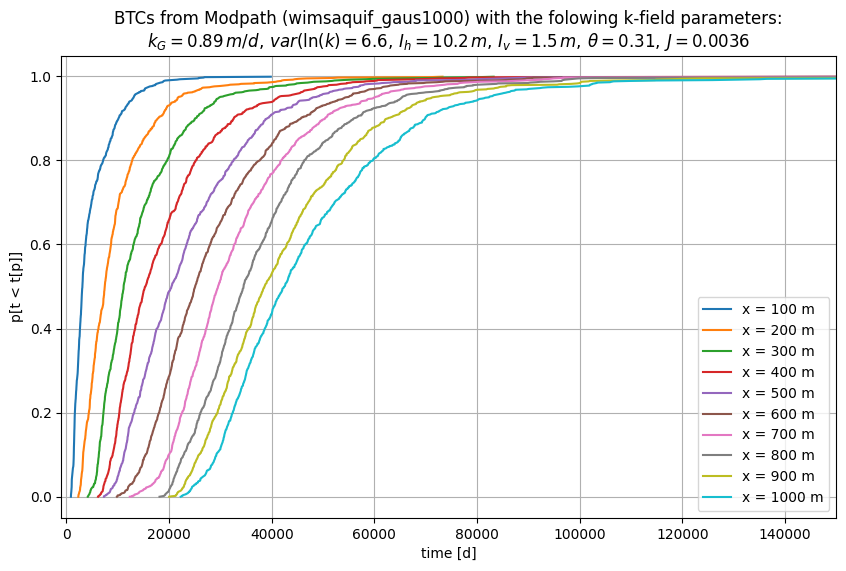

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.set(title='BTCs from Modpath (' + props['sim_name'] + '_' + name + ') with the folowing k-field parameters:\n' + k_field_str, xlabel='time [d]', ylabel='p[t < t[p]]')
p = pass_times['id'] / 1000.
for X, t in zip(cumulatives['xObs'].T, cumulatives['time'].T):
    ax.plot(t, p, label=f'x = {X[0]} m')
    
ax.set_xlim(-1000, 150000)
ax.grid()
ax.legend()

fig. savefig(os.path.join(dirs.MP7, 'BTcurves_' + name + '.png'))

In [ ]:
# Analyting pass times

# %%
import os

os.chdir('/Users/Theo/GRWMODELS/python/mf6lab/Projects/Dispersion/cases/wimsaquif')

import numpy as np
import matplotlib.pyplot as plt
from settings import dirs, props
from scipy.interpolate import UnivariateSpline
from scipy import stats
from itertools import cycle

os.chdir(dirs.MP7)

def round_up_nice(x, m=1):
    return 10 ** (np.floor(np.log10(x)) - m) * np.ceil(
        np.round(10 ** (np.log10(x) + m - np.floor(np.log10(x))), 2))

In [ ]:
k_field_str = props['k_field_pars']['k_field_str']

name = props['k_field_pars']['name']
pass_times = np.load('pass_times_' + name + '.npy')

dtype0 = np.dtype([('xObs', '<i4', (10,)), ('time', '<f8', (10,))])
cumulatives = np.zeros(len(pass_times), dtype=dtype0)  # dict()
cumulatives['xObs'] = pass_times['xObs']

for j in range(pass_times['xObs'].shape[-1]):
    idx = np.argsort(pass_times['time'][:, j])    
    t = pass_times['time'][:, j][idx]    
    cumulatives['time'][:, j] = t
    

last_times = cumulatives['time'][:, -1]
t_last = last_times[int(0.995 * len(last_times))]

xlim = (0, round_up_nice(t_last, m=2))

# dtype([('id', '<i4'), ('xObs', '<f8', (10,)), ('time', '<f8', (10,))])

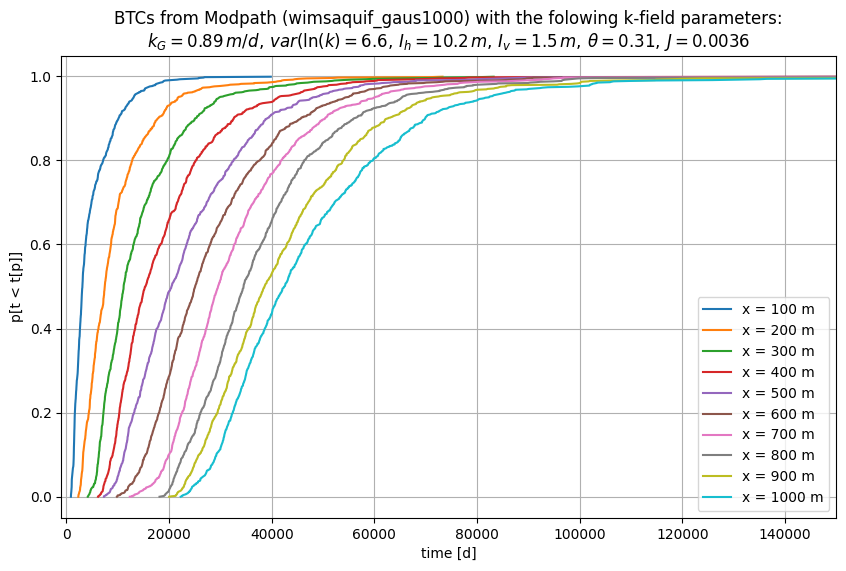

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
ax.set(title='BTCs from Modpath (' + props['sim_name'] + '_' + name + ') with the folowing k-field parameters:\n' + k_field_str, xlabel='time [d]', ylabel='p[t < t[p]]')
p = pass_times['id'] / 1000.
for X, t in zip(cumulatives['xObs'].T, cumulatives['time'].T):
    ax.plot(t, p, label=f'x = {X[0]} m')
    
ax.set_xlim(-1000, 150000)
ax.grid()
ax.legend()

fig. savefig(os.path.join(dirs.MP7, 'BTcurves_' + name + '.png'))

x     mu         sigma      scale     
x =   100, mu =       7.79, sigma =       1.02 loc = t0 =        724
x =   200, mu =       8.58, sigma =      0.875 loc = t0 =   1.78e+03
x =   300, mu =       8.96, sigma =      0.799 loc = t0 =   3.49e+03
x =   400, mu =       9.23, sigma =      0.786 loc = t0 =   5.16e+03
x =   500, mu =       9.61, sigma =      0.672 loc = t0 =   5.07e+03
x =   600, mu =       9.84, sigma =      0.574 loc = t0 =   6.31e+03
x =   700, mu =       9.98, sigma =      0.521 loc = t0 =   8.36e+03
x =   800, mu =       9.88, sigma =      0.608 loc = t0 =   1.45e+04
x =   900, mu =       9.99, sigma =      0.622 loc = t0 =   1.65e+04
x =  1000, mu =       10.1, sigma =      0.634 loc = t0 =   1.84e+04


<ipython-input-371-8931107b8bc6>:114: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()


bt_cdf_props:
[( 100,  7.78677, 1.02466,   724.18004,  1567.08373,  3132.70875,  4795.53309, 0.06381, 0.02085)
 ( 200,  8.57889, 0.87472,  1776.22215,  4250.63658,  7094.40441,  9572.88233, 0.04705, 0.02089)
 ( 300,  8.95654, 0.79871,  3487.07593,  7586.51359, 11245.52179, 14160.40644, 0.03954, 0.02119)
 ( 400,  9.23293, 0.78555,  5161.99729, 10680.37736, 15390.48745, 19087.51959, 0.03745, 0.02096)
 ( 500,  9.61466, 0.672  ,  5067.21664, 14605.51562, 20049.99796, 23845.38358, 0.03423, 0.02097)
 ( 600,  9.84382, 0.57389,  6307.04216, 19861.53932, 25148.61504, 28521.41345, 0.03021, 0.02104)
 ( 700,  9.98369, 0.52065,  8356.74732, 24881.45168, 30026.91949, 33172.45665, 0.02813, 0.0211 )
 ( 800,  9.88375, 0.60844, 14505.70981, 28047.72408, 34114.88998, 38102.20609, 0.02852, 0.021  )
 ( 900,  9.98789, 0.62166, 16489.51292, 31275.52291, 38250.94883, 42889.62832, 0.02878, 0.02098)
 (1000, 10.07619, 0.63371, 18418.92668, 34327.36554, 42189.19847, 47475.03458, 0.02913, 0.02106)
 (   0,  0.     

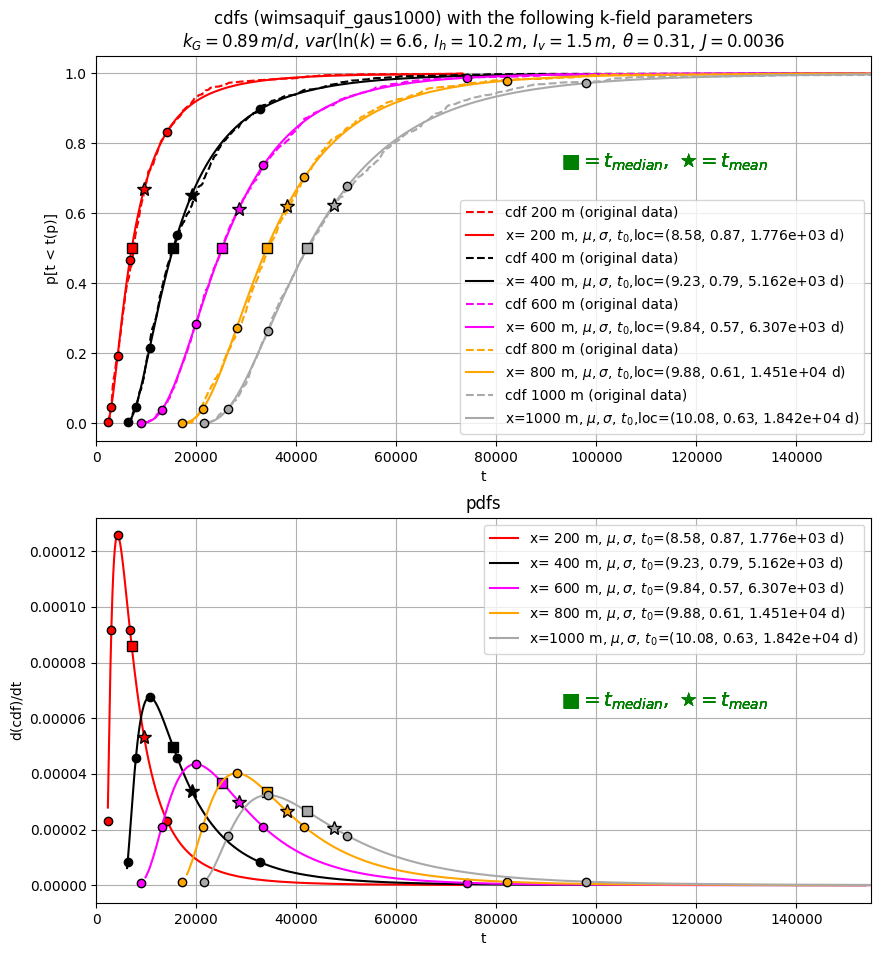

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=False, figsize=(10, 11))
ax1.set(title='cdfs (' + props['sim_name'] + '_' + name + ') with the following k-field parameters\n'
        + k_field_str, xlabel='t', ylabel='p[t < t(p)]') 
ax2.set(title='pdfs', xlabel='t', ylabel='d(cdf)/dt')

ax1.set_xlim(xlim)
ax2.set_xlim(xlim)

dtype1=np.dtype([('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'),
                ('t_mode', '<f8'), ('t_med', '<f8'), ('t_mean', '<f8'),
                ('v_mode', '<f8'), ('v_mean', '<f8')])
dtype2=np.dtype([('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'),
                ('t84', '<f8'), ('t95', '<f8')])
dtype3=np.dtype([('x', '<i4'),
        ('tm02', '<f8'), ('tm05', '<f8'), ('tm10', '<f8'), ('tm20', '<f8'), ('tm50', '<f8'),
        ('cm02', '<f8'), ('cm05', '<f8'), ('cm10', '<f8'), ('cm20', '<f8'), ('cm50', '<f8'),
        ('pm02', '<f8'), ('pm05', '<f8'), ('pm10', '<f8'), ('pm20', '<f8'), ('pm50', '<f8')])

bt_cdf_props = np.zeros(len(cumulatives), dtype=dtype1)
bt_times = np.zeros(len(cumulatives), dtype=dtype2) # Breakthrough times
bt_mode  = np.zeros(len(cumulatives), dtype=dtype3) # Breakthrough times
clrs = cycle(["blue", "red", "green", "black", "gray", "magenta", "cyan", "orange", "brown", "darkgray"])

print("{:5s} {:10s} {:10s} {:10s}".format('x', 'mu', 'sigma', 'scale'))



for ix, (X, t) in enumerate(zip(cumulatives['xObs'].T, cumulatives['time'].T)):
    x = X[0]
    clr = next(clrs)    
    cdf_o = p

    params_lognorm = stats.lognorm.fit(t)    
    cdf_lognorm    = stats.lognorm.cdf(t, *params_lognorm)
    pdf_lognorm    = stats.lognorm.pdf(t, *params_lognorm)

    shape, loc, scale = params_lognorm
    mu, sigma, t0 = np.log(scale), shape, loc

    print("x = {:5d}, mu = {:10.3g}, sigma = {:10.3g} loc = t0 = {:10.3g}".format(x, mu, sigma, loc))

    # Get lognormal distribution properties.
    t_mode = t0 + np.exp(mu - sigma ** 2)
    t_med = loc + np.exp(mu)
    t_mean = t0 + np.exp(mu + 0.5 * sigma ** 2)
    v_mean = x / t_mean
    v_mode = x / t_mode
    
    # Store them in bt_cdf_props recarray.
    bt_cdf_props[ix] = np.array([(x, mu, sigma, t0, t_mode, t_med, t_mean, v_mode, v_mean)], dtype=dtype1)

    # Inversely get the times at which the cdf has given p values
    
    # First get the lognormal distribution with the fitted parameters
    dist = stats.lognorm(s=shape, loc=loc, scale=scale)
    
    # Use this distibution to get the times at which the cdf has these values
    # (useful for normal distribution less so for lognormal distribution)
    t05, t16, t50, t84, t95 = (dist.ppf(0.05), dist.ppf(0.1587), dist.ppf(0.5),
                               dist.ppf(0.8413), dist.ppf(0.95))
    
    # Store them, and for convenience round them in a recarray with dtype2
    bt_times[ix] = np.array([(x, t05, t16, t50, t84, t95)], dtype=dtype2)

        
    # Get the times at fraction alpha between t0 and t_mode    
    alpha = np.array([0.2, 0.5, 1.0, 2.0, 5.0]) # fraction of t_mode - t0
    tma = t0 + (t_mode - t0) * alpha # tma = that are at alpha between t0 and t_mode
    
    # Then compute the cdf and pdf at these points
    ca = stats.lognorm.cdf(tma, *params_lognorm)
    pa = stats.lognorm.pdf(tma, *params_lognorm)
    
    # Finally store the values in bt_mode with dtype3
    L = [x] + list(tma) + list(ca) + list(pa)
    nms = [nm[0] for nm in dtype3.descr]
    for nm, v in zip(nms, L):
        bt_mode[ix][nm] = v
    
    # Plot the results (not all to prevent clutter)
    if x in [200, 400, 600, 800, 1000]:
        ax1.plot(t, cdf_o, '--', color=clr, label=f"cdf {x} m (original data)")
        ax1.plot(t, cdf_lognorm, color=clr,
                 label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$,loc=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")
        ax2.plot(t, pdf_lognorm, color=clr, 
                 label=fr"x={x:4d} m, $\mu,\sigma,\,t_0$=({mu:.2f}, {sigma:.2f}, {loc:.3e} d)")
  
        ax1.plot(tma, stats.lognorm.cdf(tma, *params_lognorm), 'o', mfc=clr, mec='k')
        ax2.plot(tma, stats.lognorm.pdf(tma, *params_lognorm), 'o', mfc=clr, mec='k')

        ax1.plot(t_med, stats.lognorm.cdf(t_med, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
        ax2.plot(t_med, stats.lognorm.pdf(t_med, *params_lognorm), 's', ms=7, mfc=clr, mec='k')
        
        ax1.plot(t_mean, stats.lognorm.cdf(t_mean, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
        ax2.plot(t_mean, stats.lognorm.pdf(t_mean, *params_lognorm), '*', ms=10, mfc=clr, mec='k')
        
        ax1.text(0.6, 0.75, 
            r"$\blacksquare = t_{median},\ \bigstar = t_{mean}$", 
            transform=ax1.transAxes, 
            fontsize=14, 
            color='green',
            ha='left', va='top')
        ax2.text(0.6, 0.55,
            r"$\blacksquare = t_{median},\ \bigstar = t_{mean}$", 
            transform=ax2.transAxes, 
            fontsize=14, 
            color='green',
            ha='left', va='top')

    for ax in [ax1, ax2]:
        ax.grid(True)
        ax.legend()

fig. savefig(os.path.join(dirs.MP7, 'BTanalysis_' + name + '.png'))

# # Finally round off the values for easier reading the arrays
# # round off bt_cdf_props where appropriate
# tnms = [nm[0] for nm in dtype1.descr if nm[0].startswith('t_')]
# vnms = [nm[0] for nm in dtype1.descr if nm[0].startswith('v_')]
# for nm in tnms:
#     bt_cdf_props[nm] = np.round(bt_cdf_props[nm], 0)
# for nm in vnms:
#     bt_cdf_props[nm] = np.round(bt_cdf_props[nm], 6)

# # Round off times
# nms = [nm[0] for nm in dtype2.descr][1:]
# for nm in nms:
#     bt_times[nm] = np.round(bt_times[nm])

# # Round of mode times and values
# tnms = [nm[0] for nm in dtype3.descr if nm[0].startswith('tm')]
# cnms = [nm[0] for nm in dtype3.descr if nm[0].startswith('cm')]
# pnms = [nm[0] for nm in dtype3.descr if nm[0].startswith('pm')]
# for tnm, cnm, pnm in zip(tnms, cnms, pnms):
#     bt_mode[tnm] = np.round(bt_mode[tnm], 0)
#     bt_mode[cnm] = np.round(bt_mode[cnm], 5)
#     bt_mode[pnm] = np.round(bt_mode[pnm], 5)
    
with np.printoptions(precision=5, suppress=True):
    print("bt_cdf_props:")
    print(bt_cdf_props)
    print("bt_times:")
    print(bt_times)
    print("bt_mode")
    print(bt_mode)

fname = os.path.join(dirs.MP7, "BTarrays_" + props['k_field_pars']['name'] + '.npz')
np.savez(fname, bt_cdf_props=bt_cdf_props, bt_times=bt_times, bt_mode=bt_mode)    

In [ ]:
bt_cdf_props


array([( 100,  7.78677135, 1.02465538,   724.18004096,  1567.08373454,  3132.70875485,  4795.53308869, 0.0638128 , 0.02085274),
       ( 200,  8.57888684, 0.87471583,  1776.22214684,  4250.63657703,  7094.40440899,  9572.88232957, 0.04705178, 0.02089235),
       ( 300,  8.95653732, 0.7987066 ,  3487.0759265 ,  7586.51358635, 11245.52179068, 14160.40643533, 0.03954386, 0.02118583),
       ( 400,  9.23293226, 0.78555243,  5161.99728746, 10680.37736118, 15390.48744879, 19087.51959153, 0.03745186, 0.0209561 ),
       ( 500,  9.61465691, 0.67200183,  5067.2166364 , 14605.51561821, 20049.99796258, 23845.38358329, 0.03423364, 0.02096842),
       ( 600,  9.84382103, 0.57388794,  6307.04216298, 19861.53932143, 25148.61504038, 28521.41344879, 0.03020914, 0.02103683),
       ( 700,  9.98369204, 0.52065369,  8356.74731875, 24881.45167526, 30026.91948938, 33172.45665223, 0.02813341, 0.02110184),
       ( 800,  9.88375311, 0.6084413 , 14505.70981425, 28047.72407766, 34114.88997585, 38102.20608945, 0

In [ ]:

bt_cdf_props


array([( 100,  7.78677135, 1.02465538,   724.18004096,  1567.08373454,  3132.70875485,  4795.53308869, 0.0638128 , 0.02085274),
       ( 200,  8.57888684, 0.87471583,  1776.22214684,  4250.63657703,  7094.40440899,  9572.88232957, 0.04705178, 0.02089235),
       ( 300,  8.95653732, 0.7987066 ,  3487.0759265 ,  7586.51358635, 11245.52179068, 14160.40643533, 0.03954386, 0.02118583),
       ( 400,  9.23293226, 0.78555243,  5161.99728746, 10680.37736118, 15390.48744879, 19087.51959153, 0.03745186, 0.0209561 ),
       ( 500,  9.61465691, 0.67200183,  5067.2166364 , 14605.51561821, 20049.99796258, 23845.38358329, 0.03423364, 0.02096842),
       ( 600,  9.84382103, 0.57388794,  6307.04216298, 19861.53932143, 25148.61504038, 28521.41344879, 0.03020914, 0.02103683),
       ( 700,  9.98369204, 0.52065369,  8356.74731875, 24881.45167526, 30026.91948938, 33172.45665223, 0.02813341, 0.02110184),
       ( 800,  9.88375311, 0.6084413 , 14505.70981425, 28047.72407766, 34114.88997585, 38102.20608945, 0

In [ ]:
cumulatives['xObs'].shape[-1]

10

In [ ]:
bt_cdf_props = np.zeros(cumulatives['xObs'].shape[-1], dtype=dtype1)
bt_times     = np.zeros(cumulatives['xObs'].shape[-1], dtype=dtype2) # Breakthrough times
bt_mode      = np.zeros(cumulatives['xObs'].shape[-1], dtype=dtype3) # Breakthrough times


In [ ]:
bt_times

array([(0, 0., 0., 0., 0., 0.), (0, 0., 0., 0., 0., 0.),
       (0, 0., 0., 0., 0., 0.), (0, 0., 0., 0., 0., 0.),
       (0, 0., 0., 0., 0., 0.), (0, 0., 0., 0., 0., 0.),
       (0, 0., 0., 0., 0., 0.), (0, 0., 0., 0., 0., 0.),
       (0, 0., 0., 0., 0., 0.), (0, 0., 0., 0., 0., 0.)],
      dtype=[('x', '<i4'), ('t05', '<f8'), ('t16', '<f8'), ('t50', '<f8'), ('t84', '<f8'), ('t95', '<f8')])

In [ ]:
bt_mode

array([(0, 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.),
       (0, 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.),
       (0, 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.),
       (0, 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.),
       (0, 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.),
       (0, 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.),
       (0, 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.),
       (0, 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.),
       (0, 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.),
       (0, 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.)],
      dtype=[('x', '<i4'), ('tm02', '<f8'), ('tm05', '<f8'), ('tm10', '<f8'), ('tm20', '<f8'), ('tm50', '<f8'), ('cm02', '<f8'), ('cm05', '<f8'), ('cm10', '<f8'), ('cm20', '<f8'), ('cm50', '<f8'), ('pm02', '<f8'), ('pm05', '<f8'), ('pm10', '<f8'), ('pm20', '<f8'), ('pm50', '<f8'

In [ ]:
bt_cdf_props

array([(0, 0., 0., 0., 0., 0., 0., 0., 0.),
       (0, 0., 0., 0., 0., 0., 0., 0., 0.),
       (0, 0., 0., 0., 0., 0., 0., 0., 0.),
       (0, 0., 0., 0., 0., 0., 0., 0., 0.),
       (0, 0., 0., 0., 0., 0., 0., 0., 0.),
       (0, 0., 0., 0., 0., 0., 0., 0., 0.),
       (0, 0., 0., 0., 0., 0., 0., 0., 0.),
       (0, 0., 0., 0., 0., 0., 0., 0., 0.),
       (0, 0., 0., 0., 0., 0., 0., 0., 0.),
       (0, 0., 0., 0., 0., 0., 0., 0., 0.)],
      dtype=[('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'), ('t_mode', '<f8'), ('t_med', '<f8'), ('t_mean', '<f8'), ('v_mode', '<f8'), ('v_mean', '<f8')])

In [ ]:
p.array([(x, mu, sigma, t0, t_mode, t_med, t_mean, v_mode, v_mean)], dtype=dtype1)

AttributeError: 'numpy.ndarray' object has no attribute 'array'

In [ ]:
np.array([(x, mu, sigma, t0, t_mode, t_med, t_mean, v_mode, v_mean)], dtype=dtype1)

array([(1000, 10.07619099, 0.63370814, 18418.92667642, 34327.36554, 42189.19846882, 47475.03458044, 0.02913128, 0.0210637)],
      dtype=[('x', '<i4'), ('mu', '<f8'), ('sigma', '<f8'), ('loc', '<f8'), ('t_mode', '<f8'), ('t_med', '<f8'), ('t_mean', '<f8'), ('v_mode', '<f8'), ('v_mean', '<f8')])

In [ ]:
bt_cdf_props[ix] = np.array([(x, mu, sigma, t0, t_mode, t_med, t_mean, v_mode, v_mean)], dtype=dtype1)

In [ ]:
bt_cdf_props

array([(   0,  0.        , 0.        ,     0.        ,     0.     ,     0.        ,     0.        , 0.        , 0.       ),
       (   0,  0.        , 0.        ,     0.        ,     0.     ,     0.        ,     0.        , 0.        , 0.       ),
       (   0,  0.        , 0.        ,     0.        ,     0.     ,     0.        ,     0.        , 0.        , 0.       ),
       (   0,  0.        , 0.        ,     0.        ,     0.     ,     0.        ,     0.        , 0.        , 0.       ),
       (   0,  0.        , 0.        ,     0.        ,     0.     ,     0.        ,     0.        , 0.        , 0.       ),
       (   0,  0.        , 0.        ,     0.        ,     0.     ,     0.        ,     0.        , 0.        , 0.       ),
       (   0,  0.        , 0.        ,     0.        ,     0.     ,     0.        ,     0.        , 0.        , 0.       ),
       (   0,  0.        , 0.        ,     0.        ,     0.     ,     0.        ,     0.        , 0.        , 0.       ),
       (

In [ ]:
ix

9

In [ ]:
bt_cdf_props

array([(   0,  0.        , 0.        ,     0.        ,     0.     ,     0.        ,     0.        , 0.        , 0.       ),
       (   0,  0.        , 0.        ,     0.        ,     0.     ,     0.        ,     0.        , 0.        , 0.       ),
       (   0,  0.        , 0.        ,     0.        ,     0.     ,     0.        ,     0.        , 0.        , 0.       ),
       (   0,  0.        , 0.        ,     0.        ,     0.     ,     0.        ,     0.        , 0.        , 0.       ),
       (   0,  0.        , 0.        ,     0.        ,     0.     ,     0.        ,     0.        , 0.        , 0.       ),
       (   0,  0.        , 0.        ,     0.        ,     0.     ,     0.        ,     0.        , 0.        , 0.       ),
       (   0,  0.        , 0.        ,     0.        ,     0.     ,     0.        ,     0.        , 0.        , 0.       ),
       (   0,  0.        , 0.        ,     0.        ,     0.     ,     0.        ,     0.        , 0.        , 0.       ),
       (